# SMAI

## Assignment 3

### Question 1
### Multinomial Logistic Regression

In this part of the assignment, we will implement a simple logistic regression model to classify data from the Wine dataset. First let us evaluate the data and make necessary observations.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MultiLabelBinarizer
from sklearn.impute import SimpleImputer
from sklearn.metrics import classification_report, accuracy_score, hamming_loss, r2_score, mean_squared_error
import wandb

/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "


In [2]:
data1 = pd.read_csv('WineQT.csv')
data1 = data1.drop('Id', 1)
print(data1.head())
print(data1['quality'].unique())

   fixed acidity  volatile acidity  citric acid  residual sugar  chlorides  \
0            7.4              0.70         0.00             1.9      0.076   
1            7.8              0.88         0.00             2.6      0.098   
2            7.8              0.76         0.04             2.3      0.092   
3           11.2              0.28         0.56             1.9      0.075   
4            7.4              0.70         0.00             1.9      0.076   

   free sulfur dioxide  total sulfur dioxide  density    pH  sulphates  \
0                 11.0                  34.0   0.9978  3.51       0.56   
1                 25.0                  67.0   0.9968  3.20       0.68   
2                 15.0                  54.0   0.9970  3.26       0.65   
3                 17.0                  60.0   0.9980  3.16       0.58   
4                 11.0                  34.0   0.9978  3.51       0.56   

   alcohol  quality  
0      9.4        5  
1      9.8        5  
2      9.8        5 

/tmp/ipykernel_148282/231220394.py:2: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  data1 = data1.drop('Id', 1)


As we can see, there are 6 different quality classes.Let us take at look at some of the statistics for the above data.

In [3]:
print('---Mean of Data---')
print(data1.mean())
print('---Standard Deviation of Data---')
print(data1.std())
print('---Min of Data---')
print(data1.min())
print('---Max of Data---')
print(data1.max())

---Mean of Data---
fixed acidity            8.311111
volatile acidity         0.531339
citric acid              0.268364
residual sugar           2.532152
chlorides                0.086933
free sulfur dioxide     15.615486
total sulfur dioxide    45.914698
density                  0.996730
pH                       3.311015
sulphates                0.657708
alcohol                 10.442111
quality                  5.657043
dtype: float64
---Standard Deviation of Data---
fixed acidity            1.747595
volatile acidity         0.179633
citric acid              0.196686
residual sugar           1.355917
chlorides                0.047267
free sulfur dioxide     10.250486
total sulfur dioxide    32.782130
density                  0.001925
pH                       0.156664
sulphates                0.170399
alcohol                  1.082196
quality                  0.805824
dtype: float64
---Min of Data---
fixed acidity           4.60000
volatile acidity        0.12000
citric acid         

Now let us observe the distribution of all the labels across the entire dataset

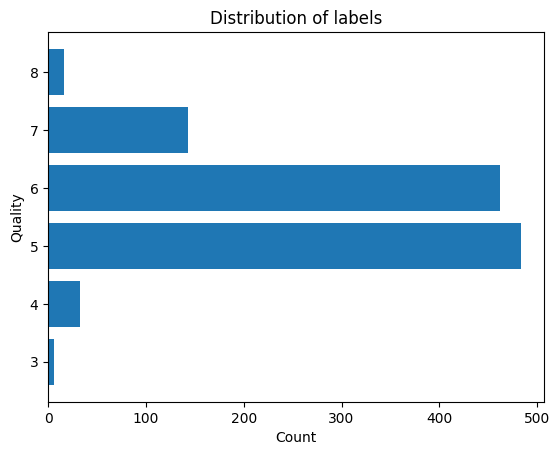

In [4]:
counter = Counter(data1['quality'])

count = list(counter.values())
labels = list(counter.keys())

plt.barh(labels, count)
plt.xlabel('Count')
plt.ylabel('Quality')
plt.title('Distribution of labels')
plt.show()

Now, let us appropriately split our data into train, test and validation data. We will make a split ratio of 0.7:0.2:0.1. We will also simultaneously take care of missing data as well as standardization of the data.

In [5]:
feature_columns = data1.columns.tolist()

imputer = SimpleImputer(strategy='mean')
data = pd.DataFrame(imputer.fit_transform(data1), columns=data1.columns)

scaler = StandardScaler()
data = pd.DataFrame(scaler.fit_transform(data[feature_columns[:-1]]), columns=feature_columns[:-1])
data = pd.concat([data, data1['quality']], axis = 1)

Train_df, rest_df = train_test_split(data, test_size=0.3)
Test_df, Val_df = train_test_split(rest_df, test_size=0.2/0.3)


X_train = Train_df[feature_columns[:-1]].to_numpy()
X_val = Val_df[feature_columns[:-1]].to_numpy()
X_test = Test_df[feature_columns[:-1]].to_numpy()

Y_train = Train_df[feature_columns[-1]].to_numpy() - 3
Y_val = Val_df[feature_columns[-1]].to_numpy() - 3
Y_test = Test_df[feature_columns[-1]].to_numpy() - 3

Y_train_oh = np.eye(6)[Y_train].T
Y_val_oh = np.eye(6)[Y_val].T
Y_test_oh = np.eye(6)[Y_test].T

Now that we have taken care of the preprocessing step, now we will begin creating the class which will implement multinomial logistic regression for us.

In [6]:
class MultiLogistic:

    def __init__(self):
        self.params = {'W': None, 'b': None}
        self.gradients = {'dW': None, 'db': None}

    def softmax(self, x):
        return np.exp(x)/np.sum(np.exp(x), axis = 0, keepdims=True)

    def initialisation(self, n_input, n_output):
        self.params['W'] = np.random.rand(n_output, n_input)
        self.params['b'] = np.zeros((n_output, 1))

    def forward_prop(self, input):
        Z = np.dot(self.params['W'], input.T) + self.params['b']
        A = self.softmax(Z)

        return A

    def loss(self, A, Y):
        m = Y.shape[1]
        return -np.sum(np.log(A)*Y)/m

    def backprop(self, A, X, Y):
        m = X.shape[0]

        dZ = A - Y
        self.gradients['dW'] = np.dot(dZ, X)/m
        self.gradients['db'] = np.sum(dZ, axis = 1, keepdims=True)/m

    def optimization(self, lr):
        self.params['W'] -= lr*self.gradients['dW']
        self.params['b'] -= lr*self.gradients['db']
    

In [7]:
def main():
    wandb.init(project='SMAI3-1')

    config = wandb.config

    num_classes = 6
    input_size = 11

    train_loss = []
    val_loss = []

    model = MultiLogistic()


    model.initialisation(input_size, num_classes)

    for epoch in range(config['n_iterations']):
        Y_pred_train = model.forward_prop(X_train)
        Y_pred_val = model.forward_prop(X_val)
        
        Loss_train = model.loss(Y_pred_train, Y_train_oh)
        train_loss.append(Loss_train)

        Loss_val = model.loss(Y_pred_val, Y_val_oh)
        val_loss.append(Loss_val)

        model.backprop(Y_pred_train, X_train, Y_train_oh)

        model.optimization(config.learning_rate)

        train_pred = np.argmax(Y_pred_train, 0)
        val_pred = np.argmax(Y_pred_val, 0)

        data_to_log = {
        'Epoch' : epoch+1,
        'Train Loss' : Loss_train,
        'Validation Loss' : Loss_val,
        'learning_rate' : config['learning_rate'],
        'Train accuracy':accuracy_score(train_pred, Y_train),
        'Validation accuracy':accuracy_score(val_pred, Y_val)
        }

        wandb.log(data_to_log)
    

sweep_config = {
    'method':'random',
    'metric':{
        'name':'accuracy',
        'goal':'maximize'
    },
    'parameters':{
        'learning_rate':{
            'values':[0.00001, 0.0001, 0.001, 0.01, 0.1, 1]
        },
        'n_iterations':{
            'values':[50, 100, 500, 1000, 2000]
        }
    }
}


sweep_id = wandb.sweep(sweep=sweep_config, project = 'SMAI3-1')
wandb.agent(sweep_id, function=main)

wandb.run.name = 'e2.GD.ce'

/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "


Create sweep with ID: k0j80wio
Sweep URL: https://wandb.ai/music-cognition/SMAI3-1/sweeps/k0j80wio


wandb: Agent Starting Run: 9mhr0onz with config:
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 500
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: Currently logged in as: vedu-agrawal (music-cognition). Use `wandb login --relogin` to force relogin
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_121118-9mhr0onz
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run crisp-sweep-1
wandb: ⭐️ View project at https://wandb.ai/music-cognition/SMAI3-1
wandb: 🧹 View sweep at https://wandb.ai/music-cognition/SMAI3-1/sweeps/k0j80wio
wandb: 🚀 View run at https://wandb.ai/music-cognition/SMAI3-1/runs/9mhr0onz
wandb: Waiting for W

Now that we have made the class for our multinomial regression model, we can proceeed to training the model as below.Upon inspecting with wandb, we obtain the hyperparameters to be best for epoch = 1000 and lr = 0.05. The only difference that it makes is how fast the model converges

In [7]:
learning_rate = 0.05
num_epochs = 1000

num_classes = 6
input_size = 11

train_loss = []
val_loss = []

model = MultiLogistic()


model.initialisation(input_size, num_classes)

for epoch in range(num_epochs):
    Y_pred_train = model.forward_prop(X_train)
    Y_pred_val = model.forward_prop(X_val)
    
    Loss_train = model.loss(Y_pred_train, Y_train_oh)
    train_loss.append(Loss_train)

    Loss_val = model.loss(Y_pred_val, Y_val_oh)
    val_loss.append(Loss_val)

    model.backprop(Y_pred_train, X_train, Y_train_oh)

    model.optimization(learning_rate)

    train_pred = np.argmax(Y_pred_train, 0)
    val_pred = np.argmax(Y_pred_val, 0)


    if (epoch+1)%10 == 0:
        print('----------------------')
        print(f'Epoch {epoch+1}/{num_epochs}, Training loss {Loss_train}, Validation Loss {Loss_val}, Training accuracy {accuracy_score(Y_train, train_pred)}')
        print('Classification report for Validation set:')
        print(classification_report(Y_val, val_pred, zero_division=0))
    

----------------------
Epoch 10/1000, Training loss 1.7713414713588034, Validation Loss 1.8719654715255816, Training accuracy 0.27875
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.03      0.17      0.05         6
           2       0.54      0.24      0.34       107
           3       0.35      0.14      0.20        91
           4       0.26      0.45      0.33        20
           5       0.00      0.00      0.00         5

    accuracy                           0.21       229
   macro avg       0.20      0.17      0.15       229
weighted avg       0.42      0.21      0.27       229

----------------------
Epoch 20/1000, Training loss 1.6138533092506464, Validation Loss 1.7237083870918766, Training accuracy 0.3675
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        

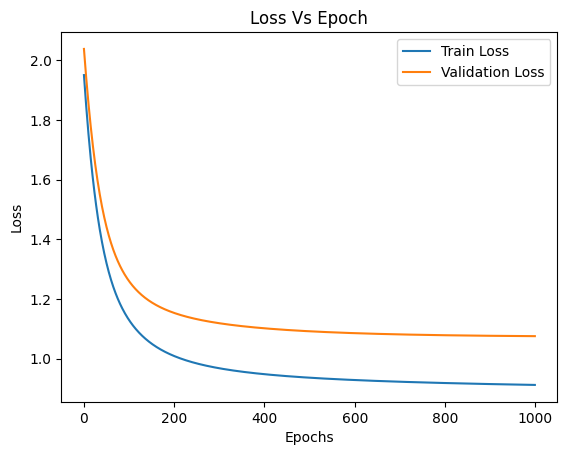

In [8]:
plt.plot(range(num_epochs), train_loss, label='Train Loss')
plt.plot(range(num_epochs), val_loss, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Vs Epoch')
plt.legend()
plt.show()

Now that we have completed the training task, let us see how the model does on the test set by getting the classification report from it.

In [9]:
Y_pred_test = model.forward_prop(X_test)
Test_pred = np.argmax(Y_pred_test, 0)

Loss = model.loss(Y_pred_test, Y_test_oh)

print(f'Loss on the test data is {Loss}')
print(f'Classification report for the Test data is')
print(classification_report(Test_pred, Y_test, zero_division=0))

Loss on the test data is 0.8135494436533136
Classification report for the Test data is
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.83      0.75      0.78        51
           3       0.68      0.68      0.68        50
           4       0.50      0.62      0.55        13
           5       0.00      0.00      0.00         0

    accuracy                           0.70       114
   macro avg       0.40      0.41      0.40       114
weighted avg       0.72      0.70      0.71       114



### Question 2
### Multi Layer Perceptron Classification

Now we will proceed to training the above dataset using a MLP which will give better accuracies on the training set and testing set.

In [10]:
class MLP:

    def __init__(self, lr = 0.0, activation = None, der_activation = None, optimiser = None, hidden_layers = None):
        self.lr = lr
        self.activation = activation
        self.optim = optimiser
        self.hidden = hidden_layers
        self.der_activation = der_activation

    def set_der_activation(self, der_activation):
        self.der_activation = der_activation

    def set_lr(self, lr):
        self.lr = lr

    def set_activation(self, activation):
        self.activation = activation

    def set_optimiser(self, optimiser):
        self.optim = optimiser
    
    def set_hidden(self, hidden):
        self.hidden = hidden

    def sigmoid(self, x):
        return 1/(1 + np.exp(-x))

    def relu(self, x):
        return np.maximum(0, x)
    
    def tanh(self, x):
        return np.tanh(x)

    def softmax(self, x):
        x_max = np.max(x, axis = 0, keepdims=True)
        return np.exp(x - x_max)/np.sum(np.exp(x - x_max), axis = 0, keepdims=True)

    def der_tanh(self, x):
        return 1 - (np.tanh(x)**2)

    def der_relu(self, x):
        return np.where(x > 0, 1, 0)

    def der_sigmoid(self, x):
        return self.sigmoid(x)*(1 - self.sigmoid(x))

    def initialisation(self, input_size, output_size):
        self.params = {}

        self.params['W1'] = np.random.rand(self.hidden[0], input_size)
        self.params['b1'] = np.zeros((self.hidden[0], 1))
        i = 0
        for i in range(1, len(self.hidden)):
            self.params['W'+str(i+1)] = np.random.rand(self.hidden[i], self.hidden[i-1])
            self.params['b'+str(i+1)] = np.zeros((self.hidden[i], 1))
        
        self.params['W'+str(i+2)] = np.random.rand(output_size, self.hidden[-1])
        self.params['b'+str(i+2)] = np.zeros((output_size, 1))

    def forward_prop(self, input):
        cache = {}

        cache['Z1'] = np.dot(self.params['W1'], input.T) + self.params['b1']
        cache['A1'] = self.activation[0](cache['Z1'])

        for i in range(1, len(self.activation)):
            cache['Z'+str(i+1)] = np.dot(self.params['W'+str(i+1)], cache['A'+str(i)]) + self.params['b'+str(i+1)]
            cache['A'+str(i+1)] = self.activation[i](cache['Z'+str(i+1)])

        return cache['A'+str(len(self.activation))], cache

    def loss(self, A, Y):
        m = Y.shape[1]
        return -np.sum(np.log(A + 1e-10)*Y)/m

    def backward_prop(self, cache, X, Y):
        m = X.shape[0]
        self.gradients = {}

        dZ = cache['A'+str(len(self.activation))] - Y
        for i in range(len(self.activation) - 1, 0, -1):
            self.gradients['dW'+str(i+1)] = np.dot(dZ, cache['A' + str(i)].T)/m
            self.gradients['db'+str(i+1)] = np.sum(dZ, axis = 1, keepdims=True)/m
            dZ = np.dot(self.params['W'+str(i+1)].T, dZ) * self.der_activation[i - 1](cache['Z'+str(i)])

        self.gradients['dW1'] = np.dot(dZ, X)/m
        self.gradients['db1'] = np.sum(dZ, axis = 1, keepdims=True)/m 

    def optimisation(self):
        for i in range(len(self.activation)):
            self.params['W'+str(i+1)] -= self.lr*self.gradients['dW'+str(i+1)]
            self.params['b'+str(i+1)] -= self.lr*self.gradients['db'+str(i+1)]

    def gradient_descent(self,X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size,batch_size, MultiLabel = False):
        train_loss = []
        val_loss = []
        self.initialisation(input_size, output_size)
        print('----------BGD--------------')

        for epoch in range(num_epochs):
            Y_pred_train, train_cache = self.forward_prop(X_train)
            Y_pred_val, _ = self.forward_prop(X_val)
            
            Loss_train = self.loss(Y_pred_train, Y_train_oh)
            train_loss.append(Loss_train)

            Loss_val = self.loss(Y_pred_val, Y_val_oh)
            val_loss.append(Loss_val)

            self.backward_prop(train_cache, X_train, Y_train_oh)

            self.optimisation()

            if MultiLabel == False:
                train_pred = np.argmax(Y_pred_train, 0)
                val_pred = np.argmax(Y_pred_val, 0)

                if (epoch+1)%10 == 0:
                    print('----------------------')
                    print(f'Epoch {epoch+1}/{num_epochs}, Training loss {Loss_train}, Validation Loss {Loss_val}, Training accuracy {accuracy_score(Y_train, train_pred)}, Validation accuracy {accuracy_score(Y_val, val_pred)}')
                    print('Classification report for Validation set:')
                    print(classification_report(Y_val, val_pred, zero_division=0))
            else:
                Y_pred_train[Y_pred_train >= 0.5] = 1
                Y_pred_train[Y_pred_train < 0.5] = 0
                Y_pred_val[Y_pred_val >= 0.5] = 1
                Y_pred_val[Y_pred_val < 0.5] = 0

                if (epoch+1)%10 == 0:
                    print('----------------------')
                    print(f'Epoch {epoch+1}/{num_epochs}, Training loss {Loss_train}, Validation Loss {Loss_val}, Training accuracy {1 - hamming_loss(Y_train_oh, Y_pred_train)}, Validation accuracy {1-hamming_loss(Y_val_oh, Y_pred_val)}')
                    print('Classification report for Validation set:')
                    print(classification_report(Y_val_oh.T, Y_pred_val.T, zero_division=0))

        

            data_to_log = {
                'Epoch' : epoch+1,
                'Train Loss' : Loss_train,
                'Validation Loss' : Loss_val,
                'Train Accuracy' : accuracy_score(Y_train, train_pred),
                'Validation Accuracy' : accuracy_score(Y_val, val_pred)
            }

            wandb.log(data_to_log)

        return train_loss, val_loss

      
    def stochastic_gradient_descent(self,X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size,batch_size, MultiLabel = False):
        train_loss = []
        val_loss = []
        self.initialisation(input_size, output_size)
        print('----------SGD--------------')

        for epoch in range(num_epochs):
            Loss_train = 0
            accuracy_train = 0
            for i in range(len(X_train)):
                Y_pred_train, train_cache = self.forward_prop(X_train[i][np.newaxis, :])

                
                Loss_train += self.loss(Y_pred_train, Y_train_oh[:, i][:, np.newaxis])

                self.backward_prop(train_cache, X_train[i][np.newaxis, :], Y_train_oh[:, i][:, np.newaxis])

                self.optimisation()

                if MultiLabel == False:
                    train_pred = np.argmax(Y_pred_train, 0)
                    accuracy_train += accuracy_score([Y_train[i]], train_pred)
                else:
                    Y_pred_train[Y_pred_train >= 0.5] = 1
                    Y_pred_train[Y_pred_train < 0.5] = 0
                    accuracy_train += 1 - hamming_loss(Y_pred_train, Y_train_oh[:,i])

                
            train_loss.append(Loss_train/len(X_train))

            if (epoch+1)%10 == 0:
                print('----------------------')
                print(f'Epoch {epoch+1}/{num_epochs}, Training loss {Loss_train/len(X_train)}, Training accuracy {accuracy_train/len(X_train)}')
            Loss_train = 0
            accuracy_train = 0

            Y_pred_val, _ = self.forward_prop(X_val)
            Loss_val = self.loss(Y_pred_val, Y_val_oh)
            val_loss.append(Loss_val)

            if MultiLabel == False:
                val_pred = np.argmax(Y_pred_val, 0)
                if (epoch + 1)%10 == 0:
                    print(f'Validation loss {Loss_val}, Validation accuracy {accuracy_score(val_pred, Y_val)}')
                    print('Classification Report on the Validation data')
                    print(classification_report(val_pred, Y_val, zero_division=0))
            else:
                Y_pred_val[Y_pred_val >= 0.5] = 1
                Y_pred_val[Y_pred_val < 0.5] = 0

                if (epoch + 1)%10 == 0:
                    print(f'Validation loss {Loss_val}, Validation accuracy {1 - hamming_loss(Y_pred_val, Y_val_oh)}')
                    print('Classification Report on the Validation data')
                    print(classification_report(Y_pred_val.T, Y_val_oh.T, zero_division=0))
        
            data_to_log = {
                    'Epoch' : epoch+1,
                    'Train Loss' : Loss_train/len(X_train),
                    'Validation Loss' : Loss_val,
                    'Train Accuracy' : accuracy_train/len(X_train),
                    'Validation Accuracy' : accuracy_score(Y_val, val_pred)
                }

            wandb.log(data_to_log)
            
        
        return train_loss, val_loss
            
            

      
    def minibatch_gradient_descent(self,X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size, MultiLabel = False):
        train_loss = []
        val_loss = []
        self.initialisation(input_size, output_size)
        print('----------MGD--------------')

        for epoch in range(num_epochs):
            Loss_train = 0
            accuracy_train = 0
            for i in range(len(X_train)//batch_size):
                Y_pred_train, train_cache = self.forward_prop(X_train[i*batch_size:(i+1)*batch_size])

                
                Loss_train += self.loss(Y_pred_train, Y_train_oh[:, i*batch_size:(i+1)*batch_size])

                self.backward_prop(train_cache, X_train[i*batch_size:(i+1)*batch_size], Y_train_oh[:, i*batch_size:(i+1)*batch_size])

                self.optimisation()

                if MultiLabel == False:
                    train_pred = np.argmax(Y_pred_train, 0)
                    accuracy_train += accuracy_score(Y_train[i*batch_size : (i+1)*batch_size], train_pred)
                else:
                    Y_pred_train[Y_pred_train >= 0.5] = 1
                    Y_pred_train[Y_pred_train < 0.5] = 0
                    accuracy_train += 1 - hamming_loss(Y_train_oh[:,i*batch_size : (i+1)*batch_size], Y_pred_train)

            

            if len(X_train)%batch_size != 0:
                Y_pred_train, train_cache = self.forward_prop(X_train[(len(X_train)//batch_size)*batch_size:])

                
                Loss_train += self.loss(Y_pred_train, Y_train_oh[:, (len(X_train)//batch_size)*batch_size:])

                self.backward_prop(train_cache, X_train[(len(X_train)//batch_size)*batch_size:], Y_train_oh[:, (len(X_train)//batch_size)*batch_size:])

                self.optimisation()

                if MultiLabel == False:
                    train_pred = np.argmax(Y_pred_train, 0)
                    accuracy_train += accuracy_score(Y_train[(len(X_train)//batch_size)*batch_size :], train_pred)   
                else:
                    Y_pred_train[Y_pred_train >= 0.5] = 1
                    Y_pred_train[Y_pred_train < 0.5] = 0
                    accuracy_train += 1 - hamming_loss(Y_train_oh[:, (len(X_train)//batch_size)*batch_size :], Y_pred_train)   

                           


            train_loss.append(Loss_train/(len(X_train)//batch_size))

            if (epoch+1)%10 == 0:
                print('----------------------')
                print(f'Epoch {epoch+1}/{num_epochs}, Training loss {Loss_train/(len(X_train)//batch_size)}, Training accuracy {accuracy_train/(len(X_train)//batch_size)}')
            Loss_train = 0
            accuracy_train = 0

            Y_pred_val, _ = self.forward_prop(X_val)
            Loss_val = self.loss(Y_pred_val, Y_val_oh)
            val_loss.append(Loss_val)

            if MultiLabel == False:
                val_pred = np.argmax(Y_pred_val, 0)
                if (epoch + 1)%10 == 0:
                    print(f'Validation loss {Loss_val}, Validation accuracy {accuracy_score(val_pred, Y_val)}')
                    print('Classification Report on the Validation data')
                    print(classification_report(val_pred, Y_val, zero_division=0))
            else:
                Y_pred_val[Y_pred_val >= 0.5] = 1
                Y_pred_val[Y_pred_val < 0.5] = 0
                if (epoch + 1)%10 == 0:
                    print(f'Validation loss {Loss_val}, Validation accuracy {1 - hamming_loss(Y_pred_val, Y_val_oh)}')
                    print('Classification Report on the Validation data')
                    print(classification_report(Y_pred_val.T, Y_val_oh.T, zero_division=0))

            data_to_log = {
                    'Epoch' : epoch+1,
                    'Train Loss' : Loss_train/(len(X_train)//batch_size),
                    'Validation Loss' : Loss_val,
                    'Train Accuracy' : accuracy_train/(len(X_train)//batch_size),
                    'Validation Accuracy' : accuracy_score(Y_val, val_pred)
                }

            wandb.log(data_to_log)
        
        return train_loss, val_loss

    def fit(self, X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size,batch_size, MultiLabel=False):
        return self.optim(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size,batch_size, MultiLabel)


In [12]:
def main1():
    wandb.init(project='SMAI3-2')

    config = wandb.config

    input_size = 11
    output_size = 6
    model = MLP()
    model.set_lr(config['learning_rate'])
    model.set_hidden(config['hidden_layers'])
    batch_size = 100

    if config['activation'] == 'sigmoid':
        activation = [model.sigmoid, model.sigmoid, model.sigmoid, model.softmax]
        der_activation = [model.der_sigmoid, model.der_sigmoid, model.der_sigmoid, model.softmax]

    elif config['activation'] == 'relu':
        activation = [model.relu, model.relu, model.relu, model.softmax]
        der_activation = [model.der_relu, model.der_relu, model.der_relu, model.softmax]

    else :
        activation = [model.tanh, model.tanh, model.tanh, model.softmax]
        der_activation = [model.der_tanh, model.der_tanh, model.der_tanh, model.softmax]
    
    model.set_activation(activation)
    model.set_der_activation(der_activation)

    if config['optimiser'] == 'sgd':
        model.set_optimiser(model.stochastic_gradient_descent)
    elif config['optimiser'] == 'bgd':
        model.set_optimiser(model.gradient_descent)
    else :
        model.set_optimiser(model.minibatch_gradient_descent)

    model.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, config['n_iterations'], input_size, output_size, batch_size)
        
    

sweep_config = {
    'method':'random',
    'metric':{
        'name':'accuracy',
        'goal':'maximize'
    },
    'parameters':{
        'learning_rate':{
            'values':[0.0001, 0.001, 0.01, 0.1]
        },
        'n_iterations':{
            'values':[1000, 5000]
        },
        'optimiser':{
            'values':['sgd', 'bgd', 'mgd']
        },
        'activation':{
            'values':['sigmoid', 'tanh', 'relu']
        },
        'hidden_layers':{
            'values': [[8,8,8],[16,16],[32],[16, 32, 16]]
        }
    }
}


sweep_id = wandb.sweep(sweep=sweep_config, project = 'SMAI3-2')
wandb.agent(sweep_id, function=main1)

wandb.run.name = 'e2.GD.ce'

Create sweep with ID: l1h4v11n
Sweep URL: https://wandb.ai/music-cognition/SMAI3-2/sweeps/l1h4v11n


wandb: Agent Starting Run: 3m47kcaj with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_121336-3m47kcaj
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run scarlet-sweep-1
wandb: ⭐️ View project at https://wandb.ai/music-cognition/SMAI3-2
wandb: 🧹 View sweep at https://wandb.ai/music-cognition/SMAI3-2/sweeps/l1h4v11n
wandb: 🚀 View run at https://wandb.ai/music-cognition/SMAI3-2/runs/3m47kcaj


----------MGD--------------
----------------------
Epoch 10/5000, Training loss 1.2081804876836657, Training accuracy 0.4187499999999999
Validation loss 1.1414629078059362, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 20/5000, Training loss 1.207986958145201, Training accuracy 0.4187499999999999
Validation loss 1.14093664553372, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    r

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4960/5000, Training loss 1.207979515159573, Training accuracy 0.4187499999999999
Validation loss 1.1405453965034462, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 4970/5000, Training loss 1.207979514905519, Training accuracy 0.4187499999999999
Validation loss 1.1405453951793139, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   suppo

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss █▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.14055
wandb: 
wandb: 🚀 View run scarlet-sweep-1 at: https://wandb.ai/music-cognition/SMAI3-2/runs/3m47kcaj
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_121336-3m47kcaj/logs
wandb: Agent Starting Run: va5o1j6p with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 1.6438027978369174, Training accuracy 0.34125
Validation loss 1.6214482927145377, Validation accuracy 0.37554585152838427
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.27      0.38      0.32        77
           3       0.60      0.38      0.47       143
           4       0.10      0.22      0.14         9
           5       0.00      0.00      0.00         0

    accuracy                           0.38       229
   macro avg       0.20      0.20      0.18       229
weighted avg       0.47      0.38      0.40       229

----------------------
Epoch 20/5000, Training loss 1.6199075773957452, Training accuracy 0.34500000000000003
Validation loss 1.6036651028613749, Validation accuracy 0.3799126637554585
Classification Report on the Validation data
              precision    recall 

wandb: Waiting for W&B process to finish... (success).


              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.79      0.65      0.71       130
           3       0.43      0.55      0.48        71
           4       0.35      0.25      0.29        28
           5       0.00      0.00      0.00         0

    accuracy                           0.57       229
   macro avg       0.31      0.29      0.30       229
weighted avg       0.62      0.57      0.59       229



wandb: - 0.346 MB of 0.346 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▂▃▄▃▃▄▅▅▄▅▅█▇▇▇▇▇▇████▇▇▇▇▇▇▇▇▇▇▇▇█████
wandb:     Validation Loss █▇▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.56769
wandb:     Validation Loss 1.0908
wandb: 
wandb: 🚀 View run decent-sweep-2 at: https://wandb.ai/music-cognition/SMAI3-2/runs/va5o1j6p
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_121423-va5o1j6p/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: bsw9t1hl with config:
wandb: 	activation: tanh
wandb: 	hid

----------SGD--------------


wandb: 🚀 View run frosty-sweep-3 at: https://wandb.ai/music-cognition/SMAI3-2/runs/bsw9t1hl
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_121516-bsw9t1hl/logs
Run bsw9t1hl errored: KeyError('W4')
wandb: ERROR Run bsw9t1hl errored: KeyError('W4')
wandb: Agent Starting Run: djsq3bzj with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_121537-djsq3bzj
wandb: Run `wandb

----------MGD--------------
----------------------
Epoch 10/1000, Training loss 2.5427141640267417, Training accuracy 0.026250000000000002
Validation loss 2.637919181293152, Validation accuracy 0.021834061135371178
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.50      0.02      0.05       127
           2       0.00      0.00      0.00         1
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         1
           5       0.40      0.02      0.04        99

    accuracy                           0.02       229
   macro avg       0.18      0.01      0.02       229
weighted avg       0.45      0.02      0.04       229

----------------------
Epoch 20/1000, Training loss 2.519905048211757, Training accuracy 0.026250000000000002
Validation loss 2.6135718451518977, Validation accuracy 0.021834061135371178
Classification Report on the Validation data
              preci

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 1.6638942152801874, Training accuracy 0.24875
Validation loss 1.6652273880563688, Validation accuracy 0.2445414847161572
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         3
           3       0.58      0.41      0.48       128
           4       0.05      0.50      0.09         2
           5       0.40      0.02      0.04        96

    accuracy                           0.24       229
   macro avg       0.21      0.19      0.12       229
weighted avg       0.49      0.24      0.29       229



wandb: \ 0.002 MB of 0.002 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁████████████████████████
wandb:     Validation Loss ██▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.24454
wandb:     Validation Loss 1.66523
wandb: 
wandb: 🚀 View run dutiful-sweep-4 at: https://wandb.ai/music-cognition/SMAI3-2/runs/djsq3bzj
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_121537-djsq3bzj/logs
wandb: Agent Starting Run: cparekuj with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	

----------SGD--------------


wandb: 🚀 View run amber-sweep-5 at: https://wandb.ai/music-cognition/SMAI3-2/runs/cparekuj
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_121600-cparekuj/logs
Run cparekuj errored: KeyError('W3')
wandb: ERROR Run cparekuj errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: j5poarql with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/w

----------MGD--------------


wandb: 🚀 View run neat-sweep-6 at: https://wandb.ai/music-cognition/SMAI3-2/runs/j5poarql
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_121626-j5poarql/logs
Run j5poarql errored: KeyError('W4')
wandb: ERROR Run j5poarql errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: skqestup with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignme

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 2.0169663490037246, Validation Loss 2.0331973120069358, Training accuracy 0.01, Validation accuracy 0.013100436681222707
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.02      0.60      0.04         5

    accuracy                           0.01       229
   macro avg       0.00      0.10      0.01       229
weighted avg       0.00      0.01      0.00       229

----------------------
Epoch 20/1000, Training loss 2.015643253851867, Validation Loss 2.031774446444778, Training accuracy 0.01, Validation accuracy 0.013100436681222707
Classification report for Validation set:
 

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 960/1000, Training loss 1.910290067956921, Validation Loss 1.9176681030936673, Training accuracy 0.0125, Validation accuracy 0.021834061135371178
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00       107
           3       0.67      0.02      0.04        91
           4       0.00      0.00      0.00        20
           5       0.02      0.60      0.04         5

    accuracy                           0.02       229
   macro avg       0.11      0.10      0.01       229
weighted avg       0.27      0.02      0.02       229

----------------------
Epoch 970/1000, Training loss 1.9093525978552879, Validation Loss 1.9166446128085428, Training accuracy 0.0125, Validation accuracy 0.021834061135371178
Classification report for Validation set:
              precisio

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█
wandb:          Train Loss ███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█
wandb:     Validation Loss ███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.22625
wandb:          Train Loss 1.90656
wandb: Validation Accuracy 0.23581
wandb:     Validation Loss 1.9136
wandb: 
wandb: 🚀 View run glamorous-sweep-7 at: https://wandb.ai/music-cognition/SMAI3-2/runs/skqestup
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_121653-skqestup/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ddcivxdc with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 2.035706013223016, Validation Loss 2.0376444170327943, Training accuracy 0.01, Validation accuracy 0.017467248908296942
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00       107
           3       0.17      0.01      0.02        91
           4       0.00      0.00      0.00        20
           5       0.02      0.60      0.05         5

    accuracy                           0.02       229
   macro avg       0.03      0.10      0.01       229
weighted avg       0.07      0.02      0.01       229

----------------------
Epoch 20/1000, Training loss 1.9533423447594984, Validation Loss 1.9548751721453885, Training accuracy 0.01, Validation accuracy 0.017467248908296942
Classification report for Validation set:


wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 920/1000, Training loss 1.2714443216975908, Validation Loss 1.2183161874719202, Training accuracy 0.4175, Validation accuracy 0.3930131004366812
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.40      0.38      0.39       107
           3       0.39      0.54      0.45        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.39       229
   macro avg       0.16      0.18      0.17       229
weighted avg       0.34      0.39      0.36       229

----------------------
Epoch 930/1000, Training loss 1.2703857699658914, Validation Loss 1.2170622984542303, Training accuracy 0.4175, Validation accuracy 0.3930131004366812
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00 

wandb: \ 0.076 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▅▅███████████████████████████████████
wandb:          Train Loss █▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▆▆███████████████████████████████████
wandb:     Validation Loss █▆▆▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.4175
wandb:          Train Loss 1.26357
wandb: Validation Accuracy 0.39301
wandb:     Validation Loss 1.209
wandb: 
wandb: 🚀 View run fanciful-sweep-8 at: https://wandb.ai/music-cognition/SMAI3-2/runs/ddcivxdc
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_121720-ddcivxdc/logs
wandb: Agent Starting Run: yyd10r9w with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
w

----------SGD--------------
----------------------
Epoch 10/1000, Training loss 1.2216856150964608, Training accuracy 0.3925
Validation loss 1.1793012473750706, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 20/1000, Training loss 1.22168541938565, Training accuracy 0.3925
Validation loss 1.1792948655861746, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   suppo

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 1.2216854191529798, Training accuracy 0.3925
Validation loss 1.1792948583942027, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229



wandb: / 0.076 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.17929
wandb: 
wandb: 🚀 View run snowy-sweep-9 at: https://wandb.ai/music-cognition/SMAI3-2/runs/yyd10r9w
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_121752-yyd10r9w/logs
wandb: Agent Starting Run: jzeavgtx with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n

----------MGD--------------


wandb: 🚀 View run woven-sweep-10 at: https://wandb.ai/music-cognition/SMAI3-2/runs/jzeavgtx
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122253-jzeavgtx/logs
Run jzeavgtx errored: KeyError('W4')
wandb: ERROR Run jzeavgtx errored: KeyError('W4')
wandb: Agent Starting Run: 3bnjhm0g with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_122304-3bnjhm0g
wandb: Run `wandb offli

----------SGD--------------


wandb: 🚀 View run proud-sweep-11 at: https://wandb.ai/music-cognition/SMAI3-2/runs/3bnjhm0g
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122304-3bnjhm0g/logs
Run 3bnjhm0g errored: KeyError('W4')
wandb: ERROR Run 3bnjhm0g errored: KeyError('W4')
wandb: Agent Starting Run: i9id4760 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_122316-i9id4760
wandb: Run `wandb 

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 2.039618244127623, Validation Loss 2.002763977376307, Training accuracy 0.0325, Validation accuracy 0.026200873362445413
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.03      1.00      0.05         6
           2       0.00      0.00      0.00       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.03       229
   macro avg       0.01      0.20      0.01       229
weighted avg       0.00      0.03      0.00       229

----------------------
Epoch 20/1000, Training loss 2.0181279008847115, Validation Loss 1.9804584019210127, Training accuracy 0.0325, Validation accuracy 0.026200873362445413
Classification report for Validation set:
              precision    recall  f1-score   suppo

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 980/1000, Training loss 1.3252170239234249, Validation Loss 1.2575076625567398, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.47      1.00      0.64       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.47       229
   macro avg       0.09      0.20      0.13       229
weighted avg       0.22      0.47      0.30       229

----------------------
Epoch 990/1000, Training loss 1.3236065788810543, Validation Loss 1.2558243080998674, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00 

wandb: / 0.076 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁███████████████████████████████████
wandb:          Train Loss ██▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁███████████████████████████████████
wandb:     Validation Loss ██▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.4125
wandb:          Train Loss 1.32203
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.25418
wandb: 
wandb: 🚀 View run decent-sweep-12 at: https://wandb.ai/music-cognition/SMAI3-2/runs/i9id4760
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122316-i9id4760/logs
wandb: Agent Starting Run: ihsm7gd2 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001

----------MGD--------------


wandb: 🚀 View run swept-sweep-13 at: https://wandb.ai/music-cognition/SMAI3-2/runs/ihsm7gd2
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122331-ihsm7gd2/logs
Run ihsm7gd2 errored: KeyError('W4')
wandb: ERROR Run ihsm7gd2 errored: KeyError('W4')
wandb: Agent Starting Run: ejc0p0bl with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_122342-ejc0p0bl
wandb: Run `wandb of

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 1.6733244349603746, Validation Loss 1.6639395115988747, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.47      1.00      0.64       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.47       229
   macro avg       0.09      0.20      0.13       229
weighted avg       0.22      0.47      0.30       229

----------------------
Epoch 20/1000, Training loss 1.5519116096550487, Validation Loss 1.5306047741670203, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 990/1000, Training loss 1.2044237095984383, Validation Loss 1.1396762002911052, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.47      1.00      0.64       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.47       229
   macro avg       0.09      0.20      0.13       229
weighted avg       0.22      0.47      0.30       229

----------------------
Epoch 1000/1000, Training loss 1.2044006353519723, Validation Loss 1.1396551368747854, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00

wandb: | 0.002 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss █▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss █▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.4125
wandb:          Train Loss 1.2044
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.13966
wandb: 
wandb: 🚀 View run sparkling-sweep-14 at: https://wandb.ai/music-cognition/SMAI3-2/runs/ejc0p0bl
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122342-ejc0p0bl/logs
wandb: Agent Starting Run: 8mp9capy with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate:

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 1.3273564459012477, Validation Loss 1.2952026529963316, Training accuracy 0.40125, Validation accuracy 0.39737991266375544
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00       107
           3       0.40      1.00      0.57        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.40       229
   macro avg       0.08      0.20      0.11       229
weighted avg       0.16      0.40      0.23       229

----------------------
Epoch 20/1000, Training loss 1.2395630491312066, Validation Loss 1.17696278946729, Training accuracy 0.39875, Validation accuracy 0.43231441048034935
Classification report for Validation set:
              precision    recall  f1-score   suppo

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 960/1000, Training loss 1.203892619765295, Validation Loss 1.138472212846922, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.47      1.00      0.64       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.47       229
   macro avg       0.09      0.20      0.13       229
weighted avg       0.22      0.47      0.30       229

----------------------
Epoch 970/1000, Training loss 1.2038907231934732, Validation Loss 1.1384716656491738, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00   

wandb: / 0.002 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁███████████████████████████████████████
wandb:          Train Loss █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁███████████████████████████████████████
wandb:     Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.4125
wandb:          Train Loss 1.20389
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.13847
wandb: 
wandb: 🚀 View run dark-sweep-15 at: https://wandb.ai/music-cognition/SMAI3-2/runs/8mp9capy
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122358-8mp9capy/logs
wandb: Agent Starting Run: 08fxsoqd with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wan

----------MGD--------------


wandb: 🚀 View run misunderstood-sweep-16 at: https://wandb.ai/music-cognition/SMAI3-2/runs/08fxsoqd
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122414-08fxsoqd/logs
Run 08fxsoqd errored: KeyError('W3')
wandb: ERROR Run 08fxsoqd errored: KeyError('W3')
wandb: Agent Starting Run: a3huuqgc with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_122426-a3huuqgc
wandb: Run `wandb o

----------SGD--------------


wandb: 🚀 View run azure-sweep-17 at: https://wandb.ai/music-cognition/SMAI3-2/runs/a3huuqgc
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122426-a3huuqgc/logs
Run a3huuqgc errored: KeyError('W3')
wandb: ERROR Run a3huuqgc errored: KeyError('W3')
wandb: Agent Starting Run: mmexybls with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_122437-mmexybls
wandb: Run `wandb of

----------SGD--------------
----------------------
Epoch 10/1000, Training loss 1.5977856925808114, Training accuracy 0.42125
Validation loss 1.6722173923132118, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.99      0.48      0.64       223
           3       0.00      0.00      0.00         0
           4       0.05      0.17      0.08         6
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.21      0.13      0.14       229
weighted avg       0.97      0.47      0.63       229

----------------------
Epoch 20/1000, Training loss 1.4942761610311328, Training accuracy 0.425
Validation loss 1.5495783029799053, Validation accuracy 0.4585152838427948
Classification Report on the Validation data
              precision    recall  f1-score   sup

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 0.8833094748751126, Training accuracy 0.6125
Validation loss 1.0794942504721639, Validation accuracy 0.5676855895196506
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.17      0.50      0.25         2
           2       0.80      0.66      0.72       131
           3       0.38      0.56      0.45        63
           4       0.40      0.24      0.30        33
           5       0.00      0.00      0.00         0

    accuracy                           0.57       229
   macro avg       0.35      0.39      0.35       229
weighted avg       0.62      0.57      0.58       229



wandb: - 0.076 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▂▃▂▃▃▃▃▃▃▄▄▄▄▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▇▇████
wandb:     Validation Loss █▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.56769
wandb:     Validation Loss 1.07949
wandb: 
wandb: 🚀 View run distinctive-sweep-18 at: https://wandb.ai/music-cognition/SMAI3-2/runs/mmexybls
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122437-mmexybls/logs
wandb: Agent Starting Run: auyc6w0k with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01

----------SGD--------------


wandb: 🚀 View run fresh-sweep-19 at: https://wandb.ai/music-cognition/SMAI3-2/runs/auyc6w0k
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_122944-auyc6w0k/logs
Run auyc6w0k errored: KeyError('W4')
wandb: ERROR Run auyc6w0k errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: xi9oobpv with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment

----------BGD--------------


wandb: 🚀 View run playful-sweep-20 at: https://wandb.ai/music-cognition/SMAI3-2/runs/xi9oobpv
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_123005-xi9oobpv/logs
Run xi9oobpv errored: KeyError('W4')
wandb: ERROR Run xi9oobpv errored: KeyError('W4')
wandb: Agent Starting Run: 9kgzrfw3 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_123017-9kgzrfw3
wandb: Run `wan

----------SGD--------------
----------------------
Epoch 10/1000, Training loss 1.3294693634423966, Training accuracy 0.4125
Validation loss 1.2695071876167952, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 20/1000, Training loss 1.2462805224261673, Training accuracy 0.4125
Validation loss 1.181865732972738, Validation accuracy 0.45414847161572053
Classification Report on the Validation data
              precision    recall  f1-score   sup

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 1.204254351396249, Training accuracy 0.4075
Validation loss 1.1406530834052129, Validation accuracy 0.4192139737991266
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.85      0.44      0.58       207
           3       0.05      0.23      0.09        22
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.42       229
   macro avg       0.18      0.13      0.13       229
weighted avg       0.77      0.42      0.53       229



wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy █▁▃▃▃▃▃▃▃▃▃▃▄▄▂▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▁▁
wandb:     Validation Loss █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.41921
wandb:     Validation Loss 1.14065
wandb: 
wandb: 🚀 View run fallen-sweep-21 at: https://wandb.ai/music-cognition/SMAI3-2/runs/9kgzrfw3
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_123017-9kgzrfw3/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7qvi97tp with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rat

----------SGD--------------
----------------------
Epoch 10/1000, Training loss 1.207963591096196, Training accuracy 0.4125
Validation loss 1.1426112990412498, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 20/1000, Training loss 1.2076219686893932, Training accuracy 0.4125
Validation loss 1.140823446151882, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   suppo

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 1.2075934137947444, Training accuracy 0.4125
Validation loss 1.1401003167963928, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229



wandb: \ 0.076 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.1401
wandb: 
wandb: 🚀 View run lively-sweep-22 at: https://wandb.ai/music-cognition/SMAI3-2/runs/7qvi97tp
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_123551-7qvi97tp/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: pr1lt2xs with config:
wandb: 	activation: tanh
wandb: 	hi

----------MGD--------------
----------------------
Epoch 10/1000, Training loss 2.101757695588216, Training accuracy 0.2375
Validation loss 2.1966423317457866, Validation accuracy 0.20087336244541484
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.38      0.41      0.40        99
           3       0.00      0.00      0.00         1
           4       0.25      0.04      0.07       129
           5       0.00      0.00      0.00         0

    accuracy                           0.20       229
   macro avg       0.13      0.09      0.09       229
weighted avg       0.31      0.20      0.21       229

----------------------
Epoch 20/1000, Training loss 2.0866433165855254, Training accuracy 0.2375
Validation loss 2.1792030136537353, Validation accuracy 0.20087336244541484
Classification Report on the Validation data
              precision    recall  f1-score   su

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 970/1000, Training loss 1.6561901261424965, Training accuracy 0.41875000000000007
Validation loss 1.6515426744794621, Validation accuracy 0.4017467248908297
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       0.00      0.00      0.00         1
           2       0.38      0.41      0.40       100
           3       0.56      0.40      0.47       127
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.40       229
   macro avg       0.16      0.14      0.14       229
weighted avg       0.48      0.40      0.43       229

----------------------
Epoch 980/1000, Training loss 1.6549039655189364, Training accuracy 0.41875000000000007
Validation loss 1.6498742190898035, Validation accuracy 0.4017467248908297
Classification Report on the Validation 

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁██████████████████████
wandb:     Validation Loss █▇▇▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.40175
wandb:     Validation Loss 1.64659
wandb: 
wandb: 🚀 View run fine-sweep-23 at: https://wandb.ai/music-cognition/SMAI3-2/runs/pr1lt2xs
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124148-pr1lt2xs/logs
wandb: Agent Starting Run: leotzelj with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/l

----------BGD--------------
----------------------
Epoch 10/5000, Training loss 1.3244738392685225, Validation Loss 1.2734699550211304, Training accuracy 0.40125, Validation accuracy 0.39737991266375544
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00       107
           3       0.40      1.00      0.57        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.40       229
   macro avg       0.08      0.20      0.11       229
weighted avg       0.16      0.40      0.23       229

----------------------
Epoch 20/5000, Training loss 1.2424156692954018, Validation Loss 1.1780975930200541, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   suppo

wandb: Waiting for W&B process to finish... (success).


              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.47      1.00      0.64       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.47       229
   macro avg       0.09      0.20      0.13       229
weighted avg       0.22      0.47      0.30       229

----------------------
Epoch 4970/5000, Training loss 1.203346519261724, Validation Loss 1.1374224366765948, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.47      1.00      0.64       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.00 

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss █▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss █▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.4125
wandb:          Train Loss 1.20334
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.13741
wandb: 
wandb: 🚀 View run expert-sweep-24 at: https://wandb.ai/music-cognition/SMAI3-2/runs/leotzelj
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124214-leotzelj/logs
wandb: Agent Starting Run: rwsuk0c8 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser:

----------BGD--------------


wandb: 🚀 View run lilac-sweep-25 at: https://wandb.ai/music-cognition/SMAI3-2/runs/rwsuk0c8
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124247-rwsuk0c8/logs
Run rwsuk0c8 errored: KeyError('W4')
wandb: ERROR Run rwsuk0c8 errored: KeyError('W4')
wandb: Agent Starting Run: 38k7rcbk with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_124310-38k7rcbk
wandb: Run `wandb offl

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 3.709559529715794, Validation Loss 3.5914739061832437, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.47      1.00      0.64       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.47       229
   macro avg       0.09      0.20      0.13       229
weighted avg       0.22      0.47      0.30       229

----------------------
Epoch 20/1000, Training loss 4.233660246175578, Validation Loss 4.102310453457561, Training accuracy 0.39, Validation accuracy 0.3930131004366812
Classification report for Validation set:
              precision    recall  f1-score   support

   

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 960/1000, Training loss 1.0728030198293679, Validation Loss 1.146347448978896, Training accuracy 0.5225, Validation accuracy 0.4847161572052402
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.65      0.36      0.47       107
           3       0.43      0.77      0.55        91
           4       0.29      0.10      0.15        20
           5       0.00      0.00      0.00         5

    accuracy                           0.48       229
   macro avg       0.27      0.25      0.23       229
weighted avg       0.50      0.48      0.45       229

----------------------
Epoch 970/1000, Training loss 1.0710193092447051, Validation Loss 1.145223473555425, Training accuracy 0.5225, Validation accuracy 0.4847161572052402
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00   

wandb: | 0.076 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▄▄▄▄▄▄▄▄▄▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇█▇▇██████████
wandb:          Train Loss ▆▅█▄▅▃▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▄▄▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇██████▇▇▇▇▇▇▇
wandb:     Validation Loss ▇▅█▅▆▃▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.55875
wandb:          Train Loss 1.06591
wandb: Validation Accuracy 0.56769
wandb:     Validation Loss 1.14197
wandb: 
wandb: 🚀 View run twilight-sweep-26 at: https://wandb.ai/music-cognition/SMAI3-2/runs/38k7rcbk
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124310-38k7rcbk/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: aor7a427 with config:
wandb: 	activation: relu

----------MGD--------------
----------------------
Epoch 10/1000, Training loss 4.2375464247982535, Training accuracy 0.36374999999999996
Validation loss 4.12031091221501, Validation accuracy 0.40611353711790393
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.17      0.03      0.05        38
           2       0.83      0.48      0.61       187
           3       0.03      0.75      0.06         4
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.41       229
   macro avg       0.21      0.25      0.14       229
weighted avg       0.71      0.41      0.50       229

----------------------
Epoch 20/1000, Training loss 4.1955574789970305, Training accuracy 0.3425
Validation loss 4.123749987137517, Validation accuracy 0.34497816593886466
Classification Report on the Validation data
              precision    recall  f1

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 980/1000, Training loss 2.215975025417165, Training accuracy 0.46375000000000005
Validation loss 2.166415686605497, Validation accuracy 0.48034934497816595
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         1
           2       0.35      0.62      0.44        60
           3       0.80      0.43      0.56       168
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.48       229
   macro avg       0.23      0.21      0.20       229
weighted avg       0.68      0.48      0.53       229

----------------------
Epoch 990/1000, Training loss 2.3512216369419563, Training accuracy 0.46124999999999994
Validation loss 2.032591746804852, Validation accuracy 0.4366812227074236
Classification Report on the Validation data
              precision    recall  f1-score   suppo

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▇▂▁▁▂▂▂▂▃▃▃▃▂▃▃▃▃▃▃▄▄▄▄▄▅▅▄▄▄▄▆▅▆▆▅▇▅██▅
wandb:     Validation Loss █▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▄▁▄▂▁▃▁▃▁▂▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.41921
wandb:     Validation Loss 2.04919
wandb: 
wandb: 🚀 View run scarlet-sweep-27 at: https://wandb.ai/music-cognition/SMAI3-2/runs/aor7a427
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124343-aor7a427/logs
wandb: Agent Starting Run: 0uek6vmx with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd


----------MGD--------------
----------------------
Epoch 10/5000, Training loss 4.225320471112517, Training accuracy 0.33875
Validation loss 4.156210612020849, Validation accuracy 0.37117903930131
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         5
           2       0.57      0.42      0.48       146
           3       0.24      0.33      0.28        66
           4       0.10      0.17      0.12        12
           5       0.00      0.00      0.00         0

    accuracy                           0.37       229
   macro avg       0.18      0.18      0.18       229
weighted avg       0.44      0.37      0.39       229

----------------------
Epoch 20/5000, Training loss 3.9610357005406227, Training accuracy 0.34125000000000005
Validation loss 3.934613670444517, Validation accuracy 0.3231441048034934
Classification Report on the Validation data
              precision    recall  f1-sc

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4980/5000, Training loss 1.374744515375583, Training accuracy 0.52125
Validation loss 1.3551279470855861, Validation accuracy 0.5545851528384279
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.79      0.59      0.68       143
           3       0.43      0.50      0.46        78
           4       0.15      0.38      0.21         8
           5       0.00      0.00      0.00         0

    accuracy                           0.55       229
   macro avg       0.27      0.29      0.27       229
weighted avg       0.65      0.55      0.59       229

----------------------
Epoch 4990/5000, Training loss 1.5718285087126826, Training accuracy 0.5125000000000001
Validation loss 1.4987079441848759, Validation accuracy 0.5633187772925764
Classification Report on the Validation data
              precision    recall  f1-score   support

      

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▃▃▃▃▃▄▂▅▅▇▅▇▇▆▇▇▇▇▇▇▆▆▇█▇▇▇█▇█▇▇▇▇▇█▇▇▇
wandb:     Validation Loss ▆▆████▃▄▄▄▃▄▂▂▃▂▂▂▂▃▂▂▂▁▁▂▂▂▁▁▁▁▁▁▂▂▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.55459
wandb:     Validation Loss 1.35196
wandb: 
wandb: 🚀 View run cosmic-sweep-28 at: https://wandb.ai/music-cognition/SMAI3-2/runs/0uek6vmx
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124409-0uek6vmx/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: eiy5iq51 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.00

----------BGD--------------


wandb: 🚀 View run dutiful-sweep-29 at: https://wandb.ai/music-cognition/SMAI3-2/runs/eiy5iq51
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124506-eiy5iq51/logs
Run eiy5iq51 errored: KeyError('W4')
wandb: ERROR Run eiy5iq51 errored: KeyError('W4')
wandb: Agent Starting Run: f1o1s3ti with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_124537-f1o1s3ti
wandb: Run `wandb

----------BGD--------------


wandb: 🚀 View run avid-sweep-30 at: https://wandb.ai/music-cognition/SMAI3-2/runs/f1o1s3ti
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124537-f1o1s3ti/logs
Run f1o1s3ti errored: KeyError('W4')
wandb: ERROR Run f1o1s3ti errored: KeyError('W4')
wandb: Agent Starting Run: uxeh8in3 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_124558-uxeh8in3
wandb: Run `wandb offl

----------BGD--------------


wandb: 🚀 View run eternal-sweep-31 at: https://wandb.ai/music-cognition/SMAI3-2/runs/uxeh8in3
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124558-uxeh8in3/logs
Run uxeh8in3 errored: KeyError('W4')
wandb: ERROR Run uxeh8in3 errored: KeyError('W4')
wandb: Agent Starting Run: g9mhtoug with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_124619-g9mhtoug
wandb: Run `w

----------BGD--------------
----------------------
Epoch 10/5000, Training loss 2.0966699349611533, Validation Loss 2.1301273477873566, Training accuracy 0.40125, Validation accuracy 0.39737991266375544
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00       107
           3       0.40      1.00      0.57        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.40       229
   macro avg       0.08      0.20      0.11       229
weighted avg       0.16      0.40      0.23       229

----------------------
Epoch 20/5000, Training loss 2.059756001012098, Validation Loss 2.09024848743372, Training accuracy 0.40125, Validation accuracy 0.39737991266375544
Classification report for Validation set:
              precision    recall  f1-score   suppor

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000, Training loss 1.2055341179929457, Validation Loss 1.1397715956148926, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.47      1.00      0.64       107
           3       0.00      0.00      0.00        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.47       229
   macro avg       0.09      0.20      0.13       229
weighted avg       0.22      0.47      0.30       229

----------------------
Epoch 5000/5000, Training loss 1.2055233788227766, Validation Loss 1.1397654481438382, Training accuracy 0.4125, Validation accuracy 0.4672489082969432
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.0

wandb: \ 0.344 MB of 0.344 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁█████████████████████████████████
wandb:          Train Loss █▆▄▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁█████████████████████████████████
wandb:     Validation Loss █▆▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.4125
wandb:          Train Loss 1.20552
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.13977
wandb: 
wandb: 🚀 View run fast-sweep-32 at: https://wandb.ai/music-cognition/SMAI3-2/runs/g9mhtoug
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124619-g9mhtoug/logs
wandb: Agent Starting Run: xsutlbpv with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
w

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 1.0726723812492727, Training accuracy 0.52625
Validation loss 1.0572805234196474, Validation accuracy 0.5633187772925764
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.75      0.62      0.68       128
           3       0.54      0.49      0.51       101
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.56       229
   macro avg       0.26      0.22      0.24       229
weighted avg       0.66      0.56      0.61       229

----------------------
Epoch 20/5000, Training loss 0.9590502822219444, Training accuracy 0.5875
Validation loss 1.0402497431026996, Validation accuracy 0.5676855895196506
Classification Report on the Validation data
              precision    recall  f1-score   su

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 0.7563444919756895, Training accuracy 0.68875
Validation loss 1.3506751448748457, Validation accuracy 0.48034934497816595
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         1
           2       0.64      0.62      0.63       111
           3       0.37      0.41      0.39        83
           4       0.35      0.21      0.26        34
           5       0.00      0.00      0.00         0

    accuracy                           0.48       229
   macro avg       0.27      0.25      0.26       229
weighted avg       0.50      0.48      0.49       229



wandb: - 0.350 MB of 0.350 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▆▄▅▄▄▄▄▆▇▅▅▅▆▄▇▄▄▆▇▆▆█▅▅▅▇▅▅▄▅▄▂▄▃▁▃▄▃▅▃
wandb:     Validation Loss ▁▅▆█▇██▇▆▆▅▆▅▇▅▅▅▄▅▄▄▄▄▅▄▄▃▄▆▆▇▄▃▄▄▅▃▄▂▅
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.48035
wandb:     Validation Loss 1.35068
wandb: 
wandb: 🚀 View run cool-sweep-33 at: https://wandb.ai/music-cognition/SMAI3-2/runs/xsutlbpv
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_124657-xsutlbpv/logs
wandb: Agent Starting Run: 2o17mq4t with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wand

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 1.299151569029232, Training accuracy 0.41
Validation loss 1.2337383797167785, Validation accuracy 0.4279475982532751
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.43      0.46      0.44       100
           3       0.57      0.40      0.47       129
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.43       229
   macro avg       0.20      0.17      0.18       229
weighted avg       0.51      0.43      0.46       229

----------------------
Epoch 20/5000, Training loss 1.2366209708125657, Training accuracy 0.41625
Validation loss 1.1695050228451151, Validation accuracy 0.4279475982532751
Classification Report on the Validation data
              precision    recall  f1-score   suppo

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 0.7556294603484878, Training accuracy 0.70125
Validation loss 1.4793991616946764, Validation accuracy 0.5589519650655022
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.66      0.66      0.66       108
           3       0.53      0.51      0.52        95
           4       0.45      0.35      0.39        26
           5       0.00      0.00      0.00         0

    accuracy                           0.56       229
   macro avg       0.33      0.30      0.31       229
weighted avg       0.58      0.56      0.57       229



wandb: \ 0.102 MB of 0.351 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▃▃▄▄▅▅▅▅▅▄▄▄▄▄▅▅▆▅▄▅▅▆▆▇▇▇█████▇▇▇▇▇▇▇
wandb:     Validation Loss ▁▁▁▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▂▂▃▃▃▃▃▃▂▃▅▅▆▆▆▆▇▇▇███
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.55895
wandb:     Validation Loss 1.4794
wandb: 
wandb: 🚀 View run classic-sweep-34 at: https://wandb.ai/music-cognition/SMAI3-2/runs/2o17mq4t
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_132152-2o17mq4t/logs
wandb: Agent Starting Run: jtbc8kxh with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb:

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 2.0630914907037243, Training accuracy 0.41625
Validation loss 2.1697806587142794, Validation accuracy 0.39737991266375544
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         1
           2       0.00      0.00      0.00         0
           3       1.00      0.40      0.57       228
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.40       229
   macro avg       0.20      0.08      0.11       229
weighted avg       1.00      0.40      0.57       229

----------------------
Epoch 20/5000, Training loss 1.7660927784773865, Training accuracy 0.41625
Validation loss 1.730963069043776, Validation accuracy 0.39737991266375544
Classification Report on the Validation data
              precision    recall  f1-score   

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4980/5000, Training loss 0.7628323234116745, Training accuracy 0.66625
Validation loss 1.3350487738985504, Validation accuracy 0.5589519650655022
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         3
           2       0.76      0.64      0.70       126
           3       0.45      0.53      0.49        78
           4       0.30      0.27      0.29        22
           5       0.00      0.00      0.00         0

    accuracy                           0.56       229
   macro avg       0.30      0.29      0.29       229
weighted avg       0.60      0.56      0.58       229

----------------------
Epoch 4990/5000, Training loss 0.7627020254140708, Training accuracy 0.66625
Validation loss 1.3361978956098024, Validation accuracy 0.5589519650655022
Classification Report on the Validation data
              precision    recall  f1-score   support

           1    

wandb: | 0.361 MB of 0.361 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▄▂▅▆▇▇▇▆▇▆▆▆▇▇▇▇██▇▇▇▇▇▇▇▇██▇▇▇▇▇▄▅▆▆▆▆
wandb:     Validation Loss ▆▂▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▅▅▅▆▆▆▆▇▇▇██
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.55895
wandb:     Validation Loss 1.33742
wandb: 
wandb: 🚀 View run devout-sweep-35 at: https://wandb.ai/music-cognition/SMAI3-2/runs/jtbc8kxh
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_135434-jtbc8kxh/logs
wandb: Agent Starting Run: 8pu24h5b with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb:

----------MGD--------------
----------------------
Epoch 10/1000, Training loss 2.6878595488057573, Training accuracy 0.38125000000000003
Validation loss 3.3771697200293227, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 20/1000, Training loss 2.018083400745818, Training accuracy 0.39125
Validation loss 2.4932294124816803, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 980/1000, Training loss 0.9037001611724036, Training accuracy 0.605
Validation loss 1.078525613078105, Validation accuracy 0.5676855895196506
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         1
           2       0.79      0.64      0.70       132
           3       0.42      0.57      0.48        67
           4       0.40      0.28      0.33        29
           5       0.00      0.00      0.00         0

    accuracy                           0.57       229
   macro avg       0.32      0.30      0.30       229
weighted avg       0.63      0.57      0.59       229

----------------------
Epoch 990/1000, Training loss 0.9026860720858491, Training accuracy 0.605
Validation loss 1.078760407040638, Validation accuracy 0.5676855895196506
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00 

wandb: | 0.076 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▂▁▂▄▄▄▆▆▇▇▆▆▆▇▇▆▆▆▇▇▇▇▇█▇▇█████████▇█▇▇▇
wandb:     Validation Loss █▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.56769
wandb:     Validation Loss 1.07877
wandb: 
wandb: 🚀 View run classic-sweep-36 at: https://wandb.ai/music-cognition/SMAI3-2/runs/8pu24h5b
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_135526-8pu24h5b/logs
wandb: Agent Starting Run: wtf1kwer with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 1.2608676518479136, Training accuracy 0.4125
Validation loss 1.1837213818321017, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 20/5000, Training loss 1.2169913414914213, Training accuracy 0.4125
Validation loss 1.1449688600411172, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   sup

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000, Training loss 1.2040163424836083, Training accuracy 0.4125
Validation loss 1.1384378013214922, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 5000/5000, Training loss 1.2040163424753096, Training accuracy 0.4125
Validation loss 1.138437801282965, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       

wandb: / 0.344 MB of 0.344 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁██▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.13844
wandb: 
wandb: 🚀 View run super-sweep-37 at: https://wandb.ai/music-cognition/SMAI3-2/runs/wtf1kwer
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_135605-wtf1kwer/logs
wandb: Agent Starting Run: z0oezxnz with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_

----------MGD--------------


wandb: 🚀 View run morning-sweep-38 at: https://wandb.ai/music-cognition/SMAI3-2/runs/z0oezxnz
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_135703-z0oezxnz/logs
Run z0oezxnz errored: KeyError('W3')
wandb: ERROR Run z0oezxnz errored: KeyError('W3')
wandb: Agent Starting Run: btaaa7mx with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_135730-btaaa7mx
wandb: Run `wandb 

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 1.6374995017945377, Training accuracy 0.38875
Validation loss 1.6447702006104967, Validation accuracy 0.4192139737991266
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.49      0.44      0.46       119
           3       0.48      0.40      0.44       110
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.42       229
   macro avg       0.19      0.17      0.18       229
weighted avg       0.48      0.42      0.45       229

----------------------
Epoch 20/5000, Training loss 1.5536605892035267, Training accuracy 0.40375
Validation loss 1.5522483031798833, Validation accuracy 0.4192139737991266
Classification Report on the Validation data
              precision    recall  f1-score   s

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 0.7748532168278435, Training accuracy 0.665
Validation loss 1.2551594060060778, Validation accuracy 0.5982532751091703
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.81      0.68      0.74       128
           3       0.48      0.56      0.52        78
           4       0.30      0.27      0.29        22
           5       0.00      0.00      0.00         1

    accuracy                           0.60       229
   macro avg       0.32      0.30      0.31       229
weighted avg       0.65      0.60      0.62       229



wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▅▆▆▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇█████████▇▇▇▇▇██▇▇▇▇
wandb:     Validation Loss █▂▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▆▆▆▇
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.59825
wandb:     Validation Loss 1.25516
wandb: 
wandb: 🚀 View run glorious-sweep-39 at: https://wandb.ai/music-cognition/SMAI3-2/runs/btaaa7mx
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_135730-btaaa7mx/logs
wandb: Agent Starting Run: iy0lscow with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/l

----------SGD--------------


wandb: 🚀 View run graceful-sweep-40 at: https://wandb.ai/music-cognition/SMAI3-2/runs/iy0lscow
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_143736-iy0lscow/logs
Run iy0lscow errored: KeyError('W3')
wandb: ERROR Run iy0lscow errored: KeyError('W3')
wandb: Agent Starting Run: pw5eil9a with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_143759-pw5eil9a
wandb: Run `wandb 

----------MGD--------------


wandb: 🚀 View run effortless-sweep-41 at: https://wandb.ai/music-cognition/SMAI3-2/runs/pw5eil9a
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_143759-pw5eil9a/logs
Run pw5eil9a errored: KeyError('W4')
wandb: ERROR Run pw5eil9a errored: KeyError('W4')
wandb: Agent Starting Run: hmvyefwn with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_143826-hmvyefwn
wandb: Run `wandb

----------MGD--------------


wandb: 🚀 View run tough-sweep-42 at: https://wandb.ai/music-cognition/SMAI3-2/runs/hmvyefwn
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_143826-hmvyefwn/logs
Run hmvyefwn errored: KeyError('W4')
wandb: ERROR Run hmvyefwn errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 15ewtj34 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/w

----------BGD--------------


wandb: 🚀 View run ancient-sweep-43 at: https://wandb.ai/music-cognition/SMAI3-2/runs/15ewtj34
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_143854-15ewtj34/logs
Run 15ewtj34 errored: KeyError('W4')
wandb: ERROR Run 15ewtj34 errored: KeyError('W4')
wandb: Agent Starting Run: 6heglr6w with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_143916-6heglr6w
wandb: Run `wandb 

----------MGD--------------
----------------------
Epoch 10/1000, Training loss 5.064859037276786, Training accuracy 0.29000000000000004
Validation loss 4.692226158829354, Validation accuracy 0.31877729257641924
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00        26
           2       0.35      0.57      0.43        65
           3       0.27      0.37      0.31        68
           4       0.55      0.16      0.24        70
           5       0.00      0.00      0.00         0

    accuracy                           0.32       229
   macro avg       0.23      0.22      0.20       229
weighted avg       0.35      0.32      0.29       229

----------------------
Epoch 20/1000, Training loss 4.423897893389724, Training accuracy 0.43250000000000005
Validation loss 4.18049715642427, Validation accuracy 0.40611353711790393
Classification Report on the Validation data
              precision   

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 990/1000, Training loss 1.4537414019709192, Training accuracy 0.4325
Validation loss 1.4978890461128325, Validation accuracy 0.4366812227074236
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.36      0.51      0.42        77
           3       0.65      0.40      0.50       146
           4       0.10      0.33      0.15         6
           5       0.00      0.00      0.00         0

    accuracy                           0.44       229
   macro avg       0.22      0.25      0.22       229
weighted avg       0.54      0.44      0.46       229

----------------------
Epoch 1000/1000, Training loss 1.4526247580575196, Training accuracy 0.4325
Validation loss 1.4969390255993915, Validation accuracy 0.43231441048034935
Classification Report on the Validation data
              precision    recall  f1-score   support

           1      

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▇▇▇▇▇▇▇████████████████████████████████
wandb:     Validation Loss █▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.43231
wandb:     Validation Loss 1.49694
wandb: 
wandb: 🚀 View run good-sweep-44 at: https://wandb.ai/music-cognition/SMAI3-2/runs/6heglr6w
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_143916-6heglr6w/logs
wandb: Agent Starting Run: 9dz5d250 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/

----------MGD--------------


wandb: 🚀 View run stoic-sweep-45 at: https://wandb.ai/music-cognition/SMAI3-2/runs/9dz5d250
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_143945-9dz5d250/logs
Run 9dz5d250 errored: KeyError('W4')
wandb: ERROR Run 9dz5d250 errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: if2bd9f3 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assign

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 1.2083564856759292, Training accuracy 0.4187499999999999
Validation loss 1.141932112564268, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 20/5000, Training loss 1.2079955192785308, Training accuracy 0.4187499999999999
Validation loss 1.1410754107642582, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision   

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 1.2079792982782804, Training accuracy 0.4187499999999999
Validation loss 1.1405451092304448, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229



wandb: \ 0.344 MB of 0.344 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss █▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.14055
wandb: 
wandb: 🚀 View run cerulean-sweep-46 at: https://wandb.ai/music-cognition/SMAI3-2/runs/if2bd9f3
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144018-if2bd9f3/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: glp31z4d with config:
wandb: 	activation: sigmoid
wand

----------SGD--------------


wandb: 🚀 View run icy-sweep-47 at: https://wandb.ai/music-cognition/SMAI3-2/runs/glp31z4d
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144147-glp31z4d/logs
Run glp31z4d errored: KeyError('W3')
wandb: ERROR Run glp31z4d errored: KeyError('W3')
wandb: Agent Starting Run: k4p23qr6 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_144215-k4p23qr6
wandb: Run `wandb offl

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 1.207817685348246, Training accuracy 0.40624999999999994
Validation loss 1.1418642322770263, Validation accuracy 0.462882096069869
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.38      0.57      0.46        72
           3       0.71      0.41      0.52       157
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.46       229
   macro avg       0.22      0.20      0.20       229
weighted avg       0.61      0.46      0.50       229

----------------------
Epoch 20/5000, Training loss 1.2064127545586776, Training accuracy 0.40624999999999994
Validation loss 1.142100198299136, Validation accuracy 0.462882096069869
Classification Report on the Validation data
              precision    

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000, Training loss 0.8088236765244867, Training accuracy 0.68625
Validation loss 1.0219372589876097, Validation accuracy 0.5982532751091703
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.75      0.70      0.72       115
           3       0.53      0.59      0.55        82
           4       0.45      0.28      0.35        32
           5       0.00      0.00      0.00         0

    accuracy                           0.60       229
   macro avg       0.35      0.31      0.32       229
weighted avg       0.63      0.60      0.61       229

----------------------
Epoch 5000/5000, Training loss 0.8083199563794906, Training accuracy 0.6875
Validation loss 1.0223465003010903, Validation accuracy 0.5982532751091703
Classification Report on the Validation data
              precision    recall  f1-score   support

           1     

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▅▂▁▃▄▆▆▆▆▆▆▆▇▆▆▇▆▇▇█▇▇▇
wandb:     Validation Loss █████████████████████▆▂▂▂▃▃▂▂▂▁▁▁▁▁▁▁▁▁▂
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.59825
wandb:     Validation Loss 1.02235
wandb: 
wandb: 🚀 View run misunderstood-sweep-48 at: https://wandb.ai/music-cognition/SMAI3-2/runs/k4p23qr6
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144215-k4p23qr6/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: vz55z7mp with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rat

----------MGD--------------


wandb: 🚀 View run vivid-sweep-49 at: https://wandb.ai/music-cognition/SMAI3-2/runs/vz55z7mp
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144343-vz55z7mp/logs
Run vz55z7mp errored: KeyError('W4')
wandb: ERROR Run vz55z7mp errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ntqfcn7s with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/w

----------MGD--------------


wandb: 🚀 View run floral-sweep-50 at: https://wandb.ai/music-cognition/SMAI3-2/runs/ntqfcn7s
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144416-ntqfcn7s/logs
Run ntqfcn7s errored: KeyError('W4')
wandb: ERROR Run ntqfcn7s errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: svk8d95f with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wand

----------MGD--------------


wandb: 🚀 View run scarlet-sweep-51 at: https://wandb.ai/music-cognition/SMAI3-2/runs/svk8d95f
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144446-svk8d95f/logs
Run svk8d95f errored: KeyError('W3')
wandb: ERROR Run svk8d95f errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 1ppi5quy with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wan

----------BGD--------------


wandb: 🚀 View run firm-sweep-52 at: https://wandb.ai/music-cognition/SMAI3-2/runs/1ppi5quy
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144517-1ppi5quy/logs
Run 1ppi5quy errored: KeyError('W3')
wandb: ERROR Run 1ppi5quy errored: KeyError('W3')
wandb: Agent Starting Run: 4tg1eyb0 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_144540-4tg1eyb0
wandb: Run `wandb of

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 2.1495756041302356, Training accuracy 0.3975
Validation loss 1.9846143826035796, Validation accuracy 0.462882096069869
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.92      0.48      0.63       204
           3       0.09      0.32      0.14        25
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.46       229
   macro avg       0.20      0.16      0.15       229
weighted avg       0.83      0.46      0.58       229

----------------------
Epoch 20/5000, Training loss 1.6221718619247294, Training accuracy 0.41875000000000007
Validation loss 1.887417266535366, Validation accuracy 0.4366812227074236
Classification Report on the Validation data
              precision    recall  f1-

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000, Training loss 0.7375196471425537, Training accuracy 0.6799999999999999
Validation loss 1.8495354534452155, Validation accuracy 0.5807860262008734
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.84      0.64      0.73       141
           3       0.38      0.58      0.46        60
           4       0.40      0.29      0.33        28
           5       0.00      0.00      0.00         0

    accuracy                           0.58       229
   macro avg       0.33      0.30      0.30       229
weighted avg       0.67      0.58      0.61       229

----------------------
Epoch 5000/5000, Training loss 0.737313192846748, Training accuracy 0.6812499999999999
Validation loss 1.8503064342122089, Validation accuracy 0.5807860262008734
Classification Report on the Validation data
              precision    recall  f1-score   supp

wandb: | 0.340 MB of 0.340 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▃▂▃▂▄▄▄▄▄▅▅▄▅▅▅▆▇▇▆▆▆▇▇▇██▇█▇▇▇▇▇█████▇
wandb:     Validation Loss ▃▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇████
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.58079
wandb:     Validation Loss 1.85031
wandb: 
wandb: 🚀 View run colorful-sweep-53 at: https://wandb.ai/music-cognition/SMAI3-2/runs/4tg1eyb0
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144540-4tg1eyb0/logs
wandb: Agent Starting Run: xmyhhg6e with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wan

----------BGD--------------


wandb: 🚀 View run firm-sweep-54 at: https://wandb.ai/music-cognition/SMAI3-2/runs/xmyhhg6e
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144703-xmyhhg6e/logs
Run xmyhhg6e errored: KeyError('W4')
wandb: ERROR Run xmyhhg6e errored: KeyError('W4')
wandb: Agent Starting Run: k3316bzc with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_144727-k3316bzc
wandb: Run `wandb offline`

----------MGD--------------


wandb: 🚀 View run curious-sweep-55 at: https://wandb.ai/music-cognition/SMAI3-2/runs/k3316bzc
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144727-k3316bzc/logs
Run k3316bzc errored: KeyError('W3')
wandb: ERROR Run k3316bzc errored: KeyError('W3')
wandb: Agent Starting Run: 4ixzyy3u with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_144756-4ixzyy3u
wandb: Run `wandb 

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 1.3029702973814508, Training accuracy 0.39874999999999994
Validation loss 1.23626522753961, Validation accuracy 0.4017467248908297
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.36      0.41      0.38        96
           3       0.58      0.40      0.47       133
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.40       229
   macro avg       0.19      0.16      0.17       229
weighted avg       0.49      0.40      0.44       229

----------------------
Epoch 20/5000, Training loss 1.237869419153632, Training accuracy 0.39999999999999997
Validation loss 1.1666230508148587, Validation accuracy 0.40611353711790393
Classification Report on the Validation data
              precision  

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 0.8211863991187068, Training accuracy 0.6225
Validation loss 1.799653703368915, Validation accuracy 0.4585152838427948
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.43      0.56      0.49        82
           3       0.53      0.42      0.47       113
           4       0.45      0.29      0.35        31
           5       0.40      0.67      0.50         3

    accuracy                           0.46       229
   macro avg       0.36      0.39      0.36       229
weighted avg       0.48      0.46      0.46       229



wandb: \ 0.345 MB of 0.345 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▂▁▁▁▃▅▅▄▄▄▄▄▅▄▄▃▄▅▅▆▇▇▆▇▇█▇▆▅▅▆▆▆▆▆▇███▇
wandb:     Validation Loss ▁▁▁▁▁▁▁▂▂▃▄▄▄▅▅▅▅▅▅▅▄▄▅▅▅▅▅▅▅▅▅▅▆▆▆▇▇▇██
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.45852
wandb:     Validation Loss 1.79965
wandb: 
wandb: 🚀 View run wandering-sweep-56 at: https://wandb.ai/music-cognition/SMAI3-2/runs/4ixzyy3u
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144756-4ixzyy3u/logs
wandb: Agent Starting Run: 4687yy4w with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wand

----------SGD--------------
----------------------
Epoch 10/1000, Training loss 0.9938757136118658, Training accuracy 0.5775
Validation loss 1.1508014568572598, Validation accuracy 0.47161572052401746
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.85      0.59      0.69       155
           3       0.05      0.38      0.10        13
           4       0.60      0.20      0.30        61
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.30      0.23      0.22       229
weighted avg       0.74      0.47      0.55       229

----------------------
Epoch 20/1000, Training loss 0.975366620637375, Training accuracy 0.58625
Validation loss 1.1597442498121686, Validation accuracy 0.4585152838427948
Classification Report on the Validation data
              precision    recall  f1-score   su

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 1.1168332566820884, Training accuracy 0.4975
Validation loss 1.4575443834957726, Validation accuracy 0.48034934497816595
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.79      0.61      0.69       138
           3       0.18      0.53      0.26        30
           4       0.50      0.16      0.25        61
           5       0.00      0.00      0.00         0

    accuracy                           0.48       229
   macro avg       0.29      0.26      0.24       229
weighted avg       0.63      0.48      0.51       229



wandb: \ 0.070 MB of 0.076 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▅▅▄▅▆▃▂▃▃▆▃▂▂▃▆▄▄▆▄▆█▅▆▃▅▅▂▂▅▁▂▂▂▁▃▆▁▃▂▃
wandb:     Validation Loss ▁▂▂▅▅▅▅▇▇▇▇█▅▅▅▃▅▃▁▁▃▇▆▂▂▁▃▃▂▁▂▃▂▂▃▂▅▆▆▇
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.48035
wandb:     Validation Loss 1.45754
wandb: 
wandb: 🚀 View run snowy-sweep-57 at: https://wandb.ai/music-cognition/SMAI3-2/runs/4687yy4w
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_144926-4687yy4w/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: sj09jegh with config:
wandb: 	activation: tanh
wandb: 	hi

----------BGD--------------


wandb: 🚀 View run clear-sweep-58 at: https://wandb.ai/music-cognition/SMAI3-2/runs/sj09jegh
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_145715-sj09jegh/logs
Run sj09jegh errored: KeyError('W4')
wandb: ERROR Run sj09jegh errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: z3ddf0ny with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignm

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 8.697160328939463, Validation Loss 8.648455699030983, Training accuracy 0.40125, Validation accuracy 0.39737991266375544
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00       107
           3       0.40      1.00      0.57        91
           4       0.00      0.00      0.00        20
           5       0.00      0.00      0.00         5

    accuracy                           0.40       229
   macro avg       0.08      0.20      0.11       229
weighted avg       0.16      0.40      0.23       229

----------------------
Epoch 20/1000, Training loss 4.3206898249929235, Validation Loss 4.095581031682643, Training accuracy 0.42, Validation accuracy 0.37554585152838427
Classification report for Validation set:
              precision    recall  f1-score   support



wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 960/1000, Training loss 3.105164035301227, Validation Loss 3.28070208450455, Training accuracy 0.39375, Validation accuracy 0.388646288209607
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00       107
           3       0.40      0.97      0.57        91
           4       0.10      0.05      0.07        20
           5       0.00      0.00      0.00         5

    accuracy                           0.39       229
   macro avg       0.10      0.20      0.13       229
weighted avg       0.17      0.39      0.23       229

----------------------
Epoch 970/1000, Training loss 3.682580287388755, Validation Loss 3.645079400873089, Training accuracy 0.4, Validation accuracy 0.3930131004366812
Classification report for Validation set:
              precision    recall  f1-score   support

           1       0.00      0.0

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▇▆▂▆▇▆▇▇▇▇▂▆▃▂▆▄▇▇▂▄▇▆▃▇▆▇▇▇▇▇▆▆▄▄▆▇▇█▇
wandb:          Train Loss █▇▆█▆▄▆▆▄▅▃▆▆▅▅▅▄▃▄▄▃▅▄▅▃▃▄▂▄▂▃▃▄▃▂▄▂▂▁▂
wandb: Validation Accuracy ▁▇▇▁▇▇▇▇▇▇▇▁▇▃▂▇▄▇▇▃▄▇▇▃▇▆▇▇▇▇▇▇▇▅▅▇▇▇██
wandb:     Validation Loss ▇▇▆█▆▃▆▅▄▄▃▅▅▅▅▄▄▂▃▄▃▄▃▄▃▃▄▂▃▂▂▃▃▃▂▃▂▂▁▂
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:      Train Accuracy 0.40625
wandb:          Train Loss 3.87688
wandb: Validation Accuracy 0.41485
wandb:     Validation Loss 3.84129
wandb: 
wandb: 🚀 View run glamorous-sweep-59 at: https://wandb.ai/music-cognition/SMAI3-2/runs/z3ddf0ny
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_145746-z3ddf0ny/logs
wandb: Agent Starting Run: 5oc9mjdq with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/

----------MGD--------------


wandb: 🚀 View run wobbly-sweep-60 at: https://wandb.ai/music-cognition/SMAI3-2/runs/5oc9mjdq
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_145808-5oc9mjdq/logs
Run 5oc9mjdq errored: KeyError('W3')
wandb: ERROR Run 5oc9mjdq errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8o1bc67x with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/w

----------MGD--------------


wandb: 🚀 View run chocolate-sweep-61 at: https://wandb.ai/music-cognition/SMAI3-2/runs/8o1bc67x
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_145836-8o1bc67x/logs
Run 8o1bc67x errored: KeyError('W3')
wandb: ERROR Run 8o1bc67x errored: KeyError('W3')
wandb: Agent Starting Run: 7ua88l7y with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_145858-7ua88l7y
wandb: Run `wandb 

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 1.0676188053771052, Training accuracy 0.52625
Validation loss 1.0713410573997062, Validation accuracy 0.5633187772925764
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.79      0.61      0.69       139
           3       0.47      0.48      0.48        89
           4       0.05      1.00      0.10         1
           5       0.00      0.00      0.00         0

    accuracy                           0.56       229
   macro avg       0.26      0.42      0.25       229
weighted avg       0.67      0.56      0.61       229

----------------------
Epoch 20/5000, Training loss 0.9539548874237489, Training accuracy 0.59
Validation loss 1.0674061724103467, Validation accuracy 0.5545851528384279
Classification Report on the Validation data
              precision    recall  f1-score   supp

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 0.7537796098942813, Training accuracy 0.6825
Validation loss 1.394781330029181, Validation accuracy 0.5545851528384279
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.62      0.69      0.65        96
           3       0.57      0.50      0.54       103
           4       0.45      0.30      0.36        30
           5       0.00      0.00      0.00         0

    accuracy                           0.55       229
   macro avg       0.33      0.30      0.31       229
weighted avg       0.57      0.55      0.56       229



wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▇█▇▆▇▃▃▂▁▅▅▅▅▅▅▇▇▆▆▆▄▃▅▅▄▅▃▅▅▃▅▄▅▆▅▅▃▆▇▆
wandb:     Validation Loss ▁▄▄▅▅▆▄█▇▅▅▅▃▅▅▅█▅▄▂▅█▇▆▆▆▇▂▄▄▄▄▄▄▄▅▂▅▆▇
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.55459
wandb:     Validation Loss 1.39478
wandb: 
wandb: 🚀 View run treasured-sweep-62 at: https://wandb.ai/music-cognition/SMAI3-2/runs/7ua88l7y
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_145858-7ua88l7y/logs
wandb: Agent Starting Run: ywc6eps3 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: 

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 1.7919913648753463, Training accuracy 0.4125
Validation loss 1.7134144163531462, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 20/5000, Training loss 1.614587203851613, Training accuracy 0.4125
Validation loss 1.5404759724323451, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   supp

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000, Training loss 1.203638664841515, Training accuracy 0.4125
Validation loss 1.1378798127537397, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       1.00      0.47      0.64       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.47       229
   macro avg       0.20      0.09      0.13       229
weighted avg       1.00      0.47      0.64       229

----------------------
Epoch 5000/5000, Training loss 1.2036386644143524, Training accuracy 0.4125
Validation loss 1.1378795903907148, Validation accuracy 0.4672489082969432
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss █▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.46725
wandb:     Validation Loss 1.13788
wandb: 
wandb: 🚀 View run celestial-sweep-63 at: https://wandb.ai/music-cognition/SMAI3-2/runs/ywc6eps3
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_152543-ywc6eps3/logs
wandb: Agent Starting Run: wfx1jo4r with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 1.2937285260720797, Training accuracy 0.4125
Validation loss 1.233110630377735, Validation accuracy 0.4192139737991266
Classification Report on the Validation data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         0
           2       0.40      0.43      0.42       100
           3       0.58      0.41      0.48       129
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.42       229
   macro avg       0.20      0.17      0.18       229
weighted avg       0.50      0.42      0.45       229

----------------------
Epoch 20/5000, Training loss 1.232631489532302, Training accuracy 0.41
Validation loss 1.169060862276909, Validation accuracy 0.4148471615720524
Classification Report on the Validation data
              precision    recall  f1-score   support


wandb: Ctrl + C detected. Stopping sweep.
wandb: Waiting for W&B process to finish... (failed 1). Press Control-C to abort syncing.
wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▂▂▂▂▂▂▂▃▂▂▁▂▃▂▆▆█▇▇███▆▆▇████▇▇▇▆▆▆▇▇█
wandb:     Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▃▃▄▄▄▃▃▃▄▄▄▄▄▄▄▅▆▆███▇██
wandb: 
wandb: Run summary:
wandb:               Epoch 4304
wandb:      Train Accuracy 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.54148
wandb:     Validation Loss 1.70912
wandb: 
wandb: 🚀 View run true-sweep-64 at: https://wandb.ai/music-cognition/SMAI3-2/runs/wfx1jo4r
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_152636-wfx1jo4r/logs


Now, let us train the above classifier with different hyper parameters to see which give us better results. Let us take 3 hidden layers with number of neurons being 16, 32, 10 for the time being.

In [13]:
lr = 0.01
num_epochs = 100
hidden_layers = [32, 16, 10]
batch_size = 100
input_size = 11
output_size = 6

model3 = MLP()

activation = [model3.relu, model3.relu, model3.relu, model3.softmax]
der_activation = [model3.der_relu, model3.der_relu, model3.der_relu, model3.softmax]

model3.set_lr(lr)
model3.set_hidden(hidden_layers)
model3.set_activation(activation)
model3.set_der_activation(der_activation)

model3.set_optimiser(model3.stochastic_gradient_descent)
SGD_train_loss, SGD_val_loss = model3.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size)

model3.set_optimiser(model3.gradient_descent)
BGD_train_loss, BGD_val_loss = model3.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size)

model3.set_optimiser(model3.minibatch_gradient_descent)
MGD_train_loss, MGD_val_loss = model3.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size)


----------SGD--------------
----------------------
Epoch 10/100, Training loss 1.2021667758035715, Training accuracy 0.39
Validation loss 1.0978538306909134, Validation accuracy 0.39737991266375544
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       1.00      0.40      0.57       229
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.40       229
   macro avg       0.17      0.07      0.09       229
weighted avg       1.00      0.40      0.57       229

----------------------
Epoch 20/100, Training loss 1.1996607115348308, Training accuracy 0.39
Validation loss 1.098217106076544, Validation accuracy 0.39737991266375544
Classification Report on the Validation data


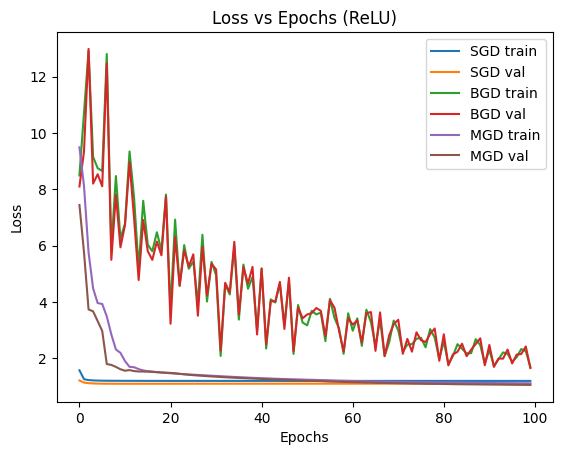

In [14]:
plt.plot(range(num_epochs), SGD_train_loss, label='SGD train')
plt.plot(range(num_epochs), SGD_val_loss, label='SGD val')
plt.plot(range(num_epochs), BGD_train_loss, label='BGD train')
plt.plot(range(num_epochs), BGD_val_loss, label='BGD val')
plt.plot(range(num_epochs), MGD_train_loss, label='MGD train')
plt.plot(range(num_epochs), MGD_val_loss, label='MGD val')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss vs Epochs (ReLU)')
plt.legend()
plt.show()

In [15]:
lr = 0.0001
num_epochs = 100
hidden_layers = [32, 16, 10]
batch_size = 200
input_size = 11
output_size = 6

model2 = MLP()

activation = [model2.sigmoid, model2.sigmoid, model2.sigmoid, model2.softmax]
der_activation = [model2.der_sigmoid, model2.der_sigmoid, model2.der_sigmoid, model2.softmax]

model2.set_lr(lr)
model2.set_hidden(hidden_layers)
model2.set_activation(activation)
model2.set_der_activation(der_activation)

model2.set_optimiser(model2.stochastic_gradient_descent)
SGD_train_loss, SGD_val_loss = model2.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size)

model2.set_optimiser(model2.gradient_descent)
BGD_train_loss, BGD_val_loss = model2.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size)

model2.set_optimiser(model2.minibatch_gradient_descent)
MGD_train_loss, MGD_val_loss = model2.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size)


----------SGD--------------
----------------------
Epoch 10/100, Training loss 1.2984863767642372, Training accuracy 0.4075
Validation loss 1.201789828058774, Validation accuracy 0.48034934497816595
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       1.00      0.48      0.65       229
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.48       229
   macro avg       0.17      0.08      0.11       229
weighted avg       1.00      0.48      0.65       229

----------------------
Epoch 20/100, Training loss 1.233557028728522, Training accuracy 0.3975
Validation loss 1.1309804136099664, Validation accuracy 0.39737991266375544
Classification Report on the Validation da

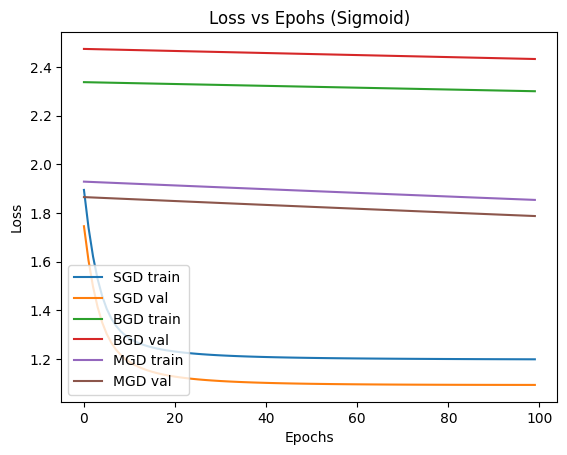

In [16]:
plt.plot(range(num_epochs), SGD_train_loss, label='SGD train')
plt.plot(range(num_epochs), SGD_val_loss, label='SGD val')
plt.plot(range(num_epochs), BGD_train_loss, label='BGD train')
plt.plot(range(num_epochs), BGD_val_loss, label='BGD val')
plt.plot(range(num_epochs), MGD_train_loss, label='MGD train')
plt.plot(range(num_epochs), MGD_val_loss, label='MGD val')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss vs Epohs (Sigmoid)')
plt.legend()
plt.show()

In [17]:
lr = 0.01
num_epochs = 100
hidden_layers = [32, 16, 10]
batch_size = 200
input_size = 11
output_size = 6

model1 = MLP()

activation = [model1.tanh, model1.tanh, model1.tanh, model1.softmax]
der_activation = [model1.der_tanh, model1.der_tanh, model1.der_tanh, model1.softmax]

model1.set_lr(lr)
model1.set_hidden(hidden_layers)
model1.set_activation(activation)
model1.set_der_activation(der_activation)

model1.set_optimiser(model1.stochastic_gradient_descent)
SGD_train_loss, SGD_val_loss = model1.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size)

model1.set_optimiser(model1.gradient_descent)
BGD_train_loss, BGD_val_loss = model1.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size)

model1.set_optimiser(model1.minibatch_gradient_descent)
MGD_train_loss, MGD_val_loss = model1.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size)


----------SGD--------------
----------------------
Epoch 10/100, Training loss 1.2025423275822755, Training accuracy 0.40625
Validation loss 1.1062175055113357, Validation accuracy 0.3930131004366812
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         1
           3       0.99      0.39      0.56       228
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.39       229
   macro avg       0.16      0.07      0.09       229
weighted avg       0.98      0.39      0.56       229

----------------------
Epoch 20/100, Training loss 1.1926881539636822, Training accuracy 0.41375
Validation loss 1.1156605750391855, Validation accuracy 0.388646288209607
Classification Report on the Validation d

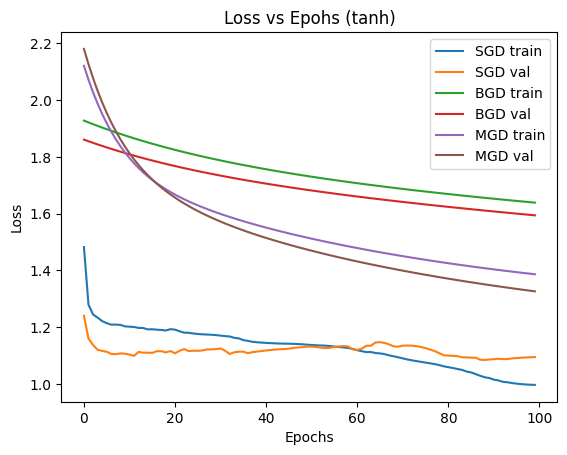

In [18]:
plt.plot(range(num_epochs), SGD_train_loss, label='SGD train')
plt.plot(range(num_epochs), SGD_val_loss, label='SGD val')
plt.plot(range(num_epochs), BGD_train_loss, label='BGD train')
plt.plot(range(num_epochs), BGD_val_loss, label='BGD val')
plt.plot(range(num_epochs), MGD_train_loss, label='MGD train')
plt.plot(range(num_epochs), MGD_val_loss, label='MGD val')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss vs Epohs (tanh)')
plt.legend()
plt.show()

Now that we have trained with different activations and optimizers, we can see that ReLU gives a better result and from that using SGD takes a little time but it descends smoothly. Let us use these to train our test set.

In [19]:
Y_pred_test, _ = model3.forward_prop(X_test)
loss_test = model3.loss(Y_pred_test, Y_test_oh)

pred_test = np.argmax(Y_pred_test, 0)

print(f'LOSS FOR TEST SET {loss_test}')
print('CLASSIFICATION REPORT')
print(classification_report(pred_test, Y_test, zero_division = 0))

LOSS FOR TEST SET 1.325543248384447
CLASSIFICATION REPORT
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.51      0.71      0.59        34
           3       0.89      0.54      0.67        78
           4       0.09      0.50      0.15         2
           5       0.00      0.00      0.00         0

    accuracy                           0.59       114
   macro avg       0.25      0.29      0.24       114
weighted avg       0.77      0.59      0.64       114



Now let us perform multi output classification using the dataset given to us in assignment 1. Let us load the data and perform necessary data pre-processing.

In [7]:
Data = pd.read_csv('advertisement.csv')
print(Data.head())
Df = pd.DataFrame(Data)

   age  gender        income    education  married  children           city  \
0   45    Male  61271.953359       Master    False         3    Lake Sheila   
1   24  Female  53229.101074  High School    False         1   Crystalburgh   
2   45  Female  30066.046684     Bachelor     True         3  Margaretburgh   
3   19    Male  48950.246384          PhD    False         0  Williamshaven   
4   29  Female  44792.627094       Master    False         0       New Paul   

    occupation  purchase_amount most bought item  \
0       Doctor        87.697118          monitor   
1  Businessman       115.135586         lipstick   
2     Engineer       101.694559         biscuits   
3       Lawyer        97.964887            maggi   
4  Businessman        86.847281           carpet   

                             labels  
0       electronics clothing sports  
1                  furniture beauty  
2  clothing electronics food sports  
3                              food  
4                     

In [8]:
def preprocessing(data): # Multi Output Formulation
        data = [list(s.split(' ')) for s in list(data.labels)] #Splitting the labels into individual words
        mlb = MultiLabelBinarizer() # Using sklearn to obtain the different classes
        mlb.fit(data)
    
        one_hot = np.zeros((len(data), len(mlb.classes_)))
        for i in range(len(data)): # creating the OneHot encoding for the data
            for j in range(len(data[i])):
                one_hot[i, np.where(mlb.classes_ == data[i][j])[0][0]] = 1

        return one_hot

def featurisation(data, categorical_cols):
        x = data.drop('labels', axis = 1)
        for features in categorical_cols: # Replacing the categorical columns with numerical values
            x[features].replace(x[features].unique(), list(range(len(x[features].unique()))), inplace = True)
        
        return x

In [9]:
categorical_cols = ['gender', 'education', 'married','city', 'occupation', 'most bought item']
X = featurisation(Df, categorical_cols) 
Y = preprocessing(Df)

X_train, X_rest, Y_train, Y_rest = train_test_split(X, Y, test_size=0.3)
X_test , X_val, Y_test, Y_val = train_test_split(X_rest, Y_rest, test_size=0.2/0.3)



Y_train_oh = Y_train.T
Y_test_oh = Y_test.T
Y_val_oh = Y_val.T

Y_train = np.max(Y_train, 1)
Y_val = np.max(Y_val, 1)
Y_test = np.max(Y_test, 1)

X_train = X_train.to_numpy()
X_test = X_test.to_numpy()
X_val = X_val.to_numpy()

We have preprocessed the data. Now we can proceed to training our model fo rthe clssification. The idea is that the final activation layer that we will pass to the model for training will be sigmaoid instaed of softmax as now there can be multiple classes for a given data point so now we try to perform binary classification with all the classes. The remaining model remains the same. Here also we will train for all kinds of optimizers as well as activation functions.

In [13]:
class MLP_multilabel:

    def __init__(self, lr = 0.0, activation = None, der_activation = None, optimiser = None, hidden_layers = None):
        self.lr = lr
        self.activation = activation
        self.optim = optimiser
        self.hidden = hidden_layers
        self.der_activation = der_activation

    def set_der_activation(self, der_activation):
        self.der_activation = der_activation

    def set_lr(self, lr):
        self.lr = lr

    def set_activation(self, activation):
        self.activation = activation

    def set_optimiser(self, optimiser):
        self.optim = optimiser
    
    def set_hidden(self, hidden):
        self.hidden = hidden

    def sigmoid(self, x):
        return 1/(1 + np.exp(-x))

    def relu(self, x):
        return np.maximum(0, x)
    
    def tanh(self, x):
        return np.tanh(x)

    def softmax(self, x):
        x_max = np.max(x, axis = 0, keepdims=True)
        return np.exp(x - x_max)/np.sum(np.exp(x - x_max), axis = 0, keepdims=True)

    def der_tanh(self, x):
        return 1 - (np.tanh(x)**2)

    def der_relu(self, x):
        return np.where(x > 0, 1, 0)

    def der_sigmoid(self, x):
        return self.sigmoid(x)*(1 - self.sigmoid(x))

    def initialisation(self, input_size, output_size):
        self.params = {}

        self.params['W1'] = np.random.rand(self.hidden[0], input_size)
        self.params['b1'] = np.zeros((self.hidden[0], 1))
        i = 0
        for i in range(1, len(self.hidden)):
            self.params['W'+str(i+1)] = np.random.rand(self.hidden[i], self.hidden[i-1])
            self.params['b'+str(i+1)] = np.zeros((self.hidden[i], 1))
        
        self.params['W'+str(i+2)] = np.random.rand(output_size, self.hidden[-1])
        self.params['b'+str(i+2)] = np.zeros((output_size, 1))

    def forward_prop(self, input):
        cache = {}

        cache['Z1'] = np.dot(self.params['W1'], input.T) + self.params['b1']
        cache['A1'] = self.activation[0](cache['Z1'])

        for i in range(1, len(self.activation)):
            cache['Z'+str(i+1)] = np.dot(self.params['W'+str(i+1)], cache['A'+str(i)]) + self.params['b'+str(i+1)]
            cache['A'+str(i+1)] = self.activation[i](cache['Z'+str(i+1)])

        # print(cache['A'+str(len(self.activation))])

        return cache['A'+str(len(self.activation))], cache

    def loss(self, A, Y):
        m = Y.shape[1]
        return -np.sum(np.log(A + 1e-10)*Y + np.log(1 - A + 1e-10)*(1-Y))/m

    def backward_prop(self, cache, X, Y):
        m = X.shape[0]
        self.gradients = {}

        dZ = cache['A'+str(len(self.activation))] - Y
        for i in range(len(self.activation) - 1, 0, -1):
            self.gradients['dW'+str(i+1)] = np.dot(dZ, cache['A' + str(i)].T)/m
            self.gradients['db'+str(i+1)] = np.sum(dZ, axis = 1, keepdims=True)/m
            dZ = np.dot(self.params['W'+str(i+1)].T, dZ) * self.der_activation[i - 1](cache['Z'+str(i)])

        self.gradients['dW1'] = np.dot(dZ, X)/m
        self.gradients['db1'] = np.sum(dZ, axis = 1, keepdims=True)/m 

    def optimisation(self):
        for i in range(len(self.activation)):
            self.params['W'+str(i+1)] -= self.lr*self.gradients['dW'+str(i+1)]
            self.params['b'+str(i+1)] -= self.lr*self.gradients['db'+str(i+1)]

    def gradient_descent(self,X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size,batch_size, MultiLabel = False):
        train_loss = []
        val_loss = []
        self.initialisation(input_size, output_size)
        print('----------BGD--------------')

        for epoch in range(num_epochs):
            Y_pred_train, train_cache = self.forward_prop(X_train)
            Y_pred_val, _ = self.forward_prop(X_val)
            
            Loss_train = self.loss(Y_pred_train, Y_train_oh)
            train_loss.append(Loss_train)

            Loss_val = self.loss(Y_pred_val, Y_val_oh)
            val_loss.append(Loss_val)

            self.backward_prop(train_cache, X_train, Y_train_oh)

            self.optimisation()

            if MultiLabel == False:
                train_pred = np.argmax(Y_pred_train, 0)
                val_pred = np.argmax(Y_pred_val, 0)

                if (epoch+1)%10 == 0:
                    print('----------------------')
                    print(f'Epoch {epoch+1}/{num_epochs}, Training loss {Loss_train}, Validation Loss {Loss_val}, Training accuracy {accuracy_score(Y_train, train_pred)}, Validation accuracy {accuracy_score(Y_val, val_pred)}')
                    print('Classification report for Validation set:')
                    print(classification_report(Y_val, val_pred, zero_division=0))
            else:
                Y_pred_train[Y_pred_train >= 0.5] = 1
                Y_pred_train[Y_pred_train < 0.5] = 0
                Y_pred_val[Y_pred_val >= 0.5] = 1
                Y_pred_val[Y_pred_val < 0.5] = 0

                # print(Y_pred_train)

                if (epoch+1)%10 == 0:
                    print('----------------------')
                    print(f'Epoch {epoch+1}/{num_epochs}, Training loss {Loss_train}, Validation Loss {Loss_val}, Training accuracy {1 - hamming_loss(Y_train_oh, Y_pred_train)}, Validation accuracy {1 - hamming_loss(Y_val_oh, Y_pred_val)}')
                    print('Classification report for Validation set:')
                    print(classification_report(Y_val_oh.T, Y_pred_val.T, zero_division=0))

        

            data_to_log = {
                'Epoch' : epoch+1,
                'Train Loss' : Loss_train,
                'Validation Loss' : Loss_val,
                'Train Accuracry':1 - hamming_loss(Y_train_oh, Y_pred_train),
                'Validation Accuracy':1 - hamming_loss(Y_val_oh, Y_pred_val)
            }

            wandb.log(data_to_log)

        return train_loss, val_loss

      
    def stochastic_gradient_descent(self,X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size,batch_size, MultiLabel = False):
        train_loss = []
        val_loss = []
        self.initialisation(input_size, output_size)
        print('----------SGD--------------')

        for epoch in range(num_epochs):
            Loss_train = 0
            accuracy_train = 0
            for i in range(len(X_train)):
                Y_pred_train, train_cache = self.forward_prop(X_train[i][np.newaxis, :])

                
                Loss_train += self.loss(Y_pred_train, Y_train_oh[:, i][:, np.newaxis])

                self.backward_prop(train_cache, X_train[i][np.newaxis, :], Y_train_oh[:, i][:, np.newaxis])

                self.optimisation()

                if MultiLabel == False:
                    train_pred = np.argmax(Y_pred_train, 0)
                    accuracy_train += accuracy_score([Y_train[i]], train_pred)
                else:
                    Y_pred_train[Y_pred_train >= 0.5] = 1
                    Y_pred_train[Y_pred_train < 0.5] = 0
                    accuracy_train += 1 - hamming_loss(Y_pred_train, Y_train_oh[:,i])

                

                # data_to_log = {
                #     'Epoch' : epoch+1,
                #     'Train Loss' : Loss_train,
                #     'Validation Loss' : Loss_val,
                #     'learning_rate' : learning_rate
                # }

                # wandb.log(data_to_log)
            train_loss.append(Loss_train/len(X_train))

            if (epoch+1)%10 == 0:
                print('----------------------')
                print(f'Epoch {epoch+1}/{num_epochs}, Training loss {Loss_train/len(X_train)}, Training accuracy {accuracy_train/len(X_train)}')
            Loss_train = 0
            accuracy_train = 0

            Y_pred_val, _ = self.forward_prop(X_val)
            Loss_val = self.loss(Y_pred_val, Y_val_oh)
            val_loss.append(Loss_val)

            if MultiLabel == False:
                val_pred = np.argmax(Y_pred_val, 0)
                if (epoch + 1)%10 == 0:
                    print(f'Validation loss {Loss_val}, Validation accuracy {accuracy_score(val_pred, Y_val)}')
                    print('Classification Report on the Validation data')
                    print(classification_report(val_pred, Y_val, zero_division=0))
            else:
                Y_pred_val[Y_pred_val >= 0.5] = 1
                Y_pred_val[Y_pred_val < 0.5] = 0

                if (epoch + 1)%10 == 0:
                    print(f'Validation loss {Loss_val}, Validation accuracy {1 - hamming_loss(Y_pred_val, Y_val_oh)}')
                    print('Classification Report on the Validation data')
                    print(classification_report(Y_pred_val.T, Y_val_oh.T, zero_division=0))

            data_to_log = {
                'Epoch' : epoch+1,
                'Train Loss' : Loss_train/len(X_train),
                'Validation Loss' : Loss_val,
                'Train Accuracry':accuracy_train/len(X_train),
                'Validation Accuracy':1 - hamming_loss(Y_val_oh, Y_pred_val)
            }

            wandb.log(data_to_log)
        
        return train_loss, val_loss
            
            

      
    def minibatch_gradient_descent(self,X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size, MultiLabel = False):
        train_loss = []
        val_loss = []
        self.initialisation(input_size, output_size)
        print('----------MGD--------------')

        for epoch in range(num_epochs):
            Loss_train = 0
            accuracy_train = 0
            for i in range(len(X_train)//batch_size):
                Y_pred_train, train_cache = self.forward_prop(X_train[i*batch_size:(i+1)*batch_size])

                
                Loss_train += self.loss(Y_pred_train, Y_train_oh[:, i*batch_size:(i+1)*batch_size])

                self.backward_prop(train_cache, X_train[i*batch_size:(i+1)*batch_size], Y_train_oh[:, i*batch_size:(i+1)*batch_size])

                self.optimisation()

                if MultiLabel == False:
                    train_pred = np.argmax(Y_pred_train, 0)
                    accuracy_train += accuracy_score(Y_train[i*batch_size : (i+1)*batch_size], train_pred)
                else:
                    Y_pred_train[Y_pred_train >= 0.5] = 1
                    Y_pred_train[Y_pred_train < 0.5] = 0
                    accuracy_train += 1 - hamming_loss(Y_train_oh[:,i*batch_size : (i+1)*batch_size], Y_pred_train)

                

                # data_to_log = {
                #     'Epoch' : epoch+1,
                #     'Train Loss' : Loss_train,
                #     'Validation Loss' : Loss_val,
                #     'learning_rate' : learning_rate
                # }

                # wandb.log(data_to_log)

            if len(X_train)%batch_size != 0:
                Y_pred_train, train_cache = self.forward_prop(X_train[(len(X_train)//batch_size)*batch_size:])

                
                Loss_train += self.loss(Y_pred_train, Y_train_oh[:, (len(X_train)//batch_size)*batch_size:])

                self.backward_prop(train_cache, X_train[(len(X_train)//batch_size)*batch_size:], Y_train_oh[:, (len(X_train)//batch_size)*batch_size:])

                self.optimisation()

                if MultiLabel == False:
                    train_pred = np.argmax(Y_pred_train, 0)
                    accuracy_train += accuracy_score(Y_train[(len(X_train)//batch_size)*batch_size :], train_pred)   
                else:
                    Y_pred_train[Y_pred_train >= 0.5] = 1
                    Y_pred_train[Y_pred_train < 0.5] = 0
                    accuracy_train += 1 - hamming_loss(Y_train_oh[:, (len(X_train)//batch_size)*batch_size :], Y_pred_train)   

                           


            train_loss.append(Loss_train/(len(X_train)//batch_size))

            if (epoch+1)%10 == 0:
                print('----------------------')
                print(f'Epoch {epoch+1}/{num_epochs}, Training loss {Loss_train/(len(X_train)//batch_size)}, Training accuracy {accuracy_train/(len(X_train)//batch_size)}')
            Loss_train = 0
            accuracy_train = 0

            Y_pred_val, _ = self.forward_prop(X_val)
            Loss_val = self.loss(Y_pred_val, Y_val_oh)
            val_loss.append(Loss_val)

            if MultiLabel == False:
                val_pred = np.argmax(Y_pred_val, 0)
                if (epoch + 1)%10 == 0:
                    print(f'Validation loss {Loss_val}, Validation accuracy {accuracy_score(val_pred, Y_val)}')
                    print('Classification Report on the Validation data')
                    print(classification_report(val_pred, Y_val, zero_division=0))
            else:
                Y_pred_val[Y_pred_val >= 0.5] = 1
                Y_pred_val[Y_pred_val < 0.5] = 0
                if (epoch + 1)%10 == 0:
                    print(f'Validation loss {Loss_val}, Validation accuracy {1 - hamming_loss(Y_pred_val, Y_val_oh)}')
                    print('Classification Report on the Validation data')
                    print(classification_report(Y_pred_val.T, Y_val_oh.T, zero_division=0))

            data_to_log = {
                'Epoch' : epoch+1,
                'Train Loss' : Loss_train/(len(X_train)//batch_size),
                'Validation Loss' : Loss_val,
                'Train Accuracry':accuracy_train/(len(X_train)//batch_size),
                'Validation Accuracy':1 - hamming_loss(Y_val_oh, Y_pred_val)
            }

            wandb.log(data_to_log)
        
        return train_loss, val_loss

    def fit(self, X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size,batch_size, MultiLabel=False):
        return self.optim(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size,batch_size, MultiLabel)


In [14]:
def main1():
    wandb.init(project='SMAI3-2.1')

    config = wandb.config

    input_size = 10
    output_size = 8
    model = MLP_multilabel()
    model.set_lr(config['learning_rate'])
    model.set_hidden(config['hidden_layers'])
    batch_size = 200

    if config['activation'] == 'sigmoid':
        activation = [model.sigmoid, model.sigmoid, model.sigmoid, model.sigmoid]
        der_activation = [model.der_sigmoid, model.der_sigmoid, model.der_sigmoid, model.sigmoid]

    elif config['activation'] == 'relu':
        activation = [model.relu, model.relu, model.relu, model.sigmoid]
        der_activation = [model.der_relu, model.der_relu, model.der_relu, model.sigmoid]

    else :
        activation = [model.tanh, model.tanh, model.tanh, model.sigmoid]
        der_activation = [model.der_tanh, model.der_tanh, model.der_tanh, model.sigmoid]
    
    model.set_activation(activation)
    model.set_der_activation(der_activation)

    if config['optimiser'] == 'sgd':
        model.set_optimiser(model.stochastic_gradient_descent)
    elif config['optimiser'] == 'bgd':
        model.set_optimiser(model.gradient_descent)
    else :
        model.set_optimiser(model.minibatch_gradient_descent)

    model.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, config['n_iterations'], input_size, output_size, batch_size, MultiLabel=True)
        
    

sweep_config = {
    'method':'random',
    'metric':{
        'name':'accuracy',
        'goal':'maximize'
    },
    'parameters':{
        'learning_rate':{
            'values':[0.0001, 0.001, 0.01, 0.1]
        },
        'n_iterations':{
            'values':[1000, 5000]
        },
        'optimiser':{
            'values':['sgd', 'bgd', 'mgd']
        },
        'activation':{
            'values':['sigmoid', 'tanh', 'relu']
        },
        'hidden_layers':{
            'values': [[8,8,8],[16,16],[32],[16, 32, 16]]
        }
    }
}


sweep_id = wandb.sweep(sweep=sweep_config, project = 'SMAI3-2.1')
wandb.agent(sweep_id, function=main1)

wandb.run.name = 'e2.GD.ce'

Create sweep with ID: x4tsrr6n
Sweep URL: https://wandb.ai/music-cognition/SMAI3-2.1/sweeps/x4tsrr6n


wandb: Agent Starting Run: bv1bnjs6 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_161104-bv1bnjs6
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run giddy-sweep-1
wandb: ⭐️ View project at https://wandb.ai/music-cognition/SMAI3-2.1
wandb: 🧹 View sweep at https://wandb.ai/music-cognition/SMAI3-2.1/sweeps/x4tsrr6n
wandb: 🚀 View run at https://wandb.ai/music-cognition/SMAI3-2.1/runs/bv1bnjs6
wandb: Waiting for W&B process to fini

----------SGD--------------


wandb: 🚀 View run giddy-sweep-1 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/bv1bnjs6
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_161104-bv1bnjs6/logs
wandb: ERROR Run bv1bnjs6 errored: KeyError('W4')
wandb: Agent Starting Run: 3ui8bwql with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_161128-3ui8bwql
wandb: Run `wandb offline` to turn off syncing.
wandb:

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 5.5426773349086345, Validation Loss 5.543011427978629, Training accuracy 0.6603571428571429, Validation accuracy 0.6405472636815921
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        78
           1       0.00      0.00      0.00        67
           2       0.00      0.00      0.00        66
           3       0.00      0.00      0.00        76
           4       0.00      0.00      0.00        79
           5       0.00      0.00      0.00        70
           6       0.00      0.00      0.00        67
           7       0.00      0.00      0.00        75

   micro avg       0.00      0.00      0.00       578
   macro avg       0.00      0.00      0.00       578
weighted avg       0.00      0.00      0.00       578
 samples avg       0.00      0.00      0.00       578

----------------------
Epoch 20/1000, Tra

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 990/1000, Training loss 5.383000590919123, Validation Loss 5.407920594153051, Training accuracy 0.6603571428571429, Validation accuracy 0.6405472636815921
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        78
           1       0.00      0.00      0.00        67
           2       0.00      0.00      0.00        66
           3       0.00      0.00      0.00        76
           4       0.00      0.00      0.00        79
           5       0.00      0.00      0.00        70
           6       0.00      0.00      0.00        67
           7       0.00      0.00      0.00        75

   micro avg       0.00      0.00      0.00       578
   macro avg       0.00      0.00      0.00       578
weighted avg       0.00      0.00      0.00       578
 samples avg       0.00      0.00      0.00       578

----------------------
Epoch 1000/1000, Training loss 5.3817402545001

wandb: | 0.097 MB of 0.097 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ███▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ███▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:     Train Accuracry 0.66036
wandb:          Train Loss 5.38174
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.40688
wandb: 
wandb: 🚀 View run celestial-sweep-2 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/3ui8bwql
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_161128-3ui8bwql/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wcgratx3 with config:
wandb: 	activation: si

----------MGD--------------


wandb: 🚀 View run still-sweep-3 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/wcgratx3
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_161159-wcgratx3/logs
wandb: ERROR Run wcgratx3 errored: KeyError('W3')
wandb: Agent Starting Run: rreqzy6i with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_161215-rreqzy6i
wandb: Run `wandb offline` to turn off syncing.
wandb: 

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 17.296974428124507, Validation Loss 16.640009760640634, Training accuracy 0.33964285714285714, Validation accuracy 0.3594527363184079
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.39      1.00      0.56        78
           1       0.33      1.00      0.50        67
           2       0.33      1.00      0.49        66
           3       0.38      1.00      0.55        76
           4       0.39      1.00      0.56        79
           5       0.35      1.00      0.52        70
           6       0.33      1.00      0.50        67
           7       0.37      1.00      0.54        75

   micro avg       0.36      1.00      0.53       578
   macro avg       0.36      1.00      0.53       578
weighted avg       0.36      1.00      0.53       578
 samples avg       0.36      1.00      0.51       578

----------------------
Epoch 20/1000, T

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 5.122884316721778, Validation Loss 5.241492071772443, Training accuracy 0.6603571428571429, Validation accuracy 0.6405472636815921
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        78
           1       0.00      0.00      0.00        67
           2       0.00      0.00      0.00        66
           3       0.00      0.00      0.00        76
           4       0.00      0.00      0.00        79
           5       0.00      0.00      0.00        70
           6       0.00      0.00      0.00        67
           7       0.00      0.00      0.00        75

   micro avg       0.00      0.00      0.00       578
   macro avg       0.00      0.00      0.00       578
weighted avg       0.00      0.00      0.00       578
 samples avg       0.00      0.00      0.00       578



wandb: / 0.096 MB of 0.097 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▂▄███████████████████████████████████
wandb:          Train Loss █▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▂▄███████████████████████████████████
wandb:     Validation Loss █▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:     Train Accuracry 0.66036
wandb:          Train Loss 5.12288
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24149
wandb: 
wandb: 🚀 View run fiery-sweep-4 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/rreqzy6i
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_161215-rreqzy6i/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: uji245yg with config:
wandb: 	activation: relu
w

----------SGD--------------
----------------------
Epoch 10/1000, Training loss 5.178422668071966, Training accuracy 0.6603571428571429
Validation loss 5.259283177361154, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/1000, Tr

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 5.178422668071966, Training accuracy 0.6603571428571429
Validation loss 5.259283177361154, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0



wandb: \ 0.097 MB of 0.097 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.25928
wandb: 
wandb: 🚀 View run youthful-sweep-5 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/uji245yg
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_161243-uji245yg/logs
wandb: Agent Starting Run: 6gtb0z3a with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.

----------SGD--------------
----------------------
Epoch 10/1000, Training loss 5.1359127224891585, Training accuracy 0.6603571428571429
Validation loss 5.242157729942491, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/1000, T

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 5.135912722488167, Training accuracy 0.6603571428571429
Validation loss 5.242157729952982, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0



wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24216
wandb: 
wandb: 🚀 View run smooth-sweep-6 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/6gtb0z3a
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_161820-6gtb0z3a/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7mlvdqej with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 6.904904782388165, Training accuracy 0.8810416666666668
Validation loss 5.2509950361488125, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/5000, T

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000, Training loss 6.826238207979003, Training accuracy 0.8810416666666668
Validation loss 5.24425451715395, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 5000/5000, Training loss 6.82623820797

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁███████████████████████████████████████
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24425
wandb: 
wandb: 🚀 View run upbeat-sweep-7 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/7mlvdqej
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_162439-7mlvdqej/logs
wandb: Agent Starting Run: f0fb0wum with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/l

----------MGD--------------


wandb: 🚀 View run quiet-sweep-8 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/f0fb0wum
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_162534-f0fb0wum/logs
wandb: ERROR Run f0fb0wum errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: srueerto with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_162600-srueerto
wa

----------MGD--------------


wandb: 🚀 View run silvery-sweep-9 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/srueerto
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_162600-srueerto/logs
wandb: ERROR Run srueerto errored: KeyError('W4')
wandb: Agent Starting Run: 94z6ig87 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_162622-94z6ig87
wandb: Run `wandb offline` to turn off syncing.
wandb: S

----------BGD--------------


wandb: 🚀 View run azure-sweep-10 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/94z6ig87
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_162622-94z6ig87/logs
wandb: ERROR Run 94z6ig87 errored: KeyError('W4')
wandb: Agent Starting Run: rgwxs6w5 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_162653-rgwxs6w5
wandb: Run `wandb offline` to turn off syncing.
wandb

----------SGD--------------


wandb: 🚀 View run legendary-sweep-11 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/rgwxs6w5
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_162653-rgwxs6w5/logs
wandb: ERROR Run rgwxs6w5 errored: KeyError('W4')
wandb: Agent Starting Run: digfa736 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_162721-digfa736
wandb: Run `wandb offline` to turn off syncing.


----------SGD--------------
----------------------
Epoch 10/1000, Training loss 8.57648691365977, Training accuracy 0.33964285714285714
Validation loss 7.710645055050086, Validation accuracy 0.3594527363184079
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       1.00      0.39      0.56       201
           1       1.00      0.33      0.50       201
           2       1.00      0.33      0.49       201
           3       1.00      0.38      0.55       201
           4       1.00      0.39      0.56       201
           5       1.00      0.35      0.52       201
           6       1.00      0.33      0.50       201
           7       1.00      0.37      0.54       201

   micro avg       1.00      0.36      0.53      1608
   macro avg       1.00      0.36      0.53      1608
weighted avg       1.00      0.36      0.53      1608
 samples avg       1.00      0.36      0.51      1608

----------------------
Epoch 20/1000, Tr

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 5.12438415868701, Training accuracy 0.6603571428571429
Validation loss 5.241172403201914, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0



wandb: \ 0.097 MB of 0.097 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁███████████████████████████████████████
wandb:     Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24117
wandb: 
wandb: 🚀 View run brisk-sweep-12 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/digfa736
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_162721-digfa736/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: tzldkp8g with config:
wandb: 	activation: sigmoid
wandb

----------MGD--------------


wandb: 🚀 View run trim-sweep-13 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/tzldkp8g
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163310-tzldkp8g/logs
wandb: ERROR Run tzldkp8g errored: KeyError('W3')
wandb: Agent Starting Run: z7mrfcy8 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_163337-z7mrfcy8
wandb: Run `wandb offline` to turn off syncing.
wandb: Sync

----------MGD--------------


wandb: 🚀 View run fragrant-sweep-14 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/z7mrfcy8
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163337-z7mrfcy8/logs
wandb: ERROR Run z7mrfcy8 errored: KeyError('W3')
wandb: Agent Starting Run: s7mk4wmo with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_163401-s7mk4wmo
wandb: Run `wandb offline` to turn off syncing.
wan

----------BGD--------------
----------------------
Epoch 10/1000, Training loss 38.71534677917879, Validation Loss 37.38421823080795, Training accuracy 0.33964285714285714, Validation accuracy 0.3594527363184079
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.39      1.00      0.56        78
           1       0.33      1.00      0.50        67
           2       0.33      1.00      0.49        66
           3       0.38      1.00      0.55        76
           4       0.39      1.00      0.56        79
           5       0.35      1.00      0.52        70
           6       0.33      1.00      0.50        67
           7       0.37      1.00      0.54        75

   micro avg       0.36      1.00      0.53       578
   macro avg       0.36      1.00      0.53       578
weighted avg       0.36      1.00      0.53       578
 samples avg       0.36      1.00      0.51       578

----------------------
Epoch 20/1000, Tra

wandb: Waiting for W&B process to finish... (success).


              precision    recall  f1-score   support

           0       0.00      0.00      0.00        78
           1       0.00      0.00      0.00        67
           2       0.00      0.00      0.00        66
           3       0.00      0.00      0.00        76
           4       0.00      0.00      0.00        79
           5       0.00      0.00      0.00        70
           6       0.00      0.00      0.00        67
           7       0.00      0.00      0.00        75

   micro avg       0.00      0.00      0.00       578
   macro avg       0.00      0.00      0.00       578
weighted avg       0.00      0.00      0.00       578
 samples avg       0.00      0.00      0.00       578

----------------------
Epoch 980/1000, Training loss 5.122884316721778, Validation Loss 5.241492076069765, Training accuracy 0.6603571428571429, Validation accuracy 0.6405472636815921
Classification report for Validation set:
              precision    recall  f1-score   support

           0  

wandb: - 0.002 MB of 0.097 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▂████████████████████████████████████
wandb:          Train Loss █▅▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▂████████████████████████████████████
wandb:     Validation Loss █▅▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:     Train Accuracry 0.66036
wandb:          Train Loss 5.12288
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24149
wandb: 
wandb: 🚀 View run autumn-sweep-15 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/s7mk4wmo
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163401-s7mk4wmo/logs
wandb: Agent Starting Run: 2e2qiiqg with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.

----------BGD--------------


wandb: 🚀 View run peachy-sweep-16 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/2e2qiiqg
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163428-2e2qiiqg/logs
wandb: ERROR Run 2e2qiiqg errored: KeyError('W4')
wandb: Agent Starting Run: zy6uo6oz with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_163451-zy6uo6oz
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing

----------BGD--------------


wandb: 🚀 View run sweet-sweep-17 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/zy6uo6oz
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163451-zy6uo6oz/logs
wandb: ERROR Run zy6uo6oz errored: KeyError('W3')
wandb: Agent Starting Run: wck7o6q4 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_163515-wck7o6q4
wandb: Run `wandb offline` to turn off syncing.
wandb: S

----------MGD--------------


wandb: 🚀 View run pious-sweep-18 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/wck7o6q4
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163515-wck7o6q4/logs
wandb: ERROR Run wck7o6q4 errored: KeyError('W4')
wandb: Agent Starting Run: xply69gv with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_163537-xply69gv
wandb: Run `wandb offline` to turn off syncing.
wandb: Syn

----------SGD--------------


wandb: 🚀 View run olive-sweep-19 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/xply69gv
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163537-xply69gv/logs
wandb: ERROR Run xply69gv errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: dpno94sf with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_163604-dpno94sf
wa

----------SGD--------------


wandb: 🚀 View run prime-sweep-20 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/dpno94sf
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163604-dpno94sf/logs
wandb: ERROR Run dpno94sf errored: KeyError('W3')
wandb: Agent Starting Run: 8sibgtuc with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_163628-8sibgtuc
wandb: Run `wandb offline` to turn off syncing.
wan

----------MGD--------------
----------------------
Epoch 10/1000, Training loss 25.039781046790438, Training accuracy 0.4522916666666667
Validation loss 17.200390464868594, Validation accuracy 0.3594527363184079
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       1.00      0.39      0.56       201
           1       1.00      0.33      0.50       201
           2       1.00      0.33      0.49       201
           3       1.00      0.38      0.55       201
           4       1.00      0.39      0.56       201
           5       1.00      0.35      0.52       201
           6       1.00      0.33      0.50       201
           7       1.00      0.37      0.54       201

   micro avg       1.00      0.36      0.53      1608
   macro avg       1.00      0.36      0.53      1608
weighted avg       1.00      0.36      0.53      1608
 samples avg       1.00      0.36      0.51      1608

----------------------
Epoch 20/1000, 

wandb: Waiting for W&B process to finish... (success).


Validation loss 5.244326953933225, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 1000/1000, Training loss 6.8265387183858435, Training accuracy 0.8810416666666668
Validation loss 5.244326953933225, Validation accuracy 0.64054726

wandb: \ 0.097 MB of 0.097 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁███████████████████████████████████████
wandb:     Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24433
wandb: 
wandb: 🚀 View run fiery-sweep-21 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/8sibgtuc
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163628-8sibgtuc/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: q13wmh59 with config:
wandb: 	activation: sigmoid
wandb

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 27.683692499784353, Training accuracy 0.4522916666666667
Validation loss 20.27744706133313, Validation accuracy 0.3594527363184079
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       1.00      0.39      0.56       201
           1       1.00      0.33      0.50       201
           2       1.00      0.33      0.49       201
           3       1.00      0.38      0.55       201
           4       1.00      0.39      0.56       201
           5       1.00      0.35      0.52       201
           6       1.00      0.33      0.50       201
           7       1.00      0.37      0.54       201

   micro avg       1.00      0.36      0.53      1608
   macro avg       1.00      0.36      0.53      1608
weighted avg       1.00      0.36      0.53      1608
 samples avg       1.00      0.36      0.51      1608

----------------------
Epoch 20/5000, T

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000, Training loss 6.837894060961863, Training accuracy 0.8810416666666668
Validation loss 5.241636600627722, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 5000/5000, Training loss 6.8377010213

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▃▃▄▆▇▇▇██████████████
wandb:     Validation Loss ██▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24158
wandb: 
wandb: 🚀 View run rural-sweep-22 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/q13wmh59
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163710-q13wmh59/logs
wandb: Agent Starting Run: ppwvooap with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/u

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 5.210492662434007, Training accuracy 0.6551785714285714
Validation loss 5.280611632603433, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/5000, Tr

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 5.210492662434007, Training accuracy 0.6551785714285714
Validation loss 5.280611632603433, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0



wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.28061
wandb: 
wandb: 🚀 View run lyric-sweep-23 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/ppwvooap
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_163802-ppwvooap/logs
wandb: Agent Starting Run: 3ngays4f with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/us

----------SGD--------------


wandb: 🚀 View run giddy-sweep-24 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/3ngays4f
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_170610-3ngays4f/logs
wandb: ERROR Run 3ngays4f errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: f2kve8ch with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_170636-f2kve8ch
w

----------SGD--------------


wandb: 🚀 View run serene-sweep-25 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/f2kve8ch
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_170636-f2kve8ch/logs
wandb: ERROR Run f2kve8ch errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: cis2oipp with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_170703-cis2oipp
wand

----------MGD--------------


wandb: 🚀 View run northern-sweep-26 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/cis2oipp
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_170703-cis2oipp/logs
wandb: ERROR Run cis2oipp errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: whz6c0mw with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_170733-whz

----------MGD--------------
----------------------
Epoch 10/1000, Training loss 6.829747888252311, Training accuracy 0.8810416666666668
Validation loss 5.245214139144815, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/1000, Tr

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 990/1000, Training loss 6.829732387213862, Training accuracy 0.8810416666666668
Validation loss 5.245449967320213, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 1000/1000, Training loss 6.82973222394

wandb: / 0.091 MB of 0.097 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁███████████████████████████████████████
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24545
wandb: 
wandb: 🚀 View run glad-sweep-27 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/whz6c0mw
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_170733-whz6c0mw/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 6s6v1j78 with config:
wandb: 	activation: tanh
wandb: 	h

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 5.172232450651042, Training accuracy 0.6603571428571429
Validation loss 5.2563474091206555, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/5000, T

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 5.143753644022299, Training accuracy 0.6603571428571429
Validation loss 5.245752208152581, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0



wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▇█▄▄▄▄▄▄▄▄▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24575
wandb: 
wandb: 🚀 View run fallen-sweep-28 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/6s6v1j78
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_170804-6s6v1j78/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: hnsa80pl with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wa

----------SGD--------------


wandb: 🚀 View run young-sweep-29 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/hnsa80pl
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_173653-hnsa80pl/logs
wandb: ERROR Run hnsa80pl errored: KeyError('W3')
wandb: Agent Starting Run: cb0t9h4r with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_173716-cb0t9h4r
wandb: Run `wandb offline` to turn off syncing.
wandb

----------SGD--------------
----------------------
Epoch 10/1000, Training loss 5.135912736805627, Training accuracy 0.6603571428571429
Validation loss 5.242157734930047, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/1000, Tr

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000, Training loss 5.135912736815344, Training accuracy 0.6603571428571429
Validation loss 5.242157734956036, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0



wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 1000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24216
wandb: 
wandb: 🚀 View run driven-sweep-30 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/cb0t9h4r
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_173716-cb0t9h4r/logs
wandb: Agent Starting Run: x5zgtvty with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/li

----------BGD--------------


wandb: 🚀 View run fancy-sweep-31 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/x5zgtvty
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_174218-x5zgtvty/logs
wandb: ERROR Run x5zgtvty errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: a6vlkgf0 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/v

----------MGD--------------
----------------------
Epoch 10/5000, Training loss 6.904904782388165, Training accuracy 0.8810416666666668
Validation loss 5.2509950361488125, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/5000, T

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4970/5000, Training loss 6.826238207979003, Training accuracy 0.8810416666666668
Validation loss 5.24425451715395, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 4980/5000, Training loss 6.82623820797

wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁███████████████████████████████████████
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24425
wandb: 
wandb: 🚀 View run sleek-sweep-32 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/a6vlkgf0
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_174252-a6vlkgf0/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 3u5b80ne with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.001
w

----------BGD--------------


wandb: 🚀 View run leafy-sweep-33 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/3u5b80ne
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_174354-3u5b80ne/logs
wandb: ERROR Run 3u5b80ne errored: KeyError('W3')
wandb: Agent Starting Run: hhkm34fa with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_174419-hhkm34fa
wandb: Run `wandb offline` to turn off syncing.
wandb

----------MGD--------------


wandb: 🚀 View run gallant-sweep-34 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/hhkm34fa
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_174419-hhkm34fa/logs
wandb: ERROR Run hhkm34fa errored: KeyError('W4')
wandb: Agent Starting Run: 02iaw28u with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_174438-02iaw28u
wandb: Run `wandb offline` to turn off syncing.
wandb: Synci

----------SGD--------------


wandb: 🚀 View run true-sweep-35 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/02iaw28u
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_174438-02iaw28u/logs
wandb: ERROR Run 02iaw28u errored: KeyError('W3')
wandb: Agent Starting Run: xpm7btaw with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_174458-xpm7btaw
wandb: Run `wandb offline` to turn off syncing.
wandb: Sy

----------SGD--------------


wandb: 🚀 View run solar-sweep-36 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/xpm7btaw
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_174458-xpm7btaw/logs
wandb: ERROR Run xpm7btaw errored: KeyError('W4')
wandb: Agent Starting Run: wfq3l8x8 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_174516-wfq3l8x8
wandb: Run `wandb offline` to turn off syncing.
wandb: Synci

----------MGD--------------


wandb: 🚀 View run glowing-sweep-37 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/wfq3l8x8
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_174516-wfq3l8x8/logs
wandb: ERROR Run wfq3l8x8 errored: KeyError('W3')
wandb: Agent Starting Run: 99fvgb4s with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_174534-99fvgb4s
wandb: Run `wandb offline` to turn off syncing.
wandb

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 7.384031620196325, Training accuracy 0.33964285714285714
Validation loss 6.88751317407193, Validation accuracy 0.3594527363184079
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       1.00      0.39      0.56       201
           1       1.00      0.33      0.50       201
           2       1.00      0.33      0.49       201
           3       1.00      0.38      0.55       201
           4       1.00      0.39      0.56       201
           5       1.00      0.35      0.52       201
           6       1.00      0.33      0.50       201
           7       1.00      0.37      0.54       201

   micro avg       1.00      0.36      0.53      1608
   macro avg       1.00      0.36      0.53      1608
weighted avg       1.00      0.36      0.53      1608
 samples avg       1.00      0.36      0.51      1608

----------------------
Epoch 20/5000, Tr

wandb: Network error (ConnectionError), entering retry loop.


----------------------
Epoch 2280/5000, Training loss 5.123681599804396, Training accuracy 0.6603571428571429
Validation loss 5.241310778156448, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 2290/5000, Training loss 5.1236815997

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 5.123681589803136, Training accuracy 0.6603571428571429
Validation loss 5.241310780193377, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0



wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁███████████████████████████████████████
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24131
wandb: 
wandb: 🚀 View run true-sweep-38 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/99fvgb4s
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_174534-99fvgb4s/logs
wandb: Agent Starting Run: s71mp7i5 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/li

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 5.178422668071966, Training accuracy 0.6603571428571429
Validation loss 5.259283177361154, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/5000, Tr

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 5.178422668071966, Training accuracy 0.6603571428571429
Validation loss 5.259283177361154, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0



wandb: 
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:     Train Accuracry 0.0
wandb:          Train Loss 0.0
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.25928
wandb: 
wandb: 🚀 View run polar-sweep-39 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/s71mp7i5
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_184830-s71mp7i5/logs
wandb: Agent Starting Run: 9iquau6k with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/l

----------SGD--------------


wandb: 🚀 View run eager-sweep-40 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/9iquau6k
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_191430-9iquau6k/logs
wandb: ERROR Run 9iquau6k errored: KeyError('W3')
wandb: Agent Starting Run: im6osu15 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_191451-im6osu15
wandb: Run `wandb offline` to turn off syncing.
wandb: Sy

----------BGD--------------


wandb: 🚀 View run glorious-sweep-41 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/im6osu15
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_191451-im6osu15/logs
wandb: ERROR Run im6osu15 errored: KeyError('W4')
wandb: Agent Starting Run: mqge98vl with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_191507-mqge98vl
wandb: Run `wandb offline` to turn off syncing.
wandb: Synci

----------SGD--------------


wandb: 🚀 View run electric-sweep-42 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/mqge98vl
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_191507-mqge98vl/logs
wandb: ERROR Run mqge98vl errored: KeyError('W3')
wandb: Agent Starting Run: 00yexzlm with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_191524-00yexzlm
wandb: Run `wandb offline` to turn off syncing.
wandb: 

----------BGD--------------
----------------------
Epoch 10/5000, Training loss 5.353331706485015, Validation Loss 5.382925895718352, Training accuracy 0.6603571428571429, Validation accuracy 0.6405472636815921
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        78
           1       0.00      0.00      0.00        67
           2       0.00      0.00      0.00        66
           3       0.00      0.00      0.00        76
           4       0.00      0.00      0.00        79
           5       0.00      0.00      0.00        70
           6       0.00      0.00      0.00        67
           7       0.00      0.00      0.00        75

   micro avg       0.00      0.00      0.00       578
   macro avg       0.00      0.00      0.00       578
weighted avg       0.00      0.00      0.00       578
 samples avg       0.00      0.00      0.00       578

----------------------
Epoch 20/5000, Trai

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 5.122884316721778, Validation Loss 5.241492076069765, Training accuracy 0.6603571428571429, Validation accuracy 0.6405472636815921
Classification report for Validation set:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        78
           1       0.00      0.00      0.00        67
           2       0.00      0.00      0.00        66
           3       0.00      0.00      0.00        76
           4       0.00      0.00      0.00        79
           5       0.00      0.00      0.00        70
           6       0.00      0.00      0.00        67
           7       0.00      0.00      0.00        75

   micro avg       0.00      0.00      0.00       578
   macro avg       0.00      0.00      0.00       578
weighted avg       0.00      0.00      0.00       578
 samples avg       0.00      0.00      0.00       578



wandb: - 0.445 MB of 0.445 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:               Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:     Train Accuracry ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:          Train Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Accuracy ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:     Validation Loss ▁▃██████████████████████████████████████
wandb: 
wandb: Run summary:
wandb:               Epoch 5000
wandb:     Train Accuracry 0.66036
wandb:          Train Loss 5.12288
wandb: Validation Accuracy 0.64055
wandb:     Validation Loss 5.24149
wandb: 
wandb: 🚀 View run rosy-sweep-43 at: https://wandb.ai/music-cognition/SMAI3-2.1/runs/00yexzlm
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_191524-00yexzlm/logs
wandb: Agent Starting Run: gph4axih with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 

----------SGD--------------
----------------------
Epoch 10/5000, Training loss 5.131042049265901, Training accuracy 0.6603571428571429
Validation loss 5.240971087631294, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/5000, Tr

wandb: Network error (ConnectionError), entering retry loop.


----------------------
Epoch 480/5000, Training loss 5.131042049564869, Training accuracy 0.6603571428571429
Validation loss 5.240971111363326, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 490/5000, Training loss 5.131042049564

wandb: Network error (ConnectionError), entering retry loop.


----------------------
Epoch 580/5000, Training loss 5.131042049564869, Training accuracy 0.6603571428571429
Validation loss 5.240971111363326, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 590/5000, Training loss 5.131042049564

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000, Training loss 5.131042049564869, Training accuracy 0.6603571428571429
Validation loss 5.240971111363326, Validation accuracy 0.6405472636815921
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0



wandb: Ctrl + C detected. Stopping sweep.
wandb: ERROR Problem finishing run
Traceback (most recent call last):
  File "/home/vedansh/.local/lib/python3.8/site-packages/wandb/sdk/wandb_run.py", line 2177, in _atexit_cleanup
    self._on_finish()
  File "/home/vedansh/.local/lib/python3.8/site-packages/wandb/sdk/wandb_run.py", line 2416, in _on_finish
    _ = exit_handle.wait(timeout=-1, on_progress=self._on_progress_exit)
  File "/home/vedansh/.local/lib/python3.8/site-packages/wandb/sdk/lib/mailbox.py", line 283, in wait
    found, abandoned = self._slot._get_and_clear(timeout=wait_timeout)
  File "/home/vedansh/.local/lib/python3.8/site-packages/wandb/sdk/lib/mailbox.py", line 130, in _get_and_clear
    if self._wait(timeout=timeout):
  File "/home/vedansh/.local/lib/python3.8/site-packages/wandb/sdk/lib/mailbox.py", line 126, in _wait
    return self._event.wait(timeout=timeout)
  File "/usr/lib/python3.8/threading.py", line 558, in wait
    signaled = self._cond.wait(timeout)
  Fil

In [24]:
lr = 0.001
num_epochs = 100
hidden_layers = [32, 16, 10]
batch_size = 200
input_size = 10
output_size = 8

model1 = MLP_multilabel()

activation = [model1.sigmoid, model1.sigmoid, model1.sigmoid, model1.sigmoid]
der_activation = [model1.der_sigmoid, model1.der_sigmoid, model1.der_sigmoid, model1.softmax]

model1.set_lr(lr)
model1.set_hidden(hidden_layers)
model1.set_activation(activation)
model1.set_der_activation(der_activation)

model1.set_optimiser(model1.stochastic_gradient_descent)
SGD_train_loss, SGD_val_loss = model1.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size, MultiLabel=True)

model1.set_optimiser(model1.gradient_descent)
BGD_train_loss, BGD_val_loss = model1.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size,  MultiLabel=True)

model1.set_optimiser(model1.minibatch_gradient_descent)
MGD_train_loss, MGD_val_loss = model1.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size, MultiLabel=True)


----------SGD--------------
----------------------
Epoch 10/100, Training loss 5.150766049526714, Training accuracy 0.34339285714285717
Validation loss 5.189754661983199, Validation accuracy 0.3513681592039801
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/100, Tra

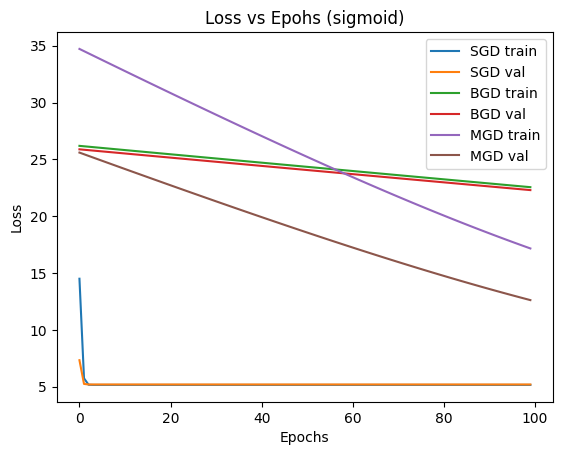

In [25]:
plt.plot(range(num_epochs), SGD_train_loss, label='SGD train')
plt.plot(range(num_epochs), SGD_val_loss, label='SGD val')
plt.plot(range(num_epochs), BGD_train_loss, label='BGD train')
plt.plot(range(num_epochs), BGD_val_loss, label='BGD val')
plt.plot(range(num_epochs), MGD_train_loss, label='MGD train')
plt.plot(range(num_epochs), MGD_val_loss, label='MGD val')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss vs Epohs (sigmoid)')
plt.legend()
plt.show()

In [26]:
lr = 0.001
num_epochs = 100
hidden_layers = [32, 16, 10]
batch_size = 200
input_size = 10
output_size = 8

model2 = MLP_multilabel()

activation = [model2.relu, model2.relu, model2.relu, model2.sigmoid]
der_activation = [model2.der_relu, model2.der_relu, model2.der_relu]

model2.set_lr(lr)
model2.set_hidden(hidden_layers)
model2.set_activation(activation)
model2.set_der_activation(der_activation)

model2.set_optimiser(model2.stochastic_gradient_descent)
SGD_train_loss, SGD_val_loss = model2.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size, MultiLabel=True)

model2.set_optimiser(model2.gradient_descent)
BGD_train_loss, BGD_val_loss = model2.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size,  MultiLabel=True)

model2.set_optimiser(model2.minibatch_gradient_descent)
MGD_train_loss, MGD_val_loss = model2.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size, MultiLabel=True)


----------SGD--------------
----------------------
Epoch 10/100, Training loss 5.160685403470492, Training accuracy 0.34339285714285717
Validation loss 5.198823520257612, Validation accuracy 0.3513681592039801
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/100, Tra

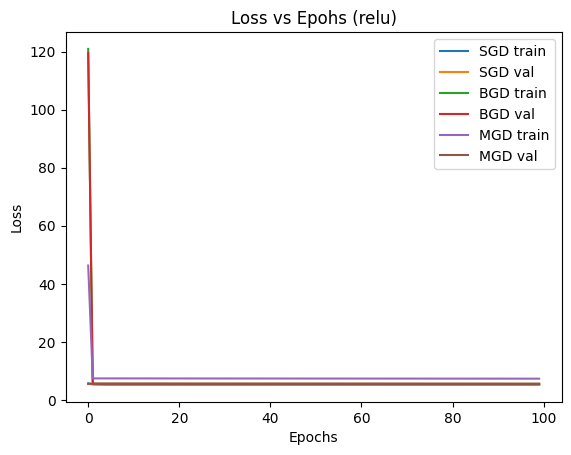

In [27]:
plt.plot(range(num_epochs), SGD_train_loss, label='SGD train')
plt.plot(range(num_epochs), SGD_val_loss, label='SGD val')
plt.plot(range(num_epochs), BGD_train_loss, label='BGD train')
plt.plot(range(num_epochs), BGD_val_loss, label='BGD val')
plt.plot(range(num_epochs), MGD_train_loss, label='MGD train')
plt.plot(range(num_epochs), MGD_val_loss, label='MGD val')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss vs Epohs (relu)')
plt.legend()
plt.show()

In [28]:
lr = 0.001
num_epochs = 100
hidden_layers = [32, 16, 10]
batch_size = 200
input_size = 10
output_size = 8

model3 = MLP_multilabel()

activation = [model3.tanh, model3.tanh, model3.tanh, model3.sigmoid]
der_activation = [model3.der_tanh, model3.der_tanh, model3.der_tanh]

model3.set_lr(lr)
model3.set_hidden(hidden_layers)
model3.set_activation(activation)
model3.set_der_activation(der_activation)

model3.set_optimiser(model3.stochastic_gradient_descent)
SGD_train_loss, SGD_val_loss = model3.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size, MultiLabel=True)

model3.set_optimiser(model3.gradient_descent)
BGD_train_loss, BGD_val_loss = model3.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size,  MultiLabel=True)

model3.set_optimiser(model3.minibatch_gradient_descent)
MGD_train_loss, MGD_val_loss = model3.fit(X_train, Y_train, Y_train_oh, X_val, Y_val, Y_val_oh, num_epochs, input_size, output_size, batch_size, MultiLabel=True)


----------SGD--------------
----------------------
Epoch 10/100, Training loss 5.150772359657083, Training accuracy 0.34339285714285717
Validation loss 5.189751785791684, Validation accuracy 0.3513681592039801
Classification Report on the Validation data
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0

   micro avg       0.00      0.00      0.00         0
   macro avg       0.00      0.00      0.00         0
weighted avg       0.00      0.00      0.00         0
 samples avg       0.00      0.00      0.00         0

----------------------
Epoch 20/100, Tra

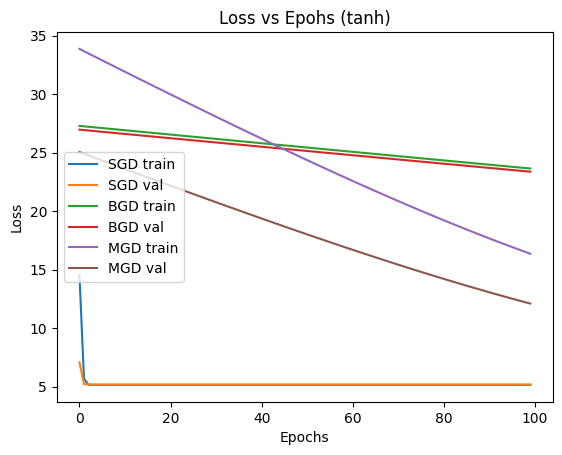

In [29]:
plt.plot(range(num_epochs), SGD_train_loss, label='SGD train')
plt.plot(range(num_epochs), SGD_val_loss, label='SGD val')
plt.plot(range(num_epochs), BGD_train_loss, label='BGD train')
plt.plot(range(num_epochs), BGD_val_loss, label='BGD val')
plt.plot(range(num_epochs), MGD_train_loss, label='MGD train')
plt.plot(range(num_epochs), MGD_val_loss, label='MGD val')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss vs Epohs (tanh)')
plt.legend()
plt.show()

In [31]:
Y_pred_test, _ = model3.forward_prop(X_test)
loss_test = model3.loss(Y_pred_test, Y_test_oh)

Y_pred_test[Y_pred_test > 0.5] = 1
Y_pred_test[Y_pred_test<0.5] = 0

print(f'LOSS FOR TEST SET {loss_test}')
print(f"ACCURACY FOR THE TEST IS {1 - hamming_loss(Y_pred_test, Y_test_oh)}")

LOSS FOR TEST SET 12.304999624154005
ACCURACY FOR THE TEST IS 0.6590909090909091


### Question 3
### Multilayer Perceptron Regression

In this part if the assignment, we need to implement the regression version of Multilayer Perceptrons. Let us start by preprocessing the data given to us.

In [2]:
housing_data = pd.read_csv('HousingData.csv')
print(housing_data.head())

      CRIM    ZN  INDUS  CHAS    NOX     RM   AGE     DIS  RAD  TAX  PTRATIO  \
0  0.00632  18.0   2.31   0.0  0.538  6.575  65.2  4.0900    1  296     15.3   
1  0.02731   0.0   7.07   0.0  0.469  6.421  78.9  4.9671    2  242     17.8   
2  0.02729   0.0   7.07   0.0  0.469  7.185  61.1  4.9671    2  242     17.8   
3  0.03237   0.0   2.18   0.0  0.458  6.998  45.8  6.0622    3  222     18.7   
4  0.06905   0.0   2.18   0.0  0.458  7.147  54.2  6.0622    3  222     18.7   

        B  LSTAT  MEDV  
0  396.90   4.98  24.0  
1  396.90   9.14  21.6  
2  392.83   4.03  34.7  
3  394.63   2.94  33.4  
4  396.90    NaN  36.2  


Let us now observe the Mean, Standard Deviation, Minimum of data, Maximum of data.

In [3]:
print('---Mean of Data---')
print(housing_data.mean())
print('---Standard Deviation of Data---')
print(housing_data.std())
print('---Min of Data---')
print(housing_data.min())
print('---Max of Data---')
print(housing_data.max())

---Mean of Data---
CRIM         3.611874
ZN          11.211934
INDUS       11.083992
CHAS         0.069959
NOX          0.554695
RM           6.284634
AGE         68.518519
DIS          3.795043
RAD          9.549407
TAX        408.237154
PTRATIO     18.455534
B          356.674032
LSTAT       12.715432
MEDV        22.532806
dtype: float64
---Standard Deviation of Data---
CRIM         8.720192
ZN          23.388876
INDUS        6.835896
CHAS         0.255340
NOX          0.115878
RM           0.702617
AGE         27.999513
DIS          2.105710
RAD          8.707259
TAX        168.537116
PTRATIO      2.164946
B           91.294864
LSTAT        7.155871
MEDV         9.197104
dtype: float64
---Min of Data---
CRIM         0.00632
ZN           0.00000
INDUS        0.46000
CHAS         0.00000
NOX          0.38500
RM           3.56100
AGE          2.90000
DIS          1.12960
RAD          1.00000
TAX        187.00000
PTRATIO     12.60000
B            0.32000
LSTAT        1.73000
MEDV       

Let us now observe the distribution of various labels across the dataset.

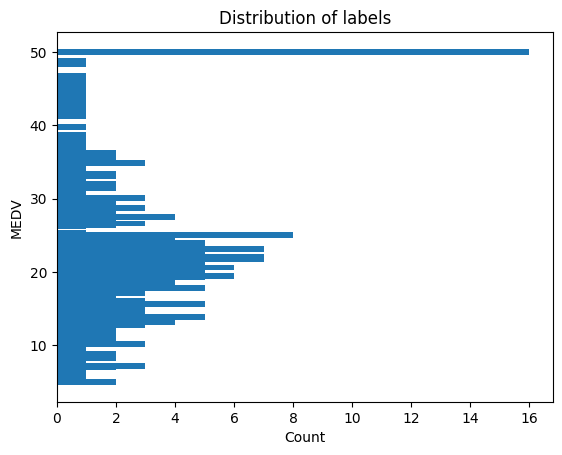

In [4]:
counter = Counter(housing_data['MEDV'])

count = list(counter.values())
labels = list(counter.keys())

plt.barh(labels, count)
plt.xlabel('Count')
plt.ylabel('MEDV')
plt.title('Distribution of labels')
plt.show()

Now let us Standaradize the data as well as handle the missing data values and then proceed to splitting the data into train, val and test.

In [5]:
feature_columns = housing_data.columns.tolist()

imputer = SimpleImputer(strategy='mean')
data_housing = pd.DataFrame(imputer.fit_transform(housing_data), columns=housing_data.columns)

scaler = StandardScaler()
data_housing = pd.DataFrame(scaler.fit_transform(data_housing[feature_columns[:-1]]), columns=feature_columns[:-1])
data_housing = pd.concat([data_housing, housing_data['MEDV']], axis = 1)

Train_df, rest_df = train_test_split(data_housing, test_size=0.3)
Test_df, Val_df = train_test_split(rest_df, test_size=0.2/0.3)


X_train = Train_df[feature_columns[:-1]].to_numpy()
X_val = Val_df[feature_columns[:-1]].to_numpy()
X_test = Test_df[feature_columns[:-1]].to_numpy()

Y_train = Train_df[feature_columns[-1]].to_numpy()
Y_val = Val_df[feature_columns[-1]].to_numpy()
Y_test = Test_df[feature_columns[-1]].to_numpy()

Now that our data is ready with us, we can now implement the class which preforms regrssion for us. There will only be minor changes made to the previoully made MLP class.

In [6]:
class MLP_regression:

    def __init__(self, lr = 0.0, activation = None, der_activation = None, optimiser = None, hidden_layers = None):
        self.lr = lr
        self.activation = activation
        self.optim = optimiser
        self.hidden = hidden_layers
        self.der_activation = der_activation

    def set_der_activation(self, der_activation):
        self.der_activation = der_activation

    def set_lr(self, lr):
        self.lr = lr

    def set_activation(self, activation):
        self.activation = activation

    def set_optimiser(self, optimiser):
        self.optim = optimiser
    
    def set_hidden(self, hidden):
        self.hidden = hidden

    def sigmoid(self, x):
        return 1/(1 + np.exp(-x))

    def relu(self, x):
        return np.maximum(0, x)
    
    def tanh(self, x):
        return np.tanh(x)

    def linear(self, x):
        return x

    def der_tanh(self, x):
        return 1 - (np.tanh(x)**2)

    def der_relu(self, x):
        return np.where(x > 0, 1, 0)

    def der_sigmoid(self, x):
        return self.sigmoid(x)*(1 - self.sigmoid(x))

    def initialisation(self, input_size, output_size):
        self.params = {}

        self.params['W1'] = np.random.rand(self.hidden[0], input_size)
        self.params['b1'] = np.zeros((self.hidden[0], 1))
        i = 0
        for i in range(1, len(self.hidden)):
            self.params['W'+str(i+1)] = np.random.rand(self.hidden[i], self.hidden[i-1])
            self.params['b'+str(i+1)] = np.zeros((self.hidden[i], 1))
        
        self.params['W'+str(i+2)] = np.random.rand(output_size, self.hidden[-1])
        self.params['b'+str(i+2)] = np.zeros((output_size, 1))

    def forward_prop(self, input):
        cache = {}

        cache['Z1'] = np.dot(self.params['W1'], input.T) + self.params['b1']
        cache['A1'] = self.activation[0](cache['Z1'])

        for i in range(1, len(self.activation)):
            cache['Z'+str(i+1)] = np.dot(self.params['W'+str(i+1)], cache['A'+str(i)]) + self.params['b'+str(i+1)]
            cache['A'+str(i+1)] = self.activation[i](cache['Z'+str(i+1)])

        return cache['A'+str(len(self.activation))], cache

    def loss(self, A, Y):
        m = Y.shape[0]
        return np.sum((np.squeeze(A) -Y)**2)/m

    def backward_prop(self, cache, X, Y):
        m = X.shape[0]
        self.gradients = {}

        dZ = (cache['A'+str(len(self.activation))] - Y)*2
        for i in range(len(self.activation) - 1, 0, -1):
            self.gradients['dW'+str(i+1)] = np.dot(dZ, cache['A' + str(i)].T)/m
            self.gradients['db'+str(i+1)] = np.sum(dZ, axis = 1, keepdims=True)/m
            dZ = np.dot(self.params['W'+str(i+1)].T, dZ) * self.der_activation[i - 1](cache['Z'+str(i)])

        self.gradients['dW1'] = np.dot(dZ, X)/m
        self.gradients['db1'] = np.sum(dZ, axis = 1, keepdims=True)/m 

    def optimisation(self):
        for i in range(len(self.activation)):
            self.params['W'+str(i+1)] -= self.lr*self.gradients['dW'+str(i+1)]
            self.params['b'+str(i+1)] -= self.lr*self.gradients['db'+str(i+1)]

    def gradient_descent(self,X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size,batch_size):
        train_loss = []
        val_loss = []
        self.initialisation(input_size, output_size)
        print('----------BGD--------------')

        for epoch in range(num_epochs):
            Y_pred_train, train_cache = self.forward_prop(X_train)
            Y_pred_val, _ = self.forward_prop(X_val)
            
            Loss_train = self.loss(Y_pred_train, Y_train)
            train_loss.append(Loss_train)

            Loss_val = self.loss(Y_pred_val, Y_val)
            val_loss.append(Loss_val)

            self.backward_prop(train_cache, X_train, Y_train)

            self.optimisation()


            if (epoch+1)%10 == 0:
                print('----------------------')
                print(f'Epoch {epoch+1}/{num_epochs}')
                print(f'Training MSE loss {Loss_train}, Validation MSE Loss {Loss_val}')
                print(f'Training RMSE loss {np.sqrt(Loss_train)}, Validation accuracy {np.sqrt(Loss_val)}')
                print(f'Training Rsquared loss {r2_score(Y_train, np.squeeze(Y_pred_train))}, Validation Rsquared loss {r2_score(Y_val, np.squeeze(Y_pred_val))}')

        

            data_to_log = {
                'Epoch' : epoch+1,
                'Train Loss' : Loss_train,
                'Validation Loss' : Loss_val,
                'Train RMSE': np.sqrt(Loss_train),
                'Validation RMSE': np.sqrt(Loss_val)
            }

            wandb.log(data_to_log)

        return train_loss, val_loss

      
    def stochastic_gradient_descent(self,X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size,batch_size):
        train_loss = []
        val_loss = []
        self.initialisation(input_size, output_size)
        print('----------SGD--------------')

        for epoch in range(num_epochs):
            Loss_train = 0

            for i in range(len(X_train)):
                Y_pred_train, train_cache = self.forward_prop(X_train[i][np.newaxis, :])

                
                Loss_train += self.loss(Y_pred_train, Y_train[i][np.newaxis, np.newaxis])

                self.backward_prop(train_cache, X_train[i][np.newaxis, :], Y_train[i][np.newaxis, np.newaxis])

                self.optimisation()


            train_loss.append(Loss_train/len(X_train))
            

            Y_pred_val, _ = self.forward_prop(X_val)
            Loss_val = self.loss(Y_pred_val, Y_val)
            val_loss.append(Loss_val)

            Y_pred_train, _ = self.forward_prop(X_train)

            if (epoch+1)%10 == 0:
                print('----------------------')
                print(f'Epoch {epoch+1}/{num_epochs}')
                print(f'Training MSE loss {Loss_train/len(X_train)}, Validation MSE Loss {Loss_val}')
                print(f'Training RMSE loss {np.sqrt(Loss_train/len(X_train))}, Validation accuracy {np.sqrt(Loss_val)}')
                print(f'Training Rsquared loss {r2_score(Y_train, np.squeeze(Y_pred_train))}, Validation Rsquared loss {r2_score(Y_val, np.squeeze(Y_pred_val))}')

            
            Loss_train = 0

            data_to_log = {
                'Epoch' : epoch+1,
                'Train Loss' : Loss_train/len(X_train),
                'Validation Loss' : Loss_val/len(X_train),
                'Train RMSE': np.sqrt(Loss_train/len(X_train)),
                'Validation RMSE': np.sqrt(Loss_val/len(X_train))
            }

            wandb.log(data_to_log)

        return train_loss, val_loss
            
            

      
    def minibatch_gradient_descent(self,X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size):
        train_loss = []
        val_loss = []
        self.initialisation(input_size, output_size)
        print('----------MGD--------------')

        for epoch in range(num_epochs):
            Loss_train = 0
            for i in range(len(X_train)//batch_size):
                Y_pred_train, train_cache = self.forward_prop(X_train[i*batch_size:(i+1)*batch_size])

                
                Loss_train += self.loss(Y_pred_train, Y_train[i*batch_size:(i+1)*batch_size])

                self.backward_prop(train_cache, X_train[i*batch_size:(i+1)*batch_size], Y_train[i*batch_size:(i+1)*batch_size])

                self.optimisation()


            if len(X_train)%batch_size != 0:
                Y_pred_train, train_cache = self.forward_prop(X_train[(len(X_train)//batch_size)*batch_size:])

                
                Loss_train += self.loss(Y_pred_train, Y_train[(len(X_train)//batch_size)*batch_size:])

                self.backward_prop(train_cache, X_train[(len(X_train)//batch_size)*batch_size:], Y_train[(len(X_train)//batch_size)*batch_size:])

                self.optimisation()                           


            train_loss.append(Loss_train/(len(X_train)//batch_size))

            Y_pred_val, _ = self.forward_prop(X_val)
            Loss_val = self.loss(Y_pred_val, Y_val)
            val_loss.append(Loss_val)

            Y_pred_train, _ = self.forward_prop(X_train)

            if (epoch+1)%10 == 0:
                print('----------------------')
                print(f'Epoch {epoch+1}/{num_epochs}')
                print(f'Training MSE loss {Loss_train/(len(X_train)//batch_size)}, Validation MSE Loss {Loss_val}')
                print(f'Training RMSE loss {np.sqrt(Loss_train/(len(X_train)//batch_size))}, Validation accuracy {np.sqrt(Loss_val)}')
                print(f'Training Rsquared loss {r2_score(Y_train, np.squeeze(Y_pred_train))}, Validation Rsquared loss {r2_score(Y_val, np.squeeze(Y_pred_val))}')

            Loss_train = 0

            data_to_log = {
                'Epoch' : epoch+1,
                'Train Loss' : Loss_train/(len(X_train)//batch_size),
                'Validation Loss' : Loss_val/(len(X_train)//batch_size),
                'Train RMSE': np.sqrt(Loss_train/(len(X_train)//batch_size)),
                'Validation RMSE': np.sqrt(Loss_val/(len(X_train)//batch_size))
            }

            wandb.log(data_to_log)
        return train_loss, val_loss

    def fit(self, X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size,batch_size):
        return self.optim(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size,batch_size)


In [7]:
def main1():
    wandb.init(project='SMAI3-3')

    config = wandb.config

    input_size = 13
    output_size = 1
    model = MLP_regression()
    model.set_lr(config['learning_rate'])
    model.set_hidden(config['hidden_layers'])
    batch_size = 50

    if config['activation'] == 'sigmoid':
        activation = [model.sigmoid, model.sigmoid, model.sigmoid, model.linear]
        der_activation = [model.der_sigmoid, model.der_sigmoid, model.der_sigmoid, model.sigmoid]

    elif config['activation'] == 'relu':
        activation = [model.relu, model.relu, model.relu, model.linear]
        der_activation = [model.der_relu, model.der_relu, model.der_relu, model.sigmoid]

    else :
        activation = [model.tanh, model.tanh, model.tanh, model.linear]
        der_activation = [model.der_tanh, model.der_tanh, model.der_tanh, model.sigmoid]
    
    model.set_activation(activation)
    model.set_der_activation(der_activation)

    if config['optimiser'] == 'sgd':
        model.set_optimiser(model.stochastic_gradient_descent)
    elif config['optimiser'] == 'bgd':
        model.set_optimiser(model.gradient_descent)
    else :
        model.set_optimiser(model.minibatch_gradient_descent)

    model.fit(X_train, Y_train, X_val, Y_val, config['n_iterations'], input_size, output_size, batch_size)
        
    

sweep_config = {
    'method':'random',
    'metric':{
        'name':'accuracy',
        'goal':'maximize'
    },
    'parameters':{
        'learning_rate':{
            'values':[0.0001, 0.001, 0.01, 0.1]
        },
        'n_iterations':{
            'values':[1000, 5000]
        },
        'optimiser':{
            'values':['sgd', 'bgd', 'mgd']
        },
        'activation':{
            'values':['sigmoid', 'tanh', 'relu']
        },
        'hidden_layers':{
            'values': [[8,8,8],[16,16],[32],[16, 32, 16]]
        }
    }
}


sweep_id = wandb.sweep(sweep=sweep_config, project = 'SMAI3-3')
wandb.agent(sweep_id, function=main1)

wandb.run.name = 'e2.GD.ce'

/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "


Create sweep with ID: 13rf1shv
Sweep URL: https://wandb.ai/music-cognition/SMAI3-3/sweeps/13rf1shv


wandb: Agent Starting Run: 0oa8a1r4 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: Currently logged in as: vedu-agrawal (music-cognition). Use `wandb login --relogin` to force relogin
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211234-0oa8a1r4
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run electric-sweep-1
wandb: ⭐️ View project at https://wandb.ai/music-cognition/SMAI3-3
wandb: 🧹 View sweep at https://wandb.ai/music-cognition/SMAI3-3/sweeps/13rf1shv
wandb: 

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 1330.8871895364323, Validation MSE Loss 1338.9231168187077
Training RMSE loss 36.48132658685032, Validation accuracy 36.5912983756891
Training Rsquared loss -14.144230791774797, Validation Rsquared loss -15.882089172306664
----------------------
Epoch 20/1000
Training MSE loss 917.721776181072, Validation MSE Loss 922.7300095736479
Training RMSE loss 30.2939230899709, Validation accuracy 30.37647131537249
Training Rsquared loss -9.442801230932723, Validation Rsquared loss -10.634432259709007
----------------------
Epoch 30/1000
Training MSE loss 641.889252571545, Validation MSE Loss 644.4236396192674
Training RMSE loss 25.33553339820468, Validation accuracy 25.385500578465404
Training Rsquared loss -6.304089377469507, Validation Rsquared loss -7.125348806168942
----------------------
Epoch 40/1000
Training MSE loss 457.7412609404993, Validation MSE Loss 458.25433541142405
Training RMSE loss 21.3948886638

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 830/1000
Training MSE loss 87.88080476555776, Validation MSE Loss 79.36537276238332
Training RMSE loss 9.374476239532411, Validation accuracy 8.908724530615105
Training Rsquared loss -5.773159728050814e-14, Validation Rsquared loss -0.0006947249901965158
----------------------
Epoch 840/1000
Training MSE loss 87.88080476555606, Validation MSE Loss 79.36537256896489
Training RMSE loss 9.374476239532322, Validation accuracy 8.908724519759541
Training Rsquared loss -3.8413716652030416e-14, Validation Rsquared loss -0.0006947225514402078
----------------------
Epoch 850/1000
Training MSE loss 87.88080476555496, Validation MSE Loss 79.36537241092822
Training RMSE loss 9.374476239532262, Validation accuracy 8.908724510889773
Training Rsquared loss -2.5757174171303632e-14, Validation Rsquared loss -0.0006947205588021532
----------------------
Epoch 860/1000
Training MSE loss 87.88080476555419, Validation MSE Loss 79.36537228180092
Training RMSE loss 9.374476239532

wandb: / 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 87.8808
wandb:      Train RMSE 9.37448
wandb: Validation Loss 79.36537
wandb: Validation RMSE 8.90872
wandb: 
wandb: 🚀 View run electric-sweep-1 at: https://wandb.ai/music-cognition/SMAI3-3/runs/0oa8a1r4
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211234-0oa8a1r4/logs
wandb: Agent Starting Run: 4129s07o with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wand

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 402.17873055016804, Validation MSE Loss 366.60263673487555
Training RMSE loss 20.054394295270253, Validation accuracy 19.14687015506387
Training Rsquared loss -3.1814447656001557, Validation Rsquared loss -3.6223852037644058
----------------------
Epoch 20/5000
Training MSE loss 329.9443147282264, Validation MSE Loss 301.69486965455195
Training RMSE loss 18.164369373260016, Validation accuracy 17.36936583915924
Training Rsquared loss -2.454450295314516, Validation Rsquared loss -2.803982191626626
----------------------
Epoch 30/5000
Training MSE loss 274.22564361424287, Validation MSE Loss 251.35079059129382
Training RMSE loss 16.559759769218964, Validation accuracy 15.854046505270944
Training Rsquared loss -1.8917743982002628, Validation Rsquared loss -2.1692084534130527
----------------------
Epoch 40/5000
Training MSE loss 231.39455291196654, Validation MSE Loss 212.4050481310819
Training RMSE loss 15

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4930/5000
Training MSE loss 82.70742600387221, Validation MSE Loss 71.13105835579194
Training RMSE loss 9.094362319804079, Validation accuracy 8.433923070303162
Training Rsquared loss 0.1017494785773918, Validation Rsquared loss 0.10312933207379671
----------------------
Epoch 4940/5000
Training MSE loss 82.45923570483812, Validation MSE Loss 70.94537803705371
Training RMSE loss 9.080706784432483, Validation accuracy 8.422907932362417
Training Rsquared loss 0.10437431793409657, Validation Rsquared loss 0.10547052079412367
----------------------
Epoch 4950/5000
Training MSE loss 82.20552352887752, Validation MSE Loss 70.75631158119882
Training RMSE loss 9.066726174804085, Validation accuracy 8.411677096821942
Training Rsquared loss 0.10706041866163885, Validation Rsquared loss 0.10785440432495574
----------------------
Epoch 4960/5000
Training MSE loss 81.94625322435023, Validation MSE Loss 70.5638719119097
Training RMSE loss 9.052416982461105, Validation ac

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁
wandb: Validation RMSE █▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 9.96583
wandb: Validation RMSE 3.15687
wandb: 
wandb: 🚀 View run dutiful-sweep-2 at: https://wandb.ai/music-cognition/SMAI3-3/runs/4129s07o
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211245-4129s07o/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: zl0q8fr9 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 101.62969519579362, Validation MSE Loss 94.55912736399588
Training RMSE loss 10.081155449440983, Validation accuracy 9.724151755500111
Training Rsquared loss -0.15644930046919847, Validation Rsquared loss -0.19226832382088932
----------------------
Epoch 20/1000
Training MSE loss 89.06137113834787, Validation MSE Loss 80.59473167953021
Training RMSE loss 9.437233235347522, Validation accuracy 8.97745686035473
Training Rsquared loss -0.013433722824280903, Validation Rsquared loss -0.016195351279595593
----------------------
Epoch 30/1000
Training MSE loss 88.59453444334841, Validation MSE Loss 79.96491629107935
Training RMSE loss 9.412466969044216, Validation accuracy 8.94231045597721
Training Rsquared loss -0.008121565109693751, Validation Rsquared loss -0.00825419363106561
----------------------
Epoch 40/1000
Training MSE loss 88.43445674473965, Validation MSE Loss 79.80964349336011
Training RMSE loss 9

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000
Training MSE loss 10.493334532176677, Validation MSE Loss 26.22228990496156
Training RMSE loss 3.23934168191265, Validation accuracy 5.120770440564736
Training Rsquared loss 0.880595830225148, Validation Rsquared loss 0.669370831740163


wandb: / 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁
wandb: Validation Loss █▆▆▆▅▅▅▅▅▅▅▅▅▅▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 10.49333
wandb:      Train RMSE 3.23934
wandb: Validation Loss 26.22229
wandb: Validation RMSE 5.12077
wandb: 
wandb: 🚀 View run exalted-sweep-3 at: https://wandb.ai/music-cognition/SMAI3-3/runs/zl0q8fr9
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211317-zl0q8fr9/logs
wandb: Agent Starting Run: xdkqpxxf with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	o

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 122.7274155681243, Validation MSE Loss 107.100228213516
Training RMSE loss 11.078240635052314, Validation accuracy 10.348924012355875
Training Rsquared loss -0.28868929262069387, Validation Rsquared loss -0.3503953889234308
----------------------
Epoch 20/5000
Training MSE loss 94.41244134911872, Validation MSE Loss 81.85643633325996
Training RMSE loss 9.716606472895705, Validation accuracy 9.04745468810206
Training Rsquared loss -0.021075816452410967, Validation Rsquared loss -0.03210381548177432
----------------------
Epoch 30/5000
Training MSE loss 93.21698848832493, Validation MSE Loss 80.05927255476061
Training RMSE loss 9.654894535328955, Validation accuracy 8.947584733030506
Training Rsquared loss -0.004526643719981793, Validation Rsquared loss -0.00944390410616558
----------------------
Epoch 40/5000
Training MSE loss 93.15429875584813, Validation MSE Loss 79.82923444600316
Training RMSE loss 9.6

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4930/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 4940/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 4950/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 4960/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.6513066011698

wandb: / 0.002 MB of 0.144 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.39696
wandb: Validation RMSE 3.37594
wandb: 
wandb: 🚀 View run peach-sweep-4 at: https://wandb.ai/music-cognition/SMAI3-3/runs/xdkqpxxf
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211329-xdkqpxxf/logs
wandb: Agent Starting Run: b7bwzlql with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sg

----------SGD--------------


wandb: 🚀 View run hopeful-sweep-5 at: https://wandb.ai/music-cognition/SMAI3-3/runs/b7bwzlql
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211355-b7bwzlql/logs
Run b7bwzlql errored: KeyError('W4')
wandb: ERROR Run b7bwzlql errored: KeyError('W4')
wandb: Agent Starting Run: 10f7621a with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211407-10f7621a
wandb: Run `wandb

----------MGD--------------


wandb: 🚀 View run winter-sweep-6 at: https://wandb.ai/music-cognition/SMAI3-3/runs/10f7621a
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211407-10f7621a/logs
Run 10f7621a errored: KeyError('W4')
wandb: ERROR Run 10f7621a errored: KeyError('W4')
wandb: Agent Starting Run: pt3u0w7a with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211417-pt3u0w7a
wandb: Run `wandb offlin

----------SGD--------------


wandb: 🚀 View run tough-sweep-7 at: https://wandb.ai/music-cognition/SMAI3-3/runs/pt3u0w7a
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211417-pt3u0w7a/logs
Run pt3u0w7a errored: KeyError('W3')
wandb: ERROR Run pt3u0w7a errored: KeyError('W3')
wandb: Agent Starting Run: hz8z6mxo with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211428-hz8z6mxo
wandb: Run `wandb of

----------SGD--------------
----------------------
Epoch 10/1000
Training MSE loss 20.602981349379384, Validation MSE Loss 36.54704944111061
Training RMSE loss 4.539050710157288, Validation accuracy 6.0454155722423755
Training Rsquared loss 0.815884866744243, Validation Rsquared loss 0.5391889646991052
----------------------
Epoch 20/1000
Training MSE loss 17.08163333505605, Validation MSE Loss 36.23894789429407
Training RMSE loss 4.132993265788858, Validation accuracy 6.01987939200563
Training Rsquared loss 0.8515451234654929, Validation Rsquared loss 0.5430737268054171
----------------------
Epoch 30/1000
Training MSE loss 12.664145189091006, Validation MSE Loss 35.568927407456044
Training RMSE loss 3.5586718293614834, Validation accuracy 5.96396909846589
Training Rsquared loss 0.8918744617954042, Validation Rsquared loss 0.5515218187563184
----------------------
Epoch 40/1000
Training MSE loss 11.174508932919, Validation MSE Loss 38.47747674124387
Training RMSE loss 3.34282948008405

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000
Training MSE loss 7.984837408845979, Validation MSE Loss 39.28323919474514
Training RMSE loss 2.8257454607317305, Validation accuracy 6.267634258214589
Training Rsquared loss 0.9120037329300885, Validation Rsquared loss 0.5046891500099959


wandb: | 0.002 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▅▂▁▁▁▃▄▃▅▅▆▅▆▆▆▆▆▆▅▅▆▇▇▇▆▅▅▆▆▆▇▆▇▇█▇█▇▇
wandb: Validation RMSE █▅▂▁▁▁▃▄▃▆▅▆▆▆▆▆▆▆▆▅▅▆▇▇▇▆▅▅▆▆▆▇▇▇▇█▇█▇█
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.11097
wandb: Validation RMSE 0.33312
wandb: 
wandb: 🚀 View run effortless-sweep-8 at: https://wandb.ai/music-cognition/SMAI3-3/runs/hz8z6mxo
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211428-hz8z6mxo/logs
wandb: Agent Starting Run: dpuufhsp with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	opti

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 121.59046866094745, Validation MSE Loss 106.69409035704162
Training RMSE loss 11.026806820695983, Validation accuracy 10.3292831482655
Training Rsquared loss -0.2873882194615409, Validation Rsquared loss -0.3452745157208372
----------------------
Epoch 20/1000
Training MSE loss 95.84601131139115, Validation MSE Loss 83.21658354486178
Training RMSE loss 9.790097615008298, Validation accuracy 9.122312401187639
Training Rsquared loss -0.03806872631916369, Validation Rsquared loss -0.04925351304490566
----------------------
Epoch 30/1000
Training MSE loss 94.07413586047126, Validation MSE Loss 80.85653614748236
Training RMSE loss 9.699182226377193, Validation accuracy 8.992026253714029
Training Rsquared loss -0.015190116410779497, Validation Rsquared loss -0.01949636708711866
----------------------
Epoch 40/1000
Training MSE loss 93.81242025373562, Validation MSE Loss 80.41148898149008
Training RMSE loss 9.6

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 960/1000
Training MSE loss 12.37627858309249, Validation MSE Loss 30.89452349916055
Training RMSE loss 3.5179935450612314, Validation accuracy 5.558284222596083
Training Rsquared loss 0.8622511675047457, Validation Rsquared loss 0.6104600076754276
----------------------
Epoch 970/1000
Training MSE loss 12.18395397733922, Validation MSE Loss 30.768862131371915
Training RMSE loss 3.4905521020805894, Validation accuracy 5.546968733585211
Training Rsquared loss 0.8644286709721531, Validation Rsquared loss 0.6120444350334093
----------------------
Epoch 980/1000
Training MSE loss 11.999290430269117, Validation MSE Loss 30.645028470127325
Training RMSE loss 3.463999196054918, Validation accuracy 5.535795197632163
Training Rsquared loss 0.866520580300132, Validation Rsquared loss 0.6136058173752361
----------------------
Epoch 990/1000
Training MSE loss 11.822084153752703, Validation MSE Loss 30.52325448761274
Training RMSE loss 3.4383257777227425, Validation accu

wandb: | 0.028 MB of 0.034 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 4.3434
wandb: Validation RMSE 2.08408
wandb: 
wandb: 🚀 View run dazzling-sweep-9 at: https://wandb.ai/music-cognition/SMAI3-3/runs/dpuufhsp
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211533-dpuufhsp/logs
wandb: Agent Starting Run: 8n20g8hw with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimis

----------SGD--------------


wandb: 🚀 View run graceful-sweep-10 at: https://wandb.ai/music-cognition/SMAI3-3/runs/8n20g8hw
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211549-8n20g8hw/logs
Run 8n20g8hw errored: KeyError('W4')
wandb: ERROR Run 8n20g8hw errored: KeyError('W4')
wandb: Agent Starting Run: aei6cc7f with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211600-aei6cc7f
wandb: Run `wandb o

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 122.24290471430318, Validation MSE Loss 106.69979079800572
Training RMSE loss 11.056351329181936, Validation accuracy 10.329559080522543
Training Rsquared loss -0.2843363232157077, Validation Rsquared loss -0.3453463909102852
----------------------
Epoch 20/5000
Training MSE loss 94.39251196387798, Validation MSE Loss 81.83232833446624
Training RMSE loss 9.71558088659026, Validation accuracy 9.046122281644564
Training Rsquared loss -0.020841940745336185, Validation Rsquared loss -0.03179984479048592
----------------------
Epoch 30/5000
Training MSE loss 93.21604115684104, Validation MSE Loss 80.05667120481041
Training RMSE loss 9.654845475554803, Validation accuracy 8.947439365807986
Training Rsquared loss -0.0045050782557947144, Validation Rsquared loss -0.009411104447039742
----------------------
Epoch 40/5000
Training MSE loss 93.15422941209638, Validation MSE Loss 79.82880401952079
Training RMSE loss

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4910/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 4920/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 4930/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 4940/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.6513066011698

wandb: | 0.144 MB of 0.144 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.39696
wandb: Validation RMSE 3.37594
wandb: 
wandb: 🚀 View run smooth-sweep-11 at: https://wandb.ai/music-cognition/SMAI3-3/runs/aei6cc7f
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211600-aei6cc7f/logs
wandb: Agent Starting Run: 47kn91kk with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimi

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 391.25382130916205, Validation MSE Loss 390.601421182657
Training RMSE loss 19.780137039696214, Validation accuracy 19.763638864911922
Training Rsquared loss -3.4520964771879834, Validation Rsquared loss -3.9249788433731174
----------------------
Epoch 20/5000
Training MSE loss 304.9029596320669, Validation MSE Loss 302.84697661604184
Training RMSE loss 17.461470717899648, Validation accuracy 17.40249914857179
Training Rsquared loss -2.4695057748444973, Validation Rsquared loss -2.818508770647923
----------------------
Epoch 30/5000
Training MSE loss 242.83879990867516, Validation MSE Loss 239.60321803223124
Training RMSE loss 15.583285915001213, Validation accuracy 15.479122004565738
Training Rsquared loss -1.7632746486165831, Validation Rsquared loss -2.021086753959946
----------------------
Epoch 40/5000
Training MSE loss 198.38046235657072, Validation MSE Loss 194.15765769151122
Training RMSE loss 14

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000
Training MSE loss 77.27955795189513, Validation MSE Loss 70.83547609468744
Training RMSE loss 8.790879247941877, Validation accuracy 8.41638141333242
Training Rsquared loss 0.12063210893367926, Validation Rsquared loss 0.10685624217568113
----------------------
Epoch 5000/5000
Training MSE loss 76.87791420339296, Validation MSE Loss 70.5524259944134
Training RMSE loss 8.768005143896357, Validation accuracy 8.399549154235208
Training Rsquared loss 0.12520243290344346, Validation Rsquared loss 0.11042513793454312


wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁
wandb:      Train RMSE █▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁
wandb: Validation Loss █▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁
wandb: Validation RMSE █▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 76.87791
wandb:      Train RMSE 8.76801
wandb: Validation Loss 70.55243
wandb: Validation RMSE 8.39955
wandb: 
wandb: 🚀 View run sunny-sweep-12 at: https://wandb.ai/music-cognition/SMAI3-3/runs/47kn91kk
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211622-47kn91kk/logs
wandb: Agent Starting Run: nqgmqenn with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/req

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 86.58574887020471, Validation MSE Loss 83.66006316554028
Training RMSE loss 9.305146364792158, Validation accuracy 9.146587514780595
Training Rsquared loss 0.09911712791167449, Validation Rsquared loss -0.054845217608334274
----------------------
Epoch 20/5000
Training MSE loss 64.87923199774518, Validation MSE Loss 68.97747402594949
Training RMSE loss 8.054764552595264, Validation accuracy 8.305267847935399
Training Rsquared loss 0.3019768751433841, Validation Rsquared loss 0.13028324572260042
----------------------
Epoch 30/5000
Training MSE loss 63.62671949002906, Validation MSE Loss 69.11968597290331
Training RMSE loss 7.976635850408934, Validation accuracy 8.313824990514494
Training Rsquared loss 0.32147138846724355, Validation Rsquared loss 0.1284901369625201
----------------------
Epoch 40/5000
Training MSE loss 62.78105849325694, Validation MSE Loss 68.48999115731114
Training RMSE loss 7.92344991

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000
Training MSE loss 2.116724536003286, Validation MSE Loss 31.255770301064377
Training RMSE loss 1.4548967441036103, Validation accuracy 5.590686031343951
Training Rsquared loss 0.9762591616364192, Validation Rsquared loss 0.6059051526233754
----------------------
Epoch 5000/5000
Training MSE loss 2.208111574855643, Validation MSE Loss 32.66377887004095
Training RMSE loss 1.4859715928831354, Validation accuracy 5.71522343133153
Training Rsquared loss 0.9682836557179056, Validation Rsquared loss 0.5881519852321719


wandb: | 0.141 MB of 0.141 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▇▄▃▃▄▄▄▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁
wandb: Validation RMSE █▇▅▄▃▄▄▄▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▁▁▂▁▂▂▂▂▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 4.66625
wandb: Validation RMSE 2.16015
wandb: 
wandb: 🚀 View run distinctive-sweep-13 at: https://wandb.ai/music-cognition/SMAI3-3/runs/nqgmqenn
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211643-nqgmqenn/logs
wandb: Agent Starting Run: khev2yul with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	op

----------SGD--------------


wandb: 🚀 View run frosty-sweep-14 at: https://wandb.ai/music-cognition/SMAI3-3/runs/khev2yul
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211709-khev2yul/logs
Run khev2yul errored: KeyError('W4')
wandb: ERROR Run khev2yul errored: KeyError('W4')
wandb: Agent Starting Run: 2kinij2d with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211720-2kinij2d
wandb: Run `wandb of

----------SGD--------------


wandb: 🚀 View run stilted-sweep-15 at: https://wandb.ai/music-cognition/SMAI3-3/runs/2kinij2d
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211720-2kinij2d/logs
Run 2kinij2d errored: KeyError('W4')
wandb: ERROR Run 2kinij2d errored: KeyError('W4')
wandb: Agent Starting Run: e5u325ob with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211730-e5u325ob
wandb: Run `wandb offlin

----------BGD--------------


wandb: 🚀 View run giddy-sweep-16 at: https://wandb.ai/music-cognition/SMAI3-3/runs/e5u325ob
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211730-e5u325ob/logs
Run e5u325ob errored: KeyError('W3')
wandb: ERROR Run e5u325ob errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 56ivl8dm with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/w

----------MGD--------------


wandb: 🚀 View run crisp-sweep-17 at: https://wandb.ai/music-cognition/SMAI3-3/runs/56ivl8dm
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211752-56ivl8dm/logs
Run 56ivl8dm errored: KeyError('W4')
wandb: ERROR Run 56ivl8dm errored: KeyError('W4')
wandb: Agent Starting Run: 3k61v47f with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211803-3k61v47f
wandb: Run `wandb off

----------BGD--------------


wandb: 🚀 View run effortless-sweep-18 at: https://wandb.ai/music-cognition/SMAI3-3/runs/3k61v47f
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211803-3k61v47f/logs
Run 3k61v47f errored: KeyError('W4')
wandb: ERROR Run 3k61v47f errored: KeyError('W4')
wandb: Agent Starting Run: v2rubhov with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211813-v2rubhov
wandb: Run `

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 782.4202443306649, Validation MSE Loss 769.1641713571333
Training RMSE loss 27.97177585228841, Validation accuracy 27.733809175032796
Training Rsquared loss -7.903198444961854, Validation Rsquared loss -8.698165612262478
----------------------
Epoch 20/1000
Training MSE loss 760.8897140440812, Validation MSE Loss 751.6037770929897
Training RMSE loss 27.58422944445034, Validation accuracy 27.41539306836562
Training Rsquared loss -7.658201481813615, Validation Rsquared loss -8.476751747534744
----------------------
Epoch 30/1000
Training MSE loss 739.3040959916013, Validation MSE Loss 734.6938475218427
Training RMSE loss 27.190147038800678, Validation accuracy 27.10523653322071
Training Rsquared loss -7.412577672267654, Validation Rsquared loss -8.263539401484715
----------------------
Epoch 40/1000
Training MSE loss 721.6231022572651, Validation MSE Loss 719.5652718343158
Training RMSE loss 26.86304342879

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 950/1000
Training MSE loss 375.1592049433835, Validation MSE Loss 386.5729776623419
Training RMSE loss 19.369026948801107, Validation accuracy 19.661459194636137
Training Rsquared loss -3.2689550459196237, Validation Rsquared loss -3.8741853796698758
----------------------
Epoch 960/1000
Training MSE loss 374.01534105563866, Validation MSE Loss 385.4506077247799
Training RMSE loss 19.33947623529755, Validation accuracy 19.6328960605607
Training Rsquared loss -3.255938962478008, Validation Rsquared loss -3.860033746068047
----------------------
Epoch 970/1000
Training MSE loss 372.878688292166, Validation MSE Loss 384.33406046212195
Training RMSE loss 19.31006701935977, Validation accuracy 19.60443981505521
Training Rsquared loss -3.2430049347741763, Validation Rsquared loss -3.8459555288675897
----------------------
Epoch 980/1000
Training MSE loss 371.7490330707309, Validation MSE Loss 383.2231629431698
Training RMSE loss 19.280794409741805, Validation acc

wandb: / 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▇▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▇▇▆▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▇▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 369.50992
wandb:      Train RMSE 19.22264
wandb: Validation Loss 381.01768
wandb: Validation RMSE 19.51967
wandb: 
wandb: 🚀 View run neat-sweep-19 at: https://wandb.ai/music-cognition/SMAI3-3/runs/v2rubhov
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211813-v2rubhov/logs
wandb: Agent Starting Run: 2wchom6j with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wan

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 550.2798483245103, Validation MSE Loss 497.6178715175777
Training RMSE loss 23.458044426688904, Validation accuracy 22.307350167995697
Training Rsquared loss -4.651312287417904, Validation Rsquared loss -5.274317901578715
----------------------
Epoch 20/1000
Training MSE loss 425.00491102890436, Validation MSE Loss 386.25982188169496
Training RMSE loss 20.615647237690705, Validation accuracy 19.6534938848464
Training Rsquared loss -3.3998294469540857, Validation Rsquared loss -3.870236890210477
----------------------
Epoch 30/1000
Training MSE loss 334.06131769343705, Validation MSE Loss 304.95226473602276
Training RMSE loss 18.277344382963218, Validation accuracy 17.46288248646319
Training Rsquared loss -2.487974201804207, Validation Rsquared loss -2.845053731541094
----------------------
Epoch 40/1000
Training MSE loss 268.0400702356998, Validation MSE Loss 245.52854599304635
Training RMSE loss 16.3719

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 970/1000
Training MSE loss 93.10149919973934, Validation MSE Loss 79.715758587065
Training RMSE loss 9.648911814279336, Validation accuracy 8.928368192848287
Training Rsquared loss -0.0018393355857739824, Validation Rsquared loss -0.00511263716355792
----------------------
Epoch 980/1000
Training MSE loss 93.1014991922962, Validation MSE Loss 79.71575780214388
Training RMSE loss 9.648911813893637, Validation accuracy 8.928368148891705
Training Rsquared loss -0.0018393299465133683, Validation Rsquared loss -0.005112627266717684
----------------------
Epoch 990/1000
Training MSE loss 93.1014991859553, Validation MSE Loss 79.71575713338603
Training RMSE loss 9.648911813565057, Validation accuracy 8.928368111440411
Training Rsquared loss -0.0018393251418296064, Validation Rsquared loss -0.0051126188345458345
----------------------
Epoch 1000/1000
Training MSE loss 93.10149918055332, Validation MSE Loss 79.71575656359988
Training RMSE loss 9.64891181328513, Vali

wandb: | 0.002 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.38797
wandb: Validation RMSE 3.37461
wandb: 
wandb: 🚀 View run snowy-sweep-20 at: https://wandb.ai/music-cognition/SMAI3-3/runs/2wchom6j
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211824-2wchom6j/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: jmrraljs with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learn

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 765.215350183071, Validation MSE Loss 769.6780840744384
Training RMSE loss 27.662526099094258, Validation accuracy 27.743072722293007
Training Rsquared loss -7.7074231082032405, Validation Rsquared loss -8.704645387098944
----------------------
Epoch 20/1000
Training MSE loss 741.6387631561554, Validation MSE Loss 751.8135973153067
Training RMSE loss 27.233045425661732, Validation accuracy 27.419219487711658
Training Rsquared loss -7.439143964767846, Validation Rsquared loss -8.47939730922444
----------------------
Epoch 30/1000
Training MSE loss 721.0381348023374, Validation MSE Loss 735.2574304823215
Training RMSE loss 26.85215326193297, Validation accuracy 27.115630741001056
Training Rsquared loss -7.204728401451419, Validation Rsquared loss -8.270645453860153
----------------------
Epoch 40/1000
Training MSE loss 704.8321690736748, Validation MSE Loss 719.5859903670207
Training RMSE loss 26.548675467

wandb: Waiting for W&B process to finish... (success).



Epoch 860/1000
Training MSE loss 368.14627458494544, Validation MSE Loss 386.8086716676281
Training RMSE loss 19.187138259389947, Validation accuracy 19.667452088860625
Training Rsquared loss -3.189154566427577, Validation Rsquared loss -3.8771571763060226
----------------------
Epoch 870/1000
Training MSE loss 366.9405392342716, Validation MSE Loss 385.68767423947884
Training RMSE loss 19.155692084450294, Validation accuracy 19.638932614566375
Training Rsquared loss -3.1754344445660347, Validation Rsquared loss -3.8630228482731273
----------------------
Epoch 880/1000
Training MSE loss 365.7474709497517, Validation MSE Loss 384.57618059972395
Training RMSE loss 19.124525378417935, Validation accuracy 19.610613978142652
Training Rsquared loss -3.161858461873309, Validation Rsquared loss -3.8490083507227544
----------------------
Epoch 890/1000
Training MSE loss 364.56650499116654, Validation MSE Loss 383.4737268414644
Training RMSE loss 19.093624721125284, Validation accuracy 19.58248

wandb: / 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▇▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▇▇▆▆▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▇▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 352.24345
wandb:      Train RMSE 18.76815
wandb: Validation Loss 371.83892
wandb: Validation RMSE 19.28313
wandb: 
wandb: 🚀 View run charmed-sweep-21 at: https://wandb.ai/music-cognition/SMAI3-3/runs/jmrraljs
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211846-jmrraljs/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: dlbfxx71 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wa

----------MGD--------------


wandb: 🚀 View run dashing-sweep-22 at: https://wandb.ai/music-cognition/SMAI3-3/runs/dlbfxx71
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211907-dlbfxx71/logs
Run dlbfxx71 errored: KeyError('W4')
wandb: ERROR Run dlbfxx71 errored: KeyError('W4')
wandb: Agent Starting Run: qkmun0az with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_211918-qkmun0az
wandb: Run `wandb off

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 93.65322355537842, Validation MSE Loss 80.77997705539629
Training RMSE loss 9.677459561030386, Validation accuracy 8.987768191013622
Training Rsquared loss -0.010874620984720362, Validation Rsquared loss -0.01853105593271942
----------------------
Epoch 20/5000
Training MSE loss 93.65322111007534, Validation MSE Loss 80.77997571795785
Training RMSE loss 9.67745943469025, Validation accuracy 8.987768116610367
Training Rsquared loss -0.010874608712616363, Validation Rsquared loss -0.018531039069350053
----------------------
Epoch 30/5000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.677459434690247, Validation accuracy 8.987768116610365
Training Rsquared loss -0.010874608712615919, Validation Rsquared loss -0.01853103906934961
----------------------
Epoch 40/5000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.6

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4930/5000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.677459434690247, Validation accuracy 8.987768116610365
Training Rsquared loss -0.010874608712615919, Validation Rsquared loss -0.01853103906934961
----------------------
Epoch 4940/5000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.677459434690247, Validation accuracy 8.987768116610365
Training Rsquared loss -0.010874608712615919, Validation Rsquared loss -0.01853103906934961
----------------------
Epoch 4950/5000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.677459434690247, Validation accuracy 8.987768116610365
Training Rsquared loss -0.010874608712615919, Validation Rsquared loss -0.01853103906934961
----------------------
Epoch 4960/5000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.677459434690247, Valida

wandb: | 0.002 MB of 0.002 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.54
wandb: Validation RMSE 3.39706
wandb: 
wandb: 🚀 View run sage-sweep-23 at: https://wandb.ai/music-cognition/SMAI3-3/runs/qkmun0az
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211918-qkmun0az/logs
wandb: Agent Starting Run: 07m5yv5x with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sg

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 13.195938263010783, Validation MSE Loss 32.63072131408244
Training RMSE loss 3.6326214037538764, Validation accuracy 5.712330637671672
Training Rsquared loss 0.8736661856255274, Validation Rsquared loss 0.5885687982668413
----------------------
Epoch 20/5000
Training MSE loss 9.90322190371708, Validation MSE Loss 29.550069149740892
Training RMSE loss 3.1469384969708387, Validation accuracy 5.435997530328807
Training Rsquared loss 0.898858261242621, Validation Rsquared loss 0.6274118385385221
----------------------
Epoch 30/5000
Training MSE loss 8.218736662573981, Validation MSE Loss 28.84708165901901
Training RMSE loss 2.8668339091363455, Validation accuracy 5.370947929278314
Training Rsquared loss 0.9109947600936861, Validation Rsquared loss 0.6362756017795222
----------------------
Epoch 40/5000
Training MSE loss 7.3209057173528524, Validation MSE Loss 27.781567681453406
Training RMSE loss 2.705717227

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 2.402257201721266, Validation MSE Loss 32.48903374420448
Training RMSE loss 1.5499216759956826, Validation accuracy 5.699915240089494
Training Rsquared loss 0.9705723993191911, Validation Rsquared loss 0.590355295310055


wandb: | 0.141 MB of 0.141 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▁▃▅▅▆▇▇▇▇▇▇▇███▇▇▇▇▇▇▇▇▇▇▇████▇▇▇██████
wandb: Validation RMSE ▁▁▃▅▅▆▇▇▇▇▇▇████▇▇▇▇▇▇▇▇▇▇▇█████▇▇██████
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.09178
wandb: Validation RMSE 0.30295
wandb: 
wandb: 🚀 View run dry-sweep-24 at: https://wandb.ai/music-cognition/SMAI3-3/runs/07m5yv5x
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_211940-07m5yv5x/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 5v8f1trb with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rat

----------BGD--------------


wandb: 🚀 View run scarlet-sweep-25 at: https://wandb.ai/music-cognition/SMAI3-3/runs/5v8f1trb
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212330-5v8f1trb/logs
Run 5v8f1trb errored: KeyError('W4')
wandb: ERROR Run 5v8f1trb errored: KeyError('W4')
wandb: Agent Starting Run: 88ugfho6 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_212341-88ugfho6
wandb: Run `wandb off

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 60.55866273741147, Validation MSE Loss 64.8213707716272
Training RMSE loss 7.78194466296256, Validation accuracy 8.051172012299029
Training Rsquared loss 0.2665062982514662, Validation Rsquared loss 0.18268633359779696
----------------------
Epoch 20/1000
Training MSE loss 48.04308590615978, Validation MSE Loss 78.26522269009952
Training RMSE loss 6.931311990248295, Validation accuracy 8.846763401950994
Training Rsquared loss 0.36305910628904947, Validation Rsquared loss 0.01317674484247311
----------------------
Epoch 30/1000
Training MSE loss 40.09736902615075, Validation MSE Loss 59.55514448711347
Training RMSE loss 6.332248338951241, Validation accuracy 7.7171979686356025
Training Rsquared loss 0.5407630405686343, Validation Rsquared loss 0.24908663740907533
----------------------
Epoch 40/1000
Training MSE loss 33.22083251517068, Validation MSE Loss 59.774830839866375
Training RMSE loss 5.7637516007

wandb: Waiting for W&B process to finish... (success).
wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▄▁▆▄▄▄▃▃▄▄▃▃▂▂▂▁▂▁▃▃▁▂▃▄▃▄▄▄▄▄▄▄▄▃▃▃▃▃▄
wandb: Validation RMSE █▄▁▇▄▄▄▄▃▅▄▃▃▃▂▂▂▃▁▃▃▂▂▃▄▄▄▄▄▄▄▄▄▄▃▄▄▃▄▄
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 8.00501
wandb: Validation RMSE 2.82931
wandb: 
wandb: 🚀 View run lunar-sweep-26 at: https://wandb.ai/music-cognition/SMAI3-3/runs/88ugfho6
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212341-88ugfho6/logs
wandb: Agent Starting Run: r69xn6j6 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser:

----------SGD--------------


wandb: 🚀 View run usual-sweep-27 at: https://wandb.ai/music-cognition/SMAI3-3/runs/r69xn6j6
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212356-r69xn6j6/logs
Run r69xn6j6 errored: KeyError('W3')
wandb: ERROR Run r69xn6j6 errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: nt05c9uq with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignmen

----------SGD--------------
----------------------
Epoch 10/1000
Training MSE loss 106.82663156969546, Validation MSE Loss 88.98963204545741
Training RMSE loss 10.335696956165823, Validation accuracy 9.433431615560554
Training Rsquared loss -0.09415281198879, Validation Rsquared loss -0.12204418964079222
----------------------
Epoch 20/1000
Training MSE loss 106.82598448837562, Validation MSE Loss 88.98889783172054
Training RMSE loss 10.335665652892203, Validation accuracy 9.433392699963282
Training Rsquared loss -0.09414277785804326, Validation Rsquared loss -0.12203493215496497
----------------------
Epoch 30/1000
Training MSE loss 106.82572553911058, Validation MSE Loss 88.98858349792386
Training RMSE loss 10.335653125908907, Validation accuracy 9.433376039251476
Training Rsquared loss -0.09413852774188247, Validation Rsquared loss -0.12203096881224673
----------------------
Epoch 40/1000
Training MSE loss 106.82550572446422, Validation MSE Loss 88.98828655909038
Training RMSE loss 

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000
Training MSE loss 135.99813670397327, Validation MSE Loss 128.54100856389354
Training RMSE loss 11.661823901258897, Validation accuracy 11.337592714676848
Training Rsquared loss -0.5233440525778188, Validation Rsquared loss -0.6207359045603156


wandb: | 0.002 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▁▁▁▁▁▄▄▄▄▄▄████████████████████████████
wandb: Validation RMSE ▁▁▁▁▁▁▄▄▄▄▄▄████████████████████████████
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.36311
wandb: Validation RMSE 0.60259
wandb: 
wandb: 🚀 View run eager-sweep-28 at: https://wandb.ai/music-cognition/SMAI3-3/runs/nt05c9uq
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212417-nt05c9uq/logs
wandb: Agent Starting Run: fkv6y39v with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser:

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 22901.436799739156, Validation MSE Loss 25475.21014113495
Training RMSE loss 151.33220674971722, Validation accuracy 159.60955529395773
Training Rsquared loss -259.5965757918959, Validation Rsquared loss -320.20945846969346
----------------------
Epoch 20/1000
Training MSE loss 256.17872060159584, Validation MSE Loss 246.23710766551739
Training RMSE loss 16.005584044376384, Validation accuracy 15.691944037164975
Training Rsquared loss -1.915070262328915, Validation Rsquared loss -2.1047315241051323
----------------------
Epoch 30/1000
Training MSE loss 135.1213374244455, Validation MSE Loss 127.56661540958568
Training RMSE loss 11.624170397256119, Validation accuracy 11.294539185357927
Training Rsquared loss -0.5375523447346722, Validation Rsquared loss -0.6084500668499355
----------------------
Epoch 40/1000
Training MSE loss 107.22724081986419, Validation MSE Loss 110.54043714615523
Training RMSE loss 

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 990/1000
Training MSE loss 48.77970656272838, Validation MSE Loss 63.964488336837746
Training RMSE loss 6.98424702904532, Validation accuracy 7.997780213086488
Training Rsquared loss 0.4449333197065928, Validation Rsquared loss 0.19349051308546616
----------------------
Epoch 1000/1000
Training MSE loss 48.77022609517877, Validation MSE Loss 63.940438690423726
Training RMSE loss 6.983568292440389, Validation accuracy 7.996276551647256
Training Rsquared loss 0.44504119841315326, Validation Rsquared loss 0.19379374802870075


wandb: / 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 48.77023
wandb:      Train RMSE 6.98357
wandb: Validation Loss 63.94044
wandb: Validation RMSE 7.99628
wandb: 
wandb: 🚀 View run ethereal-sweep-29 at: https://wandb.ai/music-cognition/SMAI3-3/runs/fkv6y39v
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212522-fkv6y39v/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wpat998k with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 178.96182388142006, Validation MSE Loss 174.92648596770022
Training RMSE loss 13.37766137564485, Validation accuracy 13.225977694208478
Training Rsquared loss -1.0364153965004324, Validation Rsquared loss -1.2055967946252308
----------------------
Epoch 20/1000
Training MSE loss 133.48203261399334, Validation MSE Loss 128.13653092850143
Training RMSE loss 11.553442457293555, Validation accuracy 11.319740762424793
Training Rsquared loss -0.5188986146644312, Validation Rsquared loss -0.6156359645987755
----------------------
Epoch 30/1000
Training MSE loss 110.71196746486862, Validation MSE Loss 104.43943400040338
Training RMSE loss 10.521975454488983, Validation accuracy 10.219561340899293
Training Rsquared loss -0.25979692334662396, Validation Rsquared loss -0.3168462145080586
----------------------
Epoch 40/1000
Training MSE loss 99.31183012313807, Validation MSE Loss 92.38335564180392
Training RMSE los

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 890/1000
Training MSE loss 87.88140150270506, Validation MSE Loss 79.36576891916498
Training RMSE loss 9.374508067237718, Validation accuracy 8.908746764790488
Training Rsquared loss -6.79030140848802e-06, Validation Rsquared loss -0.0006997200149518878
----------------------
Epoch 900/1000
Training MSE loss 87.88140148462531, Validation MSE Loss 79.3657689078526
Training RMSE loss 9.374508066273414, Validation accuracy 8.908746764155584
Training Rsquared loss -6.790095678166352e-06, Validation Rsquared loss -0.0006997198723175391
----------------------
Epoch 910/1000
Training MSE loss 87.88140146654659, Validation MSE Loss 79.36576889654084
Training RMSE loss 9.374508065309165, Validation accuracy 8.908746763520716
Training Rsquared loss -6.7898899593910045e-06, Validation Rsquared loss -0.0006997197296909619
----------------------
Epoch 920/1000
Training MSE loss 87.88140144846885, Validation MSE Loss 79.36576888522974
Training RMSE loss 9.374508064344969

wandb: / 0.036 MB of 0.036 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 87.8814
wandb:      Train RMSE 9.37451
wandb: Validation Loss 79.36577
wandb: Validation RMSE 8.90875
wandb: 
wandb: 🚀 View run eager-sweep-30 at: https://wandb.ai/music-cognition/SMAI3-3/runs/wpat998k
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212543-wpat998k/logs
wandb: Agent Starting Run: vpn07zss with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimise

----------BGD--------------


wandb: 🚀 View run vital-sweep-31 at: https://wandb.ai/music-cognition/SMAI3-3/runs/vpn07zss
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212554-vpn07zss/logs
Run vpn07zss errored: KeyError('W3')
wandb: ERROR Run vpn07zss errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: nwpwfdgw with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignm

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 66.02365937864556, Validation MSE Loss 73.23003843286818
Training RMSE loss 8.125494408258833, Validation accuracy 8.557455137648587
Training Rsquared loss 0.2626015488933616, Validation Rsquared loss 0.07666390744486762
----------------------
Epoch 20/5000
Training MSE loss 66.01914762322424, Validation MSE Loss 73.22111843232229
Training RMSE loss 8.12521677392205, Validation accuracy 8.556933938761142
Training Rsquared loss 0.2625836260255445, Validation Rsquared loss 0.07677637711750307
----------------------
Epoch 30/5000
Training MSE loss 66.01914485809026, Validation MSE Loss 73.22344205046363
Training RMSE loss 8.125216603764496, Validation accuracy 8.557069711674881
Training Rsquared loss 0.26258360989725904, Validation Rsquared loss 0.07674707929735802
----------------------
Epoch 40/5000
Training MSE loss 66.01914431405729, Validation MSE Loss 73.22619447032412
Training RMSE loss 8.12521657028

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 66.01860078608773, Validation MSE Loss 73.72294366071975
Training RMSE loss 8.125183123234068, Validation accuracy 8.586206593177208
Training Rsquared loss 0.2626386963242654, Validation Rsquared loss 0.0704490098861058


wandb: | 0.141 MB of 0.141 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▂██████████████████████████████████████
wandb: Validation RMSE ▁▂██████████████████████████████████████
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.20826
wandb: Validation RMSE 0.45635
wandb: 
wandb: 🚀 View run sparkling-sweep-32 at: https://wandb.ai/music-cognition/SMAI3-3/runs/nwpwfdgw
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212615-nwpwfdgw/logs
wandb: Agent Starting Run: t20hesgj with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optim

----------SGD--------------


wandb: 🚀 View run neat-sweep-33 at: https://wandb.ai/music-cognition/SMAI3-3/runs/t20hesgj
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212944-t20hesgj/logs
Run t20hesgj errored: KeyError('W4')
wandb: ERROR Run t20hesgj errored: KeyError('W4')
wandb: Agent Starting Run: efo4gd2a with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_212954-efo4gd2a
wandb: Run `wandb of

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 101.82341693058693, Validation MSE Loss 94.34150587397282
Training RMSE loss 10.090758986844692, Validation accuracy 9.712955568413397
Training Rsquared loss -0.15865366961795768, Validation Rsquared loss -0.18952439823305656
----------------------
Epoch 20/5000
Training MSE loss 89.58251269489341, Validation MSE Loss 80.81711892381938
Training RMSE loss 9.464803890989682, Validation accuracy 8.989834198905973
Training Rsquared loss -0.019363818229481522, Validation Rsquared loss -0.018999366866236267
----------------------
Epoch 30/5000
Training MSE loss 89.02132436376066, Validation MSE Loss 80.15314048251037
Training RMSE loss 9.435111253385445, Validation accuracy 8.95282863024365
Training Rsquared loss -0.012978028606481562, Validation Rsquared loss -0.010627457296625398
----------------------
Epoch 40/5000
Training MSE loss 88.79265217779789, Validation MSE Loss 79.96949893292788
Training RMSE loss

wandb: Waiting for W&B process to finish... (success).



----------------------
Epoch 4960/5000
Training MSE loss 4.5585564074665745, Validation MSE Loss 28.666778650505794
Training RMSE loss 2.135077611579161, Validation accuracy 5.354136592440073
Training Rsquared loss 0.9481279624187804, Validation Rsquared loss 0.6385489895711884
----------------------
Epoch 4970/5000
Training MSE loss 4.555750670926483, Validation MSE Loss 28.67187474040345
Training RMSE loss 2.1344204531737607, Validation accuracy 5.354612473410513
Training Rsquared loss 0.9481598890328752, Validation Rsquared loss 0.638484734467216
----------------------
Epoch 4980/5000
Training MSE loss 4.552941805553075, Validation MSE Loss 28.67702431893219
Training RMSE loss 2.1337623592033568, Validation accuracy 5.35509330627695
Training Rsquared loss 0.9481918512501182, Validation Rsquared loss 0.6384198049407704
----------------------
Epoch 4990/5000
Training MSE loss 4.550129516690272, Validation MSE Loss 28.682226603417547
Training RMSE loss 2.1331032597345754, Validation a

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █████▇▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █████▇▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █████▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂
wandb: Validation RMSE █████▇▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 4.54731
wandb:      Train RMSE 2.13244
wandb: Validation Loss 28.68748
wandb: Validation RMSE 5.35607
wandb: 
wandb: 🚀 View run true-sweep-34 at: https://wandb.ai/music-cognition/SMAI3-3/runs/efo4gd2a
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_212954-efo4gd2a/logs
wandb: Agent Starting Run: jchzariz with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/request

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 648.7590490297198, Validation MSE Loss 643.0449538656328
Training RMSE loss 25.47074889024113, Validation accuracy 25.358331054421402
Training Rsquared loss -6.382261129270164, Validation Rsquared loss -7.10796536156254
----------------------
Epoch 20/5000
Training MSE loss 591.0622430516771, Validation MSE Loss 588.842279231258
Training RMSE loss 24.311771697095157, Validation accuracy 24.26607259593645
Training Rsquared loss -5.725726336126593, Validation Rsquared loss -6.424539722658629
----------------------
Epoch 30/5000
Training MSE loss 551.8803787905894, Validation MSE Loss 555.7605587989564
Training RMSE loss 23.492134402616323, Validation accuracy 23.574574413951918
Training Rsquared loss -5.279873975470399, Validation Rsquared loss -6.007422005221345
----------------------
Epoch 40/5000
Training MSE loss 527.6462506900812, Validation MSE Loss 531.5580098043752
Training RMSE loss 22.97055181509

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4900/5000
Training MSE loss 6.817838889216739, Validation MSE Loss 27.718527972787268
Training RMSE loss 2.6110991726123194, Validation accuracy 5.264838836354563
Training Rsquared loss 0.9224194759321415, Validation Rsquared loss 0.6505052044560136
----------------------
Epoch 4910/5000
Training MSE loss 6.810886122801888, Validation MSE Loss 27.69351982628271
Training RMSE loss 2.6097674461150535, Validation accuracy 5.262463285029427
Training Rsquared loss 0.9224985918031602, Validation Rsquared loss 0.6508205248459753
----------------------
Epoch 4920/5000
Training MSE loss 6.80398771715894, Validation MSE Loss 27.66843538548539
Training RMSE loss 2.6084454598781512, Validation accuracy 5.260079408667267
Training Rsquared loss 0.9225770891002816, Validation Rsquared loss 0.6511368072083143
----------------------
Epoch 4930/5000
Training MSE loss 6.7971428051380105, Validation MSE Loss 27.643275563336413
Training RMSE loss 2.607133062415114, Validation a

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▆▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▇▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▆▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▇▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 6.75065
wandb:      Train RMSE 2.5982
wandb: Validation Loss 27.46513
wandb: Validation RMSE 5.24072
wandb: 
wandb: 🚀 View run vocal-sweep-35 at: https://wandb.ai/music-cognition/SMAI3-3/runs/jchzariz
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213016-jchzariz/logs
wandb: Agent Starting Run: 41hhv6ib with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requ

----------SGD--------------


wandb: 🚀 View run wise-sweep-36 at: https://wandb.ai/music-cognition/SMAI3-3/runs/41hhv6ib
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213037-41hhv6ib/logs
Run 41hhv6ib errored: KeyError('W4')
wandb: ERROR Run 41hhv6ib errored: KeyError('W4')
wandb: Agent Starting Run: rfi4n490 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_213048-rfi4n490
wandb: Run `wandb offline

----------SGD--------------


wandb: 🚀 View run bright-sweep-37 at: https://wandb.ai/music-cognition/SMAI3-3/runs/rfi4n490
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213048-rfi4n490/logs
Run rfi4n490 errored: KeyError('W3')
wandb: ERROR Run rfi4n490 errored: KeyError('W3')
wandb: Agent Starting Run: mxg3zft9 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_213059-mxg3zft9
wandb: Run `wandb offlin

----------SGD--------------


wandb: 🚀 View run curious-sweep-38 at: https://wandb.ai/music-cognition/SMAI3-3/runs/mxg3zft9
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213059-mxg3zft9/logs
Run mxg3zft9 errored: KeyError('W3')
wandb: ERROR Run mxg3zft9 errored: KeyError('W3')
wandb: Agent Starting Run: wumqc0fs with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_213110-wumqc0fs
wandb: Run `wand

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 431.28236088266857, Validation MSE Loss 420.9035024523215
Training RMSE loss 20.76733880117211, Validation accuracy 20.515932892567218
Training Rsquared loss -3.4569889640087395, Validation Rsquared loss -4.307048905257204
----------------------
Epoch 20/5000
Training MSE loss 338.2985884482843, Validation MSE Loss 338.3211855568402
Training RMSE loss 18.392895053478785, Validation accuracy 18.393509332284587
Training Rsquared loss -2.5150092630709757, Validation Rsquared loss -3.2657926745053283
----------------------
Epoch 30/5000
Training MSE loss 271.1239178069398, Validation MSE Loss 274.76249897397855
Training RMSE loss 16.465840938346872, Validation accuracy 16.575961479623995
Training Rsquared loss -1.8287617563278404, Validation Rsquared loss -2.4643998229754907
----------------------
Epoch 40/5000
Training MSE loss 221.26687352345203, Validation MSE Loss 226.8374577857369
Training RMSE loss 14.

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4960/5000
Training MSE loss 77.4262349115226, Validation MSE Loss 74.43949564485287
Training RMSE loss 8.79921785794184, Validation accuracy 8.627832615718322
Training Rsquared loss 0.20482574813058352, Validation Rsquared loss 0.06141421592312546
----------------------
Epoch 4970/5000
Training MSE loss 77.42622526400434, Validation MSE Loss 74.43838154673587
Training RMSE loss 8.799217309738653, Validation accuracy 8.62776805128278
Training Rsquared loss 0.20482971063095234, Validation Rsquared loss 0.061428263259766025
----------------------
Epoch 4980/5000
Training MSE loss 77.4262165737464, Validation MSE Loss 74.43742154228408
Training RMSE loss 8.799216815930063, Validation accuracy 8.627712416526416
Training Rsquared loss 0.20483313281496285, Validation Rsquared loss 0.061440367674543306
----------------------
Epoch 4990/5000
Training MSE loss 77.4262085335116, Validation MSE Loss 74.43659423930706
Training RMSE loss 8.799216359057867, Validation acc

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 10.6337
wandb: Validation RMSE 3.26094
wandb: 
wandb: 🚀 View run twilight-sweep-39 at: https://wandb.ai/music-cognition/SMAI3-3/runs/wumqc0fs
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213110-wumqc0fs/logs
wandb: Agent Starting Run: 9vkx3z3y with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/_

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 156.00520347452203, Validation MSE Loss 133.9722921568697
Training RMSE loss 12.49020430075193, Validation accuracy 11.574640044375881
Training Rsquared loss -0.5831334176080769, Validation Rsquared loss -0.689217367599485
----------------------
Epoch 20/1000
Training MSE loss 95.77071072654759, Validation MSE Loss 83.37918760015302
Training RMSE loss 9.786251106861483, Validation accuracy 9.13122048798259
Training Rsquared loss -0.036151710033146545, Validation Rsquared loss -0.051303739922553326
----------------------
Epoch 30/1000
Training MSE loss 93.27954322399411, Validation MSE Loss 80.21120628990425
Training RMSE loss 9.658133526929213, Validation accuracy 8.956070918092612
Training Rsquared loss -0.005808233774317495, Validation Rsquared loss -0.011359592044298372
----------------------
Epoch 40/1000
Training MSE loss 93.15854626505168, Validation MSE Loss 79.85347464193798
Training RMSE loss 9.

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 980/1000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 990/1000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 1000/1000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415


wandb: | 0.002 MB of 0.036 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.39696
wandb: Validation RMSE 3.37594
wandb: 
wandb: 🚀 View run leafy-sweep-40 at: https://wandb.ai/music-cognition/SMAI3-3/runs/9vkx3z3y
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213136-9vkx3z3y/logs
wandb: Agent Starting Run: 0b2wgmdi with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/u

----------MGD--------------


wandb: 🚀 View run silvery-sweep-41 at: https://wandb.ai/music-cognition/SMAI3-3/runs/0b2wgmdi
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213153-0b2wgmdi/logs
Run 0b2wgmdi errored: KeyError('W3')
wandb: ERROR Run 0b2wgmdi errored: KeyError('W3')
wandb: Agent Starting Run: kz8sbkzi with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_213204-kz8sbkzi
wandb: Run `wandb 

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 5604.7257370116695, Validation MSE Loss 5220.300956199358
Training RMSE loss 74.86471623543143, Validation accuracy 72.25165019706718
Training Rsquared loss -51.37248063723837, Validation Rsquared loss -64.821244806223
----------------------
Epoch 20/5000
Training MSE loss 1108.990412716741, Validation MSE Loss 1101.9024034162928
Training RMSE loss 33.30150766431966, Validation accuracy 33.194915324734495
Training Rsquared loss -10.04332225072298, Validation Rsquared loss -12.893564462351188
----------------------
Epoch 30/5000
Training MSE loss 341.8336612396447, Validation MSE Loss 400.810395422703
Training RMSE loss 18.488744176921394, Validation accuracy 20.020249634375265
Training Rsquared loss -2.527504551726185, Validation Rsquared loss -4.053700807549626
----------------------
Epoch 40/5000
Training MSE loss 141.24805890261877, Validation MSE Loss 195.2412319620643
Training RMSE loss 11.884782661

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4940/5000
Training MSE loss 58.670118290636765, Validation MSE Loss 81.72863707854741
Training RMSE loss 7.659642177715403, Validation accuracy 9.040389210567618
Training Rsquared loss 0.3033770663372821, Validation Rsquared loss -0.03049243213413444
----------------------
Epoch 4950/5000
Training MSE loss 58.67011829063561, Validation MSE Loss 81.7286315479084
Training RMSE loss 7.659642177715328, Validation accuracy 9.040388904682608
Training Rsquared loss 0.3033770663351939, Validation Rsquared loss -0.030492362399928252
----------------------
Epoch 4960/5000
Training MSE loss 58.67011829063442, Validation MSE Loss 81.72862601832466
Training RMSE loss 7.65964217771525, Validation accuracy 9.040388598855952
Training Rsquared loss 0.30337706633310646, Validation Rsquared loss -0.030492292679027422
----------------------
Epoch 4970/5000
Training MSE loss 58.67011829063326, Validation MSE Loss 81.72862048979536
Training RMSE loss 7.659642177715175, Validatio

wandb: | 0.142 MB of 0.142 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.67551
wandb: Validation RMSE 3.41695
wandb: 
wandb: 🚀 View run decent-sweep-42 at: https://wandb.ai/music-cognition/SMAI3-3/runs/kz8sbkzi
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213204-kz8sbkzi/logs
wandb: Agent Starting Run: 9z6bstz2 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimise

----------SGD--------------


wandb: 🚀 View run divine-sweep-43 at: https://wandb.ai/music-cognition/SMAI3-3/runs/9z6bstz2
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213229-9z6bstz2/logs
Run 9z6bstz2 errored: KeyError('W4')
wandb: ERROR Run 9z6bstz2 errored: KeyError('W4')
wandb: Agent Starting Run: fx5gxa7w with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_213240-fx5gxa7w
wandb: Run `wandb

----------MGD--------------


wandb: 🚀 View run sleek-sweep-44 at: https://wandb.ai/music-cognition/SMAI3-3/runs/fx5gxa7w
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213240-fx5gxa7w/logs
Run fx5gxa7w errored: KeyError('W4')
wandb: ERROR Run fx5gxa7w errored: KeyError('W4')
wandb: Agent Starting Run: 6gvlj5qa with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_213251-6gvlj5qa
wandb: Run `wandb o

----------SGD--------------


wandb: 🚀 View run gallant-sweep-45 at: https://wandb.ai/music-cognition/SMAI3-3/runs/6gvlj5qa
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213251-6gvlj5qa/logs
Run 6gvlj5qa errored: KeyError('W4')
wandb: ERROR Run 6gvlj5qa errored: KeyError('W4')
wandb: Agent Starting Run: 0ttv31bp with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_213303-0ttv31bp
wandb: Run `wandb

----------SGD--------------
----------------------
Epoch 10/1000
Training MSE loss 19.664050696773298, Validation MSE Loss 34.042108665265395
Training RMSE loss 4.434416612901104, Validation accuracy 5.83456156581327
Training Rsquared loss 0.8465692449917999, Validation Rsquared loss 0.5707730288010411
----------------------
Epoch 20/1000
Training MSE loss 14.931202798829759, Validation MSE Loss 39.614280049343584
Training RMSE loss 3.8640914583935198, Validation accuracy 6.293987611152693
Training Rsquared loss 0.8201591969460769, Validation Rsquared loss 0.500515152894847
----------------------
Epoch 30/1000
Training MSE loss 13.246382999653909, Validation MSE Loss 32.725324331320586
Training RMSE loss 3.6395580775217624, Validation accuracy 5.720605241696073
Training Rsquared loss 0.8748490501824503, Validation Rsquared loss 0.5873759765484603
----------------------
Epoch 40/1000
Training MSE loss 14.535747267227254, Validation MSE Loss 36.49269119538406
Training RMSE loss 3.8125775

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000
Training MSE loss 8.499397208251771, Validation MSE Loss 42.508438127109976
Training RMSE loss 2.9153725676578235, Validation accuracy 6.519849547889121
Training Rsquared loss 0.9130458615651161, Validation Rsquared loss 0.46402356190365235


wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▇▃▃▂▁▁▃▃▇▃▆▄▆▄▃▃▃▄▄▃▃▃▃▃▃▄▄▄▇▅▅██▅▇▇▆▅▆▆
wandb: Validation RMSE ▇▄▃▃▁▂▃▃▇▄▆▄▆▄▄▄▄▄▄▃▄▃▃▃▃▄▄▄▇▅▅██▅▇▇▆▆▆▆
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.12008
wandb: Validation RMSE 0.34653
wandb: 
wandb: 🚀 View run fanciful-sweep-46 at: https://wandb.ai/music-cognition/SMAI3-3/runs/0ttv31bp
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213303-0ttv31bp/logs
wandb: Agent Starting Run: 2jn9rdax with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 136.00016763820918, Validation MSE Loss 128.54355243821064
Training RMSE loss 11.661910977117309, Validation accuracy 11.33770490170787
Training Rsquared loss -0.5233687270838518, Validation Rsquared loss -0.6207679795260286
----------------------
Epoch 20/5000
Training MSE loss 135.99900443750096, Validation MSE Loss 128.5420184247374
Training RMSE loss 11.661861105222483, Validation accuracy 11.337637250535819
Training Rsquared loss -0.5233533518552573, Validation Rsquared loss -0.6207486375997284
----------------------
Epoch 30/5000
Training MSE loss 135.9986694699398, Validation MSE Loss 128.5415883429437
Training RMSE loss 11.661846743545373, Validation accuracy 11.337618283526028
Training Rsquared loss -0.523349116324169, Validation Rsquared loss -0.620743214824439
----------------------
Epoch 40/5000
Training MSE loss 135.99850991850784, Validation MSE Loss 128.54139224812525
Training RMSE loss 11

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 440/5000
Training MSE loss 135.998118826533, Validation MSE Loss 128.54101061788379
Training RMSE loss 11.661823134764692, Validation accuracy 11.337592805260021
Training Rsquared loss -0.5233440725172218, Validation Rsquared loss -0.6207359304584763


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 450/5000
Training MSE loss 135.99811882652023, Validation MSE Loss 128.54101061787938
Training RMSE loss 11.661823134764145, Validation accuracy 11.337592805259826
Training Rsquared loss -0.5233440725170855, Validation Rsquared loss -0.6207359304584208


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 460/5000
Training MSE loss 135.99811882650746, Validation MSE Loss 128.54101061787503
Training RMSE loss 11.661823134763598, Validation accuracy 11.337592805259634
Training Rsquared loss -0.5233440725169494, Validation Rsquared loss -0.620735930458366


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 470/5000
Training MSE loss 135.99811882649468, Validation MSE Loss 128.54101061787063
Training RMSE loss 11.661823134763049, Validation accuracy 11.33759280525944
Training Rsquared loss -0.5233440725168126, Validation Rsquared loss -0.6207359304583104


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 480/5000
Training MSE loss 135.99811882648194, Validation MSE Loss 128.54101061786628
Training RMSE loss 11.661823134762503, Validation accuracy 11.337592805259249
Training Rsquared loss -0.5233440725166769, Validation Rsquared loss -0.6207359304582554


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 490/5000
Training MSE loss 135.9981188264691, Validation MSE Loss 128.54101061786193
Training RMSE loss 11.661823134761953, Validation accuracy 11.337592805259057
Training Rsquared loss -0.5233440725165412, Validation Rsquared loss -0.6207359304582007


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 500/5000
Training MSE loss 135.99811882645636, Validation MSE Loss 128.54101061785755
Training RMSE loss 11.661823134761407, Validation accuracy 11.337592805258863
Training Rsquared loss -0.5233440725164045, Validation Rsquared loss -0.6207359304581455


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 510/5000
Training MSE loss 135.99811882644352, Validation MSE Loss 128.54101061785315
Training RMSE loss 11.661823134760857, Validation accuracy 11.33759280525867
Training Rsquared loss -0.5233440725162681, Validation Rsquared loss -0.6207359304580902


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 520/5000
Training MSE loss 135.99811882643084, Validation MSE Loss 128.54101061784877
Training RMSE loss 11.661823134760313, Validation accuracy 11.337592805258476
Training Rsquared loss -0.523344072516132, Validation Rsquared loss -0.6207359304580349


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 530/5000
Training MSE loss 135.99811882641797, Validation MSE Loss 128.54101061784445
Training RMSE loss 11.66182313475976, Validation accuracy 11.337592805258286
Training Rsquared loss -0.5233440725159964, Validation Rsquared loss -0.6207359304579805


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 540/5000
Training MSE loss 135.9981188264053, Validation MSE Loss 128.54101061784004
Training RMSE loss 11.661823134759217, Validation accuracy 11.337592805258092
Training Rsquared loss -0.5233440725158596, Validation Rsquared loss -0.620735930457925


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 550/5000
Training MSE loss 135.99811882639253, Validation MSE Loss 128.5410106178357
Training RMSE loss 11.66182313475867, Validation accuracy 11.3375928052579
Training Rsquared loss -0.5233440725157235, Validation Rsquared loss -0.6207359304578701


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 560/5000
Training MSE loss 135.99811882637977, Validation MSE Loss 128.54101061783138
Training RMSE loss 11.661823134758123, Validation accuracy 11.33759280525771
Training Rsquared loss -0.5233440725155873, Validation Rsquared loss -0.6207359304578155


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 570/5000
Training MSE loss 135.99811882636706, Validation MSE Loss 128.5410106178269
Training RMSE loss 11.661823134757578, Validation accuracy 11.337592805257513
Training Rsquared loss -0.5233440725154508, Validation Rsquared loss -0.6207359304577595


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 580/5000
Training MSE loss 135.99811882635427, Validation MSE Loss 128.54101061782256
Training RMSE loss 11.661823134757029, Validation accuracy 11.337592805257321
Training Rsquared loss -0.5233440725153149, Validation Rsquared loss -0.6207359304577045


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 590/5000
Training MSE loss 135.99811882634134, Validation MSE Loss 128.5410106178182
Training RMSE loss 11.661823134756474, Validation accuracy 11.337592805257128
Training Rsquared loss -0.5233440725151786, Validation Rsquared loss -0.6207359304576492


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 600/5000
Training MSE loss 135.99811882632864, Validation MSE Loss 128.5410106178139
Training RMSE loss 11.661823134755931, Validation accuracy 11.33759280525694
Training Rsquared loss -0.5233440725150429, Validation Rsquared loss -0.6207359304575952


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 610/5000
Training MSE loss 135.99811882631582, Validation MSE Loss 128.5410106178095
Training RMSE loss 11.66182313475538, Validation accuracy 11.337592805256744
Training Rsquared loss -0.5233440725149063, Validation Rsquared loss -0.6207359304575395


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 620/5000
Training MSE loss 135.9981188263032, Validation MSE Loss 128.54101061780514
Training RMSE loss 11.66182313475484, Validation accuracy 11.337592805256552
Training Rsquared loss -0.5233440725147704, Validation Rsquared loss -0.6207359304574849


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 630/5000
Training MSE loss 135.9981188262903, Validation MSE Loss 128.54101061780082
Training RMSE loss 11.661823134754286, Validation accuracy 11.337592805256362
Training Rsquared loss -0.5233440725146346, Validation Rsquared loss -0.6207359304574303


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 640/5000
Training MSE loss 135.99811882627768, Validation MSE Loss 128.54101061779642
Training RMSE loss 11.661823134753746, Validation accuracy 11.337592805256168
Training Rsquared loss -0.5233440725144982, Validation Rsquared loss -0.6207359304573747


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 650/5000
Training MSE loss 135.99811882626472, Validation MSE Loss 128.541010617792
Training RMSE loss 11.66182313475319, Validation accuracy 11.337592805255973
Training Rsquared loss -0.5233440725143619, Validation Rsquared loss -0.6207359304573195


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 660/5000
Training MSE loss 135.998118826252, Validation MSE Loss 128.54101061778766
Training RMSE loss 11.661823134752645, Validation accuracy 11.337592805255781
Training Rsquared loss -0.5233440725142258, Validation Rsquared loss -0.6207359304572646


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 670/5000
Training MSE loss 135.99811882623928, Validation MSE Loss 128.54101061778331
Training RMSE loss 11.6618231347521, Validation accuracy 11.33759280525559
Training Rsquared loss -0.5233440725140897, Validation Rsquared loss -0.6207359304572098


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 680/5000
Training MSE loss 135.99811882622643, Validation MSE Loss 128.5410106177789
Training RMSE loss 11.661823134751549, Validation accuracy 11.337592805255396
Training Rsquared loss -0.5233440725139533, Validation Rsquared loss -0.6207359304571543


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 690/5000
Training MSE loss 135.99811882621373, Validation MSE Loss 128.54101061777456
Training RMSE loss 11.661823134751003, Validation accuracy 11.337592805255204
Training Rsquared loss -0.5233440725138174, Validation Rsquared loss -0.620735930457099


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 700/5000
Training MSE loss 135.99811882620097, Validation MSE Loss 128.54101061777018
Training RMSE loss 11.661823134750456, Validation accuracy 11.33759280525501
Training Rsquared loss -0.5233440725136809, Validation Rsquared loss -0.6207359304570441


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 710/5000
Training MSE loss 135.99811882618806, Validation MSE Loss 128.5410106177659
Training RMSE loss 11.661823134749904, Validation accuracy 11.337592805254822
Training Rsquared loss -0.5233440725135459, Validation Rsquared loss -0.6207359304569899


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 720/5000
Training MSE loss 135.99811882617533, Validation MSE Loss 128.54101061776143
Training RMSE loss 11.661823134749357, Validation accuracy 11.337592805254625
Training Rsquared loss -0.5233440725134086, Validation Rsquared loss -0.6207359304569335


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 730/5000
Training MSE loss 135.99811882616257, Validation MSE Loss 128.54101061775714
Training RMSE loss 11.66182313474881, Validation accuracy 11.337592805254435
Training Rsquared loss -0.5233440725132732, Validation Rsquared loss -0.6207359304568794


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 740/5000
Training MSE loss 135.99811882614975, Validation MSE Loss 128.54101061775276
Training RMSE loss 11.66182313474826, Validation accuracy 11.337592805254243
Training Rsquared loss -0.5233440725131373, Validation Rsquared loss -0.6207359304568243


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 750/5000
Training MSE loss 135.99811882613696, Validation MSE Loss 128.5410106177484
Training RMSE loss 11.661823134747712, Validation accuracy 11.33759280525405
Training Rsquared loss -0.5233440725130012, Validation Rsquared loss -0.6207359304567697


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 760/5000
Training MSE loss 135.99811882612417, Validation MSE Loss 128.541010617744
Training RMSE loss 11.661823134747165, Validation accuracy 11.337592805253855
Training Rsquared loss -0.5233440725128649, Validation Rsquared loss -0.6207359304567142


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 770/5000
Training MSE loss 135.99811882611138, Validation MSE Loss 128.54101061773966
Training RMSE loss 11.661823134746616, Validation accuracy 11.337592805253665
Training Rsquared loss -0.5233440725127287, Validation Rsquared loss -0.6207359304566593


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 780/5000
Training MSE loss 135.99811882609873, Validation MSE Loss 128.54101061773525
Training RMSE loss 11.661823134746074, Validation accuracy 11.33759280525347
Training Rsquared loss -0.5233440725125924, Validation Rsquared loss -0.6207359304566038


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 790/5000
Training MSE loss 135.99811882608603, Validation MSE Loss 128.54101061773088
Training RMSE loss 11.661823134745529, Validation accuracy 11.337592805253276
Training Rsquared loss -0.5233440725124563, Validation Rsquared loss -0.6207359304565483


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 800/5000
Training MSE loss 135.99811882607315, Validation MSE Loss 128.54101061772658
Training RMSE loss 11.661823134744976, Validation accuracy 11.337592805253088
Training Rsquared loss -0.5233440725123206, Validation Rsquared loss -0.6207359304564943


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 810/5000
Training MSE loss 135.99811882606042, Validation MSE Loss 128.5410106177222
Training RMSE loss 11.66182313474443, Validation accuracy 11.337592805252894
Training Rsquared loss -0.5233440725121845, Validation Rsquared loss -0.620735930456439


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 820/5000
Training MSE loss 135.99811882604757, Validation MSE Loss 128.54101061771786
Training RMSE loss 11.66182313474388, Validation accuracy 11.337592805252703
Training Rsquared loss -0.5233440725120484, Validation Rsquared loss -0.6207359304563842


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 830/5000
Training MSE loss 135.99811882603478, Validation MSE Loss 128.54101061771348
Training RMSE loss 11.661823134743331, Validation accuracy 11.33759280525251
Training Rsquared loss -0.5233440725119123, Validation Rsquared loss -0.6207359304563289


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 840/5000
Training MSE loss 135.99811882602202, Validation MSE Loss 128.5410106177091
Training RMSE loss 11.661823134742784, Validation accuracy 11.337592805252317
Training Rsquared loss -0.5233440725117762, Validation Rsquared loss -0.6207359304562741


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 850/5000
Training MSE loss 135.99811882600932, Validation MSE Loss 128.54101061770476
Training RMSE loss 11.66182313474224, Validation accuracy 11.337592805252125
Training Rsquared loss -0.5233440725116405, Validation Rsquared loss -0.620735930456219


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 860/5000
Training MSE loss 135.99811882599664, Validation MSE Loss 128.54101061770035
Training RMSE loss 11.661823134741697, Validation accuracy 11.337592805251932
Training Rsquared loss -0.5233440725115037, Validation Rsquared loss -0.6207359304561637


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 870/5000
Training MSE loss 135.99811882598394, Validation MSE Loss 128.54101061769597
Training RMSE loss 11.661823134741152, Validation accuracy 11.337592805251738
Training Rsquared loss -0.5233440725113678, Validation Rsquared loss -0.6207359304561084


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 880/5000
Training MSE loss 135.99811882597112, Validation MSE Loss 128.54101061769165
Training RMSE loss 11.661823134740603, Validation accuracy 11.337592805251548
Training Rsquared loss -0.5233440725112322, Validation Rsquared loss -0.620735930456054


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 890/5000
Training MSE loss 135.9981188259583, Validation MSE Loss 128.54101061768728
Training RMSE loss 11.661823134740052, Validation accuracy 11.337592805251354
Training Rsquared loss -0.523344072511096, Validation Rsquared loss -0.620735930455999


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 900/5000
Training MSE loss 135.9981188259455, Validation MSE Loss 128.54101061768299
Training RMSE loss 11.661823134739503, Validation accuracy 11.337592805251166
Training Rsquared loss -0.5233440725109604, Validation Rsquared loss -0.6207359304559446


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 910/5000
Training MSE loss 135.99811882593275, Validation MSE Loss 128.5410106176786
Training RMSE loss 11.661823134738956, Validation accuracy 11.337592805250972
Training Rsquared loss -0.523344072510824, Validation Rsquared loss -0.6207359304558893


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 920/5000
Training MSE loss 135.99811882591993, Validation MSE Loss 128.5410106176742
Training RMSE loss 11.661823134738407, Validation accuracy 11.337592805250777
Training Rsquared loss -0.5233440725106877, Validation Rsquared loss -0.6207359304558338


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 930/5000
Training MSE loss 135.99811882590708, Validation MSE Loss 128.54101061766985
Training RMSE loss 11.661823134737856, Validation accuracy 11.337592805250587
Training Rsquared loss -0.523344072510552, Validation Rsquared loss -0.6207359304557791


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 940/5000
Training MSE loss 135.9981188258944, Validation MSE Loss 128.5410106176655
Training RMSE loss 11.661823134737313, Validation accuracy 11.337592805250395
Training Rsquared loss -0.5233440725104159, Validation Rsquared loss -0.6207359304557243


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 950/5000
Training MSE loss 135.99811882588156, Validation MSE Loss 128.5410106176611
Training RMSE loss 11.661823134736762, Validation accuracy 11.3375928052502
Training Rsquared loss -0.5233440725102794, Validation Rsquared loss -0.6207359304556685


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 960/5000
Training MSE loss 135.9981188258688, Validation MSE Loss 128.54101061765675
Training RMSE loss 11.661823134736215, Validation accuracy 11.337592805250008
Training Rsquared loss -0.5233440725101437, Validation Rsquared loss -0.6207359304556137


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 970/5000
Training MSE loss 135.99811882585604, Validation MSE Loss 128.5410106176524
Training RMSE loss 11.661823134735668, Validation accuracy 11.337592805249816
Training Rsquared loss -0.5233440725100076, Validation Rsquared loss -0.6207359304555589


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 980/5000
Training MSE loss 135.9981188258434, Validation MSE Loss 128.54101061764803
Training RMSE loss 11.661823134735126, Validation accuracy 11.337592805249624
Training Rsquared loss -0.5233440725098715, Validation Rsquared loss -0.620735930455504


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 990/5000
Training MSE loss 135.99811882583052, Validation MSE Loss 128.54101061764374
Training RMSE loss 11.661823134734574, Validation accuracy 11.337592805249434
Training Rsquared loss -0.5233440725097358, Validation Rsquared loss -0.6207359304554496


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1000/5000
Training MSE loss 135.9981188258178, Validation MSE Loss 128.54101061763933
Training RMSE loss 11.661823134734028, Validation accuracy 11.33759280524924
Training Rsquared loss -0.5233440725095999, Validation Rsquared loss -0.6207359304553941


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1010/5000
Training MSE loss 135.99811882580508, Validation MSE Loss 128.54101061763495
Training RMSE loss 11.661823134733483, Validation accuracy 11.337592805249047
Training Rsquared loss -0.5233440725094636, Validation Rsquared loss -0.6207359304553388


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1020/5000
Training MSE loss 135.99811882579218, Validation MSE Loss 128.54101061763058
Training RMSE loss 11.661823134732929, Validation accuracy 11.337592805248853
Training Rsquared loss -0.5233440725093275, Validation Rsquared loss -0.6207359304552835


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1030/5000
Training MSE loss 135.99811882577953, Validation MSE Loss 128.5410106176262
Training RMSE loss 11.661823134732387, Validation accuracy 11.337592805248661
Training Rsquared loss -0.5233440725091911, Validation Rsquared loss -0.6207359304552287


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1040/5000
Training MSE loss 135.9981188257667, Validation MSE Loss 128.54101061762185
Training RMSE loss 11.661823134731838, Validation accuracy 11.33759280524847
Training Rsquared loss -0.5233440725090552, Validation Rsquared loss -0.6207359304551736


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1050/5000
Training MSE loss 135.998118825754, Validation MSE Loss 128.5410106176175
Training RMSE loss 11.661823134731293, Validation accuracy 11.337592805248278
Training Rsquared loss -0.5233440725089196, Validation Rsquared loss -0.6207359304551188


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1060/5000
Training MSE loss 135.99811882574136, Validation MSE Loss 128.54101061761315
Training RMSE loss 11.661823134730751, Validation accuracy 11.337592805248086
Training Rsquared loss -0.5233440725087839, Validation Rsquared loss -0.6207359304550641


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1070/5000
Training MSE loss 135.99811882572862, Validation MSE Loss 128.54101061760875
Training RMSE loss 11.661823134730206, Validation accuracy 11.33759280524789
Training Rsquared loss -0.5233440725086473, Validation Rsquared loss -0.6207359304550086


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1080/5000
Training MSE loss 135.99811882571575, Validation MSE Loss 128.54101061760443
Training RMSE loss 11.661823134729653, Validation accuracy 11.3375928052477
Training Rsquared loss -0.5233440725085117, Validation Rsquared loss -0.6207359304549542


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1090/5000
Training MSE loss 135.99811882570287, Validation MSE Loss 128.54101061760005
Training RMSE loss 11.6618231347291, Validation accuracy 11.337592805247509
Training Rsquared loss -0.5233440725083756, Validation Rsquared loss -0.6207359304548989


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1100/5000
Training MSE loss 135.99811882569028, Validation MSE Loss 128.54101061759573
Training RMSE loss 11.66182313472856, Validation accuracy 11.337592805247317
Training Rsquared loss -0.5233440725082401, Validation Rsquared loss -0.6207359304548445


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1110/5000
Training MSE loss 135.99811882567755, Validation MSE Loss 128.54101061759135
Training RMSE loss 11.661823134728015, Validation accuracy 11.337592805247125
Training Rsquared loss -0.5233440725081038, Validation Rsquared loss -0.620735930454789


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1120/5000
Training MSE loss 135.99811882566476, Validation MSE Loss 128.541010617587
Training RMSE loss 11.661823134727467, Validation accuracy 11.337592805246933
Training Rsquared loss -0.5233440725079677, Validation Rsquared loss -0.6207359304547342


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1130/5000
Training MSE loss 135.99811882565197, Validation MSE Loss 128.54101061758263
Training RMSE loss 11.661823134726918, Validation accuracy 11.33759280524674
Training Rsquared loss -0.5233440725078315, Validation Rsquared loss -0.6207359304546791


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1140/5000
Training MSE loss 135.99811882563915, Validation MSE Loss 128.54101061757825
Training RMSE loss 11.661823134726369, Validation accuracy 11.337592805246546
Training Rsquared loss -0.5233440725076954, Validation Rsquared loss -0.620735930454624


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1150/5000
Training MSE loss 135.99811882562645, Validation MSE Loss 128.54101061757393
Training RMSE loss 11.661823134725823, Validation accuracy 11.337592805246356
Training Rsquared loss -0.5233440725075598, Validation Rsquared loss -0.6207359304545694


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1160/5000
Training MSE loss 135.9981188256137, Validation MSE Loss 128.54101061756955
Training RMSE loss 11.661823134725276, Validation accuracy 11.337592805246162
Training Rsquared loss -0.5233440725074237, Validation Rsquared loss -0.6207359304545144


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1170/5000
Training MSE loss 135.9981188256008, Validation MSE Loss 128.54101061756518
Training RMSE loss 11.661823134724726, Validation accuracy 11.33759280524597
Training Rsquared loss -0.5233440725072875, Validation Rsquared loss -0.6207359304544591


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1180/5000
Training MSE loss 135.99811882558822, Validation MSE Loss 128.54101061756086
Training RMSE loss 11.661823134724186, Validation accuracy 11.337592805245778
Training Rsquared loss -0.5233440725071521, Validation Rsquared loss -0.6207359304544047


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1190/5000
Training MSE loss 135.99811882557552, Validation MSE Loss 128.54101061755645
Training RMSE loss 11.66182313472364, Validation accuracy 11.337592805245585
Training Rsquared loss -0.5233440725070158, Validation Rsquared loss -0.6207359304543494


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1200/5000
Training MSE loss 135.99811882556267, Validation MSE Loss 128.5410106175522
Training RMSE loss 11.66182313472309, Validation accuracy 11.337592805245396
Training Rsquared loss -0.5233440725068805, Validation Rsquared loss -0.6207359304542956


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1210/5000
Training MSE loss 135.9981188255499, Validation MSE Loss 128.54101061754776
Training RMSE loss 11.661823134722543, Validation accuracy 11.337592805245201
Training Rsquared loss -0.523344072506744, Validation Rsquared loss -0.6207359304542397


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1220/5000
Training MSE loss 135.99811882553698, Validation MSE Loss 128.5410106175434
Training RMSE loss 11.661823134721988, Validation accuracy 11.33759280524501
Training Rsquared loss -0.5233440725066083, Validation Rsquared loss -0.6207359304541844


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1230/5000
Training MSE loss 135.99811882552424, Validation MSE Loss 128.54101061753903
Training RMSE loss 11.661823134721443, Validation accuracy 11.337592805244817
Training Rsquared loss -0.5233440725064722, Validation Rsquared loss -0.6207359304541296


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1240/5000
Training MSE loss 135.99811882551154, Validation MSE Loss 128.5410106175347
Training RMSE loss 11.661823134720898, Validation accuracy 11.337592805244626
Training Rsquared loss -0.5233440725063361, Validation Rsquared loss -0.6207359304540749


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1250/5000
Training MSE loss 135.99811882549875, Validation MSE Loss 128.54101061753036
Training RMSE loss 11.661823134720349, Validation accuracy 11.337592805244434
Training Rsquared loss -0.5233440725062004, Validation Rsquared loss -0.6207359304540201


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1260/5000
Training MSE loss 135.99811882548602, Validation MSE Loss 128.54101061752598
Training RMSE loss 11.661823134719803, Validation accuracy 11.337592805244242
Training Rsquared loss -0.5233440725060647, Validation Rsquared loss -0.620735930453965


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1270/5000
Training MSE loss 135.99811882547328, Validation MSE Loss 128.5410106175216
Training RMSE loss 11.661823134719258, Validation accuracy 11.337592805244048
Training Rsquared loss -0.5233440725059286, Validation Rsquared loss -0.62073593045391


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1280/5000
Training MSE loss 135.9981188254606, Validation MSE Loss 128.5410106175173
Training RMSE loss 11.661823134718714, Validation accuracy 11.337592805243858
Training Rsquared loss -0.523344072505793, Validation Rsquared loss -0.6207359304538553


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1290/5000
Training MSE loss 135.99811882544776, Validation MSE Loss 128.54101061751294
Training RMSE loss 11.661823134718164, Validation accuracy 11.337592805243666
Training Rsquared loss -0.5233440725056566, Validation Rsquared loss -0.6207359304538005


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1300/5000
Training MSE loss 135.99811882543509, Validation MSE Loss 128.5410106175086
Training RMSE loss 11.66182313471762, Validation accuracy 11.337592805243474
Training Rsquared loss -0.5233440725055212, Validation Rsquared loss -0.6207359304537456


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1310/5000
Training MSE loss 135.99811882542227, Validation MSE Loss 128.54101061750416
Training RMSE loss 11.66182313471707, Validation accuracy 11.337592805243279
Training Rsquared loss -0.5233440725053844, Validation Rsquared loss -0.6207359304536899


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1320/5000
Training MSE loss 135.99811882540956, Validation MSE Loss 128.5410106174998
Training RMSE loss 11.661823134716526, Validation accuracy 11.337592805243087
Training Rsquared loss -0.5233440725052487, Validation Rsquared loss -0.6207359304536351


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1330/5000
Training MSE loss 135.99811882539674, Validation MSE Loss 128.54101061749552
Training RMSE loss 11.661823134715975, Validation accuracy 11.337592805242897
Training Rsquared loss -0.5233440725051128, Validation Rsquared loss -0.6207359304535807


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1340/5000
Training MSE loss 135.99811882538398, Validation MSE Loss 128.54101061749114
Training RMSE loss 11.661823134715428, Validation accuracy 11.337592805242705
Training Rsquared loss -0.5233440725049772, Validation Rsquared loss -0.6207359304535256


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1350/5000
Training MSE loss 135.99811882537128, Validation MSE Loss 128.54101061748682
Training RMSE loss 11.661823134714885, Validation accuracy 11.337592805242513
Training Rsquared loss -0.5233440725048415, Validation Rsquared loss -0.6207359304534712


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1360/5000
Training MSE loss 135.99811882535835, Validation MSE Loss 128.54101061748244
Training RMSE loss 11.661823134714329, Validation accuracy 11.337592805242322
Training Rsquared loss -0.5233440725047054, Validation Rsquared loss -0.6207359304534159


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1370/5000
Training MSE loss 135.99811882534573, Validation MSE Loss 128.54101061747807
Training RMSE loss 11.661823134713789, Validation accuracy 11.337592805242128
Training Rsquared loss -0.5233440725045693, Validation Rsquared loss -0.6207359304533608


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1380/5000
Training MSE loss 135.99811882533297, Validation MSE Loss 128.5410106174737
Training RMSE loss 11.661823134713242, Validation accuracy 11.337592805241934
Training Rsquared loss -0.5233440725044332, Validation Rsquared loss -0.6207359304533056


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1390/5000
Training MSE loss 135.99811882532032, Validation MSE Loss 128.54101061746934
Training RMSE loss 11.6618231347127, Validation accuracy 11.337592805241743
Training Rsquared loss -0.5233440725042975, Validation Rsquared loss -0.6207359304532507


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1400/5000
Training MSE loss 135.9981188253075, Validation MSE Loss 128.54101061746505
Training RMSE loss 11.661823134712149, Validation accuracy 11.337592805241554
Training Rsquared loss -0.523344072504162, Validation Rsquared loss -0.6207359304531965


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1410/5000
Training MSE loss 135.99811882529474, Validation MSE Loss 128.54101061746064
Training RMSE loss 11.661823134711602, Validation accuracy 11.337592805241359
Training Rsquared loss -0.5233440725040259, Validation Rsquared loss -0.620735930453141


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1420/5000
Training MSE loss 135.99811882528184, Validation MSE Loss 128.54101061745632
Training RMSE loss 11.66182313471105, Validation accuracy 11.337592805241169
Training Rsquared loss -0.5233440725038905, Validation Rsquared loss -0.6207359304530866


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1430/5000
Training MSE loss 135.9981188252692, Validation MSE Loss 128.54101061745192
Training RMSE loss 11.661823134710506, Validation accuracy 11.337592805240975
Training Rsquared loss -0.5233440725037535, Validation Rsquared loss -0.6207359304530313


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1440/5000
Training MSE loss 135.99811882525654, Validation MSE Loss 128.5410106174476
Training RMSE loss 11.661823134709964, Validation accuracy 11.337592805240785
Training Rsquared loss -0.523344072503618, Validation Rsquared loss -0.6207359304529767


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1450/5000
Training MSE loss 135.99811882524367, Validation MSE Loss 128.54101061744325
Training RMSE loss 11.661823134709412, Validation accuracy 11.337592805240593
Training Rsquared loss -0.5233440725034824, Validation Rsquared loss -0.6207359304529216


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1460/5000
Training MSE loss 135.9981188252309, Validation MSE Loss 128.54101061743884
Training RMSE loss 11.661823134708865, Validation accuracy 11.337592805240398
Training Rsquared loss -0.5233440725033465, Validation Rsquared loss -0.6207359304528663


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1470/5000
Training MSE loss 135.9981188252183, Validation MSE Loss 128.54101061743452
Training RMSE loss 11.661823134708325, Validation accuracy 11.337592805240208
Training Rsquared loss -0.523344072503211, Validation Rsquared loss -0.6207359304528117


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1480/5000
Training MSE loss 135.99811882520552, Validation MSE Loss 128.54101061743015
Training RMSE loss 11.661823134707777, Validation accuracy 11.337592805240014
Training Rsquared loss -0.5233440725030745, Validation Rsquared loss -0.6207359304527564


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1490/5000
Training MSE loss 135.99811882519265, Validation MSE Loss 128.5410106174258
Training RMSE loss 11.661823134707225, Validation accuracy 11.337592805239822
Training Rsquared loss -0.5233440725029384, Validation Rsquared loss -0.6207359304527018


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1500/5000
Training MSE loss 135.99811882518003, Validation MSE Loss 128.54101061742145
Training RMSE loss 11.661823134706683, Validation accuracy 11.33759280523963
Training Rsquared loss -0.5233440725028031, Validation Rsquared loss -0.620735930452647


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1510/5000
Training MSE loss 135.99811882516707, Validation MSE Loss 128.54101061741707
Training RMSE loss 11.661823134706129, Validation accuracy 11.337592805239439
Training Rsquared loss -0.523344072502667, Validation Rsquared loss -0.6207359304525919


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1520/5000
Training MSE loss 135.9981188251544, Validation MSE Loss 128.54101061741272
Training RMSE loss 11.661823134705585, Validation accuracy 11.337592805239247
Training Rsquared loss -0.5233440725025311, Validation Rsquared loss -0.6207359304525368


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1530/5000
Training MSE loss 135.9981188251417, Validation MSE Loss 128.5410106174084
Training RMSE loss 11.66182313470504, Validation accuracy 11.337592805239057
Training Rsquared loss -0.5233440725023955, Validation Rsquared loss -0.6207359304524824


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1540/5000
Training MSE loss 135.99811882512898, Validation MSE Loss 128.54101061740405
Training RMSE loss 11.661823134704495, Validation accuracy 11.337592805238865
Training Rsquared loss -0.5233440725022596, Validation Rsquared loss -0.6207359304524276


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1550/5000
Training MSE loss 135.99811882511628, Validation MSE Loss 128.54101061739968
Training RMSE loss 11.661823134703951, Validation accuracy 11.337592805238671
Training Rsquared loss -0.5233440725021234, Validation Rsquared loss -0.6207359304523723


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1560/5000
Training MSE loss 135.9981188251035, Validation MSE Loss 128.54101061739533
Training RMSE loss 11.661823134703402, Validation accuracy 11.33759280523848
Training Rsquared loss -0.523344072501988, Validation Rsquared loss -0.6207359304523175


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1570/5000
Training MSE loss 135.99811882509076, Validation MSE Loss 128.54101061739095
Training RMSE loss 11.661823134702857, Validation accuracy 11.337592805238286
Training Rsquared loss -0.5233440725018514, Validation Rsquared loss -0.6207359304522624


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1580/5000
Training MSE loss 135.99811882507805, Validation MSE Loss 128.5410106173866
Training RMSE loss 11.661823134702312, Validation accuracy 11.337592805238094
Training Rsquared loss -0.523344072501716, Validation Rsquared loss -0.6207359304522075


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1590/5000
Training MSE loss 135.9981188250653, Validation MSE Loss 128.54101061738223
Training RMSE loss 11.661823134701764, Validation accuracy 11.337592805237902
Training Rsquared loss -0.5233440725015797, Validation Rsquared loss -0.6207359304521525


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1600/5000
Training MSE loss 135.99811882505261, Validation MSE Loss 128.54101061737796
Training RMSE loss 11.661823134701221, Validation accuracy 11.337592805237714
Training Rsquared loss -0.5233440725014447, Validation Rsquared loss -0.6207359304520987


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1610/5000
Training MSE loss 135.99811882503985, Validation MSE Loss 128.54101061737356
Training RMSE loss 11.661823134700674, Validation accuracy 11.337592805237518
Training Rsquared loss -0.5233440725013085, Validation Rsquared loss -0.620735930452043


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1620/5000
Training MSE loss 135.9981188250271, Validation MSE Loss 128.5410106173692
Training RMSE loss 11.661823134700127, Validation accuracy 11.337592805237326
Training Rsquared loss -0.5233440725011722, Validation Rsquared loss -0.6207359304519882


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1630/5000
Training MSE loss 135.99811882501427, Validation MSE Loss 128.54101061736495
Training RMSE loss 11.661823134699578, Validation accuracy 11.33759280523714
Training Rsquared loss -0.5233440725010379, Validation Rsquared loss -0.6207359304519344


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1640/5000
Training MSE loss 135.99811882500143, Validation MSE Loss 128.54101061736048
Training RMSE loss 11.661823134699027, Validation accuracy 11.337592805236943
Training Rsquared loss -0.5233440725009011, Validation Rsquared loss -0.6207359304518785


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1650/5000
Training MSE loss 135.99811882498864, Validation MSE Loss 128.54101061735614
Training RMSE loss 11.661823134698478, Validation accuracy 11.337592805236751
Training Rsquared loss -0.5233440725007652, Validation Rsquared loss -0.6207359304518236


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1660/5000
Training MSE loss 135.99811882497605, Validation MSE Loss 128.54101061735176
Training RMSE loss 11.661823134697938, Validation accuracy 11.337592805236557
Training Rsquared loss -0.5233440725006289, Validation Rsquared loss -0.6207359304517681


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1670/5000
Training MSE loss 135.9981188249633, Validation MSE Loss 128.54101061734747
Training RMSE loss 11.661823134697393, Validation accuracy 11.337592805236369
Training Rsquared loss -0.5233440725004939, Validation Rsquared loss -0.6207359304517139


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1680/5000
Training MSE loss 135.9981188249506, Validation MSE Loss 128.5410106173431
Training RMSE loss 11.661823134696848, Validation accuracy 11.337592805236175
Training Rsquared loss -0.5233440725003577, Validation Rsquared loss -0.6207359304516589


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1690/5000
Training MSE loss 135.9981188249377, Validation MSE Loss 128.5410106173387
Training RMSE loss 11.661823134696295, Validation accuracy 11.337592805235982
Training Rsquared loss -0.5233440725002219, Validation Rsquared loss -0.6207359304516036


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1700/5000
Training MSE loss 135.99811882492506, Validation MSE Loss 128.5410106173344
Training RMSE loss 11.661823134695751, Validation accuracy 11.337592805235792
Training Rsquared loss -0.523344072500086, Validation Rsquared loss -0.6207359304515492


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1710/5000
Training MSE loss 135.9981188249123, Validation MSE Loss 128.54101061733004
Training RMSE loss 11.661823134695204, Validation accuracy 11.3375928052356
Training Rsquared loss -0.5233440724999503, Validation Rsquared loss -0.6207359304514943


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1720/5000
Training MSE loss 135.99811882489956, Validation MSE Loss 128.5410106173257
Training RMSE loss 11.661823134694659, Validation accuracy 11.337592805235408
Training Rsquared loss -0.5233440724998148, Validation Rsquared loss -0.6207359304514397


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1730/5000
Training MSE loss 135.99811882488686, Validation MSE Loss 128.54101061732132
Training RMSE loss 11.661823134694114, Validation accuracy 11.337592805235216
Training Rsquared loss -0.5233440724996785, Validation Rsquared loss -0.6207359304513844


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1740/5000
Training MSE loss 135.9981188248741, Validation MSE Loss 128.54101061731694
Training RMSE loss 11.661823134693567, Validation accuracy 11.337592805235023
Training Rsquared loss -0.5233440724995428, Validation Rsquared loss -0.6207359304513294


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1750/5000
Training MSE loss 135.99811882486136, Validation MSE Loss 128.54101061731265
Training RMSE loss 11.661823134693021, Validation accuracy 11.337592805234832
Training Rsquared loss -0.5233440724994072, Validation Rsquared loss -0.6207359304512752


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1760/5000
Training MSE loss 135.9981188248486, Validation MSE Loss 128.54101061730827
Training RMSE loss 11.661823134692474, Validation accuracy 11.33759280523464
Training Rsquared loss -0.5233440724992711, Validation Rsquared loss -0.6207359304512201


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1770/5000
Training MSE loss 135.99811882483576, Validation MSE Loss 128.54101061730395
Training RMSE loss 11.661823134691923, Validation accuracy 11.337592805234449
Training Rsquared loss -0.5233440724991361, Validation Rsquared loss -0.6207359304511657


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1780/5000
Training MSE loss 135.99811882482305, Validation MSE Loss 128.5410106172996
Training RMSE loss 11.661823134691378, Validation accuracy 11.337592805234257
Training Rsquared loss -0.5233440724989997, Validation Rsquared loss -0.6207359304511104


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1790/5000
Training MSE loss 135.99811882481038, Validation MSE Loss 128.5410106172952
Training RMSE loss 11.661823134690835, Validation accuracy 11.337592805234063
Training Rsquared loss -0.5233440724988636, Validation Rsquared loss -0.6207359304510551


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1800/5000
Training MSE loss 135.9981188247975, Validation MSE Loss 128.54101061729088
Training RMSE loss 11.661823134690284, Validation accuracy 11.337592805233873
Training Rsquared loss -0.5233440724987284, Validation Rsquared loss -0.6207359304510005


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1810/5000
Training MSE loss 135.99811882478477, Validation MSE Loss 128.54101061728653
Training RMSE loss 11.661823134689737, Validation accuracy 11.337592805233681
Training Rsquared loss -0.5233440724985923, Validation Rsquared loss -0.6207359304509459


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1820/5000
Training MSE loss 135.99811882477218, Validation MSE Loss 128.5410106172822
Training RMSE loss 11.661823134689197, Validation accuracy 11.337592805233491
Training Rsquared loss -0.5233440724984568, Validation Rsquared loss -0.6207359304508913


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1830/5000
Training MSE loss 135.9981188247593, Validation MSE Loss 128.5410106172778
Training RMSE loss 11.661823134688646, Validation accuracy 11.337592805233296
Training Rsquared loss -0.5233440724983205, Validation Rsquared loss -0.6207359304508357


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1840/5000
Training MSE loss 135.99811882474668, Validation MSE Loss 128.54101061727349
Training RMSE loss 11.661823134688104, Validation accuracy 11.337592805233106
Training Rsquared loss -0.5233440724981848, Validation Rsquared loss -0.6207359304507813


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1850/5000
Training MSE loss 135.9981188247338, Validation MSE Loss 128.5410106172691
Training RMSE loss 11.661823134687552, Validation accuracy 11.337592805232912
Training Rsquared loss -0.5233440724980489, Validation Rsquared loss -0.6207359304507261


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1860/5000
Training MSE loss 135.99811882472113, Validation MSE Loss 128.5410106172648
Training RMSE loss 11.661823134687008, Validation accuracy 11.337592805232722
Training Rsquared loss -0.5233440724979141, Validation Rsquared loss -0.6207359304506719


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1870/5000
Training MSE loss 135.99811882470843, Validation MSE Loss 128.54101061726038
Training RMSE loss 11.661823134686465, Validation accuracy 11.337592805232529
Training Rsquared loss -0.5233440724977769, Validation Rsquared loss -0.6207359304506161


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1880/5000
Training MSE loss 135.9981188246957, Validation MSE Loss 128.54101061725606
Training RMSE loss 11.661823134685918, Validation accuracy 11.337592805232337
Training Rsquared loss -0.5233440724976419, Validation Rsquared loss -0.6207359304505617


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1890/5000
Training MSE loss 135.99811882468302, Validation MSE Loss 128.5410106172517
Training RMSE loss 11.661823134685374, Validation accuracy 11.337592805232145
Training Rsquared loss -0.5233440724975063, Validation Rsquared loss -0.6207359304505065


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1900/5000
Training MSE loss 135.99811882467034, Validation MSE Loss 128.54101061724734
Training RMSE loss 11.66182313468483, Validation accuracy 11.337592805231953
Training Rsquared loss -0.5233440724973699, Validation Rsquared loss -0.6207359304504516


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1910/5000
Training MSE loss 135.99811882465744, Validation MSE Loss 128.54101061724305
Training RMSE loss 11.661823134684278, Validation accuracy 11.337592805231763
Training Rsquared loss -0.5233440724972345, Validation Rsquared loss -0.6207359304503974


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1920/5000
Training MSE loss 135.9981188246447, Validation MSE Loss 128.54101061723864
Training RMSE loss 11.661823134683733, Validation accuracy 11.33759280523157
Training Rsquared loss -0.5233440724970986, Validation Rsquared loss -0.6207359304503419


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1930/5000
Training MSE loss 135.9981188246321, Validation MSE Loss 128.54101061723435
Training RMSE loss 11.66182313468319, Validation accuracy 11.33759280523138
Training Rsquared loss -0.5233440724969631, Validation Rsquared loss -0.6207359304502877


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1940/5000
Training MSE loss 135.9981188246192, Validation MSE Loss 128.54101061722994
Training RMSE loss 11.661823134682638, Validation accuracy 11.337592805231186
Training Rsquared loss -0.523344072496827, Validation Rsquared loss -0.6207359304502325


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1950/5000
Training MSE loss 135.99811882460662, Validation MSE Loss 128.54101061722565
Training RMSE loss 11.661823134682098, Validation accuracy 11.337592805230996
Training Rsquared loss -0.5233440724966918, Validation Rsquared loss -0.620735930450178


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1960/5000
Training MSE loss 135.99811882459386, Validation MSE Loss 128.54101061722127
Training RMSE loss 11.661823134681551, Validation accuracy 11.337592805230804
Training Rsquared loss -0.5233440724965552, Validation Rsquared loss -0.620735930450123


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1970/5000
Training MSE loss 135.998118824581, Validation MSE Loss 128.54101061721693
Training RMSE loss 11.661823134681, Validation accuracy 11.337592805230612
Training Rsquared loss -0.5233440724964198, Validation Rsquared loss -0.6207359304500684


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1980/5000
Training MSE loss 135.99811882456825, Validation MSE Loss 128.54101061721258
Training RMSE loss 11.661823134680454, Validation accuracy 11.33759280523042
Training Rsquared loss -0.5233440724962839, Validation Rsquared loss -0.6207359304500133


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1990/5000
Training MSE loss 135.99811882455558, Validation MSE Loss 128.54101061720823
Training RMSE loss 11.66182313467991, Validation accuracy 11.337592805230228
Training Rsquared loss -0.5233440724961484, Validation Rsquared loss -0.6207359304499587


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2000/5000
Training MSE loss 135.99811882454284, Validation MSE Loss 128.5410106172039
Training RMSE loss 11.661823134679365, Validation accuracy 11.337592805230038
Training Rsquared loss -0.523344072496013, Validation Rsquared loss -0.620735930449904


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2010/5000
Training MSE loss 135.99811882453017, Validation MSE Loss 128.5410106171995
Training RMSE loss 11.661823134678821, Validation accuracy 11.337592805229843
Training Rsquared loss -0.5233440724958764, Validation Rsquared loss -0.6207359304498483


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2020/5000
Training MSE loss 135.99811882451743, Validation MSE Loss 128.5410106171952
Training RMSE loss 11.661823134678276, Validation accuracy 11.337592805229654
Training Rsquared loss -0.5233440724957412, Validation Rsquared loss -0.6207359304497941


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2030/5000
Training MSE loss 135.9981188245045, Validation MSE Loss 128.54101061719084
Training RMSE loss 11.661823134677721, Validation accuracy 11.33759280522946
Training Rsquared loss -0.5233440724956058, Validation Rsquared loss -0.6207359304497391


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2040/5000
Training MSE loss 135.99811882449183, Validation MSE Loss 128.5410106171865
Training RMSE loss 11.661823134677178, Validation accuracy 11.337592805229269
Training Rsquared loss -0.5233440724954701, Validation Rsquared loss -0.6207359304496844


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2050/5000
Training MSE loss 135.99811882447918, Validation MSE Loss 128.54101061718208
Training RMSE loss 11.661823134676634, Validation accuracy 11.337592805229075
Training Rsquared loss -0.5233440724953335, Validation Rsquared loss -0.6207359304496289


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2060/5000
Training MSE loss 135.99811882446636, Validation MSE Loss 128.5410106171778
Training RMSE loss 11.661823134676085, Validation accuracy 11.337592805228885
Training Rsquared loss -0.5233440724951983, Validation Rsquared loss -0.6207359304495748


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2070/5000
Training MSE loss 135.9981188244536, Validation MSE Loss 128.5410106171734
Training RMSE loss 11.661823134675538, Validation accuracy 11.337592805228692
Training Rsquared loss -0.5233440724950627, Validation Rsquared loss -0.6207359304495197


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2080/5000
Training MSE loss 135.99811882444095, Validation MSE Loss 128.5410106171691
Training RMSE loss 11.661823134674997, Validation accuracy 11.337592805228502
Training Rsquared loss -0.5233440724949268, Validation Rsquared loss -0.6207359304494651


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2090/5000
Training MSE loss 135.9981188244283, Validation MSE Loss 128.54101061716472
Training RMSE loss 11.661823134674453, Validation accuracy 11.33759280522831
Training Rsquared loss -0.5233440724947911, Validation Rsquared loss -0.62073593044941


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2100/5000
Training MSE loss 135.9981188244155, Validation MSE Loss 128.5410106171604
Training RMSE loss 11.661823134673906, Validation accuracy 11.337592805228118
Training Rsquared loss -0.5233440724946552, Validation Rsquared loss -0.6207359304493556


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2110/5000
Training MSE loss 135.99811882440275, Validation MSE Loss 128.54101061715605
Training RMSE loss 11.661823134673359, Validation accuracy 11.337592805227926
Training Rsquared loss -0.5233440724945195, Validation Rsquared loss -0.6207359304493005


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2120/5000
Training MSE loss 135.99811882439008, Validation MSE Loss 128.54101061715173
Training RMSE loss 11.661823134672815, Validation accuracy 11.337592805227736
Training Rsquared loss -0.5233440724943843, Validation Rsquared loss -0.6207359304492464


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2130/5000
Training MSE loss 135.99811882437737, Validation MSE Loss 128.54101061714732
Training RMSE loss 11.66182313467227, Validation accuracy 11.337592805227542
Training Rsquared loss -0.5233440724942482, Validation Rsquared loss -0.6207359304491906


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2140/5000
Training MSE loss 135.99811882436458, Validation MSE Loss 128.541010617143
Training RMSE loss 11.661823134671721, Validation accuracy 11.33759280522735
Training Rsquared loss -0.5233440724941123, Validation Rsquared loss -0.620735930449136


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2150/5000
Training MSE loss 135.99811882435185, Validation MSE Loss 128.54101061713868
Training RMSE loss 11.661823134671176, Validation accuracy 11.33759280522716
Training Rsquared loss -0.5233440724939769, Validation Rsquared loss -0.6207359304490816


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2160/5000
Training MSE loss 135.99811882433892, Validation MSE Loss 128.5410106171343
Training RMSE loss 11.661823134670621, Validation accuracy 11.337592805226969
Training Rsquared loss -0.5233440724938407, Validation Rsquared loss -0.6207359304490263


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2170/5000
Training MSE loss 135.99811882432644, Validation MSE Loss 128.54101061712998
Training RMSE loss 11.661823134670087, Validation accuracy 11.337592805226777
Training Rsquared loss -0.5233440724937053, Validation Rsquared loss -0.6207359304489719


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2180/5000
Training MSE loss 135.9981188243137, Validation MSE Loss 128.54101061712564
Training RMSE loss 11.661823134669541, Validation accuracy 11.337592805226585
Training Rsquared loss -0.5233440724935701, Validation Rsquared loss -0.6207359304489173


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2190/5000
Training MSE loss 135.9981188243009, Validation MSE Loss 128.54101061712126
Training RMSE loss 11.66182313466899, Validation accuracy 11.337592805226393
Training Rsquared loss -0.5233440724934337, Validation Rsquared loss -0.6207359304488618


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2200/5000
Training MSE loss 135.99811882428813, Validation MSE Loss 128.54101061711688
Training RMSE loss 11.661823134668444, Validation accuracy 11.3375928052262
Training Rsquared loss -0.5233440724932978, Validation Rsquared loss -0.6207359304488069


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2210/5000
Training MSE loss 135.9981188242754, Validation MSE Loss 128.54101061711256
Training RMSE loss 11.661823134667898, Validation accuracy 11.33759280522601
Training Rsquared loss -0.5233440724931626, Validation Rsquared loss -0.6207359304487523


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2220/5000
Training MSE loss 135.9981188242627, Validation MSE Loss 128.5410106171082
Training RMSE loss 11.661823134667353, Validation accuracy 11.337592805225817
Training Rsquared loss -0.5233440724930265, Validation Rsquared loss -0.6207359304486975


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2230/5000
Training MSE loss 135.99811882424981, Validation MSE Loss 128.5410106171039
Training RMSE loss 11.6618231346668, Validation accuracy 11.337592805225627
Training Rsquared loss -0.5233440724928913, Validation Rsquared loss -0.6207359304486431


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2240/5000
Training MSE loss 135.99811882423705, Validation MSE Loss 128.54101061709952
Training RMSE loss 11.661823134666253, Validation accuracy 11.337592805225434
Training Rsquared loss -0.5233440724927554, Validation Rsquared loss -0.620735930448588


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2250/5000
Training MSE loss 135.9981188242244, Validation MSE Loss 128.5410106170952
Training RMSE loss 11.661823134665712, Validation accuracy 11.337592805225244
Training Rsquared loss -0.5233440724926197, Validation Rsquared loss -0.6207359304485331


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2260/5000
Training MSE loss 135.99811882421167, Validation MSE Loss 128.54101061709082
Training RMSE loss 11.661823134665166, Validation accuracy 11.33759280522505
Training Rsquared loss -0.5233440724924836, Validation Rsquared loss -0.6207359304484781


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2270/5000
Training MSE loss 135.99811882419894, Validation MSE Loss 128.5410106170865
Training RMSE loss 11.661823134664619, Validation accuracy 11.33759280522486
Training Rsquared loss -0.5233440724923486, Validation Rsquared loss -0.6207359304484237


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2280/5000
Training MSE loss 135.99811882418615, Validation MSE Loss 128.54101061708215
Training RMSE loss 11.661823134664072, Validation accuracy 11.337592805224668
Training Rsquared loss -0.5233440724922125, Validation Rsquared loss -0.6207359304483688


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2290/5000
Training MSE loss 135.9981188241735, Validation MSE Loss 128.5410106170778
Training RMSE loss 11.661823134663528, Validation accuracy 11.337592805224476
Training Rsquared loss -0.5233440724920764, Validation Rsquared loss -0.620735930448314


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2300/5000
Training MSE loss 135.99811882416077, Validation MSE Loss 128.5410106170735
Training RMSE loss 11.661823134662983, Validation accuracy 11.337592805224286
Training Rsquared loss -0.5233440724919411, Validation Rsquared loss -0.6207359304482598


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2310/5000
Training MSE loss 135.99811882414812, Validation MSE Loss 128.54101061706916
Training RMSE loss 11.661823134662441, Validation accuracy 11.337592805224094
Training Rsquared loss -0.5233440724918057, Validation Rsquared loss -0.620735930448205


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2320/5000
Training MSE loss 135.99811882413542, Validation MSE Loss 128.54101061706476
Training RMSE loss 11.661823134661896, Validation accuracy 11.3375928052239
Training Rsquared loss -0.5233440724916696, Validation Rsquared loss -0.6207359304481495


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2330/5000
Training MSE loss 135.99811882412254, Validation MSE Loss 128.5410106170605
Training RMSE loss 11.661823134661343, Validation accuracy 11.337592805223712
Training Rsquared loss -0.5233440724915344, Validation Rsquared loss -0.6207359304480959


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2340/5000
Training MSE loss 135.99811882410987, Validation MSE Loss 128.54101061705612
Training RMSE loss 11.661823134660802, Validation accuracy 11.337592805223519
Training Rsquared loss -0.5233440724913987, Validation Rsquared loss -0.6207359304480407


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2350/5000
Training MSE loss 135.99811882409708, Validation MSE Loss 128.54101061705174
Training RMSE loss 11.661823134660253, Validation accuracy 11.337592805223327
Training Rsquared loss -0.5233440724912626, Validation Rsquared loss -0.6207359304479856


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2360/5000
Training MSE loss 135.99811882408443, Validation MSE Loss 128.5410106170474
Training RMSE loss 11.661823134659711, Validation accuracy 11.337592805223135
Training Rsquared loss -0.5233440724911271, Validation Rsquared loss -0.6207359304479307


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2370/5000
Training MSE loss 135.99811882407167, Validation MSE Loss 128.54101061704304
Training RMSE loss 11.661823134659164, Validation accuracy 11.337592805222943
Training Rsquared loss -0.523344072490991, Validation Rsquared loss -0.6207359304478755


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2380/5000
Training MSE loss 135.99811882405882, Validation MSE Loss 128.54101061703867
Training RMSE loss 11.661823134658611, Validation accuracy 11.33759280522275
Training Rsquared loss -0.5233440724908553, Validation Rsquared loss -0.6207359304478206


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2390/5000
Training MSE loss 135.9981188240461, Validation MSE Loss 128.54101061703435
Training RMSE loss 11.661823134658066, Validation accuracy 11.33759280522256
Training Rsquared loss -0.5233440724907195, Validation Rsquared loss -0.620735930447766


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2400/5000
Training MSE loss 135.99811882403324, Validation MSE Loss 128.54101061703
Training RMSE loss 11.661823134657515, Validation accuracy 11.337592805222368
Training Rsquared loss -0.5233440724905842, Validation Rsquared loss -0.6207359304477114


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2410/5000
Training MSE loss 135.9981188240206, Validation MSE Loss 128.54101061702568
Training RMSE loss 11.661823134656974, Validation accuracy 11.337592805222178
Training Rsquared loss -0.5233440724904486, Validation Rsquared loss -0.6207359304476567


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2420/5000
Training MSE loss 135.99811882400792, Validation MSE Loss 128.5410106170213
Training RMSE loss 11.66182313465643, Validation accuracy 11.337592805221984
Training Rsquared loss -0.5233440724903127, Validation Rsquared loss -0.6207359304476017


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2430/5000
Training MSE loss 135.99811882399518, Validation MSE Loss 128.5410106170169
Training RMSE loss 11.661823134655885, Validation accuracy 11.33759280522179
Training Rsquared loss -0.5233440724901768, Validation Rsquared loss -0.6207359304475462


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2440/5000
Training MSE loss 135.99811882398245, Validation MSE Loss 128.54101061701263
Training RMSE loss 11.661823134655338, Validation accuracy 11.337592805221602
Training Rsquared loss -0.5233440724900411, Validation Rsquared loss -0.6207359304474922


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2450/5000
Training MSE loss 135.9981188239697, Validation MSE Loss 128.5410106170083
Training RMSE loss 11.66182313465479, Validation accuracy 11.337592805221412
Training Rsquared loss -0.5233440724899063, Validation Rsquared loss -0.6207359304474378


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2460/5000
Training MSE loss 135.9981188239571, Validation MSE Loss 128.54101061700402
Training RMSE loss 11.66182313465425, Validation accuracy 11.337592805221222
Training Rsquared loss -0.5233440724897709, Validation Rsquared loss -0.6207359304473836


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2470/5000
Training MSE loss 135.99811882394414, Validation MSE Loss 128.5410106169996
Training RMSE loss 11.661823134653694, Validation accuracy 11.337592805221028
Training Rsquared loss -0.523344072489635, Validation Rsquared loss -0.6207359304473281


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2480/5000
Training MSE loss 135.9981188239316, Validation MSE Loss 128.54101061699527
Training RMSE loss 11.661823134653158, Validation accuracy 11.337592805220837
Training Rsquared loss -0.5233440724894991, Validation Rsquared loss -0.6207359304472735


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2490/5000
Training MSE loss 135.99811882391876, Validation MSE Loss 128.54101061699095
Training RMSE loss 11.661823134652607, Validation accuracy 11.337592805220645
Training Rsquared loss -0.5233440724893634, Validation Rsquared loss -0.6207359304472186


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2500/5000
Training MSE loss 135.99811882390614, Validation MSE Loss 128.5410106169866
Training RMSE loss 11.661823134652066, Validation accuracy 11.337592805220453
Training Rsquared loss -0.5233440724892278, Validation Rsquared loss -0.6207359304471638


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2510/5000
Training MSE loss 135.99811882389335, Validation MSE Loss 128.54101061698228
Training RMSE loss 11.661823134651518, Validation accuracy 11.337592805220263
Training Rsquared loss -0.5233440724890925, Validation Rsquared loss -0.6207359304471096


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2520/5000
Training MSE loss 135.9981188238807, Validation MSE Loss 128.54101061697784
Training RMSE loss 11.661823134650975, Validation accuracy 11.337592805220067
Training Rsquared loss -0.5233440724889562, Validation Rsquared loss -0.6207359304470537


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2530/5000
Training MSE loss 135.998118823868, Validation MSE Loss 128.54101061697352
Training RMSE loss 11.661823134650431, Validation accuracy 11.337592805219877
Training Rsquared loss -0.5233440724888208, Validation Rsquared loss -0.6207359304469993


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2540/5000
Training MSE loss 135.99811882385515, Validation MSE Loss 128.54101061696917
Training RMSE loss 11.66182313464988, Validation accuracy 11.337592805219685
Training Rsquared loss -0.5233440724886849, Validation Rsquared loss -0.6207359304469444


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2550/5000
Training MSE loss 135.99811882384233, Validation MSE Loss 128.54101061696488
Training RMSE loss 11.66182313464933, Validation accuracy 11.337592805219495
Training Rsquared loss -0.5233440724885499, Validation Rsquared loss -0.6207359304468902


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2560/5000
Training MSE loss 135.99811882382963, Validation MSE Loss 128.5410106169605
Training RMSE loss 11.661823134648786, Validation accuracy 11.337592805219304
Training Rsquared loss -0.523344072488414, Validation Rsquared loss -0.620735930446835


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2570/5000
Training MSE loss 135.9981188238168, Validation MSE Loss 128.54101061695616
Training RMSE loss 11.661823134648236, Validation accuracy 11.337592805219112
Training Rsquared loss -0.5233440724882779, Validation Rsquared loss -0.6207359304467803


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2580/5000
Training MSE loss 135.99811882380422, Validation MSE Loss 128.5410106169518
Training RMSE loss 11.661823134647696, Validation accuracy 11.33759280521892
Training Rsquared loss -0.5233440724881422, Validation Rsquared loss -0.6207359304467255


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2590/5000
Training MSE loss 135.9981188237915, Validation MSE Loss 128.54101061694743
Training RMSE loss 11.66182313464715, Validation accuracy 11.337592805218726
Training Rsquared loss -0.5233440724880065, Validation Rsquared loss -0.6207359304466704


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2600/5000
Training MSE loss 135.99811882377878, Validation MSE Loss 128.54101061694317
Training RMSE loss 11.661823134646605, Validation accuracy 11.337592805218538
Training Rsquared loss -0.5233440724878713, Validation Rsquared loss -0.6207359304466165


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2610/5000
Training MSE loss 135.99811882376616, Validation MSE Loss 128.54101061693876
Training RMSE loss 11.661823134646065, Validation accuracy 11.337592805218344
Training Rsquared loss -0.5233440724877352, Validation Rsquared loss -0.6207359304465607


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2620/5000
Training MSE loss 135.99811882375337, Validation MSE Loss 128.54101061693441
Training RMSE loss 11.661823134645516, Validation accuracy 11.337592805218152
Training Rsquared loss -0.5233440724875993, Validation Rsquared loss -0.6207359304465059


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2630/5000
Training MSE loss 135.99811882374067, Validation MSE Loss 128.5410106169301
Training RMSE loss 11.66182313464497, Validation accuracy 11.337592805217962
Training Rsquared loss -0.5233440724874641, Validation Rsquared loss -0.6207359304464515


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2640/5000
Training MSE loss 135.9981188237279, Validation MSE Loss 128.54101061692577
Training RMSE loss 11.661823134644424, Validation accuracy 11.33759280521777
Training Rsquared loss -0.5233440724873288, Validation Rsquared loss -0.6207359304463971


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2650/5000
Training MSE loss 135.9981188237151, Validation MSE Loss 128.54101061692148
Training RMSE loss 11.661823134643875, Validation accuracy 11.337592805217582
Training Rsquared loss -0.5233440724871934, Validation Rsquared loss -0.6207359304463429


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2660/5000
Training MSE loss 135.99811882370244, Validation MSE Loss 128.54101061691708
Training RMSE loss 11.661823134643333, Validation accuracy 11.337592805217389
Training Rsquared loss -0.5233440724870568, Validation Rsquared loss -0.6207359304462874


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2670/5000
Training MSE loss 135.99811882368962, Validation MSE Loss 128.54101061691279
Training RMSE loss 11.661823134642782, Validation accuracy 11.337592805217199
Training Rsquared loss -0.5233440724869216, Validation Rsquared loss -0.6207359304462332


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2680/5000
Training MSE loss 135.99811882367703, Validation MSE Loss 128.54101061690838
Training RMSE loss 11.661823134642242, Validation accuracy 11.337592805217005
Training Rsquared loss -0.5233440724867862, Validation Rsquared loss -0.6207359304461779


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2690/5000
Training MSE loss 135.99811882366424, Validation MSE Loss 128.54101061690406
Training RMSE loss 11.661823134641695, Validation accuracy 11.337592805216813
Training Rsquared loss -0.5233440724866505, Validation Rsquared loss -0.6207359304461233


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2700/5000
Training MSE loss 135.99811882365142, Validation MSE Loss 128.5410106168997
Training RMSE loss 11.661823134641145, Validation accuracy 11.337592805216621
Training Rsquared loss -0.5233440724865146, Validation Rsquared loss -0.6207359304460685


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2710/5000
Training MSE loss 135.99811882363875, Validation MSE Loss 128.54101061689536
Training RMSE loss 11.661823134640601, Validation accuracy 11.33759280521643
Training Rsquared loss -0.5233440724863792, Validation Rsquared loss -0.6207359304460136


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2720/5000
Training MSE loss 135.99811882362607, Validation MSE Loss 128.54101061689107
Training RMSE loss 11.661823134640057, Validation accuracy 11.337592805216241
Training Rsquared loss -0.5233440724862439, Validation Rsquared loss -0.6207359304459596


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2730/5000
Training MSE loss 135.9981188236133, Validation MSE Loss 128.54101061688667
Training RMSE loss 11.66182313463951, Validation accuracy 11.337592805216048
Training Rsquared loss -0.5233440724861076, Validation Rsquared loss -0.6207359304459039


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2740/5000
Training MSE loss 135.99811882360063, Validation MSE Loss 128.54101061688237
Training RMSE loss 11.661823134638967, Validation accuracy 11.337592805215857
Training Rsquared loss -0.5233440724859724, Validation Rsquared loss -0.6207359304458497


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2750/5000
Training MSE loss 135.99811882358796, Validation MSE Loss 128.54101061687803
Training RMSE loss 11.661823134638425, Validation accuracy 11.337592805215666
Training Rsquared loss -0.5233440724858369, Validation Rsquared loss -0.6207359304457951


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2760/5000
Training MSE loss 135.9981188235752, Validation MSE Loss 128.54101061687368
Training RMSE loss 11.661823134637878, Validation accuracy 11.337592805215474
Training Rsquared loss -0.5233440724857013, Validation Rsquared loss -0.6207359304457403


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2770/5000
Training MSE loss 135.9981188235624, Validation MSE Loss 128.54101061686933
Training RMSE loss 11.661823134637329, Validation accuracy 11.337592805215282
Training Rsquared loss -0.5233440724855656, Validation Rsquared loss -0.6207359304456854


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2780/5000
Training MSE loss 135.99811882354967, Validation MSE Loss 128.54101061686495
Training RMSE loss 11.661823134636782, Validation accuracy 11.337592805215088
Training Rsquared loss -0.523344072485429, Validation Rsquared loss -0.6207359304456301


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2790/5000
Training MSE loss 135.9981188235371, Validation MSE Loss 128.5410106168607
Training RMSE loss 11.661823134636244, Validation accuracy 11.337592805214902
Training Rsquared loss -0.5233440724852947, Validation Rsquared loss -0.6207359304455764


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2800/5000
Training MSE loss 135.9981188235243, Validation MSE Loss 128.5410106168563
Training RMSE loss 11.661823134635695, Validation accuracy 11.337592805214708
Training Rsquared loss -0.5233440724851586, Validation Rsquared loss -0.6207359304455213


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2810/5000
Training MSE loss 135.99811882351148, Validation MSE Loss 128.54101061685193
Training RMSE loss 11.661823134635144, Validation accuracy 11.337592805214515
Training Rsquared loss -0.5233440724850227, Validation Rsquared loss -0.620735930445466


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2820/5000
Training MSE loss 135.99811882349874, Validation MSE Loss 128.54101061684764
Training RMSE loss 11.661823134634599, Validation accuracy 11.337592805214326
Training Rsquared loss -0.5233440724848877, Validation Rsquared loss -0.6207359304454121


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2830/5000
Training MSE loss 135.99811882348607, Validation MSE Loss 128.54101061684332
Training RMSE loss 11.661823134634055, Validation accuracy 11.337592805214134
Training Rsquared loss -0.5233440724847522, Validation Rsquared loss -0.6207359304453577


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2840/5000
Training MSE loss 135.99811882347328, Validation MSE Loss 128.54101061683892
Training RMSE loss 11.661823134633508, Validation accuracy 11.33759280521394
Training Rsquared loss -0.5233440724846157, Validation Rsquared loss -0.6207359304453022


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2850/5000
Training MSE loss 135.99811882346066, Validation MSE Loss 128.5410106168346
Training RMSE loss 11.661823134632966, Validation accuracy 11.33759280521375
Training Rsquared loss -0.5233440724844807, Validation Rsquared loss -0.6207359304452478


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2860/5000
Training MSE loss 135.9981188234478, Validation MSE Loss 128.54101061683025
Training RMSE loss 11.661823134632415, Validation accuracy 11.337592805213559
Training Rsquared loss -0.5233440724843448, Validation Rsquared loss -0.6207359304451925


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2870/5000
Training MSE loss 135.99811882343514, Validation MSE Loss 128.54101061682593
Training RMSE loss 11.661823134631872, Validation accuracy 11.337592805213369
Training Rsquared loss -0.5233440724842091, Validation Rsquared loss -0.6207359304451381


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2880/5000
Training MSE loss 135.99811882342243, Validation MSE Loss 128.54101061682155
Training RMSE loss 11.661823134631327, Validation accuracy 11.337592805213175
Training Rsquared loss -0.5233440724840734, Validation Rsquared loss -0.620735930445083


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2890/5000
Training MSE loss 135.99811882340967, Validation MSE Loss 128.54101061681723
Training RMSE loss 11.66182313463078, Validation accuracy 11.337592805212985
Training Rsquared loss -0.5233440724839378, Validation Rsquared loss -0.6207359304450286


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2900/5000
Training MSE loss 135.99811882339682, Validation MSE Loss 128.5410106168129
Training RMSE loss 11.661823134630229, Validation accuracy 11.337592805212793
Training Rsquared loss -0.5233440724838025, Validation Rsquared loss -0.620735930444974


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2910/5000
Training MSE loss 135.9981188233842, Validation MSE Loss 128.54101061680856
Training RMSE loss 11.661823134629689, Validation accuracy 11.337592805212601
Training Rsquared loss -0.5233440724836667, Validation Rsquared loss -0.6207359304449191


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2920/5000
Training MSE loss 135.99811882337153, Validation MSE Loss 128.54101061680421
Training RMSE loss 11.661823134629145, Validation accuracy 11.337592805212411
Training Rsquared loss -0.5233440724835314, Validation Rsquared loss -0.6207359304448645


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2930/5000
Training MSE loss 135.99811882335874, Validation MSE Loss 128.5410106167999
Training RMSE loss 11.661823134628596, Validation accuracy 11.33759280521222
Training Rsquared loss -0.523344072483396, Validation Rsquared loss -0.6207359304448101


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2940/5000
Training MSE loss 135.9981188233461, Validation MSE Loss 128.54101061679555
Training RMSE loss 11.661823134628055, Validation accuracy 11.337592805212028
Training Rsquared loss -0.5233440724832601, Validation Rsquared loss -0.6207359304447553


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2950/5000
Training MSE loss 135.99811882333333, Validation MSE Loss 128.5410106167912
Training RMSE loss 11.661823134627507, Validation accuracy 11.337592805211836
Training Rsquared loss -0.523344072483124, Validation Rsquared loss -0.6207359304447002


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2960/5000
Training MSE loss 135.99811882332065, Validation MSE Loss 128.54101061678685
Training RMSE loss 11.661823134626964, Validation accuracy 11.337592805211644
Training Rsquared loss -0.5233440724829885, Validation Rsquared loss -0.6207359304446454


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2970/5000
Training MSE loss 135.99811882330786, Validation MSE Loss 128.54101061678253
Training RMSE loss 11.661823134626415, Validation accuracy 11.337592805211454
Training Rsquared loss -0.5233440724828533, Validation Rsquared loss -0.6207359304445912


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2980/5000
Training MSE loss 135.9981188232952, Validation MSE Loss 128.54101061677818
Training RMSE loss 11.661823134625871, Validation accuracy 11.337592805211262
Training Rsquared loss -0.5233440724827172, Validation Rsquared loss -0.6207359304445361


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2990/5000
Training MSE loss 135.99811882328243, Validation MSE Loss 128.54101061677383
Training RMSE loss 11.661823134625324, Validation accuracy 11.33759280521107
Training Rsquared loss -0.5233440724825817, Validation Rsquared loss -0.6207359304444813


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3000/5000
Training MSE loss 135.99811882326964, Validation MSE Loss 128.5410106167695
Training RMSE loss 11.661823134624775, Validation accuracy 11.33759280521088
Training Rsquared loss -0.5233440724824467, Validation Rsquared loss -0.6207359304444267


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3010/5000
Training MSE loss 135.99811882325693, Validation MSE Loss 128.54101061676516
Training RMSE loss 11.661823134624232, Validation accuracy 11.337592805210688
Training Rsquared loss -0.5233440724823111, Validation Rsquared loss -0.620735930444372


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3020/5000
Training MSE loss 135.9981188232443, Validation MSE Loss 128.54101061676084
Training RMSE loss 11.66182313462369, Validation accuracy 11.337592805210498
Training Rsquared loss -0.5233440724821754, Validation Rsquared loss -0.6207359304443174


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3030/5000
Training MSE loss 135.9981188232316, Validation MSE Loss 128.54101061675647
Training RMSE loss 11.661823134623145, Validation accuracy 11.337592805210305
Training Rsquared loss -0.5233440724820397, Validation Rsquared loss -0.6207359304442623


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3040/5000
Training MSE loss 135.9981188232188, Validation MSE Loss 128.54101061675215
Training RMSE loss 11.661823134622596, Validation accuracy 11.337592805210114
Training Rsquared loss -0.5233440724819036, Validation Rsquared loss -0.6207359304442077


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3050/5000
Training MSE loss 135.99811882320614, Validation MSE Loss 128.54101061674783
Training RMSE loss 11.661823134622054, Validation accuracy 11.337592805209924
Training Rsquared loss -0.5233440724817688, Validation Rsquared loss -0.6207359304441535


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3060/5000
Training MSE loss 135.99811882319347, Validation MSE Loss 128.54101061674345
Training RMSE loss 11.66182313462151, Validation accuracy 11.33759280520973
Training Rsquared loss -0.5233440724816327, Validation Rsquared loss -0.6207359304440982


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3070/5000
Training MSE loss 135.9981188231807, Validation MSE Loss 128.54101061673913
Training RMSE loss 11.661823134620963, Validation accuracy 11.33759280520954
Training Rsquared loss -0.5233440724814971, Validation Rsquared loss -0.6207359304440438


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3080/5000
Training MSE loss 135.9981188231679, Validation MSE Loss 128.5410106167348
Training RMSE loss 11.661823134620414, Validation accuracy 11.337592805209349
Training Rsquared loss -0.5233440724813614, Validation Rsquared loss -0.6207359304439892


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3090/5000
Training MSE loss 135.99811882315512, Validation MSE Loss 128.54101061673046
Training RMSE loss 11.661823134619866, Validation accuracy 11.337592805209157
Training Rsquared loss -0.5233440724812257, Validation Rsquared loss -0.6207359304439344


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3100/5000
Training MSE loss 135.99811882314245, Validation MSE Loss 128.54101061672608
Training RMSE loss 11.661823134619322, Validation accuracy 11.337592805208965
Training Rsquared loss -0.5233440724810907, Validation Rsquared loss -0.6207359304438795


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3110/5000
Training MSE loss 135.99811882312977, Validation MSE Loss 128.54101061672176
Training RMSE loss 11.66182313461878, Validation accuracy 11.337592805208775
Training Rsquared loss -0.5233440724809546, Validation Rsquared loss -0.6207359304438247


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3120/5000
Training MSE loss 135.99811882311698, Validation MSE Loss 128.54101061671744
Training RMSE loss 11.661823134618231, Validation accuracy 11.337592805208583
Training Rsquared loss -0.5233440724808194, Validation Rsquared loss -0.6207359304437703


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3130/5000
Training MSE loss 135.99811882310436, Validation MSE Loss 128.54101061671312
Training RMSE loss 11.66182313461769, Validation accuracy 11.337592805208393
Training Rsquared loss -0.5233440724806839, Validation Rsquared loss -0.6207359304437159


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3140/5000
Training MSE loss 135.99811882309152, Validation MSE Loss 128.54101061670875
Training RMSE loss 11.661823134617139, Validation accuracy 11.3375928052082
Training Rsquared loss -0.5233440724805478, Validation Rsquared loss -0.6207359304436606


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3150/5000
Training MSE loss 135.9981188230789, Validation MSE Loss 128.5410106167044
Training RMSE loss 11.661823134616599, Validation accuracy 11.337592805208008
Training Rsquared loss -0.5233440724804124, Validation Rsquared loss -0.620735930443606


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3160/5000
Training MSE loss 135.99811882306614, Validation MSE Loss 128.5410106167001
Training RMSE loss 11.661823134616052, Validation accuracy 11.33759280520782
Training Rsquared loss -0.5233440724802771, Validation Rsquared loss -0.6207359304435516


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3170/5000
Training MSE loss 135.99811882305346, Validation MSE Loss 128.5410106166958
Training RMSE loss 11.661823134615508, Validation accuracy 11.33759280520763
Training Rsquared loss -0.5233440724801415, Validation Rsquared loss -0.6207359304434972


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3180/5000
Training MSE loss 135.99811882304067, Validation MSE Loss 128.54101061669138
Training RMSE loss 11.66182313461496, Validation accuracy 11.337592805207434
Training Rsquared loss -0.5233440724800054, Validation Rsquared loss -0.6207359304434419


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3190/5000
Training MSE loss 135.99811882302797, Validation MSE Loss 128.54101061668706
Training RMSE loss 11.661823134614414, Validation accuracy 11.337592805207244
Training Rsquared loss -0.5233440724798699, Validation Rsquared loss -0.6207359304433873


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3200/5000
Training MSE loss 135.99811882301523, Validation MSE Loss 128.5410106166827
Training RMSE loss 11.661823134613869, Validation accuracy 11.337592805207052
Training Rsquared loss -0.5233440724797347, Validation Rsquared loss -0.6207359304433326


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3210/5000
Training MSE loss 135.99811882300253, Validation MSE Loss 128.54101061667836
Training RMSE loss 11.661823134613323, Validation accuracy 11.33759280520686
Training Rsquared loss -0.523344072479599, Validation Rsquared loss -0.6207359304432778


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3220/5000
Training MSE loss 135.99811882298974, Validation MSE Loss 128.54101061667407
Training RMSE loss 11.661823134612776, Validation accuracy 11.337592805206672
Training Rsquared loss -0.5233440724794636, Validation Rsquared loss -0.6207359304432236


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3230/5000
Training MSE loss 135.99811882297718, Validation MSE Loss 128.54101061666972
Training RMSE loss 11.661823134612236, Validation accuracy 11.33759280520648
Training Rsquared loss -0.5233440724793277, Validation Rsquared loss -0.6207359304431688


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3240/5000
Training MSE loss 135.99811882296441, Validation MSE Loss 128.54101061666543
Training RMSE loss 11.661823134611689, Validation accuracy 11.33759280520629
Training Rsquared loss -0.5233440724791925, Validation Rsquared loss -0.6207359304431146


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3250/5000
Training MSE loss 135.99811882295177, Validation MSE Loss 128.54101061666105
Training RMSE loss 11.661823134611147, Validation accuracy 11.337592805206096
Training Rsquared loss -0.5233440724790566, Validation Rsquared loss -0.6207359304430591


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3260/5000
Training MSE loss 135.99811882293892, Validation MSE Loss 128.54101061665668
Training RMSE loss 11.661823134610596, Validation accuracy 11.337592805205905
Training Rsquared loss -0.5233440724789207, Validation Rsquared loss -0.620735930443004


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3270/5000
Training MSE loss 135.9981188229261, Validation MSE Loss 128.54101061665236
Training RMSE loss 11.661823134610048, Validation accuracy 11.337592805205713
Training Rsquared loss -0.523344072478785, Validation Rsquared loss -0.6207359304429496


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3280/5000
Training MSE loss 135.9981188229135, Validation MSE Loss 128.541010616648
Training RMSE loss 11.661823134609508, Validation accuracy 11.33759280520552
Training Rsquared loss -0.5233440724786498, Validation Rsquared loss -0.6207359304428948


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3290/5000
Training MSE loss 135.99811882290066, Validation MSE Loss 128.54101061664366
Training RMSE loss 11.661823134608957, Validation accuracy 11.337592805205329
Training Rsquared loss -0.5233440724785141, Validation Rsquared loss -0.6207359304428401


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3300/5000
Training MSE loss 135.99811882288805, Validation MSE Loss 128.54101061663934
Training RMSE loss 11.661823134608415, Validation accuracy 11.337592805205139
Training Rsquared loss -0.5233440724783784, Validation Rsquared loss -0.6207359304427855


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3310/5000
Training MSE loss 135.9981188228753, Validation MSE Loss 128.54101061663505
Training RMSE loss 11.66182313460787, Validation accuracy 11.33759280520495
Training Rsquared loss -0.5233440724782434, Validation Rsquared loss -0.6207359304427313


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3320/5000
Training MSE loss 135.99811882286264, Validation MSE Loss 128.54101061663067
Training RMSE loss 11.661823134607326, Validation accuracy 11.337592805204757
Training Rsquared loss -0.5233440724781078, Validation Rsquared loss -0.6207359304426763


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3330/5000
Training MSE loss 135.9981188228499, Validation MSE Loss 128.54101061662632
Training RMSE loss 11.661823134606779, Validation accuracy 11.337592805204565
Training Rsquared loss -0.5233440724779717, Validation Rsquared loss -0.6207359304426214


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3340/5000
Training MSE loss 135.9981188228371, Validation MSE Loss 128.54101061662197
Training RMSE loss 11.661823134606232, Validation accuracy 11.337592805204373
Training Rsquared loss -0.5233440724778362, Validation Rsquared loss -0.6207359304425668


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3350/5000
Training MSE loss 135.9981188228245, Validation MSE Loss 128.54101061661765
Training RMSE loss 11.66182313460569, Validation accuracy 11.337592805204183
Training Rsquared loss -0.523344072477701, Validation Rsquared loss -0.6207359304425122


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3360/5000
Training MSE loss 135.99811882281176, Validation MSE Loss 128.54101061661333
Training RMSE loss 11.661823134605145, Validation accuracy 11.337592805203993
Training Rsquared loss -0.5233440724775651, Validation Rsquared loss -0.6207359304424578


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3370/5000
Training MSE loss 135.99811882279894, Validation MSE Loss 128.541010616609
Training RMSE loss 11.661823134604594, Validation accuracy 11.337592805203801
Training Rsquared loss -0.5233440724774294, Validation Rsquared loss -0.6207359304424027


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3380/5000
Training MSE loss 135.99811882278627, Validation MSE Loss 128.54101061660467
Training RMSE loss 11.661823134604052, Validation accuracy 11.33759280520361
Training Rsquared loss -0.523344072477294, Validation Rsquared loss -0.6207359304423481


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3390/5000
Training MSE loss 135.99811882277353, Validation MSE Loss 128.54101061660035
Training RMSE loss 11.661823134603505, Validation accuracy 11.33759280520342
Training Rsquared loss -0.523344072477159, Validation Rsquared loss -0.6207359304422937


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3400/5000
Training MSE loss 135.99811882276094, Validation MSE Loss 128.54101061659594
Training RMSE loss 11.661823134602965, Validation accuracy 11.337592805203226
Training Rsquared loss -0.5233440724770229, Validation Rsquared loss -0.6207359304422382


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3410/5000
Training MSE loss 135.99811882274807, Validation MSE Loss 128.54101061659165
Training RMSE loss 11.661823134602415, Validation accuracy 11.337592805203036
Training Rsquared loss -0.5233440724768876, Validation Rsquared loss -0.6207359304421842


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3420/5000
Training MSE loss 135.99811882273545, Validation MSE Loss 128.5410106165873
Training RMSE loss 11.661823134601873, Validation accuracy 11.337592805202844
Training Rsquared loss -0.5233440724767517, Validation Rsquared loss -0.6207359304421294


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3430/5000
Training MSE loss 135.99811882272257, Validation MSE Loss 128.541010616583
Training RMSE loss 11.66182313460132, Validation accuracy 11.337592805202656
Training Rsquared loss -0.5233440724766167, Validation Rsquared loss -0.6207359304420754


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3440/5000
Training MSE loss 135.99811882270998, Validation MSE Loss 128.5410106165786
Training RMSE loss 11.66182313460078, Validation accuracy 11.33759280520246
Training Rsquared loss -0.5233440724764804, Validation Rsquared loss -0.6207359304420197


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3450/5000
Training MSE loss 135.9981188226973, Validation MSE Loss 128.54101061657428
Training RMSE loss 11.661823134600237, Validation accuracy 11.33759280520227
Training Rsquared loss -0.523344072476345, Validation Rsquared loss -0.6207359304419653


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3460/5000
Training MSE loss 135.99811882268446, Validation MSE Loss 128.54101061656993
Training RMSE loss 11.661823134599686, Validation accuracy 11.337592805202078
Training Rsquared loss -0.5233440724762091, Validation Rsquared loss -0.6207359304419104


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3470/5000
Training MSE loss 135.99811882267173, Validation MSE Loss 128.5410106165656
Training RMSE loss 11.66182313459914, Validation accuracy 11.337592805201886
Training Rsquared loss -0.5233440724760734, Validation Rsquared loss -0.6207359304418556


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3480/5000
Training MSE loss 135.9981188226591, Validation MSE Loss 128.54101061656132
Training RMSE loss 11.661823134598599, Validation accuracy 11.337592805201698
Training Rsquared loss -0.5233440724759386, Validation Rsquared loss -0.6207359304418019


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3490/5000
Training MSE loss 135.99811882264635, Validation MSE Loss 128.54101061655692
Training RMSE loss 11.661823134598052, Validation accuracy 11.337592805201504
Training Rsquared loss -0.5233440724758027, Validation Rsquared loss -0.6207359304417466


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3500/5000
Training MSE loss 135.99811882263364, Validation MSE Loss 128.54101061655263
Training RMSE loss 11.661823134597508, Validation accuracy 11.337592805201314
Training Rsquared loss -0.5233440724756675, Validation Rsquared loss -0.6207359304416924


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3510/5000
Training MSE loss 135.99811882262097, Validation MSE Loss 128.54101061654825
Training RMSE loss 11.661823134596965, Validation accuracy 11.337592805201123
Training Rsquared loss -0.5233440724755316, Validation Rsquared loss -0.6207359304416369


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3520/5000
Training MSE loss 135.99811882260812, Validation MSE Loss 128.54101061654387
Training RMSE loss 11.661823134596414, Validation accuracy 11.337592805200929
Training Rsquared loss -0.5233440724753957, Validation Rsquared loss -0.6207359304415818


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3530/5000
Training MSE loss 135.99811882259536, Validation MSE Loss 128.54101061653964
Training RMSE loss 11.661823134595867, Validation accuracy 11.337592805200742
Training Rsquared loss -0.5233440724752609, Validation Rsquared loss -0.6207359304415285


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3540/5000
Training MSE loss 135.9981188225828, Validation MSE Loss 128.54101061653523
Training RMSE loss 11.661823134595327, Validation accuracy 11.337592805200549
Training Rsquared loss -0.5233440724751246, Validation Rsquared loss -0.6207359304414728


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3550/5000
Training MSE loss 135.99811882256995, Validation MSE Loss 128.54101061653094
Training RMSE loss 11.661823134594776, Validation accuracy 11.337592805200359
Training Rsquared loss -0.5233440724749892, Validation Rsquared loss -0.6207359304414186


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3560/5000
Training MSE loss 135.99811882255747, Validation MSE Loss 128.54101061652656
Training RMSE loss 11.661823134594242, Validation accuracy 11.337592805200165
Training Rsquared loss -0.5233440724748535, Validation Rsquared loss -0.6207359304413635


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3570/5000
Training MSE loss 135.9981188225446, Validation MSE Loss 128.54101061652227
Training RMSE loss 11.66182313459369, Validation accuracy 11.337592805199977
Training Rsquared loss -0.5233440724747183, Validation Rsquared loss -0.6207359304413094


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3580/5000
Training MSE loss 135.99811882253186, Validation MSE Loss 128.54101061651795
Training RMSE loss 11.661823134593144, Validation accuracy 11.337592805199787
Training Rsquared loss -0.5233440724745826, Validation Rsquared loss -0.620735930441255


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3590/5000
Training MSE loss 135.9981188225192, Validation MSE Loss 128.5410106165136
Training RMSE loss 11.6618231345926, Validation accuracy 11.337592805199595
Training Rsquared loss -0.5233440724744474, Validation Rsquared loss -0.6207359304412003


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3600/5000
Training MSE loss 135.9981188225064, Validation MSE Loss 128.54101061650923
Training RMSE loss 11.661823134592053, Validation accuracy 11.337592805199401
Training Rsquared loss -0.5233440724743115, Validation Rsquared loss -0.6207359304411451


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3610/5000
Training MSE loss 135.9981188224937, Validation MSE Loss 128.5410106165049
Training RMSE loss 11.661823134591508, Validation accuracy 11.337592805199211
Training Rsquared loss -0.523344072474176, Validation Rsquared loss -0.6207359304410907


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3620/5000
Training MSE loss 135.99811882248096, Validation MSE Loss 128.54101061650059
Training RMSE loss 11.661823134590962, Validation accuracy 11.33759280519902
Training Rsquared loss -0.5233440724740404, Validation Rsquared loss -0.620735930441036


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3630/5000
Training MSE loss 135.9981188224683, Validation MSE Loss 128.54101061649624
Training RMSE loss 11.661823134590419, Validation accuracy 11.337592805198828
Training Rsquared loss -0.5233440724739049, Validation Rsquared loss -0.6207359304409812


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3640/5000
Training MSE loss 135.99811882245564, Validation MSE Loss 128.5410106164919
Training RMSE loss 11.661823134589875, Validation accuracy 11.337592805198637
Training Rsquared loss -0.5233440724737692, Validation Rsquared loss -0.6207359304409261


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3650/5000
Training MSE loss 135.99811882244293, Validation MSE Loss 128.54101061648757
Training RMSE loss 11.661823134589332, Validation accuracy 11.337592805198446
Training Rsquared loss -0.5233440724736338, Validation Rsquared loss -0.6207359304408717


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3660/5000
Training MSE loss 135.99811882243014, Validation MSE Loss 128.54101061648322
Training RMSE loss 11.661823134588783, Validation accuracy 11.337592805198254
Training Rsquared loss -0.5233440724734979, Validation Rsquared loss -0.6207359304408169


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3670/5000
Training MSE loss 135.99811882241735, Validation MSE Loss 128.54101061647887
Training RMSE loss 11.661823134588234, Validation accuracy 11.337592805198062
Training Rsquared loss -0.5233440724733622, Validation Rsquared loss -0.6207359304407623


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3680/5000
Training MSE loss 135.99811882240473, Validation MSE Loss 128.54101061647455
Training RMSE loss 11.661823134587694, Validation accuracy 11.337592805197872
Training Rsquared loss -0.523344072473227, Validation Rsquared loss -0.6207359304407079


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3690/5000
Training MSE loss 135.99811882239206, Validation MSE Loss 128.54101061647023
Training RMSE loss 11.66182313458715, Validation accuracy 11.337592805197682
Training Rsquared loss -0.5233440724730918, Validation Rsquared loss -0.6207359304406532


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3700/5000
Training MSE loss 135.9981188223791, Validation MSE Loss 128.54101061646585
Training RMSE loss 11.661823134586594, Validation accuracy 11.337592805197488
Training Rsquared loss -0.5233440724729559, Validation Rsquared loss -0.6207359304405982


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3710/5000
Training MSE loss 135.99811882236637, Validation MSE Loss 128.54101061646156
Training RMSE loss 11.661823134586049, Validation accuracy 11.3375928051973
Training Rsquared loss -0.5233440724728204, Validation Rsquared loss -0.620735930440544


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3720/5000
Training MSE loss 135.99811882235372, Validation MSE Loss 128.5410106164572
Training RMSE loss 11.661823134585505, Validation accuracy 11.337592805197108
Training Rsquared loss -0.5233440724726846, Validation Rsquared loss -0.6207359304404891


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3730/5000
Training MSE loss 135.99811882234098, Validation MSE Loss 128.54101061645292
Training RMSE loss 11.66182313458496, Validation accuracy 11.337592805196918
Training Rsquared loss -0.5233440724725493, Validation Rsquared loss -0.620735930440435


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3740/5000
Training MSE loss 135.99811882232834, Validation MSE Loss 128.54101061644852
Training RMSE loss 11.661823134584418, Validation accuracy 11.337592805196724
Training Rsquared loss -0.5233440724724132, Validation Rsquared loss -0.6207359304403797


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3750/5000
Training MSE loss 135.9981188223156, Validation MSE Loss 128.54101061644423
Training RMSE loss 11.661823134583871, Validation accuracy 11.337592805196534
Training Rsquared loss -0.5233440724722784, Validation Rsquared loss -0.6207359304403255


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3760/5000
Training MSE loss 135.99811882230287, Validation MSE Loss 128.54101061643993
Training RMSE loss 11.661823134583326, Validation accuracy 11.337592805196346
Training Rsquared loss -0.5233440724721428, Validation Rsquared loss -0.6207359304402713


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3770/5000
Training MSE loss 135.99811882229028, Validation MSE Loss 128.54101061643556
Training RMSE loss 11.661823134582786, Validation accuracy 11.337592805196152
Training Rsquared loss -0.5233440724720071, Validation Rsquared loss -0.620735930440216


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3780/5000
Training MSE loss 135.99811882227746, Validation MSE Loss 128.54101061643118
Training RMSE loss 11.661823134582237, Validation accuracy 11.337592805195959
Training Rsquared loss -0.5233440724718716, Validation Rsquared loss -0.6207359304401607


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3790/5000
Training MSE loss 135.99811882226481, Validation MSE Loss 128.5410106164269
Training RMSE loss 11.661823134581695, Validation accuracy 11.33759280519577
Training Rsquared loss -0.523344072471736, Validation Rsquared loss -0.6207359304401068


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3800/5000
Training MSE loss 135.99811882225205, Validation MSE Loss 128.54101061642254
Training RMSE loss 11.661823134581148, Validation accuracy 11.337592805195579
Training Rsquared loss -0.5233440724716005, Validation Rsquared loss -0.6207359304400519


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3810/5000
Training MSE loss 135.99811882223926, Validation MSE Loss 128.5410106164183
Training RMSE loss 11.6618231345806, Validation accuracy 11.337592805195392
Training Rsquared loss -0.5233440724714655, Validation Rsquared loss -0.6207359304399984


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3820/5000
Training MSE loss 135.99811882222662, Validation MSE Loss 128.5410106164139
Training RMSE loss 11.661823134580057, Validation accuracy 11.337592805195197
Training Rsquared loss -0.5233440724713294, Validation Rsquared loss -0.6207359304399429


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3830/5000
Training MSE loss 135.9981188222138, Validation MSE Loss 128.54101061640952
Training RMSE loss 11.661823134579507, Validation accuracy 11.337592805195005
Training Rsquared loss -0.5233440724711937, Validation Rsquared loss -0.6207359304398878


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3840/5000
Training MSE loss 135.99811882220112, Validation MSE Loss 128.54101061640515
Training RMSE loss 11.661823134578963, Validation accuracy 11.337592805194811
Training Rsquared loss -0.5233440724710576, Validation Rsquared loss -0.6207359304398328


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3850/5000
Training MSE loss 135.99811882218833, Validation MSE Loss 128.54101061640088
Training RMSE loss 11.661823134578414, Validation accuracy 11.337592805194623
Training Rsquared loss -0.5233440724709228, Validation Rsquared loss -0.620735930439779


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3860/5000
Training MSE loss 135.99811882217563, Validation MSE Loss 128.54101061639653
Training RMSE loss 11.66182313457787, Validation accuracy 11.337592805194431
Training Rsquared loss -0.5233440724707872, Validation Rsquared loss -0.620735930439724


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3870/5000
Training MSE loss 135.99811882216292, Validation MSE Loss 128.54101061639219
Training RMSE loss 11.661823134577325, Validation accuracy 11.33759280519424
Training Rsquared loss -0.5233440724706511, Validation Rsquared loss -0.6207359304396693


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3880/5000
Training MSE loss 135.99811882215025, Validation MSE Loss 128.54101061638784
Training RMSE loss 11.661823134576782, Validation accuracy 11.337592805194047
Training Rsquared loss -0.5233440724705156, Validation Rsquared loss -0.6207359304396145


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3890/5000
Training MSE loss 135.99811882213746, Validation MSE Loss 128.5410106163835
Training RMSE loss 11.661823134576235, Validation accuracy 11.337592805193855
Training Rsquared loss -0.52334407247038, Validation Rsquared loss -0.6207359304395594


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3900/5000
Training MSE loss 135.99811882212472, Validation MSE Loss 128.5410106163792
Training RMSE loss 11.661823134575688, Validation accuracy 11.337592805193667
Training Rsquared loss -0.5233440724702447, Validation Rsquared loss -0.6207359304395053


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3910/5000
Training MSE loss 135.99811882211208, Validation MSE Loss 128.54101061637488
Training RMSE loss 11.661823134575146, Validation accuracy 11.337592805193475
Training Rsquared loss -0.5233440724701093, Validation Rsquared loss -0.6207359304394509


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3920/5000
Training MSE loss 135.9981188220992, Validation MSE Loss 128.54101061637056
Training RMSE loss 11.661823134574593, Validation accuracy 11.337592805193285
Training Rsquared loss -0.5233440724699738, Validation Rsquared loss -0.6207359304393965


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3930/5000
Training MSE loss 135.99811882208655, Validation MSE Loss 128.54101061636618
Training RMSE loss 11.661823134574052, Validation accuracy 11.337592805193093
Training Rsquared loss -0.5233440724698382, Validation Rsquared loss -0.6207359304393414


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3940/5000
Training MSE loss 135.99811882207385, Validation MSE Loss 128.54101061636183
Training RMSE loss 11.661823134573506, Validation accuracy 11.337592805192902
Training Rsquared loss -0.5233440724697025, Validation Rsquared loss -0.6207359304392865


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3950/5000
Training MSE loss 135.9981188220612, Validation MSE Loss 128.54101061635757
Training RMSE loss 11.661823134572964, Validation accuracy 11.337592805192713
Training Rsquared loss -0.5233440724695673, Validation Rsquared loss -0.6207359304392326


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3960/5000
Training MSE loss 135.99811882204838, Validation MSE Loss 128.54101061635316
Training RMSE loss 11.661823134572415, Validation accuracy 11.337592805192518
Training Rsquared loss -0.5233440724694309, Validation Rsquared loss -0.6207359304391771


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3970/5000
Training MSE loss 135.99811882203568, Validation MSE Loss 128.54101061634884
Training RMSE loss 11.66182313457187, Validation accuracy 11.337592805192328
Training Rsquared loss -0.5233440724692955, Validation Rsquared loss -0.6207359304391227


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3980/5000
Training MSE loss 135.998118822023, Validation MSE Loss 128.54101061634455
Training RMSE loss 11.661823134571327, Validation accuracy 11.33759280519214
Training Rsquared loss -0.5233440724691605, Validation Rsquared loss -0.6207359304390685


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3990/5000
Training MSE loss 135.99811882201007, Validation MSE Loss 128.5410106163402
Training RMSE loss 11.661823134570772, Validation accuracy 11.337592805191948
Training Rsquared loss -0.5233440724690248, Validation Rsquared loss -0.6207359304390139


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4000/5000
Training MSE loss 135.99811882199742, Validation MSE Loss 128.54101061633583
Training RMSE loss 11.66182313457023, Validation accuracy 11.337592805191754
Training Rsquared loss -0.5233440724688891, Validation Rsquared loss -0.6207359304389586


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4010/5000
Training MSE loss 135.9981188219848, Validation MSE Loss 128.5410106163315
Training RMSE loss 11.661823134569689, Validation accuracy 11.337592805191564
Training Rsquared loss -0.5233440724687535, Validation Rsquared loss -0.6207359304389042


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4020/5000
Training MSE loss 135.99811882197213, Validation MSE Loss 128.54101061632718
Training RMSE loss 11.661823134569145, Validation accuracy 11.337592805191372
Training Rsquared loss -0.523344072468618, Validation Rsquared loss -0.6207359304388498


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4030/5000
Training MSE loss 135.9981188219594, Validation MSE Loss 128.54101061632284
Training RMSE loss 11.6618231345686, Validation accuracy 11.33759280519118
Training Rsquared loss -0.5233440724684824, Validation Rsquared loss -0.6207359304387947


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4040/5000
Training MSE loss 135.99811882194666, Validation MSE Loss 128.54101061631854
Training RMSE loss 11.661823134568053, Validation accuracy 11.337592805190992
Training Rsquared loss -0.5233440724683474, Validation Rsquared loss -0.6207359304387405


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4050/5000
Training MSE loss 135.99811882193399, Validation MSE Loss 128.54101061631414
Training RMSE loss 11.66182313456751, Validation accuracy 11.337592805190798
Training Rsquared loss -0.523344072468211, Validation Rsquared loss -0.6207359304386852


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4060/5000
Training MSE loss 135.99811882192125, Validation MSE Loss 128.54101061630985
Training RMSE loss 11.661823134566964, Validation accuracy 11.337592805190608
Training Rsquared loss -0.5233440724680756, Validation Rsquared loss -0.6207359304386311


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4070/5000
Training MSE loss 135.99811882190852, Validation MSE Loss 128.5410106163055
Training RMSE loss 11.661823134566419, Validation accuracy 11.337592805190416
Training Rsquared loss -0.5233440724679401, Validation Rsquared loss -0.6207359304385762


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4080/5000
Training MSE loss 135.99811882189576, Validation MSE Loss 128.54101061630115
Training RMSE loss 11.661823134565871, Validation accuracy 11.337592805190225
Training Rsquared loss -0.5233440724678049, Validation Rsquared loss -0.6207359304385214


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4090/5000
Training MSE loss 135.99811882188305, Validation MSE Loss 128.54101061629683
Training RMSE loss 11.661823134565326, Validation accuracy 11.337592805190035
Training Rsquared loss -0.5233440724676692, Validation Rsquared loss -0.620735930438467


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4100/5000
Training MSE loss 135.99811882187035, Validation MSE Loss 128.5410106162925
Training RMSE loss 11.661823134564782, Validation accuracy 11.337592805189844
Training Rsquared loss -0.5233440724675333, Validation Rsquared loss -0.6207359304384124


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4110/5000
Training MSE loss 135.9981188218576, Validation MSE Loss 128.54101061628816
Training RMSE loss 11.661823134564235, Validation accuracy 11.337592805189653
Training Rsquared loss -0.5233440724673977, Validation Rsquared loss -0.6207359304383577


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4120/5000
Training MSE loss 135.99811882184488, Validation MSE Loss 128.54101061628384
Training RMSE loss 11.66182313456369, Validation accuracy 11.33759280518946
Training Rsquared loss -0.5233440724672622, Validation Rsquared loss -0.6207359304383031


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4130/5000
Training MSE loss 135.998118821832, Validation MSE Loss 128.54101061627944
Training RMSE loss 11.661823134563138, Validation accuracy 11.337592805189267
Training Rsquared loss -0.5233440724671261, Validation Rsquared loss -0.6207359304382478


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4140/5000
Training MSE loss 135.99811882181945, Validation MSE Loss 128.54101061627514
Training RMSE loss 11.6618231345626, Validation accuracy 11.337592805189077
Training Rsquared loss -0.5233440724669907, Validation Rsquared loss -0.6207359304381936


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4150/5000
Training MSE loss 135.99811882180666, Validation MSE Loss 128.54101061627082
Training RMSE loss 11.66182313456205, Validation accuracy 11.337592805188887
Training Rsquared loss -0.5233440724668554, Validation Rsquared loss -0.6207359304381392


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4160/5000
Training MSE loss 135.99811882179395, Validation MSE Loss 128.54101061626648
Training RMSE loss 11.661823134561507, Validation accuracy 11.337592805188695
Training Rsquared loss -0.5233440724667198, Validation Rsquared loss -0.6207359304380842


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4170/5000
Training MSE loss 135.9981188217812, Validation MSE Loss 128.5410106162621
Training RMSE loss 11.66182313456096, Validation accuracy 11.337592805188503
Training Rsquared loss -0.5233440724665841, Validation Rsquared loss -0.6207359304380291


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4180/5000
Training MSE loss 135.9981188217685, Validation MSE Loss 128.5410106162579
Training RMSE loss 11.661823134560414, Validation accuracy 11.337592805188317
Training Rsquared loss -0.5233440724664493, Validation Rsquared loss -0.6207359304379758


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4190/5000
Training MSE loss 135.99811882175572, Validation MSE Loss 128.5410106162535
Training RMSE loss 11.661823134559867, Validation accuracy 11.337592805188123
Training Rsquared loss -0.5233440724663132, Validation Rsquared loss -0.6207359304379205


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4200/5000
Training MSE loss 135.9981188217431, Validation MSE Loss 128.54101061624908
Training RMSE loss 11.661823134559326, Validation accuracy 11.337592805187928
Training Rsquared loss -0.5233440724661769, Validation Rsquared loss -0.620735930437865


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4210/5000
Training MSE loss 135.9981188217304, Validation MSE Loss 128.54101061624482
Training RMSE loss 11.661823134558782, Validation accuracy 11.337592805187741
Training Rsquared loss -0.5233440724660419, Validation Rsquared loss -0.6207359304378113


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4220/5000
Training MSE loss 135.99811882171764, Validation MSE Loss 128.54101061624047
Training RMSE loss 11.661823134558235, Validation accuracy 11.33759280518755
Training Rsquared loss -0.5233440724659062, Validation Rsquared loss -0.6207359304377562


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4230/5000
Training MSE loss 135.99811882170488, Validation MSE Loss 128.5410106162361
Training RMSE loss 11.661823134557688, Validation accuracy 11.337592805187356
Training Rsquared loss -0.5233440724657703, Validation Rsquared loss -0.6207359304377011


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4240/5000
Training MSE loss 135.9981188216921, Validation MSE Loss 128.54101061623186
Training RMSE loss 11.661823134557139, Validation accuracy 11.33759280518717
Training Rsquared loss -0.5233440724656355, Validation Rsquared loss -0.6207359304376476


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4250/5000
Training MSE loss 135.99811882167933, Validation MSE Loss 128.5410106162275
Training RMSE loss 11.661823134556592, Validation accuracy 11.337592805186977
Training Rsquared loss -0.5233440724654996, Validation Rsquared loss -0.6207359304375928


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4260/5000
Training MSE loss 135.9981188216666, Validation MSE Loss 128.5410106162232
Training RMSE loss 11.661823134556046, Validation accuracy 11.337592805186787
Training Rsquared loss -0.5233440724653646, Validation Rsquared loss -0.6207359304375386


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4270/5000
Training MSE loss 135.99811882165406, Validation MSE Loss 128.54101061621876
Training RMSE loss 11.661823134555508, Validation accuracy 11.337592805186592
Training Rsquared loss -0.5233440724652285, Validation Rsquared loss -0.6207359304374827


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4280/5000
Training MSE loss 135.99811882164119, Validation MSE Loss 128.54101061621444
Training RMSE loss 11.661823134554956, Validation accuracy 11.3375928051864
Training Rsquared loss -0.5233440724650926, Validation Rsquared loss -0.6207359304374283


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4290/5000
Training MSE loss 135.99811882162854, Validation MSE Loss 128.54101061621014
Training RMSE loss 11.661823134554414, Validation accuracy 11.337592805186212
Training Rsquared loss -0.5233440724649576, Validation Rsquared loss -0.6207359304373741


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4300/5000
Training MSE loss 135.99811882161583, Validation MSE Loss 128.5410106162058
Training RMSE loss 11.661823134553869, Validation accuracy 11.33759280518602
Training Rsquared loss -0.523344072464822, Validation Rsquared loss -0.620735930437319


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4310/5000
Training MSE loss 135.99811882160316, Validation MSE Loss 128.54101061620145
Training RMSE loss 11.661823134553325, Validation accuracy 11.337592805185828
Training Rsquared loss -0.5233440724646858, Validation Rsquared loss -0.6207359304372642


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4320/5000
Training MSE loss 135.99811882159042, Validation MSE Loss 128.54101061619716
Training RMSE loss 11.66182313455278, Validation accuracy 11.337592805185638
Training Rsquared loss -0.5233440724645504, Validation Rsquared loss -0.62073593043721


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4330/5000
Training MSE loss 135.99811882157763, Validation MSE Loss 128.54101061619284
Training RMSE loss 11.66182313455223, Validation accuracy 11.337592805185448
Training Rsquared loss -0.5233440724644149, Validation Rsquared loss -0.6207359304371556


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4340/5000
Training MSE loss 135.9981188215649, Validation MSE Loss 128.54101061618852
Training RMSE loss 11.661823134551685, Validation accuracy 11.337592805185258
Training Rsquared loss -0.5233440724642797, Validation Rsquared loss -0.6207359304371012


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4350/5000
Training MSE loss 135.99811882155208, Validation MSE Loss 128.54101061618417
Training RMSE loss 11.661823134551137, Validation accuracy 11.337592805185066
Training Rsquared loss -0.523344072464144, Validation Rsquared loss -0.6207359304370463


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4360/5000
Training MSE loss 135.99811882153938, Validation MSE Loss 128.54101061617976
Training RMSE loss 11.661823134550591, Validation accuracy 11.33759280518487
Training Rsquared loss -0.5233440724640075, Validation Rsquared loss -0.6207359304369908


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4370/5000
Training MSE loss 135.99811882152665, Validation MSE Loss 128.54101061617544
Training RMSE loss 11.661823134550046, Validation accuracy 11.33759280518468
Training Rsquared loss -0.5233440724638725, Validation Rsquared loss -0.6207359304369364


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4380/5000
Training MSE loss 135.998118821514, Validation MSE Loss 128.54101061617115
Training RMSE loss 11.661823134549502, Validation accuracy 11.337592805184492
Training Rsquared loss -0.5233440724637373, Validation Rsquared loss -0.6207359304368822


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4390/5000
Training MSE loss 135.9981188215013, Validation MSE Loss 128.5410106161668
Training RMSE loss 11.661823134548959, Validation accuracy 11.3375928051843
Training Rsquared loss -0.5233440724636018, Validation Rsquared loss -0.6207359304368276


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4400/5000
Training MSE loss 135.9981188214886, Validation MSE Loss 128.54101061616245
Training RMSE loss 11.661823134548413, Validation accuracy 11.337592805184109
Training Rsquared loss -0.5233440724634661, Validation Rsquared loss -0.6207359304367728


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4410/5000
Training MSE loss 135.99811882147583, Validation MSE Loss 128.5410106161581
Training RMSE loss 11.661823134547866, Validation accuracy 11.337592805183917
Training Rsquared loss -0.52334407246333, Validation Rsquared loss -0.6207359304367177


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4420/5000
Training MSE loss 135.99811882146304, Validation MSE Loss 128.54101061615378
Training RMSE loss 11.661823134547317, Validation accuracy 11.337592805183725
Training Rsquared loss -0.5233440724631946, Validation Rsquared loss -0.6207359304366635


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4430/5000
Training MSE loss 135.99811882145036, Validation MSE Loss 128.5410106161495
Training RMSE loss 11.661823134546776, Validation accuracy 11.337592805183537
Training Rsquared loss -0.5233440724630594, Validation Rsquared loss -0.6207359304366091


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4440/5000
Training MSE loss 135.9981188214377, Validation MSE Loss 128.54101061614517
Training RMSE loss 11.661823134546232, Validation accuracy 11.337592805183347
Training Rsquared loss -0.5233440724629237, Validation Rsquared loss -0.6207359304365545


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4450/5000
Training MSE loss 135.9981188214249, Validation MSE Loss 128.54101061614077
Training RMSE loss 11.661823134545683, Validation accuracy 11.337592805183151
Training Rsquared loss -0.5233440724627876, Validation Rsquared loss -0.6207359304364992


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4460/5000
Training MSE loss 135.99811882141233, Validation MSE Loss 128.54101061613645
Training RMSE loss 11.661823134545145, Validation accuracy 11.337592805182961
Training Rsquared loss -0.5233440724626521, Validation Rsquared loss -0.6207359304364446


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4470/5000
Training MSE loss 135.9981188213996, Validation MSE Loss 128.54101061613213
Training RMSE loss 11.661823134544598, Validation accuracy 11.337592805182771
Training Rsquared loss -0.5233440724625169, Validation Rsquared loss -0.6207359304363902


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4480/5000
Training MSE loss 135.99811882138675, Validation MSE Loss 128.54101061612778
Training RMSE loss 11.661823134544047, Validation accuracy 11.33759280518258
Training Rsquared loss -0.5233440724623812, Validation Rsquared loss -0.6207359304363353


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4490/5000
Training MSE loss 135.99811882137408, Validation MSE Loss 128.5410106161235
Training RMSE loss 11.661823134543503, Validation accuracy 11.337592805182389
Training Rsquared loss -0.5233440724622458, Validation Rsquared loss -0.6207359304362812


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4500/5000
Training MSE loss 135.99811882136134, Validation MSE Loss 128.5410106161191
Training RMSE loss 11.661823134542958, Validation accuracy 11.337592805182197
Training Rsquared loss -0.5233440724621099, Validation Rsquared loss -0.6207359304362261


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4510/5000
Training MSE loss 135.99811882134844, Validation MSE Loss 128.5410106161148
Training RMSE loss 11.661823134542406, Validation accuracy 11.337592805182005
Training Rsquared loss -0.5233440724619742, Validation Rsquared loss -0.6207359304361717


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4520/5000
Training MSE loss 135.9981188213357, Validation MSE Loss 128.5410106161104
Training RMSE loss 11.661823134541859, Validation accuracy 11.337592805181814
Training Rsquared loss -0.5233440724618386, Validation Rsquared loss -0.6207359304361166


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4530/5000
Training MSE loss 135.99811882132312, Validation MSE Loss 128.54101061610606
Training RMSE loss 11.661823134541319, Validation accuracy 11.337592805181622
Training Rsquared loss -0.5233440724617027, Validation Rsquared loss -0.6207359304360618


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4540/5000
Training MSE loss 135.99811882131056, Validation MSE Loss 128.54101061610174
Training RMSE loss 11.66182313454078, Validation accuracy 11.33759280518143
Training Rsquared loss -0.5233440724615672, Validation Rsquared loss -0.6207359304360074


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4550/5000
Training MSE loss 135.99811882129774, Validation MSE Loss 128.54101061609745
Training RMSE loss 11.661823134540231, Validation accuracy 11.337592805181242
Training Rsquared loss -0.523344072461432, Validation Rsquared loss -0.6207359304359532


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4560/5000
Training MSE loss 135.99811882128495, Validation MSE Loss 128.54101061609308
Training RMSE loss 11.661823134539683, Validation accuracy 11.337592805181048
Training Rsquared loss -0.5233440724612959, Validation Rsquared loss -0.6207359304358979


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4570/5000
Training MSE loss 135.99811882127239, Validation MSE Loss 128.54101061608876
Training RMSE loss 11.661823134539144, Validation accuracy 11.337592805180858
Training Rsquared loss -0.5233440724611609, Validation Rsquared loss -0.6207359304358433


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4580/5000
Training MSE loss 135.9981188212596, Validation MSE Loss 128.54101061608444
Training RMSE loss 11.661823134538595, Validation accuracy 11.337592805180668
Training Rsquared loss -0.5233440724610252, Validation Rsquared loss -0.6207359304357887


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4590/5000
Training MSE loss 135.99811882124683, Validation MSE Loss 128.54101061608011
Training RMSE loss 11.661823134538048, Validation accuracy 11.337592805180478
Training Rsquared loss -0.5233440724608891, Validation Rsquared loss -0.6207359304357343


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4600/5000
Training MSE loss 135.99811882123407, Validation MSE Loss 128.54101061607577
Training RMSE loss 11.661823134537501, Validation accuracy 11.337592805180286
Training Rsquared loss -0.5233440724607539, Validation Rsquared loss -0.6207359304356794


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4610/5000
Training MSE loss 135.9981188212213, Validation MSE Loss 128.5410106160714
Training RMSE loss 11.661823134536954, Validation accuracy 11.337592805180092
Training Rsquared loss -0.523344072460618, Validation Rsquared loss -0.6207359304356244


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4620/5000
Training MSE loss 135.9981188212086, Validation MSE Loss 128.54101061606715
Training RMSE loss 11.661823134536409, Validation accuracy 11.337592805179906
Training Rsquared loss -0.5233440724604832, Validation Rsquared loss -0.6207359304355708


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4630/5000
Training MSE loss 135.99811882119585, Validation MSE Loss 128.54101061606272
Training RMSE loss 11.661823134535862, Validation accuracy 11.33759280517971
Training Rsquared loss -0.5233440724603464, Validation Rsquared loss -0.6207359304355151


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4640/5000
Training MSE loss 135.99811882118323, Validation MSE Loss 128.54101061605843
Training RMSE loss 11.661823134535322, Validation accuracy 11.33759280517952
Training Rsquared loss -0.5233440724602112, Validation Rsquared loss -0.6207359304354609


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4650/5000
Training MSE loss 135.99811882117052, Validation MSE Loss 128.54101061605408
Training RMSE loss 11.661823134534776, Validation accuracy 11.337592805179328
Training Rsquared loss -0.5233440724600757, Validation Rsquared loss -0.6207359304354063


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4660/5000
Training MSE loss 135.9981188211578, Validation MSE Loss 128.54101061604976
Training RMSE loss 11.661823134534231, Validation accuracy 11.337592805179138
Training Rsquared loss -0.5233440724599403, Validation Rsquared loss -0.6207359304353519


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4670/5000
Training MSE loss 135.99811882114503, Validation MSE Loss 128.54101061604547
Training RMSE loss 11.661823134533684, Validation accuracy 11.337592805178948
Training Rsquared loss -0.5233440724598049, Validation Rsquared loss -0.6207359304352975


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4680/5000
Training MSE loss 135.99811882113235, Validation MSE Loss 128.54101061604106
Training RMSE loss 11.66182313453314, Validation accuracy 11.337592805178755
Training Rsquared loss -0.523344072459669, Validation Rsquared loss -0.6207359304352422


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4690/5000
Training MSE loss 135.99811882111953, Validation MSE Loss 128.5410106160368
Training RMSE loss 11.66182313453259, Validation accuracy 11.337592805178566
Training Rsquared loss -0.5233440724595335, Validation Rsquared loss -0.6207359304351883


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4700/5000
Training MSE loss 135.9981188211069, Validation MSE Loss 128.5410106160324
Training RMSE loss 11.66182313453205, Validation accuracy 11.337592805178373
Training Rsquared loss -0.5233440724593974, Validation Rsquared loss -0.6207359304351328


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4710/5000
Training MSE loss 135.99811882109412, Validation MSE Loss 128.54101061602807
Training RMSE loss 11.6618231345315, Validation accuracy 11.337592805178183
Training Rsquared loss -0.5233440724592622, Validation Rsquared loss -0.6207359304350784


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4720/5000
Training MSE loss 135.99811882108142, Validation MSE Loss 128.54101061602375
Training RMSE loss 11.661823134530957, Validation accuracy 11.33759280517799
Training Rsquared loss -0.5233440724591265, Validation Rsquared loss -0.6207359304350237


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4730/5000
Training MSE loss 135.99811882106866, Validation MSE Loss 128.54101061601938
Training RMSE loss 11.66182313453041, Validation accuracy 11.337592805177799
Training Rsquared loss -0.5233440724589908, Validation Rsquared loss -0.6207359304349687


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4740/5000
Training MSE loss 135.9981188210559, Validation MSE Loss 128.54101061601511
Training RMSE loss 11.661823134529863, Validation accuracy 11.33759280517761
Training Rsquared loss -0.5233440724588554, Validation Rsquared loss -0.6207359304349147


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4750/5000
Training MSE loss 135.99811882104316, Validation MSE Loss 128.54101061601074
Training RMSE loss 11.661823134529316, Validation accuracy 11.337592805177417
Training Rsquared loss -0.5233440724587195, Validation Rsquared loss -0.6207359304348596


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4760/5000
Training MSE loss 135.99811882103035, Validation MSE Loss 128.5410106160064
Training RMSE loss 11.661823134528767, Validation accuracy 11.337592805177225
Training Rsquared loss -0.5233440724585834, Validation Rsquared loss -0.620735930434805


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4770/5000
Training MSE loss 135.9981188210177, Validation MSE Loss 128.5410106160021
Training RMSE loss 11.661823134528225, Validation accuracy 11.337592805177037
Training Rsquared loss -0.5233440724584484, Validation Rsquared loss -0.6207359304347506


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4780/5000
Training MSE loss 135.998118821005, Validation MSE Loss 128.54101061599778
Training RMSE loss 11.66182313452768, Validation accuracy 11.337592805176845
Training Rsquared loss -0.5233440724583129, Validation Rsquared loss -0.6207359304346962


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4790/5000
Training MSE loss 135.99811882099226, Validation MSE Loss 128.5410106159934
Training RMSE loss 11.661823134527134, Validation accuracy 11.337592805176653
Training Rsquared loss -0.523344072458177, Validation Rsquared loss -0.6207359304346411


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4800/5000
Training MSE loss 135.99811882097956, Validation MSE Loss 128.5410106159891
Training RMSE loss 11.661823134526589, Validation accuracy 11.337592805176463
Training Rsquared loss -0.5233440724580416, Validation Rsquared loss -0.620735930434587


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4810/5000
Training MSE loss 135.9981188209669, Validation MSE Loss 128.5410106159847
Training RMSE loss 11.661823134526047, Validation accuracy 11.33759280517627
Training Rsquared loss -0.5233440724579057, Validation Rsquared loss -0.6207359304345317


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4820/5000
Training MSE loss 135.99811882095418, Validation MSE Loss 128.54101061598035
Training RMSE loss 11.6618231345255, Validation accuracy 11.337592805176078
Training Rsquared loss -0.5233440724577696, Validation Rsquared loss -0.6207359304344766


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4830/5000
Training MSE loss 135.99811882094141, Validation MSE Loss 128.54101061597606
Training RMSE loss 11.661823134524953, Validation accuracy 11.337592805175888
Training Rsquared loss -0.5233440724576344, Validation Rsquared loss -0.6207359304344224


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4840/5000
Training MSE loss 135.99811882092854, Validation MSE Loss 128.5410106159718
Training RMSE loss 11.661823134524402, Validation accuracy 11.3375928051757
Training Rsquared loss -0.5233440724574996, Validation Rsquared loss -0.6207359304343685


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4850/5000
Training MSE loss 135.99811882091578, Validation MSE Loss 128.5410106159674
Training RMSE loss 11.661823134523855, Validation accuracy 11.337592805175506
Training Rsquared loss -0.523344072457363, Validation Rsquared loss -0.6207359304343132


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4860/5000
Training MSE loss 135.99811882090313, Validation MSE Loss 128.54101061596307
Training RMSE loss 11.661823134523312, Validation accuracy 11.337592805175316
Training Rsquared loss -0.5233440724572276, Validation Rsquared loss -0.6207359304342586


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4870/5000
Training MSE loss 135.99811882089048, Validation MSE Loss 128.54101061595875
Training RMSE loss 11.66182313452277, Validation accuracy 11.337592805175126
Training Rsquared loss -0.5233440724570919, Validation Rsquared loss -0.6207359304342042


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4880/5000
Training MSE loss 135.99811882087764, Validation MSE Loss 128.54101061595443
Training RMSE loss 11.66182313452222, Validation accuracy 11.337592805174934
Training Rsquared loss -0.5233440724569562, Validation Rsquared loss -0.6207359304341498


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4890/5000
Training MSE loss 135.99811882086496, Validation MSE Loss 128.5410106159501
Training RMSE loss 11.661823134521676, Validation accuracy 11.337592805174744
Training Rsquared loss -0.5233440724568212, Validation Rsquared loss -0.6207359304340954


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4900/5000
Training MSE loss 135.99811882085223, Validation MSE Loss 128.54101061594574
Training RMSE loss 11.66182313452113, Validation accuracy 11.33759280517455
Training Rsquared loss -0.5233440724566851, Validation Rsquared loss -0.6207359304340401


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4910/5000
Training MSE loss 135.9981188208396, Validation MSE Loss 128.54101061594142
Training RMSE loss 11.661823134520588, Validation accuracy 11.33759280517436
Training Rsquared loss -0.5233440724565495, Validation Rsquared loss -0.6207359304339857


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4920/5000
Training MSE loss 135.99811882082685, Validation MSE Loss 128.5410106159371
Training RMSE loss 11.661823134520041, Validation accuracy 11.33759280517417
Training Rsquared loss -0.5233440724564136, Validation Rsquared loss -0.620735930433931


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4930/5000
Training MSE loss 135.99811882081408, Validation MSE Loss 128.54101061593278
Training RMSE loss 11.661823134519494, Validation accuracy 11.33759280517398
Training Rsquared loss -0.5233440724562786, Validation Rsquared loss -0.6207359304338766


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4940/5000
Training MSE loss 135.99811882080138, Validation MSE Loss 128.54101061592843
Training RMSE loss 11.661823134518949, Validation accuracy 11.337592805173788
Training Rsquared loss -0.5233440724561425, Validation Rsquared loss -0.6207359304338218


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4950/5000
Training MSE loss 135.99811882078862, Validation MSE Loss 128.54101061592405
Training RMSE loss 11.661823134518402, Validation accuracy 11.337592805173594
Training Rsquared loss -0.5233440724560066, Validation Rsquared loss -0.6207359304337667


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4960/5000
Training MSE loss 135.99811882077586, Validation MSE Loss 128.5410106159197
Training RMSE loss 11.661823134517855, Validation accuracy 11.337592805173403
Training Rsquared loss -0.5233440724558709, Validation Rsquared loss -0.6207359304337119


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4970/5000
Training MSE loss 135.9981188207632, Validation MSE Loss 128.54101061591538
Training RMSE loss 11.661823134517313, Validation accuracy 11.337592805173212
Training Rsquared loss -0.5233440724557352, Validation Rsquared loss -0.6207359304336573


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4980/5000
Training MSE loss 135.99811882075042, Validation MSE Loss 128.5410106159111
Training RMSE loss 11.661823134516764, Validation accuracy 11.337592805173022
Training Rsquared loss -0.5233440724555998, Validation Rsquared loss -0.6207359304336031


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4990/5000
Training MSE loss 135.99811882073783, Validation MSE Loss 128.5410106159067
Training RMSE loss 11.661823134516226, Validation accuracy 11.33759280517283
Training Rsquared loss -0.5233440724554639, Validation Rsquared loss -0.620735930433548


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 135.99811882072498, Validation MSE Loss 128.54101061590242
Training RMSE loss 11.661823134515673, Validation accuracy 11.33759280517264
Training Rsquared loss -0.5233440724553284, Validation Rsquared loss -0.6207359304334938


wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▆▅▁▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅
wandb: Validation RMSE █▆▅▁▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.36311
wandb: Validation RMSE 0.60259
wandb: 
wandb: 🚀 View run fallen-sweep-47 at: https://wandb.ai/music-cognition/SMAI3-3/runs/2jn9rdax
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213412-2jn9rdax/logs
wandb: Agent Starting Run: 4vh7bwuw with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init_

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 74.19030883961473, Validation MSE Loss 81.47379664983441
Training RMSE loss 8.613379640978025, Validation accuracy 9.026283656623827
Training Rsquared loss 0.15578482653249814, Validation Rsquared loss -0.027279223856377932
----------------------
Epoch 20/1000
Training MSE loss 65.02625880285433, Validation MSE Loss 72.27140733065612
Training RMSE loss 8.063886085681911, Validation accuracy 8.5012591614805
Training Rsquared loss 0.26006300265079996, Validation Rsquared loss 0.08875100605986741
----------------------
Epoch 30/1000
Training MSE loss 64.36124659847066, Validation MSE Loss 71.56293506422674
Training RMSE loss 8.022546141872333, Validation accuracy 8.4594878724558
Training Rsquared loss 0.26763020923428293, Validation Rsquared loss 0.09768392523030145
----------------------
Epoch 40/1000
Training MSE loss 64.25012267421678, Validation MSE Loss 71.45018271451218
Training RMSE loss 8.0156174231

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 770/1000
Training MSE loss 15.778317570514849, Validation MSE Loss 51.67819351219948
Training RMSE loss 3.972193042956856, Validation accuracy 7.188754656559054
Training Rsquared loss 0.8204577482806621, Validation Rsquared loss 0.3484048036980749
----------------------
Epoch 780/1000
Training MSE loss 14.51075878147353, Validation MSE Loss 39.73738807244704
Training RMSE loss 3.809298988196323, Validation accuracy 6.303759836196731
Training Rsquared loss 0.8348813620882837, Validation Rsquared loss 0.49896291991167396
----------------------
Epoch 790/1000
Training MSE loss 14.954946131673612, Validation MSE Loss 38.23855776833244
Training RMSE loss 3.8671625427015104, Validation accuracy 6.183733319632441
Training Rsquared loss 0.8298269323822167, Validation Rsquared loss 0.517861231943465
----------------------
Epoch 800/1000
Training MSE loss 13.723640602005586, Validation MSE Loss 38.01628720735728
Training RMSE loss 3.7045432379722048, Validation accur

wandb: / 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▆▆▆▅▄▃▃▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂
wandb:      Train RMSE █▆▆▆▅▄▃▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▂▂▂▁▁▁▁▁▂▂▂
wandb: Validation Loss █▅▅▄▃▄▃▆▃▃▃▂▁▃▂▂▂▂▂▂▂▃▂▂▃▂▁▁▁▂▃▁▁▂▂▂▂▂▂▂
wandb: Validation RMSE █▅▅▅▄▄▃▆▃▃▃▂▂▃▂▂▂▂▂▂▃▃▂▂▃▂▁▁▁▃▃▁▁▂▂▃▂▂▂▂
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 18.99731
wandb:      Train RMSE 4.35859
wandb: Validation Loss 45.11698
wandb: Validation RMSE 6.71692
wandb: 
wandb: 🚀 View run devoted-sweep-48 at: https://wandb.ai/music-cognition/SMAI3-3/runs/4vh7bwuw
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213844-4vh7bwuw/logs
wandb: Agent Starting Run: 5vi2mhw8 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb:

----------MGD--------------


wandb: 🚀 View run deft-sweep-49 at: https://wandb.ai/music-cognition/SMAI3-3/runs/5vi2mhw8
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213856-5vi2mhw8/logs
Run 5vi2mhw8 errored: KeyError('W4')
wandb: ERROR Run 5vi2mhw8 errored: KeyError('W4')
wandb: Agent Starting Run: 93qfoaow with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_213906-93qfoaow
wandb: Run `wan

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 88.16436355901772, Validation MSE Loss 79.50179840466016
Training RMSE loss 9.389588039899179, Validation accuracy 8.91637809901869
Training Rsquared loss -0.0005005582766708372, Validation Rsquared loss -0.0024148759304380985
----------------------
Epoch 20/5000
Training MSE loss 88.16428013177956, Validation MSE Loss 79.50172037283033
Training RMSE loss 9.389583597358275, Validation accuracy 8.91637372325938
Training Rsquared loss -0.000499970419786111, Validation Rsquared loss -0.002413892049965227
----------------------
Epoch 30/5000
Training MSE loss 88.16425718603014, Validation MSE Loss 79.50170455254188
Training RMSE loss 9.389582375485618, Validation accuracy 8.916372836111211
Training Rsquared loss -0.0004997097385595062, Validation Rsquared loss -0.0024136925765847472
----------------------
Epoch 40/5000
Training MSE loss 88.16423448716596, Validation MSE Loss 79.50168890459162
Training RMSE l

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 88.16117993441627, Validation MSE Loss 79.4995861987453
Training RMSE loss 9.38941850885433, Validation accuracy 8.916254045211213
Training Rsquared loss -0.00046474357236103714, Validation Rsquared loss -0.0023869828744045307


wandb: / 0.144 MB of 0.144 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ██▇▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ██▇▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.22458
wandb: Validation RMSE 0.47389
wandb: 
wandb: 🚀 View run summer-sweep-50 at: https://wandb.ai/music-cognition/SMAI3-3/runs/93qfoaow
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_213906-93qfoaow/logs
wandb: Agent Starting Run: zikau92g with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser:

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 48.5521741707417, Validation MSE Loss 62.14077632682623
Training RMSE loss 6.967939018873637, Validation accuracy 7.882942111091913
Training Rsquared loss 0.5572414589388255, Validation Rsquared loss 0.216485163331534
----------------------
Epoch 20/5000
Training MSE loss 18.81534056148972, Validation MSE Loss 40.972329388851925
Training RMSE loss 4.337665335349158, Validation accuracy 6.4009631610291216
Training Rsquared loss 0.7990475435767641, Validation Rsquared loss 0.483391906786104
----------------------
Epoch 30/5000
Training MSE loss 14.892802340377733, Validation MSE Loss 39.65393285746364
Training RMSE loss 3.8591193736884755, Validation accuracy 6.297136877777363
Training Rsquared loss 0.8455071586652273, Validation Rsquared loss 0.50001518225859
----------------------
Epoch 40/5000
Training MSE loss 13.561281381883694, Validation MSE Loss 38.87980630879124
Training RMSE loss 3.68256451157120

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 9.338218374358076, Validation MSE Loss 39.22726389110061
Training RMSE loss 3.0558498612265095, Validation accuracy 6.263167241188807
Training Rsquared loss 0.8951594101485773, Validation Rsquared loss 0.505394926208572


wandb: | 0.141 MB of 0.141 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▄▂▁▄▄▆▇▆▇▆▅▆▆▆▄▄▄▄▆▅▅▃▂▄▃▄▃▂▁▅▃▄▁▇█▆▆▆▄
wandb: Validation RMSE ▁▄▂▁▄▄▆▇▆▇▆▅▆▆▆▄▅▄▄▆▆▅▃▂▄▃▄▃▂▂▅▃▄▁▇█▆▆▆▄
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.11081
wandb: Validation RMSE 0.33288
wandb: 
wandb: 🚀 View run smart-sweep-51 at: https://wandb.ai/music-cognition/SMAI3-3/runs/zikau92g
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_214327-zikau92g/logs
wandb: Agent Starting Run: xuy0y78w with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd

----------BGD--------------


wandb: 🚀 View run eternal-sweep-52 at: https://wandb.ai/music-cognition/SMAI3-3/runs/xuy0y78w
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_214705-xuy0y78w/logs
Run xuy0y78w errored: KeyError('W4')
wandb: ERROR Run xuy0y78w errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 0ptyc48j with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignme

----------BGD--------------


wandb: 🚀 View run electric-sweep-53 at: https://wandb.ai/music-cognition/SMAI3-3/runs/0ptyc48j
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_214725-0ptyc48j/logs
Run 0ptyc48j errored: KeyError('W4')
wandb: ERROR Run 0ptyc48j errored: KeyError('W4')
wandb: Agent Starting Run: tdf1fpwd with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_214737-tdf1fpwd
wandb: Run `wandb 

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 453.3367666318619, Validation MSE Loss 417.4837329847709
Training RMSE loss 21.291706522302572, Validation accuracy 20.43241867681775
Training Rsquared loss -3.626717824103186, Validation Rsquared loss -4.263930034296865
----------------------
Epoch 20/5000
Training MSE loss 290.0249049612308, Validation MSE Loss 287.25790355906423
Training RMSE loss 17.03011758506766, Validation accuracy 16.94868441971424
Training Rsquared loss -1.947780939104708, Validation Rsquared loss -2.621950717272306
----------------------
Epoch 30/5000
Training MSE loss 225.68409671534263, Validation MSE Loss 224.96231052761166
Training RMSE loss 15.022785917243933, Validation accuracy 14.998743631638341
Training Rsquared loss -1.3050309749563662, Validation Rsquared loss -1.8364838421484317
----------------------
Epoch 40/5000
Training MSE loss 192.10714339461808, Validation MSE Loss 193.37612686115202
Training RMSE loss 13.860

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4970/5000
Training MSE loss 2.364502622103813, Validation MSE Loss 32.23184170263472
Training RMSE loss 1.537693929917073, Validation accuracy 5.677309371756547
Training Rsquared loss 0.9740259975310519, Validation Rsquared loss 0.5935981543851189
----------------------
Epoch 4980/5000
Training MSE loss 2.3622702170642933, Validation MSE Loss 32.254449371466414
Training RMSE loss 1.5369678646817224, Validation accuracy 5.679300077603438
Training Rsquared loss 0.9740470584513857, Validation Rsquared loss 0.5933131009146093
----------------------
Epoch 4990/5000
Training MSE loss 2.3600536450507064, Validation MSE Loss 32.2769005115823
Training RMSE loss 1.5362466094513296, Validation accuracy 5.681276310089336
Training Rsquared loss 0.974068006730893, Validation Rsquared loss 0.5930300210688024
----------------------
Epoch 5000/5000
Training MSE loss 2.3578527314183573, Validation MSE Loss 32.29919580406286
Training RMSE loss 1.5355301141359479, Validation a

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▅▃▁▁▁▁▁▁▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▅▄▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▂▂▂▂▂▂▂▂
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 4.61417
wandb: Validation RMSE 2.14806
wandb: 
wandb: 🚀 View run northern-sweep-54 at: https://wandb.ai/music-cognition/SMAI3-3/runs/tdf1fpwd
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_214737-tdf1fpwd/logs
wandb: Agent Starting Run: 1dyeylpb with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__in

----------MGD--------------


wandb: 🚀 View run sage-sweep-55 at: https://wandb.ai/music-cognition/SMAI3-3/runs/1dyeylpb
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_214804-1dyeylpb/logs
Run 1dyeylpb errored: KeyError('W3')
wandb: ERROR Run 1dyeylpb errored: KeyError('W3')
wandb: Agent Starting Run: lhsdpxon with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_214814-lhsdpxon
wandb: Run `wandb offli

----------MGD--------------


wandb: 🚀 View run cosmic-sweep-56 at: https://wandb.ai/music-cognition/SMAI3-3/runs/lhsdpxon
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_214814-lhsdpxon/logs
Run lhsdpxon errored: KeyError('W4')
wandb: ERROR Run lhsdpxon errored: KeyError('W4')
wandb: Agent Starting Run: t43bdaje with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_214825-t43bdaje
wandb: Run `w

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 88.16164888267784, Validation MSE Loss 79.49992129119994
Training RMSE loss 9.389443480988522, Validation accuracy 8.916272836292077
Training Rsquared loss -0.0004695430456063132, Validation Rsquared loss -0.00239120795695702
----------------------
Epoch 20/5000
Training MSE loss 88.16155760107839, Validation MSE Loss 79.49982861202626
Training RMSE loss 9.389438620124123, Validation accuracy 8.916267639098002
Training Rsquared loss -0.0004690300851197815, Validation Rsquared loss -0.0023900393924183305
----------------------
Epoch 30/5000
Training MSE loss 88.16155402655066, Validation MSE Loss 79.4998262450095
Training RMSE loss 9.389438429775801, Validation accuracy 8.91626750636215
Training Rsquared loss -0.0004689894624299029, Validation Rsquared loss -0.0023900095473978755
----------------------
Epoch 40/5000
Training MSE loss 88.16155047085033, Validation MSE Loss 79.49982389051048
Training RMSE l

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 88.16076235484384, Validation MSE Loss 79.49929489502257
Training RMSE loss 9.389396272116958, Validation accuracy 8.916237709652124
Training Rsquared loss -0.0004599913084801788, Validation Rsquared loss -0.0023833099111389977


wandb: / 0.144 MB of 0.144 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ██▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
wandb: Validation RMSE ██▇▇▇▇▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.22457
wandb: Validation RMSE 0.47389
wandb: 
wandb: 🚀 View run quiet-sweep-57 at: https://wandb.ai/music-cognition/SMAI3-3/runs/t43bdaje
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_214825-t43bdaje/logs
wandb: Agent Starting Run: 5yhnvdd3 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optim

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 192.75522611686299, Validation MSE Loss 189.04733768270336
Training RMSE loss 13.883631589640478, Validation accuracy 13.749448631952605
Training Rsquared loss -1.1933711989904165, Validation Rsquared loss -1.383642475401897
----------------------
Epoch 20/5000
Training MSE loss 140.38776567476322, Validation MSE Loss 135.27399490339886
Training RMSE loss 11.848534326015315, Validation accuracy 11.630734925334634
Training Rsquared loss -0.5974792908336235, Validation Rsquared loss -0.7056301560312475
----------------------
Epoch 30/5000
Training MSE loss 114.16933682932611, Validation MSE Loss 108.06080039108878
Training RMSE loss 10.685005233004151, Validation accuracy 10.39522969400334
Training Rsquared loss -0.2991384994016115, Validation Rsquared loss -0.3625069619887691
----------------------
Epoch 40/5000
Training MSE loss 101.04275010651456, Validation MSE Loss 94.2303430726123
Training RMSE loss 

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4860/5000
Training MSE loss 87.88132007698482, Validation MSE Loss 79.36577475407758
Training RMSE loss 9.374503724303747, Validation accuracy 8.908747092272716
Training Rsquared loss -5.8637541326955755e-06, Validation Rsquared loss -0.0006997935856549731
----------------------
Epoch 4870/5000
Training MSE loss 87.8813200635628, Validation MSE Loss 79.36577474428945
Training RMSE loss 9.374503723587868, Validation accuracy 8.908747091723361
Training Rsquared loss -5.8636014028667915e-06, Validation Rsquared loss -0.000699793462239251
----------------------
Epoch 4880/5000
Training MSE loss 87.8813200501414, Validation MSE Loss 79.36577473450184
Training RMSE loss 9.374503722872022, Validation accuracy 8.908747091174035
Training Rsquared loss -5.863448680143435e-06, Validation Rsquared loss -0.0006997933388301902
----------------------
Epoch 4890/5000
Training MSE loss 87.88132003672067, Validation MSE Loss 79.36577472471468
Training RMSE loss 9.37450372215

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 87.88132
wandb:      Train RMSE 9.3745
wandb: Validation Loss 79.36577
wandb: Validation RMSE 8.90875
wandb: 
wandb: 🚀 View run daily-sweep-58 at: https://wandb.ai/music-cognition/SMAI3-3/runs/5yhnvdd3
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215322-5yhnvdd3/logs
wandb: Agent Starting Run: o5bjpde9 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requ

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 156.22045370315018, Validation MSE Loss 134.143355297606
Training RMSE loss 12.49881809224977, Validation accuracy 11.58202725336139
Training Rsquared loss -0.5850182020414991, Validation Rsquared loss -0.6913742526063449
----------------------
Epoch 20/5000
Training MSE loss 95.77945040984022, Validation MSE Loss 83.38845689402676
Training RMSE loss 9.786697625340237, Validation accuracy 9.131728034387947
Training Rsquared loss -0.036244918927728964, Validation Rsquared loss -0.05142061373238982
----------------------
Epoch 30/5000
Training MSE loss 93.27993689503236, Validation MSE Loss 80.21207244722167
Training RMSE loss 9.658153907193256, Validation accuracy 8.956119273838512
Training Rsquared loss -0.005815653024131118, Validation Rsquared loss -0.011370513168062812
----------------------
Epoch 40/5000
Training MSE loss 93.15857149216433, Validation MSE Loss 79.85360822126698
Training RMSE loss 9.6

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4960/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 4970/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 4980/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 4990/5000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.6513066011698

wandb: | 0.143 MB of 0.143 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.39696
wandb: Validation RMSE 3.37594
wandb: 
wandb: 🚀 View run dark-sweep-59 at: https://wandb.ai/music-cognition/SMAI3-3/runs/o5bjpde9
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215344-o5bjpde9/logs
wandb: Agent Starting Run: 91dip5nb with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimise

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 385.4833456455208, Validation MSE Loss 384.79152812594674
Training RMSE loss 19.633729794553066, Validation accuracy 19.61610379575788
Training Rsquared loss -3.3864339507803605, Validation Rsquared loss -3.851723604567476
----------------------
Epoch 20/1000
Training MSE loss 301.86240562993004, Validation MSE Loss 299.81611582784507
Training RMSE loss 17.374187912818545, Validation accuracy 17.315198983201004
Training Rsquared loss -2.4349071612991575, Validation Rsquared loss -2.780293535245341
----------------------
Epoch 30/1000
Training MSE loss 241.26629488791917, Validation MSE Loss 238.06972436381292
Training RMSE loss 15.532749109153832, Validation accuracy 15.42950823467206
Training Rsquared loss -1.7453810366389608, Validation Rsquared loss -2.0017513817266868
----------------------
Epoch 40/1000
Training MSE loss 197.59876273408278, Validation MSE Loss 193.43157980122376
Training RMSE loss 1

wandb: Waiting for W&B process to finish... (success).



Training MSE loss 88.40246714064875, Validation MSE Loss 79.70640389217535
Training RMSE loss 9.40225861911109, Validation accuracy 8.927844302639654
Training Rsquared loss -0.005936021825104554, Validation Rsquared loss -0.0049946865573406996
----------------------
Epoch 830/1000
Training MSE loss 88.39530887348691, Validation MSE Loss 79.70164234582069
Training RMSE loss 9.401877943979432, Validation accuracy 8.927577630344118
Training Rsquared loss -0.005854567550977796, Validation Rsquared loss -0.004934649614855013
----------------------
Epoch 840/1000
Training MSE loss 88.38828886194308, Validation MSE Loss 79.69697030380694
Training RMSE loss 9.401504606282076, Validation accuracy 8.927315963032054
Training Rsquared loss -0.0057746864943288845, Validation Rsquared loss -0.00487574120637202
----------------------
Epoch 850/1000
Training MSE loss 88.38140323755172, Validation MSE Loss 79.69238523248843
Training RMSE loss 9.401138401148646, Validation accuracy 8.927059159235387
Tr

wandb: / 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 88.29199
wandb:      Train RMSE 9.39638
wandb: Validation Loss 79.63257
wandb: Validation RMSE 8.92371
wandb: 
wandb: 🚀 View run grateful-sweep-60 at: https://wandb.ai/music-cognition/SMAI3-3/runs/91dip5nb
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215410-91dip5nb/logs
wandb: Agent Starting Run: d3utuoqk with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	o

----------BGD--------------


wandb: 🚀 View run easy-sweep-61 at: https://wandb.ai/music-cognition/SMAI3-3/runs/d3utuoqk
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215426-d3utuoqk/logs
Run d3utuoqk errored: KeyError('W4')
wandb: ERROR Run d3utuoqk errored: KeyError('W4')
wandb: Agent Starting Run: j8u9ncxq with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_215437-j8u9ncxq
wandb: Run `wandb offline` to

----------SGD--------------


wandb: 🚀 View run sage-sweep-62 at: https://wandb.ai/music-cognition/SMAI3-3/runs/j8u9ncxq
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215437-j8u9ncxq/logs
Run j8u9ncxq errored: KeyError('W3')
wandb: ERROR Run j8u9ncxq errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 6j68zgr2 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignme

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 548.1879642357368, Validation MSE Loss 495.76288673743073
Training RMSE loss 23.41341419434032, Validation accuracy 22.265733465067587
Training Rsquared loss -4.630446844464576, Validation Rsquared loss -5.250928942139341
----------------------
Epoch 20/1000
Training MSE loss 423.48630898969884, Validation MSE Loss 384.90596775862423
Training RMSE loss 20.578782981257635, Validation accuracy 19.619020560635136
Training Rsquared loss -3.3846305031860195, Validation Rsquared loss -3.8531665403562743
----------------------
Epoch 30/1000
Training MSE loss 332.95888071707316, Validation MSE Loss 303.9632684785206
Training RMSE loss 18.247160894700116, Validation accuracy 17.43454239372289
Training Rsquared loss -2.476896414062086, Validation Rsquared loss -2.8325837675823724
----------------------
Epoch 40/1000
Training MSE loss 267.23974301238883, Validation MSE Loss 244.80532527730614
Training RMSE loss 16.

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 970/1000
Training MSE loss 93.1014991996241, Validation MSE Loss 79.71575857491383
Training RMSE loss 9.648911814273363, Validation accuracy 8.928368192167808
Training Rsquared loss -0.0018393354984738153, Validation Rsquared loss -0.005112637010347365
----------------------
Epoch 980/1000
Training MSE loss 93.10149919219805, Validation MSE Loss 79.71575779179103
Training RMSE loss 9.648911813888551, Validation accuracy 8.928368148311932
Training Rsquared loss -0.0018393298721335327, Validation Rsquared loss -0.005112627136181658
----------------------
Epoch 990/1000
Training MSE loss 93.10149918587169, Validation MSE Loss 79.71575712456534
Training RMSE loss 9.648911813560723, Validation accuracy 8.928368110946442
Training Rsquared loss -0.001839325078457632, Validation Rsquared loss -0.005112618723328355
----------------------
Epoch 1000/1000
Training MSE loss 93.10149918048208, Validation MSE Loss 79.71575655608461
Training RMSE loss 9.648911813281437, V

wandb: | 0.002 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.38797
wandb: Validation RMSE 3.37461
wandb: 
wandb: 🚀 View run tough-sweep-63 at: https://wandb.ai/music-cognition/SMAI3-3/runs/6j68zgr2
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215459-6j68zgr2/logs
wandb: Agent Starting Run: kazzu2fj with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser:

----------MGD--------------


wandb: 🚀 View run solar-sweep-64 at: https://wandb.ai/music-cognition/SMAI3-3/runs/kazzu2fj
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215514-kazzu2fj/logs
Run kazzu2fj errored: KeyError('W4')
wandb: ERROR Run kazzu2fj errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 5ss0fv45 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignmen

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 424.06963648467035, Validation MSE Loss 412.6648321256572
Training RMSE loss 20.592951135878277, Validation accuracy 20.314153492716777
Training Rsquared loss -3.8255092521739877, Validation Rsquared loss -4.203169925673633
----------------------
Epoch 20/5000
Training MSE loss 402.3809045938415, Validation MSE Loss 379.64303723100903
Training RMSE loss 20.059434303933934, Validation accuracy 19.484430636562337
Training Rsquared loss -3.5787121051896165, Validation Rsquared loss -3.786807791777818
----------------------
Epoch 30/5000
Training MSE loss 385.9299581603532, Validation MSE Loss 362.39649886265147
Training RMSE loss 19.645100105633293, Validation accuracy 19.036714497587326
Training Rsquared loss -3.3915159765540643, Validation Rsquared loss -3.569351244056084
----------------------
Epoch 40/5000
Training MSE loss 368.6024615419293, Validation MSE Loss 345.8848114053352
Training RMSE loss 19.1

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4960/5000
Training MSE loss 9.67009070482231, Validation MSE Loss 26.989758876514546
Training RMSE loss 3.109676945411261, Validation accuracy 5.195166876676296
Training Rsquared loss 0.8899635622293167, Validation Rsquared loss 0.6596940404054068
----------------------
Epoch 4970/5000
Training MSE loss 9.665128748644367, Validation MSE Loss 26.98297473317727
Training RMSE loss 3.108879018013465, Validation accuracy 5.19451390730425
Training Rsquared loss 0.8900200245727281, Validation Rsquared loss 0.6597795796804697
----------------------
Epoch 4980/5000
Training MSE loss 9.660104581874403, Validation MSE Loss 26.976043791990396
Training RMSE loss 3.108070877871739, Validation accuracy 5.193846723960036
Training Rsquared loss 0.890077194813526, Validation Rsquared loss 0.6598669698865951
----------------------
Epoch 4990/5000
Training MSE loss 9.655149399666556, Validation MSE Loss 26.968800892854905
Training RMSE loss 3.107273628064731, Validation accura

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▆▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▇▅▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▆▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▇▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 9.6504
wandb:      Train RMSE 3.10651
wandb: Validation Loss 26.96092
wandb: Validation RMSE 5.19239
wandb: 
wandb: 🚀 View run whole-sweep-65 at: https://wandb.ai/music-cognition/SMAI3-3/runs/5ss0fv45
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215535-5ss0fv45/logs
wandb: Agent Starting Run: 4f5j2zao with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/reques

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 652.1488751958974, Validation MSE Loss 655.0515636051816
Training RMSE loss 25.53720570453818, Validation accuracy 25.593975142700707
Training Rsquared loss -6.420834127949693, Validation Rsquared loss -7.259353184906541
----------------------
Epoch 20/5000
Training MSE loss 645.7476378842202, Validation MSE Loss 648.2776690429488
Training RMSE loss 25.411565042008338, Validation accuracy 25.461297473674605
Training Rsquared loss -6.347994133723943, Validation Rsquared loss -7.173943133644499
----------------------
Epoch 30/5000
Training MSE loss 639.5913014055279, Validation MSE Loss 641.7421679307415
Training RMSE loss 25.290142376141894, Validation accuracy 25.33263049765542
Training Rsquared loss -6.277940878122608, Validation Rsquared loss -7.091538915526176
----------------------
Epoch 40/5000
Training MSE loss 633.6600331989121, Validation MSE Loss 635.4484346699737
Training RMSE loss 25.172604815

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4850/5000
Training MSE loss 130.47771503695787, Validation MSE Loss 155.63043814075047
Training RMSE loss 11.42268423081711, Validation accuracy 12.475192909961372
Training Rsquared loss -0.4847123371826725, Validation Rsquared loss -0.9622985828043291
----------------------
Epoch 4860/5000
Training MSE loss 130.28608774405234, Validation MSE Loss 155.40880914544599
Training RMSE loss 11.414293133788545, Validation accuracy 12.4663069569719
Training Rsquared loss -0.48253180079117297, Validation Rsquared loss -0.959504127756911
----------------------
Epoch 4870/5000
Training MSE loss 130.09504787809107, Validation MSE Loss 155.1877533767453
Training RMSE loss 11.40592161458648, Validation accuracy 12.457437673002634
Training Rsquared loss -0.48035794875976623, Validation Rsquared loss -0.9567169003557403
----------------------
Epoch 4880/5000
Training MSE loss 129.9045933027889, Validation MSE Loss 154.9672684272888
Training RMSE loss 11.39756962263398, Val

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ██▇▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ██▇▇▆▆▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ██▇▆▆▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ██▇▇▆▆▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 127.66401
wandb:      Train RMSE 11.29885
wandb: Validation Loss 152.365
wandb: Validation RMSE 12.34362
wandb: 
wandb: 🚀 View run gallant-sweep-66 at: https://wandb.ai/music-cognition/SMAI3-3/runs/4f5j2zao
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215556-4f5j2zao/logs
wandb: Agent Starting Run: btmhk1s8 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/reque

----------BGD--------------


wandb: 🚀 View run devoted-sweep-67 at: https://wandb.ai/music-cognition/SMAI3-3/runs/btmhk1s8
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215618-btmhk1s8/logs
Run btmhk1s8 errored: KeyError('W3')
wandb: ERROR Run btmhk1s8 errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: q3lkkwnb with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignm

----------SGD--------------


wandb: 🚀 View run giddy-sweep-68 at: https://wandb.ai/music-cognition/SMAI3-3/runs/q3lkkwnb
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215639-q3lkkwnb/logs
Run q3lkkwnb errored: KeyError('W4')
wandb: ERROR Run q3lkkwnb errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: mmrvfj0z with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignm

----------MGD--------------


wandb: 🚀 View run winter-sweep-69 at: https://wandb.ai/music-cognition/SMAI3-3/runs/mmrvfj0z
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215701-mmrvfj0z/logs
Run mmrvfj0z errored: KeyError('W4')
wandb: ERROR Run mmrvfj0z errored: KeyError('W4')
wandb: Agent Starting Run: 6t25i29l with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_215712-6t25i29l
wandb: Run `wandb offline` 

----------SGD--------------


wandb: 🚀 View run classic-sweep-70 at: https://wandb.ai/music-cognition/SMAI3-3/runs/6t25i29l
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215712-6t25i29l/logs
Run 6t25i29l errored: KeyError('W3')
wandb: ERROR Run 6t25i29l errored: KeyError('W3')
wandb: Agent Starting Run: b4ow60ot with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_215723-b4ow60ot
wandb: Run `wandb 

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 89.91459417727323, Validation MSE Loss 80.70204860394998
Training RMSE loss 9.48233063003359, Validation accuracy 8.983431894546202
Training Rsquared loss -0.0231425897514963, Validation Rsquared loss -0.01754847892747491
----------------------
Epoch 20/5000
Training MSE loss 87.1710570479159, Validation MSE Loss 78.60317277694715
Training RMSE loss 9.336544170511694, Validation accuracy 8.865843038140657
Training Rsquared loss 0.008076254189185561, Validation Rsquared loss 0.008915631242831679
----------------------
Epoch 30/5000
Training MSE loss 77.78688409254603, Validation MSE Loss 71.26345002066624
Training RMSE loss 8.819687301290564, Validation accuracy 8.441768180936162
Training Rsquared loss 0.11485921982547942, Validation Rsquared loss 0.10146004437235745
----------------------
Epoch 40/5000
Training MSE loss 267.8410958004831, Validation MSE Loss 255.74937709969882
Training RMSE loss 16.36585

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4770/5000
Training MSE loss 2.723138864642599, Validation MSE Loss 23.972631670083086
Training RMSE loss 1.6501935839902537, Validation accuracy 4.896185420312745
Training Rsquared loss 0.9690132689168317, Validation Rsquared loss 0.6977361131005078
----------------------
Epoch 4780/5000
Training MSE loss 2.7206768732012248, Validation MSE Loss 23.975513028888475
Training RMSE loss 1.6494474448133305, Validation accuracy 4.896479656742023
Training Rsquared loss 0.9690412840385405, Validation Rsquared loss 0.6976997828917908
----------------------
Epoch 4790/5000
Training MSE loss 2.718220496906339, Validation MSE Loss 23.978581151387335
Training RMSE loss 1.6487026708616501, Validation accuracy 4.896792945529485
Training Rsquared loss 0.9690692352652212, Validation Rsquared loss 0.6976610978343991
----------------------
Epoch 4800/5000
Training MSE loss 2.71576951390593, Validation MSE Loss 23.98182571501913
Training RMSE loss 1.6479591966750664, Validation

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▇█▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▇█▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▇█▄▃▃▃▂▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
wandb: Validation RMSE ▇█▄▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 2.66786
wandb:      Train RMSE 1.63336
wandb: Validation Loss 24.06956
wandb: Validation RMSE 4.90607
wandb: 
wandb: 🚀 View run glamorous-sweep-71 at: https://wandb.ai/music-cognition/SMAI3-3/runs/b4ow60ot
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215723-b4ow60ot/logs
wandb: Agent Starting Run: sez5l69r with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packa

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 89.96269283414227, Validation MSE Loss 79.45823428072545
Training RMSE loss 9.484866516411408, Validation accuracy 8.913934837137045
Training Rsquared loss -0.0002600712813110029, Validation Rsquared loss -0.0018655886593910154
----------------------
Epoch 20/5000
Training MSE loss 89.96268800732554, Validation MSE Loss 79.45823128805591
Training RMSE loss 9.484866261963083, Validation accuracy 8.91393466927237
Training Rsquared loss -0.0002600165313286773, Validation Rsquared loss -0.0018655509256977343
----------------------
Epoch 30/5000
Training MSE loss 89.9626832672017, Validation MSE Loss 79.45822834702562
Training RMSE loss 9.484866012084815, Validation accuracy 8.913934504304237
Training Rsquared loss -0.0002599627628587786, Validation Rsquared loss -0.0018655138431089568
----------------------
Epoch 40/5000
Training MSE loss 89.96267861145213, Validation MSE Loss 79.45822545628798
Training RMSE

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 89.96225596598184, Validation MSE Loss 79.45795021123593
Training RMSE loss 9.484843486636025, Validation accuracy 8.913918903110794
Training Rsquared loss -0.00025510420273744394, Validation Rsquared loss -0.0018620069104517967


wandb: | 0.144 MB of 0.144 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ██▇▆▆▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ██▇▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.22446
wandb: Validation RMSE 0.47377
wandb: 
wandb: 🚀 View run stellar-sweep-72 at: https://wandb.ai/music-cognition/SMAI3-3/runs/sez5l69r
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_215744-sez5l69r/logs
wandb: Agent Starting Run: 2wxb72ki with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimis

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 93.94091382504641, Validation MSE Loss 80.87542966568937
Training RMSE loss 9.692312099032222, Validation accuracy 8.993076763026622
Training Rsquared loss -0.013565023406839405, Validation Rsquared loss -0.0197345899209338
----------------------
Epoch 20/1000
Training MSE loss 93.51999943737498, Validation MSE Loss 80.58503939118258
Training RMSE loss 9.67057389389973, Validation accuracy 8.976917031541651
Training Rsquared loss -0.00926632637325886, Validation Rsquared loss -0.016073144056407696
----------------------
Epoch 30/1000
Training MSE loss 93.13856078930095, Validation MSE Loss 80.28311924783623
Training RMSE loss 9.650832129371071, Validation accuracy 8.960084779054059
Training Rsquared loss -0.005332834080277626, Validation Rsquared loss -0.012266321454823759
----------------------
Epoch 40/1000
Training MSE loss 92.13909948765344, Validation MSE Loss 79.41832762089422
Training RMSE loss 9.

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 970/1000
Training MSE loss 3.199751319078107, Validation MSE Loss 19.76280482298792
Training RMSE loss 1.7887848722185984, Validation accuracy 4.445537630364624
Training Rsquared loss 0.9657516538522601, Validation Rsquared loss 0.7508165860118245
----------------------
Epoch 980/1000
Training MSE loss 3.1799423289365825, Validation MSE Loss 19.741552336444098
Training RMSE loss 1.7832392797761556, Validation accuracy 4.443146670597775
Training Rsquared loss 0.9659406223555317, Validation Rsquared loss 0.7510845523860392
----------------------
Epoch 990/1000
Training MSE loss 3.1601947241656805, Validation MSE Loss 19.719990199726677
Training RMSE loss 1.7776936530700898, Validation accuracy 4.440719558779486
Training Rsquared loss 0.9661277702321871, Validation Rsquared loss 0.7513564230485413
----------------------
Epoch 1000/1000
Training MSE loss 3.140543057271413, Validation MSE Loss 19.698352957379537
Training RMSE loss 1.7721577405161801, Validation 

wandb: | 0.002 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ██▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ██▆▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 2.81405
wandb: Validation RMSE 1.67751
wandb: 
wandb: 🚀 View run woven-sweep-73 at: https://wandb.ai/music-cognition/SMAI3-3/runs/2wxb72ki
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_220122-2wxb72ki/logs
wandb: Agent Starting Run: osolcmmw with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: m

----------MGD--------------


wandb: 🚀 View run wild-sweep-74 at: https://wandb.ai/music-cognition/SMAI3-3/runs/osolcmmw
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_220137-osolcmmw/logs
Run osolcmmw errored: KeyError('W4')
wandb: ERROR Run osolcmmw errored: KeyError('W4')
wandb: Agent Starting Run: vqt9vcv9 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_220148-vqt9vcv9
wandb: Run `wandb of

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 94.06549170312984, Validation MSE Loss 81.0289049470902
Training RMSE loss 9.698736603451495, Validation accuracy 9.00160568715883
Training Rsquared loss -0.014544334040089923, Validation Rsquared loss -0.021669714764031456
----------------------
Epoch 20/5000
Training MSE loss 93.72764160626652, Validation MSE Loss 80.78350458387077
Training RMSE loss 9.68130371418367, Validation accuracy 8.98796442938393
Training Rsquared loss -0.011172961990097097, Validation Rsquared loss -0.01857553350541652
----------------------
Epoch 30/5000
Training MSE loss 93.56656065859667, Validation MSE Loss 80.65572821119186
Training RMSE loss 9.672980960313975, Validation accuracy 8.980853423321854
Training Rsquared loss -0.009535823311099811, Validation Rsquared loss -0.016964438670632687
----------------------
Epoch 40/5000
Training MSE loss 93.42346212020293, Validation MSE Loss 80.53901002097945
Training RMSE loss 9.6

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4950/5000
Training MSE loss 1.7947102034299285, Validation MSE Loss 27.487552794128423
Training RMSE loss 1.3396679452125173, Validation accuracy 5.242857312013023
Training Rsquared loss 0.9807814494481334, Validation Rsquared loss 0.653417502790195
----------------------
Epoch 4960/5000
Training MSE loss 1.7936674943901187, Validation MSE Loss 27.517768623509607
Training RMSE loss 1.3392787216969135, Validation accuracy 5.245738139052464
Training Rsquared loss 0.9807917215548434, Validation Rsquared loss 0.6530365202530943
----------------------
Epoch 4970/5000
Training MSE loss 1.7926311193017432, Validation MSE Loss 27.54797284438482
Training RMSE loss 1.338891750404693, Validation accuracy 5.248616279019149
Training Rsquared loss 0.9808019166041428, Validation Rsquared loss 0.6526556840842432
----------------------
Epoch 4980/5000
Training MSE loss 1.791600993172518, Validation MSE Loss 27.578168346732895
Training RMSE loss 1.3385070015403424, Validatio

wandb: | 0.002 MB of 0.141 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂
wandb: Validation RMSE █▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 3.94836
wandb: Validation RMSE 1.98705
wandb: 
wandb: 🚀 View run generous-sweep-75 at: https://wandb.ai/music-cognition/SMAI3-3/runs/vqt9vcv9
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_220148-vqt9vcv9/logs
wandb: Agent Starting Run: im5hxmca with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	opt

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 103.68461171159643, Validation MSE Loss 84.61515899504118
Training RMSE loss 10.182564102994709, Validation accuracy 9.198649846311207
Training Rsquared loss -0.04869094252506101, Validation Rsquared loss -0.06688774100582662
----------------------
Epoch 20/5000
Training MSE loss 103.68451959225409, Validation MSE Loss 84.61510941684952
Training RMSE loss 10.182559579607384, Validation accuracy 9.198647151448387
Training Rsquared loss -0.04869006705500167, Validation Rsquared loss -0.06688711588893814
----------------------
Epoch 30/5000
Training MSE loss 103.68444415469392, Validation MSE Loss 84.61506822510432
Training RMSE loss 10.182555875353394, Validation accuracy 9.198644912437066
Training Rsquared loss -0.048689347635779257, Validation Rsquared loss -0.06688659651429507
----------------------
Epoch 40/5000
Training MSE loss 103.68438116786932, Validation MSE Loss 84.61503337604152
Training RMSE l

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 103.68366808247364, Validation MSE Loss 84.61459196458225
Training RMSE loss 10.182517767353694, Validation accuracy 9.198619024863582
Training Rsquared loss -0.048681743486729934, Validation Rsquared loss -0.06688059148495351


wandb: / 0.142 MB of 0.143 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▆▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▆▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.23902
wandb: Validation RMSE 0.4889
wandb: 
wandb: 🚀 View run quiet-sweep-76 at: https://wandb.ai/music-cognition/SMAI3-3/runs/im5hxmca
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_220210-im5hxmca/logs
wandb: Agent Starting Run: p9nmj79s with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/us

----------BGD--------------


wandb: 🚀 View run scarlet-sweep-77 at: https://wandb.ai/music-cognition/SMAI3-3/runs/p9nmj79s
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_220821-p9nmj79s/logs
Run p9nmj79s errored: KeyError('W3')
wandb: ERROR Run p9nmj79s errored: KeyError('W3')
wandb: Agent Starting Run: 3nyda1hl with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_220832-3nyda1hl
wandb: Run `wandb off

----------SGD--------------
----------------------
Epoch 10/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638
----------------------
Epoch 20/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638
----------------------
Epoch 30/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638
----------------------
Epoch 40/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638


wandb: | 0.002 MB of 0.036 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.22414
wandb: Validation RMSE 0.47343
wandb: 
wandb: 🚀 View run dark-sweep-78 at: https://wandb.ai/music-cognition/SMAI3-3/runs/3nyda1hl
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_220832-3nyda1hl/logs
wandb: Agent Starting Run: ul8lvvy5 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd


----------SGD--------------


wandb: 🚀 View run vibrant-sweep-79 at: https://wandb.ai/music-cognition/SMAI3-3/runs/ul8lvvy5
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_220941-ul8lvvy5/logs
Run ul8lvvy5 errored: KeyError('W4')
wandb: ERROR Run ul8lvvy5 errored: KeyError('W4')
wandb: Agent Starting Run: t9shnbql with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_220952-t9shnbql
wandb: Run `wand

----------SGD--------------
----------------------
Epoch 10/1000
Training MSE loss 87.73796402339929, Validation MSE Loss 78.11363229398373
Training RMSE loss 9.366854542662615, Validation accuracy 8.838191686877114
Training Rsquared loss 0.01933587189479613, Validation Rsquared loss 0.01508810371942837
----------------------
Epoch 20/1000
Training MSE loss 19.5126349088753, Validation MSE Loss 33.08489828084598
Training RMSE loss 4.417310823213066, Validation accuracy 5.751947346842283
Training Rsquared loss 0.8164909414693601, Validation Rsquared loss 0.5828422140017733
----------------------
Epoch 30/1000
Training MSE loss 11.635703259507046, Validation MSE Loss 27.946277073473883
Training RMSE loss 3.411114665253434, Validation accuracy 5.286423845424607
Training Rsquared loss 0.8856166044314393, Validation Rsquared loss 0.6476335827934946
----------------------
Epoch 40/1000
Training MSE loss 8.811063374710276, Validation MSE Loss 27.54458625709573
Training RMSE loss 2.96834354054

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000
Training MSE loss 2.7120025175594487, Validation MSE Loss 25.750721597812788
Training RMSE loss 1.6468158723911575, Validation accuracy 5.074516883193196
Training Rsquared loss 0.9706985520286037, Validation Rsquared loss 0.6753166983191454


wandb: \ 0.002 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.07274
wandb: Validation RMSE 0.26971
wandb: 
wandb: 🚀 View run charmed-sweep-80 at: https://wandb.ai/music-cognition/SMAI3-3/runs/t9shnbql
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_220952-t9shnbql/logs
wandb: Agent Starting Run: evzbnsz1 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: m

----------MGD--------------


wandb: 🚀 View run solar-sweep-81 at: https://wandb.ai/music-cognition/SMAI3-3/runs/evzbnsz1
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_221133-evzbnsz1/logs
Run evzbnsz1 errored: KeyError('W4')
wandb: ERROR Run evzbnsz1 errored: KeyError('W4')
wandb: Agent Starting Run: aftw3zus with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_221145-aftw3zus
wandb: Run `wandb 

----------SGD--------------


wandb: 🚀 View run bumbling-sweep-82 at: https://wandb.ai/music-cognition/SMAI3-3/runs/aftw3zus
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_221145-aftw3zus/logs
Run aftw3zus errored: KeyError('W4')
wandb: ERROR Run aftw3zus errored: KeyError('W4')
wandb: Agent Starting Run: npwait6l with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_221156-npwait6l
wandb: Run `wand

----------MGD--------------


wandb: 🚀 View run rosy-sweep-83 at: https://wandb.ai/music-cognition/SMAI3-3/runs/npwait6l
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_221156-npwait6l/logs
Run npwait6l errored: KeyError('W4')
wandb: ERROR Run npwait6l errored: KeyError('W4')
wandb: Agent Starting Run: vchp995o with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_221207-vchp995o
wandb: Run `wandb offline` to

----------SGD--------------


wandb: 🚀 View run curious-sweep-84 at: https://wandb.ai/music-cognition/SMAI3-3/runs/vchp995o
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_221207-vchp995o/logs
Run vchp995o errored: KeyError('W3')
wandb: ERROR Run vchp995o errored: KeyError('W3')
wandb: Agent Starting Run: o4y42ch2 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_221218-o4y42ch2
wandb: Run `wandb off

----------BGD--------------


wandb: 🚀 View run decent-sweep-85 at: https://wandb.ai/music-cognition/SMAI3-3/runs/o4y42ch2
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_221218-o4y42ch2/logs
Run o4y42ch2 errored: KeyError('W4')
wandb: ERROR Run o4y42ch2 errored: KeyError('W4')
wandb: Agent Starting Run: q9o56svq with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_221229-q9o56svq
wandb: Run `wandb o

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 135.9982037201863, Validation MSE Loss 128.54102212144477
Training RMSE loss 11.661826774574655, Validation accuracy 11.337593312579385
Training Rsquared loss -0.5233442034951179, Validation Rsquared loss -0.6207360755035052
----------------------
Epoch 20/5000
Training MSE loss 135.99819694933464, Validation MSE Loss 128.54102121488265
Training RMSE loss 11.661826484274865, Validation accuracy 11.337593272599024
Training Rsquared loss -0.5233441927264866, Validation Rsquared loss -0.6207360640729294
----------------------
Epoch 30/5000
Training MSE loss 135.99819117220503, Validation MSE Loss 128.54102044197188
Training RMSE loss 11.661826236580831, Validation accuracy 11.337593238512833
Training Rsquared loss -0.5233441835580717, Validation Rsquared loss -0.6207360543275242
----------------------
Epoch 40/5000
Training MSE loss 135.9981861841559, Validation MSE Loss 128.54101977493292
Training RMSE los

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 134.7734365160273, Validation MSE Loss 128.54100875269057
Training RMSE loss 11.609196204562455, Validation accuracy 11.337592723003
Training Rsquared loss -0.5346926976436761, Validation Rsquared loss -0.6207359069408016


wandb: | 0.143 MB of 0.143 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▁▅▅▁▅▅▅▅▅▅▅▅▅█▅▅▅▅▅▅▅▅▅
wandb: Validation RMSE ▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▁▅▅▁▅▅▅▅▅▅▅▅▅█▆▆▆▆▅▅▅▅▅
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.36311
wandb: Validation RMSE 0.60259
wandb: 
wandb: 🚀 View run logical-sweep-86 at: https://wandb.ai/music-cognition/SMAI3-3/runs/q9o56svq
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_221229-q9o56svq/logs
wandb: Agent Starting Run: fzn4rj9t with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: mg

----------MGD--------------


wandb: 🚀 View run astral-sweep-87 at: https://wandb.ai/music-cognition/SMAI3-3/runs/fzn4rj9t
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_221916-fzn4rj9t/logs
Run fzn4rj9t errored: KeyError('W3')
wandb: ERROR Run fzn4rj9t errored: KeyError('W3')
wandb: Agent Starting Run: vgzii4j7 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_221928-vgzii4j7
wandb: Run `wandb offli

----------BGD--------------


wandb: 🚀 View run gentle-sweep-88 at: https://wandb.ai/music-cognition/SMAI3-3/runs/vgzii4j7
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_221928-vgzii4j7/logs
Run vgzii4j7 errored: KeyError('W3')
wandb: ERROR Run vgzii4j7 errored: KeyError('W3')
wandb: Agent Starting Run: c74vh2e3 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_221943-c74vh2e3
wandb: Run `wand

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 93.65325406787483, Validation MSE Loss 80.77999388381299
Training RMSE loss 9.677461137502688, Validation accuracy 8.987769127197971
Training Rsquared loss -0.010874775399476233, Validation Rsquared loss -0.018531268117293775
----------------------
Epoch 20/5000
Training MSE loss 93.65322118156175, Validation MSE Loss 80.77997589724711
Training RMSE loss 9.6774594383837, Validation accuracy 8.987768126584436
Training Rsquared loss -0.010874610357743286, Validation Rsquared loss -0.018531041329955977
----------------------
Epoch 30/5000
Training MSE loss 93.6532211815603, Validation MSE Loss 80.77997589724458
Training RMSE loss 9.677459438383625, Validation accuracy 8.987768126584296
Training Rsquared loss -0.010874610357720194, Validation Rsquared loss -0.018531041329924003
----------------------
Epoch 40/5000
Training MSE loss 93.65322118155943, Validation MSE Loss 80.77997589724238
Training RMSE loss 9

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 90/5000
Training MSE loss 93.65322118155503, Validation MSE Loss 80.77997589723137
Training RMSE loss 9.677459438383352, Validation accuracy 8.98776812658356
Training Rsquared loss -0.010874610357598957, Validation Rsquared loss -0.01853104132975747
----------------------
Epoch 100/5000
Training MSE loss 93.65322118155416, Validation MSE Loss 80.77997589722919
Training RMSE loss 9.677459438383307, Validation accuracy 8.98776812658344
Training Rsquared loss -0.010874610357578973, Validation Rsquared loss -0.018531041329729936
----------------------
Epoch 110/5000
Training MSE loss 93.65322118155329, Validation MSE Loss 80.77997589722699
Training RMSE loss 9.677459438383263, Validation accuracy 8.987768126583317
Training Rsquared loss -0.010874610357558767, Validation Rsquared loss -0.01853104132970218
----------------------
Epoch 120/5000
Training MSE loss 93.65322118155241, Validation MSE Loss 80.77997589722476
Training RMSE loss 9.677459438383217, Validati

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 140/5000
Training MSE loss 93.65322118155063, Validation MSE Loss 80.77997589722038
Training RMSE loss 9.677459438383126, Validation accuracy 8.98776812658295
Training Rsquared loss -0.010874610357498371, Validation Rsquared loss -0.018531041329618914
----------------------
Epoch 150/5000
Training MSE loss 93.65322118154977, Validation MSE Loss 80.77997589721818
Training RMSE loss 9.67745943838308, Validation accuracy 8.987768126582827
Training Rsquared loss -0.010874610357477943, Validation Rsquared loss -0.018531041329591158
----------------------
Epoch 160/5000
Training MSE loss 93.65322118154889, Validation MSE Loss 80.77997589721595
Training RMSE loss 9.677459438383035, Validation accuracy 8.987768126582703
Training Rsquared loss -0.010874610357457737, Validation Rsquared loss -0.01853104132956318
----------------------
Epoch 170/5000
Training MSE loss 93.65322118154802, Validation MSE Loss 80.77997589721377
Training RMSE loss 9.677459438382991, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 180/5000
Training MSE loss 93.65322118154712, Validation MSE Loss 80.77997589721159
Training RMSE loss 9.677459438382943, Validation accuracy 8.987768126582461
Training Rsquared loss -0.010874610357417547, Validation Rsquared loss -0.018531041329508113
----------------------
Epoch 190/5000
Training MSE loss 93.65322118154624, Validation MSE Loss 80.77997589720937
Training RMSE loss 9.677459438382899, Validation accuracy 8.987768126582337
Training Rsquared loss -0.01087461035739734, Validation Rsquared loss -0.018531041329480136
----------------------
Epoch 200/5000
Training MSE loss 93.65322118154539, Validation MSE Loss 80.77997589720718
Training RMSE loss 9.677459438382854, Validation accuracy 8.987768126582216
Training Rsquared loss -0.010874610357377135, Validation Rsquared loss -0.01853104132945238
----------------------
Epoch 210/5000
Training MSE loss 93.6532211815445, Validation MSE Loss 80.77997589720499
Training RMSE loss 9.677459438382808, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 220/5000
Training MSE loss 93.65322118154363, Validation MSE Loss 80.77997589720276
Training RMSE loss 9.677459438382764, Validation accuracy 8.987768126581969
Training Rsquared loss -0.0108746103573365, Validation Rsquared loss -0.018531041329396647
----------------------
Epoch 230/5000
Training MSE loss 93.65322118154275, Validation MSE Loss 80.77997589720054
Training RMSE loss 9.677459438382717, Validation accuracy 8.987768126581846
Training Rsquared loss -0.010874610357316516, Validation Rsquared loss -0.01853104132936889
----------------------
Epoch 240/5000
Training MSE loss 93.65322118154188, Validation MSE Loss 80.77997589719837
Training RMSE loss 9.677459438382673, Validation accuracy 8.987768126581726
Training Rsquared loss -0.010874610357296088, Validation Rsquared loss -0.018531041329341358
----------------------
Epoch 250/5000
Training MSE loss 93.65322118154099, Validation MSE Loss 80.77997589719618
Training RMSE loss 9.677459438382627, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 270/5000
Training MSE loss 93.65322118153922, Validation MSE Loss 80.77997589719178
Training RMSE loss 9.677459438382536, Validation accuracy 8.987768126581358
Training Rsquared loss -0.010874610357235692, Validation Rsquared loss -0.01853104132925809
----------------------
Epoch 280/5000
Training MSE loss 93.65322118153836, Validation MSE Loss 80.77997589718957
Training RMSE loss 9.67745943838249, Validation accuracy 8.987768126581235
Training Rsquared loss -0.010874610357215486, Validation Rsquared loss -0.018531041329230558
----------------------
Epoch 290/5000
Training MSE loss 93.65322118153749, Validation MSE Loss 80.77997589718737
Training RMSE loss 9.677459438382446, Validation accuracy 8.987768126581113
Training Rsquared loss -0.01087461035719528, Validation Rsquared loss -0.01853104132920258
----------------------
Epoch 300/5000
Training MSE loss 93.65322118153661, Validation MSE Loss 80.77997589718518
Training RMSE loss 9.677459438382401, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 320/5000
Training MSE loss 93.65322118153483, Validation MSE Loss 80.77997589718079
Training RMSE loss 9.677459438382309, Validation accuracy 8.987768126580747
Training Rsquared loss -0.010874610357134884, Validation Rsquared loss -0.018531041329119757
----------------------
Epoch 330/5000
Training MSE loss 93.65322118153397, Validation MSE Loss 80.77997589717856
Training RMSE loss 9.677459438382265, Validation accuracy 8.987768126580622
Training Rsquared loss -0.010874610357114678, Validation Rsquared loss -0.018531041329091558
----------------------
Epoch 340/5000
Training MSE loss 93.65322118153311, Validation MSE Loss 80.77997589717639
Training RMSE loss 9.67745943838222, Validation accuracy 8.987768126580502
Training Rsquared loss -0.01087461035709425, Validation Rsquared loss -0.018531041329064246
----------------------
Epoch 350/5000
Training MSE loss 93.65322118153222, Validation MSE Loss 80.77997589717417
Training RMSE loss 9.677459438382174, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 370/5000
Training MSE loss 93.65322118153047, Validation MSE Loss 80.77997589716976
Training RMSE loss 9.677459438382083, Validation accuracy 8.987768126580134
Training Rsquared loss -0.010874610357034076, Validation Rsquared loss -0.018531041328980757
----------------------
Epoch 380/5000
Training MSE loss 93.65322118152959, Validation MSE Loss 80.77997589716759
Training RMSE loss 9.677459438382037, Validation accuracy 8.987768126580013
Training Rsquared loss -0.010874610357013648, Validation Rsquared loss -0.018531041328953224
----------------------
Epoch 390/5000
Training MSE loss 93.65322118152869, Validation MSE Loss 80.7799758971654
Training RMSE loss 9.677459438381991, Validation accuracy 8.98776812657989
Training Rsquared loss -0.010874610356993442, Validation Rsquared loss -0.01853104132892569
----------------------
Epoch 400/5000
Training MSE loss 93.65322118152783, Validation MSE Loss 80.77997589716317
Training RMSE loss 9.677459438381947, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 420/5000
Training MSE loss 93.65322118152609, Validation MSE Loss 80.77997589715878
Training RMSE loss 9.677459438381858, Validation accuracy 8.987768126579523
Training Rsquared loss -0.010874610356933045, Validation Rsquared loss -0.0185310413288422
----------------------
Epoch 430/5000
Training MSE loss 93.65322118152521, Validation MSE Loss 80.77997589715659
Training RMSE loss 9.677459438381812, Validation accuracy 8.9877681265794
Training Rsquared loss -0.01087461035691284, Validation Rsquared loss -0.018531041328814446
----------------------
Epoch 440/5000
Training MSE loss 93.65322118152433, Validation MSE Loss 80.77997589715437
Training RMSE loss 9.677459438381765, Validation accuracy 8.987768126579278
Training Rsquared loss -0.010874610356892855, Validation Rsquared loss -0.01853104132878669
----------------------
Epoch 450/5000
Training MSE loss 93.65322118152345, Validation MSE Loss 80.7799758971522
Training RMSE loss 9.677459438381721, Validation

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 470/5000
Training MSE loss 93.65322118152172, Validation MSE Loss 80.77997589714778
Training RMSE loss 9.67745943838163, Validation accuracy 8.98776812657891
Training Rsquared loss -0.010874610356832237, Validation Rsquared loss -0.018531041328703424
----------------------
Epoch 480/5000
Training MSE loss 93.65322118152083, Validation MSE Loss 80.77997589714556
Training RMSE loss 9.677459438381586, Validation accuracy 8.987768126578787
Training Rsquared loss -0.010874610356811809, Validation Rsquared loss -0.018531041328675668
----------------------
Epoch 490/5000
Training MSE loss 93.65322118151995, Validation MSE Loss 80.77997589714337
Training RMSE loss 9.67745943838154, Validation accuracy 8.987768126578665
Training Rsquared loss -0.010874610356791825, Validation Rsquared loss -0.018531041328647913
----------------------
Epoch 500/5000
Training MSE loss 93.65322118151907, Validation MSE Loss 80.77997589714118
Training RMSE loss 9.677459438381495, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 520/5000
Training MSE loss 93.65322118151731, Validation MSE Loss 80.77997589713681
Training RMSE loss 9.677459438381403, Validation accuracy 8.9877681265783
Training Rsquared loss -0.010874610356731207, Validation Rsquared loss -0.01853104132856509
----------------------
Epoch 530/5000
Training MSE loss 93.65322118151641, Validation MSE Loss 80.77997589713462
Training RMSE loss 9.677459438381357, Validation accuracy 8.987768126578178
Training Rsquared loss -0.010874610356711223, Validation Rsquared loss -0.018531041328537556
----------------------
Epoch 540/5000
Training MSE loss 93.65322118151555, Validation MSE Loss 80.7799758971324
Training RMSE loss 9.677459438381312, Validation accuracy 8.987768126578056
Training Rsquared loss -0.010874610356691017, Validation Rsquared loss -0.01853104132850958
----------------------
Epoch 550/5000
Training MSE loss 93.6532211815147, Validation MSE Loss 80.7799758971302
Training RMSE loss 9.677459438381268, Validation

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 570/5000
Training MSE loss 93.65322118151296, Validation MSE Loss 80.77997589712582
Training RMSE loss 9.67745943838118, Validation accuracy 8.98776812657769
Training Rsquared loss -0.010874610356630399, Validation Rsquared loss -0.018531041328426756
----------------------
Epoch 580/5000
Training MSE loss 93.65322118151207, Validation MSE Loss 80.77997589712359
Training RMSE loss 9.677459438381133, Validation accuracy 8.987768126577565
Training Rsquared loss -0.010874610356610193, Validation Rsquared loss -0.018531041328398556
----------------------
Epoch 590/5000
Training MSE loss 93.65322118151117, Validation MSE Loss 80.77997589712145
Training RMSE loss 9.677459438381087, Validation accuracy 8.987768126577446
Training Rsquared loss -0.01087461035659043, Validation Rsquared loss -0.018531041328371467
----------------------
Epoch 600/5000
Training MSE loss 93.6532211815103, Validation MSE Loss 80.77997589711923
Training RMSE loss 9.677459438381042, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 620/5000
Training MSE loss 93.65322118150856, Validation MSE Loss 80.77997589711481
Training RMSE loss 9.677459438380952, Validation accuracy 8.987768126577077
Training Rsquared loss -0.01087461035652959, Validation Rsquared loss -0.018531041328287756
----------------------
Epoch 630/5000
Training MSE loss 93.65322118150769, Validation MSE Loss 80.77997589711264
Training RMSE loss 9.677459438380906, Validation accuracy 8.987768126576956
Training Rsquared loss -0.010874610356509384, Validation Rsquared loss -0.018531041328260223
----------------------
Epoch 640/5000
Training MSE loss 93.65322118150678, Validation MSE Loss 80.7799758971104
Training RMSE loss 9.67745943838086, Validation accuracy 8.987768126576832
Training Rsquared loss -0.010874610356489178, Validation Rsquared loss -0.018531041328232245
----------------------
Epoch 650/5000
Training MSE loss 93.65322118150593, Validation MSE Loss 80.77997589710823
Training RMSE loss 9.677459438380815, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 660/5000
Training MSE loss 93.65322118150503, Validation MSE Loss 80.77997589710603
Training RMSE loss 9.677459438380769, Validation accuracy 8.987768126576588
Training Rsquared loss -0.010874610356448766, Validation Rsquared loss -0.018531041328177178
----------------------
Epoch 670/5000
Training MSE loss 93.65322118150416, Validation MSE Loss 80.77997589710385
Training RMSE loss 9.677459438380724, Validation accuracy 8.987768126576468
Training Rsquared loss -0.010874610356428782, Validation Rsquared loss -0.018531041328149644
----------------------
Epoch 680/5000
Training MSE loss 93.65322118150331, Validation MSE Loss 80.77997589710165
Training RMSE loss 9.67745943838068, Validation accuracy 8.987768126576345
Training Rsquared loss -0.010874610356408798, Validation Rsquared loss -0.01853104132812189
----------------------
Epoch 690/5000
Training MSE loss 93.65322118150242, Validation MSE Loss 80.77997589709942
Training RMSE loss 9.677459438380634, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


Training Rsquared loss -0.010874610356368386, Validation Rsquared loss -0.018531041328066378
----------------------
Epoch 710/5000
Training MSE loss 93.65322118150068, Validation MSE Loss 80.77997589709504
Training RMSE loss 9.677459438380545, Validation accuracy 8.987768126575977
Training Rsquared loss -0.01087461035634818, Validation Rsquared loss -0.018531041328038622
----------------------
Epoch 720/5000
Training MSE loss 93.65322118149979, Validation MSE Loss 80.77997589709284
Training RMSE loss 9.677459438380499, Validation accuracy 8.987768126575855
Training Rsquared loss -0.010874610356327974, Validation Rsquared loss -0.018531041328010645
----------------------
Epoch 730/5000
Training MSE loss 93.65322118149892, Validation MSE Loss 80.77997589709067
Training RMSE loss 9.677459438380453, Validation accuracy 8.987768126575734
Training Rsquared loss -0.010874610356307768, Validation Rsquared loss -0.018531041327983333
----------------------
Epoch 740/5000
Training MSE loss 93.653

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 750/5000
Training MSE loss 93.65322118149717, Validation MSE Loss 80.77997589708626
Training RMSE loss 9.677459438380364, Validation accuracy 8.987768126575489
Training Rsquared loss -0.010874610356267578, Validation Rsquared loss -0.018531041327927822
----------------------
Epoch 760/5000
Training MSE loss 93.65322118149629, Validation MSE Loss 80.77997589708406
Training RMSE loss 9.677459438380318, Validation accuracy 8.987768126575366
Training Rsquared loss -0.010874610356247372, Validation Rsquared loss -0.018531041327900066
----------------------
Epoch 770/5000
Training MSE loss 93.6532211814954, Validation MSE Loss 80.77997589708185
Training RMSE loss 9.677459438380271, Validation accuracy 8.987768126575244
Training Rsquared loss -0.010874610356227166, Validation Rsquared loss -0.01853104132787209
----------------------
Epoch 780/5000
Training MSE loss 93.6532211814945, Validation MSE Loss 80.77997589707965
Training RMSE loss 9.677459438380225, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 790/5000
Training MSE loss 93.65322118149365, Validation MSE Loss 80.77997589707745
Training RMSE loss 9.67745943838018, Validation accuracy 8.987768126574998
Training Rsquared loss -0.010874610356186754, Validation Rsquared loss -0.018531041327816578
----------------------
Epoch 800/5000
Training MSE loss 93.65322118149278, Validation MSE Loss 80.77997589707527
Training RMSE loss 9.677459438380136, Validation accuracy 8.987768126574878
Training Rsquared loss -0.010874610356166547, Validation Rsquared loss -0.018531041327789266
----------------------
Epoch 810/5000
Training MSE loss 93.6532211814919, Validation MSE Loss 80.77997589707307
Training RMSE loss 9.67745943838009, Validation accuracy 8.987768126574755
Training Rsquared loss -0.010874610356146563, Validation Rsquared loss -0.01853104132776151
----------------------
Epoch 820/5000
Training MSE loss 93.65322118149102, Validation MSE Loss 80.77997589707087
Training RMSE loss 9.677459438380046, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 840/5000
Training MSE loss 93.65322118148926, Validation MSE Loss 80.77997589706648
Training RMSE loss 9.677459438379953, Validation accuracy 8.987768126574387
Training Rsquared loss -0.010874610356085945, Validation Rsquared loss -0.018531041327678466
----------------------
Epoch 850/5000
Training MSE loss 93.6532211814884, Validation MSE Loss 80.7799758970643
Training RMSE loss 9.67745943837991, Validation accuracy 8.987768126574267
Training Rsquared loss -0.010874610356065961, Validation Rsquared loss -0.018531041327650932
----------------------
Epoch 860/5000
Training MSE loss 93.65322118148754, Validation MSE Loss 80.77997589706207
Training RMSE loss 9.677459438379865, Validation accuracy 8.987768126574142
Training Rsquared loss -0.010874610356045755, Validation Rsquared loss -0.018531041327622733
----------------------
Epoch 870/5000
Training MSE loss 93.65322118148664, Validation MSE Loss 80.7799758970599
Training RMSE loss 9.677459438379818, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 890/5000
Training MSE loss 93.65322118148488, Validation MSE Loss 80.77997589705551
Training RMSE loss 9.677459438379728, Validation accuracy 8.987768126573778
Training Rsquared loss -0.010874610355985359, Validation Rsquared loss -0.018531041327540132
----------------------
Epoch 900/5000
Training MSE loss 93.65322118148401, Validation MSE Loss 80.7799758970533
Training RMSE loss 9.677459438379683, Validation accuracy 8.987768126573656
Training Rsquared loss -0.010874610355965153, Validation Rsquared loss -0.018531041327512154
----------------------
Epoch 910/5000
Training MSE loss 93.65322118148315, Validation MSE Loss 80.77997589705112
Training RMSE loss 9.677459438379639, Validation accuracy 8.987768126573533
Training Rsquared loss -0.010874610355945169, Validation Rsquared loss -0.018531041327484843
----------------------
Epoch 920/5000
Training MSE loss 93.65322118148227, Validation MSE Loss 80.77997589704891
Training RMSE loss 9.677459438379593, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 930/5000
Training MSE loss 93.6532211814814, Validation MSE Loss 80.77997589704671
Training RMSE loss 9.677459438379548, Validation accuracy 8.987768126573288
Training Rsquared loss -0.010874610355904535, Validation Rsquared loss -0.018531041327429332
----------------------
Epoch 940/5000
Training MSE loss 93.6532211814805, Validation MSE Loss 80.77997589704452
Training RMSE loss 9.677459438379502, Validation accuracy 8.987768126573167
Training Rsquared loss -0.01087461035588455, Validation Rsquared loss -0.018531041327401576
----------------------
Epoch 950/5000
Training MSE loss 93.65322118147965, Validation MSE Loss 80.77997589704232
Training RMSE loss 9.677459438379458, Validation accuracy 8.987768126573044
Training Rsquared loss -0.010874610355864345, Validation Rsquared loss -0.0185310413273736
----------------------
Epoch 960/5000
Training MSE loss 93.65322118147878, Validation MSE Loss 80.77997589704012
Training RMSE loss 9.677459438379413, Validati

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 980/5000
Training MSE loss 93.653221181477, Validation MSE Loss 80.77997589703575
Training RMSE loss 9.677459438379321, Validation accuracy 8.987768126572679
Training Rsquared loss -0.010874610355803949, Validation Rsquared loss -0.018531041327290998
----------------------
Epoch 990/5000
Training MSE loss 93.65322118147614, Validation MSE Loss 80.77997589703354
Training RMSE loss 9.677459438379277, Validation accuracy 8.987768126572556
Training Rsquared loss -0.010874610355783965, Validation Rsquared loss -0.01853104132726302
----------------------
Epoch 1000/5000
Training MSE loss 93.65322118147526, Validation MSE Loss 80.77997589703132
Training RMSE loss 9.67745943837923, Validation accuracy 8.987768126572432
Training Rsquared loss -0.010874610355763759, Validation Rsquared loss -0.018531041327235265
----------------------
Epoch 1010/5000
Training MSE loss 93.65322118147438, Validation MSE Loss 80.77997589702913
Training RMSE loss 9.677459438379186, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1030/5000
Training MSE loss 93.65322118147263, Validation MSE Loss 80.77997589702477
Training RMSE loss 9.677459438379096, Validation accuracy 8.987768126572067
Training Rsquared loss -0.01087461035570314, Validation Rsquared loss -0.018531041327152442
----------------------
Epoch 1040/5000
Training MSE loss 93.65322118147175, Validation MSE Loss 80.77997589702255
Training RMSE loss 9.67745943837905, Validation accuracy 8.987768126571945
Training Rsquared loss -0.010874610355682934, Validation Rsquared loss -0.018531041327124465
----------------------
Epoch 1050/5000
Training MSE loss 93.65322118147087, Validation MSE Loss 80.77997589702036
Training RMSE loss 9.677459438379005, Validation accuracy 8.987768126571822
Training Rsquared loss -0.010874610355662728, Validation Rsquared loss -0.01853104132709693
----------------------
Epoch 1060/5000
Training MSE loss 93.65322118147002, Validation MSE Loss 80.77997589701816
Training RMSE loss 9.67745943837896, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1080/5000
Training MSE loss 93.65322118146828, Validation MSE Loss 80.77997589701378
Training RMSE loss 9.67745943837887, Validation accuracy 8.987768126571456
Training Rsquared loss -0.010874610355602332, Validation Rsquared loss -0.018531041327013886
----------------------
Epoch 1090/5000
Training MSE loss 93.65322118146739, Validation MSE Loss 80.77997589701158
Training RMSE loss 9.677459438378824, Validation accuracy 8.987768126571334
Training Rsquared loss -0.010874610355582348, Validation Rsquared loss -0.018531041326986353
----------------------
Epoch 1100/5000
Training MSE loss 93.65322118146652, Validation MSE Loss 80.77997589700938
Training RMSE loss 9.67745943837878, Validation accuracy 8.987768126571211
Training Rsquared loss -0.010874610355562142, Validation Rsquared loss -0.018531041326958375
----------------------
Epoch 1110/5000
Training MSE loss 93.65322118146563, Validation MSE Loss 80.7799758970072
Training RMSE loss 9.677459438378733, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


Training Rsquared loss -0.01087461035552173, Validation Rsquared loss -0.018531041326903086
----------------------
Epoch 1130/5000
Training MSE loss 93.65322118146388, Validation MSE Loss 80.7799758970028
Training RMSE loss 9.677459438378643, Validation accuracy 8.987768126570845
Training Rsquared loss -0.010874610355501968, Validation Rsquared loss -0.01853104132687533
----------------------
Epoch 1140/5000
Training MSE loss 93.65322118146301, Validation MSE Loss 80.77997589700063
Training RMSE loss 9.677459438378598, Validation accuracy 8.987768126570725
Training Rsquared loss -0.01087461035548154, Validation Rsquared loss -0.01853104132684802
----------------------
Epoch 1150/5000
Training MSE loss 93.65322118146211, Validation MSE Loss 80.77997589699842
Training RMSE loss 9.677459438378552, Validation accuracy 8.987768126570602
Training Rsquared loss -0.010874610355461556, Validation Rsquared loss -0.018531041326820263


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1160/5000
Training MSE loss 93.65322118146125, Validation MSE Loss 80.77997589699622
Training RMSE loss 9.677459438378508, Validation accuracy 8.98776812657048
Training Rsquared loss -0.01087461035544135, Validation Rsquared loss -0.018531041326792508
----------------------
Epoch 1170/5000
Training MSE loss 93.65322118146037, Validation MSE Loss 80.779975896994
Training RMSE loss 9.677459438378461, Validation accuracy 8.987768126570355
Training Rsquared loss -0.010874610355421144, Validation Rsquared loss -0.01853104132676453
----------------------
Epoch 1180/5000
Training MSE loss 93.6532211814595, Validation MSE Loss 80.77997589699184
Training RMSE loss 9.677459438378417, Validation accuracy 8.987768126570236
Training Rsquared loss -0.01087461035540116, Validation Rsquared loss -0.01853104132673744
----------------------
Epoch 1190/5000
Training MSE loss 93.65322118145863, Validation MSE Loss 80.77997589698964
Training RMSE loss 9.677459438378373, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1210/5000
Training MSE loss 93.65322118145687, Validation MSE Loss 80.77997589698523
Training RMSE loss 9.67745943837828, Validation accuracy 8.987768126569868
Training Rsquared loss -0.010874610355340542, Validation Rsquared loss -0.018531041326653952
----------------------
Epoch 1220/5000
Training MSE loss 93.653221181456, Validation MSE Loss 80.77997589698305
Training RMSE loss 9.677459438378236, Validation accuracy 8.987768126569746
Training Rsquared loss -0.010874610355320558, Validation Rsquared loss -0.01853104132662642
----------------------
Epoch 1230/5000
Training MSE loss 93.65322118145512, Validation MSE Loss 80.77997589698086
Training RMSE loss 9.677459438378191, Validation accuracy 8.987768126569625
Training Rsquared loss -0.010874610355300351, Validation Rsquared loss -0.018531041326598885
----------------------
Epoch 1240/5000
Training MSE loss 93.65322118145426, Validation MSE Loss 80.77997589697866
Training RMSE loss 9.677459438378145, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1260/5000
Training MSE loss 93.65322118145248, Validation MSE Loss 80.77997589697428
Training RMSE loss 9.677459438378055, Validation accuracy 8.987768126569259
Training Rsquared loss -0.010874610355239955, Validation Rsquared loss -0.01853104132651584
----------------------
Epoch 1270/5000
Training MSE loss 93.65322118145163, Validation MSE Loss 80.77997589697209
Training RMSE loss 9.67745943837801, Validation accuracy 8.987768126569136
Training Rsquared loss -0.01087461035521975, Validation Rsquared loss -0.018531041326488307
----------------------
Epoch 1280/5000
Training MSE loss 93.65322118145075, Validation MSE Loss 80.77997589696989
Training RMSE loss 9.677459438377964, Validation accuracy 8.987768126569014
Training Rsquared loss -0.010874610355199765, Validation Rsquared loss -0.01853104132646055
----------------------
Epoch 1290/5000
Training MSE loss 93.65322118144988, Validation MSE Loss 80.7799758969677
Training RMSE loss 9.67745943837792, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1310/5000
Training MSE loss 93.65322118144812, Validation MSE Loss 80.7799758969633
Training RMSE loss 9.677459438377829, Validation accuracy 8.987768126568648
Training Rsquared loss -0.010874610355139147, Validation Rsquared loss -0.018531041326377284
----------------------
Epoch 1320/5000
Training MSE loss 93.65322118144726, Validation MSE Loss 80.77997589696112
Training RMSE loss 9.677459438377785, Validation accuracy 8.987768126568527
Training Rsquared loss -0.010874610355119163, Validation Rsquared loss -0.018531041326349973
----------------------
Epoch 1330/5000
Training MSE loss 93.65322118144638, Validation MSE Loss 80.77997589695889
Training RMSE loss 9.677459438377738, Validation accuracy 8.987768126568403
Training Rsquared loss -0.010874610355098957, Validation Rsquared loss -0.018531041326321773
----------------------
Epoch 1340/5000
Training MSE loss 93.6532211814455, Validation MSE Loss 80.77997589695671
Training RMSE loss 9.677459438377694, V

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1350/5000
Training MSE loss 93.65322118144461, Validation MSE Loss 80.77997589695454
Training RMSE loss 9.677459438377648, Validation accuracy 8.987768126568161
Training Rsquared loss -0.010874610355058767, Validation Rsquared loss -0.018531041326266928
----------------------
Epoch 1360/5000
Training MSE loss 93.65322118144375, Validation MSE Loss 80.77997589695231
Training RMSE loss 9.677459438377603, Validation accuracy 8.987768126568037
Training Rsquared loss -0.010874610355038561, Validation Rsquared loss -0.01853104132623895
----------------------
Epoch 1370/5000
Training MSE loss 93.65322118144287, Validation MSE Loss 80.77997589695012
Training RMSE loss 9.677459438377557, Validation accuracy 8.987768126567914
Training Rsquared loss -0.010874610355018577, Validation Rsquared loss -0.018531041326211195
----------------------
Epoch 1380/5000
Training MSE loss 93.65322118144199, Validation MSE Loss 80.77997589694792
Training RMSE loss 9.677459438377513, 

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1390/5000
Training MSE loss 93.65322118144114, Validation MSE Loss 80.77997589694576
Training RMSE loss 9.677459438377468, Validation accuracy 8.987768126567671
Training Rsquared loss -0.010874610354978387, Validation Rsquared loss -0.01853104132615635
----------------------
Epoch 1400/5000
Training MSE loss 93.65322118144023, Validation MSE Loss 80.77997589694355
Training RMSE loss 9.67745943837742, Validation accuracy 8.987768126567548
Training Rsquared loss -0.01087461035495818, Validation Rsquared loss -0.018531041326128372
----------------------
Epoch 1410/5000
Training MSE loss 93.65322118143936, Validation MSE Loss 80.77997589694137
Training RMSE loss 9.677459438377376, Validation accuracy 8.987768126567428
Training Rsquared loss -0.010874610354937975, Validation Rsquared loss -0.01853104132610084
----------------------
Epoch 1420/5000
Training MSE loss 93.65322118143851, Validation MSE Loss 80.77997589693916
Training RMSE loss 9.677459438377332, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1440/5000
Training MSE loss 93.65322118143675, Validation MSE Loss 80.77997589693477
Training RMSE loss 9.677459438377241, Validation accuracy 8.98776812656706
Training Rsquared loss -0.010874610354877579, Validation Rsquared loss -0.018531041326017794
----------------------
Epoch 1450/5000
Training MSE loss 93.65322118143588, Validation MSE Loss 80.77997589693258
Training RMSE loss 9.677459438377197, Validation accuracy 8.98776812656694
Training Rsquared loss -0.010874610354857595, Validation Rsquared loss -0.01853104132599026
----------------------
Epoch 1460/5000
Training MSE loss 93.65322118143501, Validation MSE Loss 80.7799758969304
Training RMSE loss 9.677459438377152, Validation accuracy 8.987768126566817
Training Rsquared loss -0.010874610354837388, Validation Rsquared loss -0.018531041325962505
----------------------
Epoch 1470/5000
Training MSE loss 93.65322118143412, Validation MSE Loss 80.77997589692819
Training RMSE loss 9.677459438377106, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1480/5000
Training MSE loss 93.65322118143327, Validation MSE Loss 80.779975896926
Training RMSE loss 9.677459438377062, Validation accuracy 8.987768126566573
Training Rsquared loss -0.010874610354796976, Validation Rsquared loss -0.018531041325907216
----------------------
Epoch 1490/5000
Training MSE loss 93.65322118143239, Validation MSE Loss 80.77997589692382
Training RMSE loss 9.677459438377015, Validation accuracy 8.98776812656645
Training Rsquared loss -0.01087461035477677, Validation Rsquared loss -0.01853104132587946
----------------------
Epoch 1500/5000
Training MSE loss 93.6532211814315, Validation MSE Loss 80.77997589692161
Training RMSE loss 9.677459438376971, Validation accuracy 8.987768126566328
Training Rsquared loss -0.010874610354756786, Validation Rsquared loss -0.018531041325851927
----------------------
Epoch 1510/5000
Training MSE loss 93.65322118143062, Validation MSE Loss 80.77997589691941
Training RMSE loss 9.677459438376925, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1520/5000
Training MSE loss 93.65322118142977, Validation MSE Loss 80.77997589691724
Training RMSE loss 9.67745943837688, Validation accuracy 8.987768126566085
Training Rsquared loss -0.010874610354716596, Validation Rsquared loss -0.018531041325796638
----------------------
Epoch 1530/5000
Training MSE loss 93.65322118142888, Validation MSE Loss 80.77997589691503
Training RMSE loss 9.677459438376834, Validation accuracy 8.987768126565962
Training Rsquared loss -0.010874610354696612, Validation Rsquared loss -0.018531041325768882
----------------------
Epoch 1540/5000
Training MSE loss 93.65322118142801, Validation MSE Loss 80.77997589691286
Training RMSE loss 9.67745943837679, Validation accuracy 8.987768126565841
Training Rsquared loss -0.010874610354676184, Validation Rsquared loss -0.01853104132574157
----------------------
Epoch 1550/5000
Training MSE loss 93.65322118142714, Validation MSE Loss 80.77997589691066
Training RMSE loss 9.677459438376745, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1560/5000
Training MSE loss 93.65322118142626, Validation MSE Loss 80.77997589690845
Training RMSE loss 9.6774594383767, Validation accuracy 8.987768126565596
Training Rsquared loss -0.010874610354635994, Validation Rsquared loss -0.018531041325685838
----------------------
Epoch 1570/5000
Training MSE loss 93.65322118142538, Validation MSE Loss 80.77997589690628
Training RMSE loss 9.677459438376653, Validation accuracy 8.987768126565475
Training Rsquared loss -0.01087461035461601, Validation Rsquared loss -0.018531041325658526
----------------------
Epoch 1580/5000
Training MSE loss 93.65322118142448, Validation MSE Loss 80.77997589690408
Training RMSE loss 9.677459438376607, Validation accuracy 8.987768126565353
Training Rsquared loss -0.010874610354595804, Validation Rsquared loss -0.01853104132563055
----------------------
Epoch 1590/5000
Training MSE loss 93.65322118142363, Validation MSE Loss 80.77997589690192
Training RMSE loss 9.677459438376564, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1600/5000
Training MSE loss 93.65322118142277, Validation MSE Loss 80.77997589689969
Training RMSE loss 9.677459438376518, Validation accuracy 8.98776812656511
Training Rsquared loss -0.010874610354555614, Validation Rsquared loss -0.01853104132557526
----------------------
Epoch 1610/5000
Training MSE loss 93.6532211814219, Validation MSE Loss 80.77997589689751
Training RMSE loss 9.677459438376474, Validation accuracy 8.987768126564989
Training Rsquared loss -0.01087461035453563, Validation Rsquared loss -0.018531041325547948
----------------------
Epoch 1620/5000
Training MSE loss 93.65322118142102, Validation MSE Loss 80.77997589689531
Training RMSE loss 9.67745943837643, Validation accuracy 8.987768126564866
Training Rsquared loss -0.010874610354515424, Validation Rsquared loss -0.018531041325520192
----------------------
Epoch 1630/5000
Training MSE loss 93.65322118142014, Validation MSE Loss 80.77997589689313
Training RMSE loss 9.677459438376383, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1650/5000
Training MSE loss 93.65322118141839, Validation MSE Loss 80.77997589688871
Training RMSE loss 9.677459438376292, Validation accuracy 8.987768126564498
Training Rsquared loss -0.010874610354455028, Validation Rsquared loss -0.018531041325436926
----------------------
Epoch 1660/5000
Training MSE loss 93.6532211814175, Validation MSE Loss 80.77997589688654
Training RMSE loss 9.677459438376246, Validation accuracy 8.987768126564378
Training Rsquared loss -0.010874610354434822, Validation Rsquared loss -0.018531041325409614
----------------------
Epoch 1670/5000
Training MSE loss 93.65322118141663, Validation MSE Loss 80.77997589688432
Training RMSE loss 9.677459438376202, Validation accuracy 8.987768126564255
Training Rsquared loss -0.010874610354414838, Validation Rsquared loss -0.018531041325381636
----------------------
Epoch 1680/5000
Training MSE loss 93.65322118141577, Validation MSE Loss 80.77997589688214
Training RMSE loss 9.677459438376157, 

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1700/5000
Training MSE loss 93.65322118141403, Validation MSE Loss 80.77997589687779
Training RMSE loss 9.677459438376067, Validation accuracy 8.987768126563891
Training Rsquared loss -0.010874610354354441, Validation Rsquared loss -0.018531041325299258
----------------------
Epoch 1710/5000
Training MSE loss 93.65322118141314, Validation MSE Loss 80.77997589687557
Training RMSE loss 9.677459438376022, Validation accuracy 8.987768126563767
Training Rsquared loss -0.010874610354334013, Validation Rsquared loss -0.01853104132527128
----------------------
Epoch 1720/5000
Training MSE loss 93.65322118141228, Validation MSE Loss 80.77997589687338
Training RMSE loss 9.677459438375976, Validation accuracy 8.987768126563646
Training Rsquared loss -0.010874610354314251, Validation Rsquared loss -0.018531041325243747
----------------------
Epoch 1730/5000
Training MSE loss 93.6532211814114, Validation MSE Loss 80.7799758968712
Training RMSE loss 9.677459438375932, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1740/5000
Training MSE loss 93.65322118141054, Validation MSE Loss 80.77997589686899
Training RMSE loss 9.677459438375887, Validation accuracy 8.9877681265634
Training Rsquared loss -0.010874610354274061, Validation Rsquared loss -0.018531041325188236
----------------------
Epoch 1750/5000
Training MSE loss 93.65322118140966, Validation MSE Loss 80.77997589686682
Training RMSE loss 9.677459438375841, Validation accuracy 8.98776812656328
Training Rsquared loss -0.010874610354253855, Validation Rsquared loss -0.018531041325160924
----------------------
Epoch 1760/5000
Training MSE loss 93.6532211814088, Validation MSE Loss 80.7799758968646
Training RMSE loss 9.677459438375797, Validation accuracy 8.987768126563157
Training Rsquared loss -0.010874610354233871, Validation Rsquared loss -0.018531041325132946
----------------------
Epoch 1770/5000
Training MSE loss 93.65322118140791, Validation MSE Loss 80.77997589686242
Training RMSE loss 9.67745943837575, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1780/5000
Training MSE loss 93.65322118140703, Validation MSE Loss 80.77997589686024
Training RMSE loss 9.677459438375706, Validation accuracy 8.987768126562914
Training Rsquared loss -0.010874610354193681, Validation Rsquared loss -0.01853104132507788
----------------------
Epoch 1790/5000
Training MSE loss 93.65322118140614, Validation MSE Loss 80.77997589685805
Training RMSE loss 9.67745943837566, Validation accuracy 8.987768126562793
Training Rsquared loss -0.010874610354173475, Validation Rsquared loss -0.018531041325050346
----------------------
Epoch 1800/5000
Training MSE loss 93.65322118140527, Validation MSE Loss 80.77997589685585
Training RMSE loss 9.677459438375616, Validation accuracy 8.98776812656267
Training Rsquared loss -0.010874610354153269, Validation Rsquared loss -0.01853104132502259
----------------------
Epoch 1810/5000
Training MSE loss 93.6532211814044, Validation MSE Loss 80.77997589685364
Training RMSE loss 9.67745943837557, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))



Epoch 1820/5000
Training MSE loss 93.65322118140354, Validation MSE Loss 80.77997589685147
Training RMSE loss 9.677459438375525, Validation accuracy 8.987768126562427
Training Rsquared loss -0.010874610354113301, Validation Rsquared loss -0.0185310413249673
----------------------
Epoch 1830/5000
Training MSE loss 93.65322118140266, Validation MSE Loss 80.77997589684928
Training RMSE loss 9.67745943837548, Validation accuracy 8.987768126562305
Training Rsquared loss -0.010874610354093095, Validation Rsquared loss -0.018531041324939768
----------------------
Epoch 1840/5000
Training MSE loss 93.65322118140179, Validation MSE Loss 80.77997589684709
Training RMSE loss 9.677459438375434, Validation accuracy 8.987768126562182
Training Rsquared loss -0.010874610354072889, Validation Rsquared loss -0.018531041324912234
----------------------
Epoch 1850/5000
Training MSE loss 93.65322118140091, Validation MSE Loss 80.77997589684487
Training RMSE loss 9.67745943837539, Validation accuracy 8.987

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1860/5000
Training MSE loss 93.65322118140003, Validation MSE Loss 80.77997589684273
Training RMSE loss 9.677459438375344, Validation accuracy 8.98776812656194
Training Rsquared loss -0.010874610354032699, Validation Rsquared loss -0.018531041324857167
----------------------
Epoch 1870/5000
Training MSE loss 93.65322118139918, Validation MSE Loss 80.77997589684051
Training RMSE loss 9.6774594383753, Validation accuracy 8.987768126561816
Training Rsquared loss -0.010874610354012493, Validation Rsquared loss -0.01853104132482919
----------------------
Epoch 1880/5000
Training MSE loss 93.6532211813983, Validation MSE Loss 80.77997589683832
Training RMSE loss 9.677459438375255, Validation accuracy 8.987768126561695
Training Rsquared loss -0.010874610353992509, Validation Rsquared loss -0.018531041324801656
----------------------
Epoch 1890/5000
Training MSE loss 93.65322118139741, Validation MSE Loss 80.77997589683612
Training RMSE loss 9.677459438375209, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1910/5000
Training MSE loss 93.65322118139566, Validation MSE Loss 80.77997589683174
Training RMSE loss 9.677459438375118, Validation accuracy 8.98776812656133
Training Rsquared loss -0.010874610353932113, Validation Rsquared loss -0.01853104132471861
----------------------
Epoch 1920/5000
Training MSE loss 93.65322118139478, Validation MSE Loss 80.77997589682954
Training RMSE loss 9.677459438375074, Validation accuracy 8.987768126561207
Training Rsquared loss -0.010874610353912129, Validation Rsquared loss -0.018531041324690856
----------------------
Epoch 1930/5000
Training MSE loss 93.65322118139393, Validation MSE Loss 80.77997589682738
Training RMSE loss 9.67745943837503, Validation accuracy 8.987768126561086
Training Rsquared loss -0.010874610353892145, Validation Rsquared loss -0.018531041324663766
----------------------
Epoch 1940/5000
Training MSE loss 93.65322118139305, Validation MSE Loss 80.77997589682516
Training RMSE loss 9.677459438374983, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 1960/5000
Training MSE loss 93.65322118139129, Validation MSE Loss 80.7799758968208
Training RMSE loss 9.677459438374893, Validation accuracy 8.98776812656072
Training Rsquared loss -0.010874610353831748, Validation Rsquared loss -0.01853104132458072
----------------------
Epoch 1970/5000
Training MSE loss 93.65322118139044, Validation MSE Loss 80.7799758968186
Training RMSE loss 9.677459438374848, Validation accuracy 8.987768126560598
Training Rsquared loss -0.010874610353811542, Validation Rsquared loss -0.018531041324552966
----------------------
Epoch 1980/5000
Training MSE loss 93.65322118138955, Validation MSE Loss 80.7799758968164
Training RMSE loss 9.677459438374802, Validation accuracy 8.987768126560475
Training Rsquared loss -0.010874610353791558, Validation Rsquared loss -0.01853104132452521
----------------------
Epoch 1990/5000
Training MSE loss 93.65322118138867, Validation MSE Loss 80.77997589681421
Training RMSE loss 9.677459438374758, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2010/5000
Training MSE loss 93.65322118138694, Validation MSE Loss 80.77997589680984
Training RMSE loss 9.677459438374667, Validation accuracy 8.98776812656011
Training Rsquared loss -0.010874610353731162, Validation Rsquared loss -0.018531041324442388
----------------------
Epoch 2020/5000
Training MSE loss 93.65322118138604, Validation MSE Loss 80.77997589680764
Training RMSE loss 9.67745943837462, Validation accuracy 8.987768126559988
Training Rsquared loss -0.010874610353710956, Validation Rsquared loss -0.018531041324414854
----------------------
Epoch 2030/5000
Training MSE loss 93.65322118138518, Validation MSE Loss 80.77997589680545
Training RMSE loss 9.677459438374576, Validation accuracy 8.987768126559866
Training Rsquared loss -0.010874610353690972, Validation Rsquared loss -0.0185310413243871
----------------------
Epoch 2040/5000
Training MSE loss 93.6532211813843, Validation MSE Loss 80.77997589680328
Training RMSE loss 9.677459438374532, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2050/5000
Training MSE loss 93.65322118138344, Validation MSE Loss 80.77997589680108
Training RMSE loss 9.677459438374488, Validation accuracy 8.987768126559622
Training Rsquared loss -0.010874610353651004, Validation Rsquared loss -0.01853104132433203
----------------------
Epoch 2060/5000
Training MSE loss 93.65322118138258, Validation MSE Loss 80.7799758967989
Training RMSE loss 9.677459438374441, Validation accuracy 8.987768126559502
Training Rsquared loss -0.010874610353630576, Validation Rsquared loss -0.01853104132430472
----------------------
Epoch 2070/5000
Training MSE loss 93.65322118138168, Validation MSE Loss 80.77997589679671
Training RMSE loss 9.677459438374395, Validation accuracy 8.98776812655938
Training Rsquared loss -0.010874610353610814, Validation Rsquared loss -0.018531041324276964
----------------------
Epoch 2080/5000
Training MSE loss 93.6532211813808, Validation MSE Loss 80.7799758967945
Training RMSE loss 9.67745943837435, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


Training MSE loss 93.65322118137995, Validation MSE Loss 80.77997589679231
Training RMSE loss 9.677459438374306, Validation accuracy 8.987768126559136
Training Rsquared loss -0.010874610353570402, Validation Rsquared loss -0.018531041324221453
----------------------
Epoch 2100/5000
Training MSE loss 93.65322118137908, Validation MSE Loss 80.77997589679012
Training RMSE loss 9.677459438374262, Validation accuracy 8.987768126559013
Training Rsquared loss -0.010874610353550418, Validation Rsquared loss -0.018531041324193698
----------------------
Epoch 2110/5000
Training MSE loss 93.6532211813782, Validation MSE Loss 80.77997589678795
Training RMSE loss 9.677459438374216, Validation accuracy 8.987768126558892
Training Rsquared loss -0.010874610353530212, Validation Rsquared loss -0.018531041324166386
----------------------
Epoch 2120/5000
Training MSE loss 93.65322118137733, Validation MSE Loss 80.77997589678573
Training RMSE loss 9.677459438374171, Validation accuracy 8.98776812655877
Tr

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))



----------------------
Epoch 2140/5000
Training MSE loss 93.65322118137557, Validation MSE Loss 80.77997589678138
Training RMSE loss 9.67745943837408, Validation accuracy 8.987768126558528
Training Rsquared loss -0.010874610353469816, Validation Rsquared loss -0.018531041324083564
----------------------
Epoch 2150/5000
Training MSE loss 93.65322118137472, Validation MSE Loss 80.77997589677918
Training RMSE loss 9.677459438374036, Validation accuracy 8.987768126558406
Training Rsquared loss -0.010874610353449832, Validation Rsquared loss -0.01853104132405603
----------------------
Epoch 2160/5000
Training MSE loss 93.65322118137384, Validation MSE Loss 80.77997589677699
Training RMSE loss 9.67745943837399, Validation accuracy 8.987768126558283
Training Rsquared loss -0.010874610353429626, Validation Rsquared loss -0.018531041324028275
----------------------
Epoch 2170/5000
Training MSE loss 93.65322118137296, Validation MSE Loss 80.7799758967748
Training RMSE loss 9.677459438373946, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2180/5000
Training MSE loss 93.65322118137207, Validation MSE Loss 80.77997589677263
Training RMSE loss 9.6774594383739, Validation accuracy 8.98776812655804
Training Rsquared loss -0.010874610353389658, Validation Rsquared loss -0.018531041323973207
----------------------
Epoch 2190/5000
Training MSE loss 93.65322118137122, Validation MSE Loss 80.7799758967704
Training RMSE loss 9.677459438373855, Validation accuracy 8.987768126557917
Training Rsquared loss -0.010874610353369452, Validation Rsquared loss -0.018531041323945008
----------------------
Epoch 2200/5000
Training MSE loss 93.65322118137034, Validation MSE Loss 80.77997589676822
Training RMSE loss 9.67745943837381, Validation accuracy 8.987768126557794
Training Rsquared loss -0.010874610353349468, Validation Rsquared loss -0.018531041323917696
----------------------
Epoch 2210/5000
Training MSE loss 93.65322118136945, Validation MSE Loss 80.77997589676605
Training RMSE loss 9.677459438373765, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2220/5000
Training MSE loss 93.6532211813686, Validation MSE Loss 80.77997589676383
Training RMSE loss 9.67745943837372, Validation accuracy 8.987768126557551
Training Rsquared loss -0.010874610353309055, Validation Rsquared loss -0.018531041323862407
----------------------
Epoch 2230/5000
Training MSE loss 93.65322118136773, Validation MSE Loss 80.77997589676168
Training RMSE loss 9.677459438373676, Validation accuracy 8.987768126557432
Training Rsquared loss -0.010874610353289071, Validation Rsquared loss -0.018531041323835318
----------------------
Epoch 2240/5000
Training MSE loss 93.65322118136685, Validation MSE Loss 80.77997589675948
Training RMSE loss 9.67745943837363, Validation accuracy 8.98776812655731
Training Rsquared loss -0.010874610353269087, Validation Rsquared loss -0.018531041323807562
----------------------
Epoch 2250/5000
Training MSE loss 93.65322118136599, Validation MSE Loss 80.77997589675728
Training RMSE loss 9.677459438373585, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2270/5000
Training MSE loss 93.65322118136423, Validation MSE Loss 80.77997589675292
Training RMSE loss 9.677459438373495, Validation accuracy 8.987768126556944
Training Rsquared loss -0.010874610353208691, Validation Rsquared loss -0.01853104132372474
----------------------
Epoch 2280/5000
Training MSE loss 93.65322118136336, Validation MSE Loss 80.7799758967507
Training RMSE loss 9.67745943837345, Validation accuracy 8.987768126556821
Training Rsquared loss -0.010874610353188707, Validation Rsquared loss -0.018531041323696984
----------------------
Epoch 2290/5000
Training MSE loss 93.65322118136248, Validation MSE Loss 80.77997589674852
Training RMSE loss 9.677459438373404, Validation accuracy 8.9877681265567
Training Rsquared loss -0.010874610353168723, Validation Rsquared loss -0.01853104132366945
----------------------
Epoch 2300/5000
Training MSE loss 93.65322118136162, Validation MSE Loss 80.77997589674635
Training RMSE loss 9.67745943837336, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2310/5000
Training MSE loss 93.65322118136073, Validation MSE Loss 80.77997589674416
Training RMSE loss 9.677459438373313, Validation accuracy 8.987768126556457
Training Rsquared loss -0.010874610353128533, Validation Rsquared loss -0.018531041323614383
----------------------
Epoch 2320/5000
Training MSE loss 93.65322118135985, Validation MSE Loss 80.77997589674196
Training RMSE loss 9.677459438373269, Validation accuracy 8.987768126556334
Training Rsquared loss -0.010874610353108327, Validation Rsquared loss -0.018531041323586628
----------------------
Epoch 2330/5000
Training MSE loss 93.653221181359, Validation MSE Loss 80.77997589673977
Training RMSE loss 9.677459438373225, Validation accuracy 8.987768126556212
Training Rsquared loss -0.010874610353088121, Validation Rsquared loss -0.018531041323559094
----------------------
Epoch 2340/5000
Training MSE loss 93.65322118135812, Validation MSE Loss 80.7799758967376
Training RMSE loss 9.677459438373178, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2360/5000
Training MSE loss 93.65322118135637, Validation MSE Loss 80.7799758967332
Training RMSE loss 9.677459438373088, Validation accuracy 8.987768126555848
Training Rsquared loss -0.010874610353028169, Validation Rsquared loss -0.01853104132347627
----------------------
Epoch 2370/5000
Training MSE loss 93.65322118135552, Validation MSE Loss 80.77997589673102
Training RMSE loss 9.677459438373045, Validation accuracy 8.987768126555725
Training Rsquared loss -0.010874610353007963, Validation Rsquared loss -0.018531041323448738
----------------------
Epoch 2380/5000
Training MSE loss 93.65322118135464, Validation MSE Loss 80.77997589672883
Training RMSE loss 9.677459438372999, Validation accuracy 8.987768126555604
Training Rsquared loss -0.010874610352987979, Validation Rsquared loss -0.018531041323420983
----------------------
Epoch 2390/5000
Training MSE loss 93.65322118135376, Validation MSE Loss 80.77997589672667
Training RMSE loss 9.677459438372953, V

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2440/5000
Training MSE loss 93.65322118134941, Validation MSE Loss 80.77997589671571
Training RMSE loss 9.677459438372729, Validation accuracy 8.987768126554874
Training Rsquared loss -0.010874610352867409, Validation Rsquared loss -0.01853104132325578
----------------------
Epoch 2450/5000
Training MSE loss 93.65322118134853, Validation MSE Loss 80.77997589671351
Training RMSE loss 9.677459438372683, Validation accuracy 8.987768126554752
Training Rsquared loss -0.010874610352847425, Validation Rsquared loss -0.018531041323227804
----------------------
Epoch 2460/5000
Training MSE loss 93.65322118134766, Validation MSE Loss 80.77997589671133
Training RMSE loss 9.677459438372638, Validation accuracy 8.98776812655463
Training Rsquared loss -0.010874610352827219, Validation Rsquared loss -0.018531041323200492
----------------------
Epoch 2470/5000
Training MSE loss 93.65322118134678, Validation MSE Loss 80.77997589670915
Training RMSE loss 9.677459438372592, V

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2490/5000
Training MSE loss 93.65322118134505, Validation MSE Loss 80.77997589670474
Training RMSE loss 9.677459438372503, Validation accuracy 8.987768126554263
Training Rsquared loss -0.010874610352766823, Validation Rsquared loss -0.018531041323117448
----------------------
Epoch 2500/5000
Training MSE loss 93.65322118134416, Validation MSE Loss 80.77997589670257
Training RMSE loss 9.677459438372457, Validation accuracy 8.987768126554142
Training Rsquared loss -0.010874610352746839, Validation Rsquared loss -0.018531041323089914
----------------------
Epoch 2510/5000
Training MSE loss 93.6532211813433, Validation MSE Loss 80.77997589670039
Training RMSE loss 9.677459438372413, Validation accuracy 8.987768126554021
Training Rsquared loss -0.010874610352727077, Validation Rsquared loss -0.018531041323062603
----------------------
Epoch 2520/5000
Training MSE loss 93.65322118134243, Validation MSE Loss 80.77997589669819
Training RMSE loss 9.677459438372368, 

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


Training Rsquared loss -0.010874610352666458, Validation Rsquared loss -0.01853104132297978
----------------------
Epoch 2550/5000
Training MSE loss 93.65322118133979, Validation MSE Loss 80.77997589669165
Training RMSE loss 9.677459438372232, Validation accuracy 8.987768126553537
Training Rsquared loss -0.010874610352646696, Validation Rsquared loss -0.01853104132295247
----------------------
Epoch 2560/5000
Training MSE loss 93.65322118133894, Validation MSE Loss 80.77997589668946
Training RMSE loss 9.677459438372187, Validation accuracy 8.987768126553414
Training Rsquared loss -0.01087461035262649, Validation Rsquared loss -0.018531041322924713
----------------------
Epoch 2570/5000
Training MSE loss 93.65322118133805, Validation MSE Loss 80.77997589668728
Training RMSE loss 9.677459438372143, Validation accuracy 8.987768126553291
Training Rsquared loss -0.010874610352606506, Validation Rsquared loss -0.01853104132289718
----------------------
Epoch 2580/5000
Training MSE loss 93.65

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2590/5000
Training MSE loss 93.65322118133632, Validation MSE Loss 80.77997589668288
Training RMSE loss 9.677459438372052, Validation accuracy 8.987768126553048
Training Rsquared loss -0.010874610352566538, Validation Rsquared loss -0.018531041322841668
----------------------
Epoch 2600/5000
Training MSE loss 93.65322118133544, Validation MSE Loss 80.7799758966807
Training RMSE loss 9.677459438372006, Validation accuracy 8.987768126552925
Training Rsquared loss -0.01087461035254611, Validation Rsquared loss -0.018531041322814135
----------------------
Epoch 2610/5000
Training MSE loss 93.65322118133456, Validation MSE Loss 80.77997589667852
Training RMSE loss 9.677459438371962, Validation accuracy 8.987768126552805
Training Rsquared loss -0.010874610352526348, Validation Rsquared loss -0.0185310413227866
----------------------
Epoch 2620/5000
Training MSE loss 93.6532211813337, Validation MSE Loss 80.77997589667632
Training RMSE loss 9.677459438371917, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2630/5000
Training MSE loss 93.65322118133282, Validation MSE Loss 80.77997589667415
Training RMSE loss 9.677459438371871, Validation accuracy 8.987768126552561
Training Rsquared loss -0.010874610352485936, Validation Rsquared loss -0.018531041322731534
----------------------
Epoch 2640/5000
Training MSE loss 93.65322118133194, Validation MSE Loss 80.77997589667193
Training RMSE loss 9.677459438371827, Validation accuracy 8.987768126552439
Training Rsquared loss -0.010874610352465952, Validation Rsquared loss -0.01853104132270378
----------------------
Epoch 2650/5000
Training MSE loss 93.65322118133108, Validation MSE Loss 80.77997589666978
Training RMSE loss 9.677459438371782, Validation accuracy 8.98776812655232
Training Rsquared loss -0.010874610352445746, Validation Rsquared loss -0.018531041322676467
----------------------
Epoch 2660/5000
Training MSE loss 93.65322118133021, Validation MSE Loss 80.77997589666758
Training RMSE loss 9.677459438371736, V

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2670/5000
Training MSE loss 93.65322118132933, Validation MSE Loss 80.77997589666539
Training RMSE loss 9.677459438371692, Validation accuracy 8.987768126552075
Training Rsquared loss -0.010874610352405778, Validation Rsquared loss -0.018531041322621178
----------------------
Epoch 2680/5000
Training MSE loss 93.65322118132848, Validation MSE Loss 80.7799758966632
Training RMSE loss 9.677459438371647, Validation accuracy 8.987768126551954
Training Rsquared loss -0.010874610352385572, Validation Rsquared loss -0.018531041322593422
----------------------
Epoch 2690/5000
Training MSE loss 93.6532211813276, Validation MSE Loss 80.77997589666101
Training RMSE loss 9.677459438371601, Validation accuracy 8.987768126551831
Training Rsquared loss -0.010874610352365588, Validation Rsquared loss -0.01853104132256611
----------------------
Epoch 2700/5000
Training MSE loss 93.6532211813267, Validation MSE Loss 80.77997589665884
Training RMSE loss 9.677459438371555, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2710/5000
Training MSE loss 93.65322118132583, Validation MSE Loss 80.77997589665665
Training RMSE loss 9.67745943837151, Validation accuracy 8.987768126551588
Training Rsquared loss -0.01087461035232562, Validation Rsquared loss -0.018531041322511044
----------------------
Epoch 2720/5000
Training MSE loss 93.65322118132497, Validation MSE Loss 80.77997589665446
Training RMSE loss 9.677459438371466, Validation accuracy 8.987768126551467
Training Rsquared loss -0.010874610352305636, Validation Rsquared loss -0.018531041322483288
----------------------
Epoch 2730/5000
Training MSE loss 93.6532211813241, Validation MSE Loss 80.77997589665229
Training RMSE loss 9.677459438371422, Validation accuracy 8.987768126551346
Training Rsquared loss -0.010874610352285208, Validation Rsquared loss -0.018531041322455977
----------------------
Epoch 2740/5000
Training MSE loss 93.65322118132323, Validation MSE Loss 80.77997589665009
Training RMSE loss 9.677459438371375, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2750/5000
Training MSE loss 93.65322118132237, Validation MSE Loss 80.7799758966479
Training RMSE loss 9.677459438371331, Validation accuracy 8.987768126551101
Training Rsquared loss -0.01087461035224524, Validation Rsquared loss -0.018531041322400688
----------------------
Epoch 2760/5000
Training MSE loss 93.65322118132148, Validation MSE Loss 80.77997589664574
Training RMSE loss 9.677459438371287, Validation accuracy 8.987768126550982
Training Rsquared loss -0.010874610352225256, Validation Rsquared loss -0.018531041322373376
----------------------
Epoch 2770/5000
Training MSE loss 93.6532211813206, Validation MSE Loss 80.77997589664355
Training RMSE loss 9.67745943837124, Validation accuracy 8.98776812655086
Training Rsquared loss -0.01087461035220505, Validation Rsquared loss -0.01853104132234562
----------------------
Epoch 2780/5000
Training MSE loss 93.65322118131975, Validation MSE Loss 80.77997589664135
Training RMSE loss 9.677459438371196, Valida

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2800/5000
Training MSE loss 93.65322118131802, Validation MSE Loss 80.77997589663697
Training RMSE loss 9.677459438371107, Validation accuracy 8.987768126550494
Training Rsquared loss -0.010874610352144876, Validation Rsquared loss -0.018531041322262798
----------------------
Epoch 2810/5000
Training MSE loss 93.65322118131714, Validation MSE Loss 80.77997589663478
Training RMSE loss 9.677459438371061, Validation accuracy 8.987768126550371
Training Rsquared loss -0.010874610352124892, Validation Rsquared loss -0.018531041322235264
----------------------
Epoch 2820/5000
Training MSE loss 93.65322118131625, Validation MSE Loss 80.77997589663258
Training RMSE loss 9.677459438371015, Validation accuracy 8.987768126550248
Training Rsquared loss -0.010874610352104686, Validation Rsquared loss -0.01853104132220751
----------------------
Epoch 2830/5000
Training MSE loss 93.65322118131539, Validation MSE Loss 80.77997589663043
Training RMSE loss 9.67745943837097, V

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


Training Rsquared loss -0.010874610352064717, Validation Rsquared loss -0.018531041322152664
----------------------
Epoch 2850/5000
Training MSE loss 93.65322118131364, Validation MSE Loss 80.77997589662603
Training RMSE loss 9.67745943837088, Validation accuracy 8.987768126549884
Training Rsquared loss -0.010874610352044511, Validation Rsquared loss -0.018531041322124908
----------------------
Epoch 2860/5000
Training MSE loss 93.65322118131277, Validation MSE Loss 80.77997589662387
Training RMSE loss 9.677459438370835, Validation accuracy 8.987768126549765
Training Rsquared loss -0.010874610352024527, Validation Rsquared loss -0.01853104132209782
----------------------
Epoch 2870/5000
Training MSE loss 93.6532211813119, Validation MSE Loss 80.77997589662166
Training RMSE loss 9.677459438370791, Validation accuracy 8.987768126549643
Training Rsquared loss -0.010874610352004543, Validation Rsquared loss -0.01853104132206984


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2880/5000
Training MSE loss 93.65322118131103, Validation MSE Loss 80.77997589661948
Training RMSE loss 9.677459438370745, Validation accuracy 8.98776812654952
Training Rsquared loss -0.01087461035198456, Validation Rsquared loss -0.018531041322042086
----------------------
Epoch 2890/5000
Training MSE loss 93.65322118131017, Validation MSE Loss 80.77997589661729
Training RMSE loss 9.677459438370702, Validation accuracy 8.9877681265494
Training Rsquared loss -0.010874610351964353, Validation Rsquared loss -0.018531041322014774
----------------------
Epoch 2900/5000
Training MSE loss 93.65322118130928, Validation MSE Loss 80.77997589661511
Training RMSE loss 9.677459438370656, Validation accuracy 8.987768126549277
Training Rsquared loss -0.010874610351944591, Validation Rsquared loss -0.01853104132198724
----------------------
Epoch 2910/5000
Training MSE loss 93.65322118130841, Validation MSE Loss 80.77997589661292
Training RMSE loss 9.67745943837061, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 2920/5000
Training MSE loss 93.65322118130754, Validation MSE Loss 80.77997589661076
Training RMSE loss 9.677459438370565, Validation accuracy 8.987768126549035
Training Rsquared loss -0.010874610351904401, Validation Rsquared loss -0.018531041321932396
----------------------
Epoch 2930/5000
Training MSE loss 93.65322118130668, Validation MSE Loss 80.77997589660858
Training RMSE loss 9.677459438370521, Validation accuracy 8.987768126548914
Training Rsquared loss -0.010874610351884195, Validation Rsquared loss -0.018531041321904862
----------------------
Epoch 2940/5000
Training MSE loss 93.6532211813058, Validation MSE Loss 80.77997589660636
Training RMSE loss 9.677459438370475, Validation accuracy 8.98776812654879
Training Rsquared loss -0.010874610351864433, Validation Rsquared loss -0.018531041321876884
----------------------
Epoch 2950/5000
Training MSE loss 93.65322118130493, Validation MSE Loss 80.77997589660417
Training RMSE loss 9.67745943837043, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


Training Rsquared loss -0.010874610351824021, Validation Rsquared loss -0.018531041321821817
----------------------
Epoch 2970/5000
Training MSE loss 93.65322118130318, Validation MSE Loss 80.7799758965998
Training RMSE loss 9.67745943837034, Validation accuracy 8.987768126548426
Training Rsquared loss -0.010874610351804037, Validation Rsquared loss -0.01853104132179406
----------------------
Epoch 2980/5000
Training MSE loss 93.65322118130231, Validation MSE Loss 80.77997589659762
Training RMSE loss 9.677459438370295, Validation accuracy 8.987768126548305
Training Rsquared loss -0.010874610351784053, Validation Rsquared loss -0.01853104132176675
----------------------
Epoch 2990/5000
Training MSE loss 93.65322118130145, Validation MSE Loss 80.77997589659545
Training RMSE loss 9.677459438370251, Validation accuracy 8.987768126548184
Training Rsquared loss -0.010874610351764069, Validation Rsquared loss -0.018531041321739217


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3000/5000
Training MSE loss 93.65322118130057, Validation MSE Loss 80.77997589659326
Training RMSE loss 9.677459438370205, Validation accuracy 8.987768126548062
Training Rsquared loss -0.010874610351743863, Validation Rsquared loss -0.018531041321711683
----------------------
Epoch 3010/5000
Training MSE loss 93.6532211812997, Validation MSE Loss 80.77997589659105
Training RMSE loss 9.67745943837016, Validation accuracy 8.98776812654794
Training Rsquared loss -0.010874610351723657, Validation Rsquared loss -0.018531041321683928
----------------------
Epoch 3020/5000
Training MSE loss 93.65322118129882, Validation MSE Loss 80.77997589658891
Training RMSE loss 9.677459438370114, Validation accuracy 8.98776812654782
Training Rsquared loss -0.010874610351703673, Validation Rsquared loss -0.018531041321656838
----------------------
Epoch 3030/5000
Training MSE loss 93.65322118129794, Validation MSE Loss 80.77997589658669
Training RMSE loss 9.67745943837007, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3050/5000
Training MSE loss 93.65322118129622, Validation MSE Loss 80.77997589658233
Training RMSE loss 9.677459438369981, Validation accuracy 8.987768126547454
Training Rsquared loss -0.010874610351643499, Validation Rsquared loss -0.018531041321573793
----------------------
Epoch 3060/5000
Training MSE loss 93.65322118129536, Validation MSE Loss 80.77997589658014
Training RMSE loss 9.677459438369937, Validation accuracy 8.987768126547332
Training Rsquared loss -0.010874610351623515, Validation Rsquared loss -0.018531041321546482
----------------------
Epoch 3070/5000
Training MSE loss 93.65322118129448, Validation MSE Loss 80.77997589657795
Training RMSE loss 9.67745943836989, Validation accuracy 8.987768126547211
Training Rsquared loss -0.01087461035160353, Validation Rsquared loss -0.018531041321518726
----------------------
Epoch 3080/5000
Training MSE loss 93.6532211812936, Validation MSE Loss 80.77997589657576
Training RMSE loss 9.677459438369846, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3090/5000
Training MSE loss 93.65322118129272, Validation MSE Loss 80.7799758965736
Training RMSE loss 9.6774594383698, Validation accuracy 8.98776812654697
Training Rsquared loss -0.010874610351563563, Validation Rsquared loss -0.01853104132146388
----------------------
Epoch 3100/5000
Training MSE loss 93.65322118129187, Validation MSE Loss 80.77997589657141
Training RMSE loss 9.677459438369755, Validation accuracy 8.987768126546847
Training Rsquared loss -0.010874610351543357, Validation Rsquared loss -0.018531041321436126
----------------------
Epoch 3110/5000
Training MSE loss 93.65322118129099, Validation MSE Loss 80.77997589656921
Training RMSE loss 9.677459438369711, Validation accuracy 8.987768126546724
Training Rsquared loss -0.01087461035152315, Validation Rsquared loss -0.018531041321408592
----------------------
Epoch 3120/5000
Training MSE loss 93.65322118129014, Validation MSE Loss 80.77997589656708
Training RMSE loss 9.677459438369667, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3140/5000
Training MSE loss 93.65322118128836, Validation MSE Loss 80.77997589656268
Training RMSE loss 9.677459438369574, Validation accuracy 8.98776812654636
Training Rsquared loss -0.010874610351463199, Validation Rsquared loss -0.01853104132132599
----------------------
Epoch 3150/5000
Training MSE loss 93.65322118128749, Validation MSE Loss 80.7799758965605
Training RMSE loss 9.67745943836953, Validation accuracy 8.98776812654624
Training Rsquared loss -0.010874610351443215, Validation Rsquared loss -0.01853104132129868
----------------------
Epoch 3160/5000
Training MSE loss 93.65322118128664, Validation MSE Loss 80.7799758965583
Training RMSE loss 9.677459438369485, Validation accuracy 8.987768126546117
Training Rsquared loss -0.010874610351423009, Validation Rsquared loss -0.018531041321270925
----------------------
Epoch 3170/5000
Training MSE loss 93.65322118128576, Validation MSE Loss 80.77997589655612
Training RMSE loss 9.67745943836944, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3190/5000
Training MSE loss 93.65322118128404, Validation MSE Loss 80.77997589655176
Training RMSE loss 9.67745943836935, Validation accuracy 8.987768126545753
Training Rsquared loss -0.010874610351363057, Validation Rsquared loss -0.018531041321188324
----------------------
Epoch 3200/5000
Training MSE loss 93.65322118128313, Validation MSE Loss 80.77997589654956
Training RMSE loss 9.677459438369304, Validation accuracy 8.98776812654563
Training Rsquared loss -0.010874610351343073, Validation Rsquared loss -0.01853104132116079
----------------------
Epoch 3210/5000
Training MSE loss 93.65322118128226, Validation MSE Loss 80.77997589654738
Training RMSE loss 9.67745943836926, Validation accuracy 8.98776812654551
Training Rsquared loss -0.010874610351322866, Validation Rsquared loss -0.018531041321133257
----------------------
Epoch 3220/5000
Training MSE loss 93.65322118128141, Validation MSE Loss 80.77997589654521
Training RMSE loss 9.677459438369215, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3240/5000
Training MSE loss 93.65322118127969, Validation MSE Loss 80.77997589654085
Training RMSE loss 9.677459438369127, Validation accuracy 8.987768126545147
Training Rsquared loss -0.010874610351262692, Validation Rsquared loss -0.01853104132105088
----------------------
Epoch 3250/5000
Training MSE loss 93.6532211812788, Validation MSE Loss 80.77997589653864
Training RMSE loss 9.67745943836908, Validation accuracy 8.987768126545024
Training Rsquared loss -0.010874610351242708, Validation Rsquared loss -0.018531041321023123
----------------------
Epoch 3260/5000
Training MSE loss 93.65322118127791, Validation MSE Loss 80.77997589653647
Training RMSE loss 9.677459438369034, Validation accuracy 8.987768126544903
Training Rsquared loss -0.010874610351222724, Validation Rsquared loss -0.01853104132099581
----------------------
Epoch 3270/5000
Training MSE loss 93.65322118127706, Validation MSE Loss 80.77997589653428
Training RMSE loss 9.677459438368992, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3290/5000
Training MSE loss 93.65322118127531, Validation MSE Loss 80.77997589652993
Training RMSE loss 9.677459438368901, Validation accuracy 8.98776812654454
Training Rsquared loss -0.01087461035116255, Validation Rsquared loss -0.01853104132091321
----------------------
Epoch 3300/5000
Training MSE loss 93.65322118127446, Validation MSE Loss 80.77997589652772
Training RMSE loss 9.677459438368857, Validation accuracy 8.987768126544415
Training Rsquared loss -0.010874610351142344, Validation Rsquared loss -0.018531041320885233
----------------------
Epoch 3310/5000
Training MSE loss 93.65322118127358, Validation MSE Loss 80.77997589652556
Training RMSE loss 9.67745943836881, Validation accuracy 8.987768126544296
Training Rsquared loss -0.01087461035112236, Validation Rsquared loss -0.018531041320858144
----------------------
Epoch 3320/5000
Training MSE loss 93.65322118127271, Validation MSE Loss 80.77997589652335
Training RMSE loss 9.677459438368766, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3330/5000
Training MSE loss 93.65322118127183, Validation MSE Loss 80.77997589652121
Training RMSE loss 9.67745943836872, Validation accuracy 8.987768126544054
Training Rsquared loss -0.010874610351082392, Validation Rsquared loss -0.0185310413208033
----------------------
Epoch 3340/5000
Training MSE loss 93.65322118127096, Validation MSE Loss 80.77997589651898
Training RMSE loss 9.677459438368675, Validation accuracy 8.98776812654393
Training Rsquared loss -0.010874610351062408, Validation Rsquared loss -0.0185310413207751
----------------------
Epoch 3350/5000
Training MSE loss 93.65322118127008, Validation MSE Loss 80.77997589651682
Training RMSE loss 9.677459438368631, Validation accuracy 8.98776812654381
Training Rsquared loss -0.010874610351042424, Validation Rsquared loss -0.01853104132074801
----------------------
Epoch 3360/5000
Training MSE loss 93.65322118126922, Validation MSE Loss 80.77997589651463
Training RMSE loss 9.677459438368585, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3380/5000
Training MSE loss 93.65322118126748, Validation MSE Loss 80.77997589651027
Training RMSE loss 9.677459438368496, Validation accuracy 8.987768126543445
Training Rsquared loss -0.01087461035098225, Validation Rsquared loss -0.018531041320665187
----------------------
Epoch 3390/5000
Training MSE loss 93.65322118126662, Validation MSE Loss 80.77997589650806
Training RMSE loss 9.677459438368452, Validation accuracy 8.987768126543322
Training Rsquared loss -0.010874610350962266, Validation Rsquared loss -0.01853104132063743
----------------------
Epoch 3400/5000
Training MSE loss 93.65322118126574, Validation MSE Loss 80.7799758965059
Training RMSE loss 9.677459438368405, Validation accuracy 8.987768126543202
Training Rsquared loss -0.010874610350942282, Validation Rsquared loss -0.018531041320610342
----------------------
Epoch 3410/5000
Training MSE loss 93.65322118126487, Validation MSE Loss 80.77997589650371
Training RMSE loss 9.677459438368361, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))



----------------------
Epoch 3430/5000
Training MSE loss 93.6532211812631, Validation MSE Loss 80.77997589649935
Training RMSE loss 9.67745943836827, Validation accuracy 8.987768126542838
Training Rsquared loss -0.010874610350882108, Validation Rsquared loss -0.01853104132052752
----------------------
Epoch 3440/5000
Training MSE loss 93.65322118126224, Validation MSE Loss 80.77997589649716
Training RMSE loss 9.677459438368224, Validation accuracy 8.987768126542717
Training Rsquared loss -0.010874610350862124, Validation Rsquared loss -0.018531041320500208
----------------------
Epoch 3450/5000
Training MSE loss 93.65322118126139, Validation MSE Loss 80.77997589649499
Training RMSE loss 9.677459438368182, Validation accuracy 8.987768126542594
Training Rsquared loss -0.010874610350842362, Validation Rsquared loss -0.018531041320472674
----------------------
Epoch 3460/5000
Training MSE loss 93.6532211812605, Validation MSE Loss 80.7799758964928
Training RMSE loss 9.677459438368135, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3470/5000
Training MSE loss 93.65322118125964, Validation MSE Loss 80.77997589649058
Training RMSE loss 9.677459438368091, Validation accuracy 8.98776812654235
Training Rsquared loss -0.01087461035080195, Validation Rsquared loss -0.018531041320417163
----------------------
Epoch 3480/5000
Training MSE loss 93.65322118125877, Validation MSE Loss 80.77997589648845
Training RMSE loss 9.677459438368047, Validation accuracy 8.987768126542232
Training Rsquared loss -0.010874610350782188, Validation Rsquared loss -0.018531041320390074
----------------------
Epoch 3490/5000
Training MSE loss 93.6532211812579, Validation MSE Loss 80.77997589648625
Training RMSE loss 9.677459438368, Validation accuracy 8.98776812654211
Training Rsquared loss -0.010874610350761982, Validation Rsquared loss -0.01853104132036254
----------------------
Epoch 3500/5000
Training MSE loss 93.65322118125705, Validation MSE Loss 80.77997589648406
Training RMSE loss 9.677459438367958, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3520/5000
Training MSE loss 93.65322118125529, Validation MSE Loss 80.77997589647973
Training RMSE loss 9.677459438367865, Validation accuracy 8.987768126541747
Training Rsquared loss -0.01087461035070203, Validation Rsquared loss -0.01853104132028016
----------------------
Epoch 3530/5000
Training MSE loss 93.65322118125444, Validation MSE Loss 80.77997589647752
Training RMSE loss 9.677459438367821, Validation accuracy 8.987768126541624
Training Rsquared loss -0.010874610350681824, Validation Rsquared loss -0.018531041320252406
----------------------
Epoch 3540/5000
Training MSE loss 93.65322118125356, Validation MSE Loss 80.77997589647532
Training RMSE loss 9.677459438367777, Validation accuracy 8.987768126541502
Training Rsquared loss -0.01087461035066184, Validation Rsquared loss -0.01853104132022465
----------------------
Epoch 3550/5000
Training MSE loss 93.65322118125269, Validation MSE Loss 80.77997589647316
Training RMSE loss 9.677459438367732, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


Training Rsquared loss -0.01087461035062165, Validation Rsquared loss -0.018531041320169583
----------------------
Epoch 3570/5000
Training MSE loss 93.65322118125093, Validation MSE Loss 80.7799758964688
Training RMSE loss 9.67745943836764, Validation accuracy 8.987768126541138
Training Rsquared loss -0.010874610350601888, Validation Rsquared loss -0.018531041320142494
----------------------
Epoch 3580/5000
Training MSE loss 93.65322118125006, Validation MSE Loss 80.77997589646662
Training RMSE loss 9.677459438367595, Validation accuracy 8.987768126541017
Training Rsquared loss -0.010874610350581682, Validation Rsquared loss -0.01853104132011496
----------------------
Epoch 3590/5000
Training MSE loss 93.65322118124921, Validation MSE Loss 80.77997589646445
Training RMSE loss 9.677459438367551, Validation accuracy 8.987768126540896
Training Rsquared loss -0.01087461035056192, Validation Rsquared loss -0.018531041320087427


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3600/5000
Training MSE loss 93.65322118124833, Validation MSE Loss 80.77997589646225
Training RMSE loss 9.677459438367507, Validation accuracy 8.987768126540773
Training Rsquared loss -0.010874610350541714, Validation Rsquared loss -0.018531041320059893
----------------------
Epoch 3610/5000
Training MSE loss 93.65322118124746, Validation MSE Loss 80.77997589646007
Training RMSE loss 9.677459438367462, Validation accuracy 8.987768126540653
Training Rsquared loss -0.010874610350521952, Validation Rsquared loss -0.01853104132003236
----------------------
Epoch 3620/5000
Training MSE loss 93.6532211812466, Validation MSE Loss 80.77997589645788
Training RMSE loss 9.677459438367416, Validation accuracy 8.98776812654053
Training Rsquared loss -0.010874610350501746, Validation Rsquared loss -0.018531041320004826
----------------------
Epoch 3630/5000
Training MSE loss 93.65322118124571, Validation MSE Loss 80.77997589645571
Training RMSE loss 9.677459438367372, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3640/5000
Training MSE loss 93.65322118124485, Validation MSE Loss 80.77997589645354
Training RMSE loss 9.677459438367325, Validation accuracy 8.987768126540288
Training Rsquared loss -0.010874610350461777, Validation Rsquared loss -0.01853104131994998
----------------------
Epoch 3650/5000
Training MSE loss 93.65322118124398, Validation MSE Loss 80.77997589645133
Training RMSE loss 9.677459438367281, Validation accuracy 8.987768126540166
Training Rsquared loss -0.010874610350441571, Validation Rsquared loss -0.018531041319922226
----------------------
Epoch 3660/5000
Training MSE loss 93.65322118124311, Validation MSE Loss 80.77997589644914
Training RMSE loss 9.677459438367237, Validation accuracy 8.987768126540045
Training Rsquared loss -0.010874610350421587, Validation Rsquared loss -0.018531041319894692
----------------------
Epoch 3670/5000
Training MSE loss 93.65322118124223, Validation MSE Loss 80.77997589644698
Training RMSE loss 9.67745943836719, V

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3680/5000
Training MSE loss 93.65322118124138, Validation MSE Loss 80.7799758964448
Training RMSE loss 9.677459438367148, Validation accuracy 8.987768126539804
Training Rsquared loss -0.01087461035038162, Validation Rsquared loss -0.018531041319839625
----------------------
Epoch 3690/5000
Training MSE loss 93.6532211812405, Validation MSE Loss 80.77997589644262
Training RMSE loss 9.677459438367102, Validation accuracy 8.987768126539681
Training Rsquared loss -0.010874610350361635, Validation Rsquared loss -0.018531041319812314
----------------------
Epoch 3700/5000
Training MSE loss 93.65322118123963, Validation MSE Loss 80.77997589644045
Training RMSE loss 9.677459438367057, Validation accuracy 8.98776812653956
Training Rsquared loss -0.01087461035034143, Validation Rsquared loss -0.01853104131978478
----------------------
Epoch 3710/5000
Training MSE loss 93.65322118123875, Validation MSE Loss 80.77997589643823
Training RMSE loss 9.677459438367011, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3720/5000
Training MSE loss 93.6532211812379, Validation MSE Loss 80.77997589643607
Training RMSE loss 9.677459438366967, Validation accuracy 8.987768126539317
Training Rsquared loss -0.010874610350301461, Validation Rsquared loss -0.018531041319729713
----------------------
Epoch 3730/5000
Training MSE loss 93.65322118123702, Validation MSE Loss 80.7799758964339
Training RMSE loss 9.677459438366922, Validation accuracy 8.987768126539196
Training Rsquared loss -0.010874610350281477, Validation Rsquared loss -0.0185310413197024
----------------------
Epoch 3740/5000
Training MSE loss 93.65322118123616, Validation MSE Loss 80.77997589643172
Training RMSE loss 9.677459438366878, Validation accuracy 8.987768126539075
Training Rsquared loss -0.010874610350261493, Validation Rsquared loss -0.018531041319674868
----------------------
Epoch 3750/5000
Training MSE loss 93.65322118123528, Validation MSE Loss 80.77997589642953
Training RMSE loss 9.677459438366832, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3760/5000
Training MSE loss 93.65322118123443, Validation MSE Loss 80.77997589642735
Training RMSE loss 9.677459438366789, Validation accuracy 8.987768126538832
Training Rsquared loss -0.010874610350221303, Validation Rsquared loss -0.0185310413196198
----------------------
Epoch 3770/5000
Training MSE loss 93.65322118123355, Validation MSE Loss 80.77997589642517
Training RMSE loss 9.677459438366743, Validation accuracy 8.987768126538711
Training Rsquared loss -0.010874610350201541, Validation Rsquared loss -0.01853104131959249
----------------------
Epoch 3780/5000
Training MSE loss 93.65322118123267, Validation MSE Loss 80.77997589642298
Training RMSE loss 9.677459438366697, Validation accuracy 8.987768126538588
Training Rsquared loss -0.010874610350181557, Validation Rsquared loss -0.018531041319564734
----------------------
Epoch 3790/5000
Training MSE loss 93.65322118123181, Validation MSE Loss 80.77997589642082
Training RMSE loss 9.677459438366652, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3810/5000
Training MSE loss 93.65322118123007, Validation MSE Loss 80.77997589641646
Training RMSE loss 9.677459438366563, Validation accuracy 8.987768126538226
Training Rsquared loss -0.010874610350121383, Validation Rsquared loss -0.018531041319482355
----------------------
Epoch 3820/5000
Training MSE loss 93.6532211812292, Validation MSE Loss 80.77997589641426
Training RMSE loss 9.677459438366517, Validation accuracy 8.987768126538104
Training Rsquared loss -0.010874610350101399, Validation Rsquared loss -0.018531041319454822
----------------------
Epoch 3830/5000
Training MSE loss 93.65322118122832, Validation MSE Loss 80.77997589641207
Training RMSE loss 9.677459438366473, Validation accuracy 8.987768126537983
Training Rsquared loss -0.010874610350081193, Validation Rsquared loss -0.018531041319427066
----------------------
Epoch 3840/5000
Training MSE loss 93.65322118122745, Validation MSE Loss 80.77997589640991
Training RMSE loss 9.677459438366428, 

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3860/5000
Training MSE loss 93.65322118122572, Validation MSE Loss 80.77997589640555
Training RMSE loss 9.677459438366338, Validation accuracy 8.987768126537619
Training Rsquared loss -0.010874610350021463, Validation Rsquared loss -0.01853104131934491
----------------------
Epoch 3870/5000
Training MSE loss 93.65322118122485, Validation MSE Loss 80.77997589640337
Training RMSE loss 9.677459438366293, Validation accuracy 8.987768126537498
Training Rsquared loss -0.010874610350001479, Validation Rsquared loss -0.018531041319317376
----------------------
Epoch 3880/5000
Training MSE loss 93.65322118122398, Validation MSE Loss 80.77997589640117
Training RMSE loss 9.677459438366249, Validation accuracy 8.987768126537375
Training Rsquared loss -0.010874610349981273, Validation Rsquared loss -0.018531041319289843
----------------------
Epoch 3890/5000
Training MSE loss 93.6532211812231, Validation MSE Loss 80.77997589639901
Training RMSE loss 9.677459438366203, V

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3910/5000
Training MSE loss 93.65322118122137, Validation MSE Loss 80.77997589639463
Training RMSE loss 9.677459438366114, Validation accuracy 8.987768126537013
Training Rsquared loss -0.010874610349921321, Validation Rsquared loss -0.018531041319207242
----------------------
Epoch 3920/5000
Training MSE loss 93.6532211812205, Validation MSE Loss 80.77997589639247
Training RMSE loss 9.677459438366068, Validation accuracy 8.987768126536892
Training Rsquared loss -0.010874610349901337, Validation Rsquared loss -0.01853104131917993
----------------------
Epoch 3930/5000
Training MSE loss 93.65322118121962, Validation MSE Loss 80.77997589639028
Training RMSE loss 9.677459438366023, Validation accuracy 8.98776812653677
Training Rsquared loss -0.010874610349881353, Validation Rsquared loss -0.018531041319152397
----------------------
Epoch 3940/5000
Training MSE loss 93.65322118121877, Validation MSE Loss 80.7799758963881
Training RMSE loss 9.677459438365979, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))



----------------------
Epoch 3960/5000
Training MSE loss 93.65322118121703, Validation MSE Loss 80.77997589638375
Training RMSE loss 9.67745943836589, Validation accuracy 8.987768126536407
Training Rsquared loss -0.0108746103498214, Validation Rsquared loss -0.01853104131907002
----------------------
Epoch 3970/5000
Training MSE loss 93.65322118121615, Validation MSE Loss 80.77997589638156
Training RMSE loss 9.677459438365844, Validation accuracy 8.987768126536285
Training Rsquared loss -0.010874610349801417, Validation Rsquared loss -0.018531041319042485
----------------------
Epoch 3980/5000
Training MSE loss 93.65322118121529, Validation MSE Loss 80.77997589637937
Training RMSE loss 9.6774594383658, Validation accuracy 8.987768126536164
Training Rsquared loss -0.01087461034978121, Validation Rsquared loss -0.01853104131901473


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 3990/5000
Training MSE loss 93.65322118121442, Validation MSE Loss 80.77997589637721
Training RMSE loss 9.677459438365755, Validation accuracy 8.987768126536043
Training Rsquared loss -0.010874610349761227, Validation Rsquared loss -0.01853104131898764
----------------------
Epoch 4000/5000
Training MSE loss 93.65322118121354, Validation MSE Loss 80.779975896375
Training RMSE loss 9.677459438365709, Validation accuracy 8.98776812653592
Training Rsquared loss -0.010874610349741243, Validation Rsquared loss -0.018531041318959884
----------------------
Epoch 4010/5000
Training MSE loss 93.65322118121267, Validation MSE Loss 80.77997589637282
Training RMSE loss 9.677459438365664, Validation accuracy 8.987768126535798
Training Rsquared loss -0.010874610349721259, Validation Rsquared loss -0.01853104131893213
----------------------
Epoch 4020/5000
Training MSE loss 93.65322118121182, Validation MSE Loss 80.77997589637066
Training RMSE loss 9.67745943836562, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4030/5000
Training MSE loss 93.65322118121094, Validation MSE Loss 80.7799758963685
Training RMSE loss 9.677459438365574, Validation accuracy 8.987768126535558
Training Rsquared loss -0.010874610349681513, Validation Rsquared loss -0.018531041318877728
----------------------
Epoch 4040/5000
Training MSE loss 93.65322118121007, Validation MSE Loss 80.7799758963663
Training RMSE loss 9.67745943836553, Validation accuracy 8.987768126535435
Training Rsquared loss -0.010874610349661085, Validation Rsquared loss -0.018531041318849972
----------------------
Epoch 4050/5000
Training MSE loss 93.6532211812092, Validation MSE Loss 80.77997589636412
Training RMSE loss 9.677459438365485, Validation accuracy 8.987768126535315
Training Rsquared loss -0.010874610349641323, Validation Rsquared loss -0.01853104131882244
----------------------
Epoch 4060/5000
Training MSE loss 93.65322118120832, Validation MSE Loss 80.77997589636196
Training RMSE loss 9.677459438365439, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4070/5000
Training MSE loss 93.65322118120746, Validation MSE Loss 80.77997589635974
Training RMSE loss 9.677459438365394, Validation accuracy 8.987768126535071
Training Rsquared loss -0.010874610349601355, Validation Rsquared loss -0.01853104131876737
----------------------
Epoch 4080/5000
Training MSE loss 93.65322118120659, Validation MSE Loss 80.77997589635761
Training RMSE loss 9.67745943836535, Validation accuracy 8.987768126534952
Training Rsquared loss -0.01087461034958137, Validation Rsquared loss -0.018531041318740504
----------------------
Epoch 4090/5000
Training MSE loss 93.65322118120574, Validation MSE Loss 80.77997589635541
Training RMSE loss 9.677459438365306, Validation accuracy 8.98776812653483
Training Rsquared loss -0.010874610349561387, Validation Rsquared loss -0.01853104131871275


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4100/5000
Training MSE loss 93.65322118120487, Validation MSE Loss 80.7799758963532
Training RMSE loss 9.677459438365261, Validation accuracy 8.987768126534707
Training Rsquared loss -0.010874610349541403, Validation Rsquared loss -0.01853104131868477
----------------------
Epoch 4110/5000
Training MSE loss 93.65322118120399, Validation MSE Loss 80.77997589635106
Training RMSE loss 9.677459438365215, Validation accuracy 8.987768126534588
Training Rsquared loss -0.010874610349521419, Validation Rsquared loss -0.018531041318657904
----------------------
Epoch 4120/5000
Training MSE loss 93.65322118120311, Validation MSE Loss 80.77997589634887
Training RMSE loss 9.67745943836517, Validation accuracy 8.987768126534467
Training Rsquared loss -0.010874610349501435, Validation Rsquared loss -0.018531041318630148
----------------------
Epoch 4130/5000
Training MSE loss 93.65322118120226, Validation MSE Loss 80.77997589634667
Training RMSE loss 9.677459438365126, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))



----------------------
Epoch 4150/5000
Training MSE loss 93.65322118120051, Validation MSE Loss 80.77997589634234
Training RMSE loss 9.677459438365036, Validation accuracy 8.987768126534103
Training Rsquared loss -0.01087461034944126, Validation Rsquared loss -0.01853104131854799
----------------------
Epoch 4160/5000
Training MSE loss 93.65322118119965, Validation MSE Loss 80.77997589634015
Training RMSE loss 9.677459438364991, Validation accuracy 8.98776812653398
Training Rsquared loss -0.010874610349421499, Validation Rsquared loss -0.018531041318520236
----------------------
Epoch 4170/5000
Training MSE loss 93.65322118119879, Validation MSE Loss 80.77997589633796
Training RMSE loss 9.677459438364947, Validation accuracy 8.98776812653386
Training Rsquared loss -0.010874610349401292, Validation Rsquared loss -0.018531041318492703
----------------------
Epoch 4180/5000
Training MSE loss 93.65322118119789, Validation MSE Loss 80.7799758963358
Training RMSE loss 9.6774594383649, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4190/5000
Training MSE loss 93.65322118119704, Validation MSE Loss 80.7799758963336
Training RMSE loss 9.677459438364856, Validation accuracy 8.987768126533616
Training Rsquared loss -0.010874610349361324, Validation Rsquared loss -0.018531041318437858
----------------------
Epoch 4200/5000
Training MSE loss 93.65322118119616, Validation MSE Loss 80.77997589633145
Training RMSE loss 9.67745943836481, Validation accuracy 8.987768126533497
Training Rsquared loss -0.01087461034934134, Validation Rsquared loss -0.018531041318410546
----------------------
Epoch 4210/5000
Training MSE loss 93.65322118119529, Validation MSE Loss 80.77997589632928
Training RMSE loss 9.677459438364766, Validation accuracy 8.987768126533377
Training Rsquared loss -0.010874610349321578, Validation Rsquared loss -0.018531041318383235
----------------------
Epoch 4220/5000
Training MSE loss 93.65322118119444, Validation MSE Loss 80.77997589632707
Training RMSE loss 9.677459438364721, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4270/5000
Training MSE loss 93.65322118119009, Validation MSE Loss 80.77997589631617
Training RMSE loss 9.677459438364497, Validation accuracy 8.987768126532647
Training Rsquared loss -0.010874610349201452, Validation Rsquared loss -0.018531041318218033
----------------------
Epoch 4280/5000
Training MSE loss 93.65322118118922, Validation MSE Loss 80.779975896314
Training RMSE loss 9.677459438364453, Validation accuracy 8.987768126532526
Training Rsquared loss -0.010874610349181468, Validation Rsquared loss -0.018531041318190722
----------------------
Epoch 4290/5000
Training MSE loss 93.65322118118836, Validation MSE Loss 80.77997589631181
Training RMSE loss 9.677459438364407, Validation accuracy 8.987768126532405
Training Rsquared loss -0.010874610349161484, Validation Rsquared loss -0.018531041318162966
----------------------
Epoch 4300/5000
Training MSE loss 93.65322118118749, Validation MSE Loss 80.77997589630967
Training RMSE loss 9.677459438364362, V

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4320/5000
Training MSE loss 93.65322118118574, Validation MSE Loss 80.77997589630529
Training RMSE loss 9.677459438364272, Validation accuracy 8.987768126532043
Training Rsquared loss -0.010874610349101532, Validation Rsquared loss -0.01853104131808081
----------------------
Epoch 4330/5000
Training MSE loss 93.65322118118488, Validation MSE Loss 80.77997589630314
Training RMSE loss 9.677459438364227, Validation accuracy 8.987768126531922
Training Rsquared loss -0.010874610349081548, Validation Rsquared loss -0.01853104131805372
----------------------
Epoch 4340/5000
Training MSE loss 93.65322118118401, Validation MSE Loss 80.77997589630093
Training RMSE loss 9.677459438364183, Validation accuracy 8.9877681265318
Training Rsquared loss -0.010874610349061786, Validation Rsquared loss -0.018531041318025743
----------------------
Epoch 4350/5000
Training MSE loss 93.65322118118316, Validation MSE Loss 80.77997589629874
Training RMSE loss 9.677459438364139, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4370/5000
Training MSE loss 93.6532211811814, Validation MSE Loss 80.77997589629439
Training RMSE loss 9.677459438364048, Validation accuracy 8.987768126531435
Training Rsquared loss -0.010874610349001612, Validation Rsquared loss -0.018531041317943364
----------------------
Epoch 4380/5000
Training MSE loss 93.65322118118054, Validation MSE Loss 80.77997589629223
Training RMSE loss 9.677459438364004, Validation accuracy 8.987768126531316
Training Rsquared loss -0.01087461034898185, Validation Rsquared loss -0.018531041317916053
----------------------
Epoch 4390/5000
Training MSE loss 93.65322118117967, Validation MSE Loss 80.77997589629007
Training RMSE loss 9.67745943836396, Validation accuracy 8.987768126531195
Training Rsquared loss -0.010874610348961866, Validation Rsquared loss -0.018531041317888963
----------------------
Epoch 4400/5000
Training MSE loss 93.65322118117881, Validation MSE Loss 80.77997589628788
Training RMSE loss 9.677459438363915, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))



----------------------
Epoch 4420/5000
Training MSE loss 93.65322118117706, Validation MSE Loss 80.7799758962835
Training RMSE loss 9.677459438363824, Validation accuracy 8.98776812653083
Training Rsquared loss -0.010874610348901692, Validation Rsquared loss -0.01853104131780614
----------------------
Epoch 4430/5000
Training MSE loss 93.65322118117619, Validation MSE Loss 80.77997589628136
Training RMSE loss 9.67745943836378, Validation accuracy 8.98776812653071
Training Rsquared loss -0.010874610348881708, Validation Rsquared loss -0.01853104131777905
----------------------
Epoch 4440/5000
Training MSE loss 93.65322118117533, Validation MSE Loss 80.77997589627915
Training RMSE loss 9.677459438363734, Validation accuracy 8.987768126530588
Training Rsquared loss -0.010874610348861724, Validation Rsquared loss -0.018531041317751296
----------------------
Epoch 4450/5000
Training MSE loss 93.65322118117444, Validation MSE Loss 80.77997589627698
Training RMSE loss 9.67745943836369, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4460/5000
Training MSE loss 93.65322118117358, Validation MSE Loss 80.77997589627482
Training RMSE loss 9.677459438363645, Validation accuracy 8.987768126530346
Training Rsquared loss -0.010874610348821978, Validation Rsquared loss -0.018531041317696673
----------------------
Epoch 4470/5000
Training MSE loss 93.65322118117273, Validation MSE Loss 80.77997589627262
Training RMSE loss 9.6774594383636, Validation accuracy 8.987768126530224
Training Rsquared loss -0.010874610348801772, Validation Rsquared loss -0.018531041317668695
----------------------
Epoch 4480/5000
Training MSE loss 93.65322118117186, Validation MSE Loss 80.77997589627044
Training RMSE loss 9.677459438363556, Validation accuracy 8.987768126530103
Training Rsquared loss -0.01087461034878201, Validation Rsquared loss -0.018531041317641384
----------------------
Epoch 4490/5000
Training MSE loss 93.65322118117096, Validation MSE Loss 80.77997589626825
Training RMSE loss 9.67745943836351, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4510/5000
Training MSE loss 93.65322118116924, Validation MSE Loss 80.7799758962639
Training RMSE loss 9.677459438363421, Validation accuracy 8.98776812652974
Training Rsquared loss -0.010874610348721836, Validation Rsquared loss -0.018531041317559005
----------------------
Epoch 4520/5000
Training MSE loss 93.65322118116838, Validation MSE Loss 80.77997589626177
Training RMSE loss 9.677459438363375, Validation accuracy 8.987768126529621
Training Rsquared loss -0.010874610348701852, Validation Rsquared loss -0.018531041317532138
----------------------
Epoch 4530/5000
Training MSE loss 93.65322118116752, Validation MSE Loss 80.77997589625957
Training RMSE loss 9.677459438363332, Validation accuracy 8.987768126529499
Training Rsquared loss -0.01087461034868209, Validation Rsquared loss -0.018531041317504382
----------------------
Epoch 4540/5000
Training MSE loss 93.65322118116664, Validation MSE Loss 80.77997589625738
Training RMSE loss 9.677459438363286, Va

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4560/5000
Training MSE loss 93.6532211811649, Validation MSE Loss 80.77997589625302
Training RMSE loss 9.677459438363195, Validation accuracy 8.987768126529135
Training Rsquared loss -0.010874610348622138, Validation Rsquared loss -0.01853104131742156
----------------------
Epoch 4570/5000
Training MSE loss 93.65322118116406, Validation MSE Loss 80.77997589625086
Training RMSE loss 9.677459438363153, Validation accuracy 8.987768126529014
Training Rsquared loss -0.010874610348602154, Validation Rsquared loss -0.01853104131739447
----------------------
Epoch 4580/5000
Training MSE loss 93.65322118116318, Validation MSE Loss 80.7799758962487
Training RMSE loss 9.677459438363107, Validation accuracy 8.987768126528893
Training Rsquared loss -0.01087461034858217, Validation Rsquared loss -0.01853104131736716
----------------------
Epoch 4590/5000
Training MSE loss 93.6532211811623, Validation MSE Loss 80.77997589624653
Training RMSE loss 9.67745943836306, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4600/5000
Training MSE loss 93.65322118116144, Validation MSE Loss 80.77997589624432
Training RMSE loss 9.677459438363018, Validation accuracy 8.98776812652865
Training Rsquared loss -0.01087461034854198, Validation Rsquared loss -0.01853104131731209
----------------------
Epoch 4610/5000
Training MSE loss 93.65322118116056, Validation MSE Loss 80.77997589624215
Training RMSE loss 9.677459438362972, Validation accuracy 8.987768126528529
Training Rsquared loss -0.010874610348522218, Validation Rsquared loss -0.01853104131728478
----------------------
Epoch 4620/5000
Training MSE loss 93.6532211811597, Validation MSE Loss 80.77997589623999
Training RMSE loss 9.677459438362927, Validation accuracy 8.98776812652841
Training Rsquared loss -0.010874610348502234, Validation Rsquared loss -0.01853104131725747
----------------------
Epoch 4630/5000
Training MSE loss 93.65322118115884, Validation MSE Loss 80.7799758962378
Training RMSE loss 9.677459438362883, Validat

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4640/5000
Training MSE loss 93.65322118115797, Validation MSE Loss 80.77997589623563
Training RMSE loss 9.677459438362838, Validation accuracy 8.987768126528167
Training Rsquared loss -0.010874610348462266, Validation Rsquared loss -0.0185310413172024
----------------------
Epoch 4650/5000
Training MSE loss 93.6532211811571, Validation MSE Loss 80.77997589623345
Training RMSE loss 9.677459438362792, Validation accuracy 8.987768126528046
Training Rsquared loss -0.010874610348442282, Validation Rsquared loss -0.01853104131717509
----------------------
Epoch 4660/5000
Training MSE loss 93.65322118115623, Validation MSE Loss 80.77997589623126
Training RMSE loss 9.677459438362748, Validation accuracy 8.987768126527923
Training Rsquared loss -0.010874610348422298, Validation Rsquared loss -0.018531041317147334
----------------------
Epoch 4670/5000
Training MSE loss 93.65322118115536, Validation MSE Loss 80.7799758962291
Training RMSE loss 9.677459438362703, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


Training Rsquared loss -0.01087461034838233, Validation Rsquared loss -0.01853104131709271
----------------------
Epoch 4690/5000
Training MSE loss 93.65322118115363, Validation MSE Loss 80.77997589622473
Training RMSE loss 9.677459438362613, Validation accuracy 8.98776812652756
Training Rsquared loss -0.010874610348362346, Validation Rsquared loss -0.018531041317064956
----------------------
Epoch 4700/5000
Training MSE loss 93.65322118115276, Validation MSE Loss 80.77997589622257
Training RMSE loss 9.677459438362568, Validation accuracy 8.98776812652744
Training Rsquared loss -0.010874610348342362, Validation Rsquared loss -0.018531041317037866
----------------------
Epoch 4710/5000
Training MSE loss 93.6532211811519, Validation MSE Loss 80.77997589622039
Training RMSE loss 9.677459438362524, Validation accuracy 8.98776812652732
Training Rsquared loss -0.0108746103483226, Validation Rsquared loss -0.018531041317010333


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4720/5000
Training MSE loss 93.65322118115101, Validation MSE Loss 80.77997589621823
Training RMSE loss 9.677459438362478, Validation accuracy 8.987768126527198
Training Rsquared loss -0.010874610348302616, Validation Rsquared loss -0.018531041316983243
----------------------
Epoch 4730/5000
Training MSE loss 93.65322118115014, Validation MSE Loss 80.77997589621603
Training RMSE loss 9.677459438362433, Validation accuracy 8.987768126527076
Training Rsquared loss -0.010874610348282632, Validation Rsquared loss -0.018531041316955266
----------------------
Epoch 4740/5000
Training MSE loss 93.65322118114929, Validation MSE Loss 80.77997589621387
Training RMSE loss 9.677459438362389, Validation accuracy 8.987768126526957
Training Rsquared loss -0.010874610348262648, Validation Rsquared loss -0.018531041316928176
----------------------
Epoch 4750/5000
Training MSE loss 93.65322118114842, Validation MSE Loss 80.77997589621171
Training RMSE loss 9.677459438362344,

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4770/5000
Training MSE loss 93.6532211811467, Validation MSE Loss 80.77997589620735
Training RMSE loss 9.677459438362256, Validation accuracy 8.987768126526593
Training Rsquared loss -0.010874610348202918, Validation Rsquared loss -0.018531041316845798
----------------------
Epoch 4780/5000
Training MSE loss 93.65322118114581, Validation MSE Loss 80.77997589620514
Training RMSE loss 9.67745943836221, Validation accuracy 8.98776812652647
Training Rsquared loss -0.010874610348182934, Validation Rsquared loss -0.018531041316818042
----------------------
Epoch 4790/5000
Training MSE loss 93.65322118114493, Validation MSE Loss 80.77997589620297
Training RMSE loss 9.677459438362163, Validation accuracy 8.98776812652635
Training Rsquared loss -0.010874610348162728, Validation Rsquared loss -0.01853104131679073
----------------------
Epoch 4800/5000
Training MSE loss 93.65322118114409, Validation MSE Loss 80.77997589620081
Training RMSE loss 9.67745943836212, Valid

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4820/5000
Training MSE loss 93.65322118114236, Validation MSE Loss 80.77997589619646
Training RMSE loss 9.677459438362032, Validation accuracy 8.987768126525987
Training Rsquared loss -0.010874610348102998, Validation Rsquared loss -0.018531041316708574
----------------------
Epoch 4830/5000
Training MSE loss 93.65322118114149, Validation MSE Loss 80.7799758961943
Training RMSE loss 9.677459438361986, Validation accuracy 8.987768126525868
Training Rsquared loss -0.010874610348083014, Validation Rsquared loss -0.018531041316681485
----------------------
Epoch 4840/5000
Training MSE loss 93.6532211811406, Validation MSE Loss 80.77997589619211
Training RMSE loss 9.67745943836194, Validation accuracy 8.987768126525745
Training Rsquared loss -0.01087461034806303, Validation Rsquared loss -0.01853104131665373
----------------------
Epoch 4850/5000
Training MSE loss 93.65322118113974, Validation MSE Loss 80.77997589618994
Training RMSE loss 9.677459438361895, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4870/5000
Training MSE loss 93.65322118113802, Validation MSE Loss 80.77997589618559
Training RMSE loss 9.677459438361806, Validation accuracy 8.987768126525383
Training Rsquared loss -0.0108746103480033, Validation Rsquared loss -0.018531041316571573
----------------------
Epoch 4880/5000
Training MSE loss 93.65322118113714, Validation MSE Loss 80.77997589618339
Training RMSE loss 9.677459438361762, Validation accuracy 8.98776812652526
Training Rsquared loss -0.010874610347983316, Validation Rsquared loss -0.018531041316543817
----------------------
Epoch 4890/5000
Training MSE loss 93.65322118113629, Validation MSE Loss 80.77997589618124
Training RMSE loss 9.677459438361717, Validation accuracy 8.987768126525141
Training Rsquared loss -0.01087461034796311, Validation Rsquared loss -0.018531041316516506
----------------------
Epoch 4900/5000
Training MSE loss 93.65322118113541, Validation MSE Loss 80.77997589617908
Training RMSE loss 9.677459438361671, Val

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 4920/5000
Training MSE loss 93.65322118113367, Validation MSE Loss 80.77997589617473
Training RMSE loss 9.677459438361582, Validation accuracy 8.987768126524779
Training Rsquared loss -0.01087461034790338, Validation Rsquared loss -0.01853104131643457
----------------------
Epoch 4930/5000
Training MSE loss 93.6532211811328, Validation MSE Loss 80.77997589617253
Training RMSE loss 9.677459438361538, Validation accuracy 8.987768126524657
Training Rsquared loss -0.010874610347883396, Validation Rsquared loss -0.018531041316406816
----------------------
Epoch 4940/5000
Training MSE loss 93.65322118113195, Validation MSE Loss 80.77997589617036
Training RMSE loss 9.677459438361494, Validation accuracy 8.987768126524536
Training Rsquared loss -0.010874610347863412, Validation Rsquared loss -0.018531041316379504
----------------------
Epoch 4950/5000
Training MSE loss 93.65322118113109, Validation MSE Loss 80.7799758961682
Training RMSE loss 9.67745943836145, Vali

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4970/5000
Training MSE loss 93.65322118112933, Validation MSE Loss 80.77997589616385
Training RMSE loss 9.677459438361359, Validation accuracy 8.987768126524173
Training Rsquared loss -0.010874610347803682, Validation Rsquared loss -0.018531041316297348
----------------------
Epoch 4980/5000
Training MSE loss 93.65322118112847, Validation MSE Loss 80.77997589616169
Training RMSE loss 9.677459438361314, Validation accuracy 8.987768126524053
Training Rsquared loss -0.010874610347783698, Validation Rsquared loss -0.018531041316270258
----------------------
Epoch 4990/5000
Training MSE loss 93.6532211811276, Validation MSE Loss 80.7799758961595
Training RMSE loss 9.67745943836127, Validation accuracy 8.987768126523932
Training Rsquared loss -0.010874610347763713, Validation Rsquared loss -0.018531041316242503
----------------------
Epoch 5000/5000
Training MSE loss 93.65322118112674, Validation MSE Loss 80.7799758961573
Training RMSE loss 9.677459438361224, Val

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.54
wandb: Validation RMSE 3.39706
wandb: 
wandb: 🚀 View run vocal-sweep-89 at: https://wandb.ai/music-cognition/SMAI3-3/runs/c74vh2e3
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_221943-c74vh2e3/logs
wandb: Agent Starting Run: pk7xtkms with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:

----------MGD--------------


wandb: 🚀 View run wobbly-sweep-90 at: https://wandb.ai/music-cognition/SMAI3-3/runs/pk7xtkms
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222021-pk7xtkms/logs
Run pk7xtkms errored: KeyError('W3')
wandb: ERROR Run pk7xtkms errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wd4sq7oe with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3

----------MGD--------------


wandb: 🚀 View run polished-sweep-91 at: https://wandb.ai/music-cognition/SMAI3-3/runs/wd4sq7oe
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222042-wd4sq7oe/logs
Run wd4sq7oe errored: KeyError('W4')
wandb: ERROR Run wd4sq7oe errored: KeyError('W4')
wandb: Agent Starting Run: fhcvmfyf with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_222053-fhcvmfyf
wandb: Run `wandb 

----------MGD--------------


wandb: 🚀 View run colorful-sweep-92 at: https://wandb.ai/music-cognition/SMAI3-3/runs/fhcvmfyf
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222053-fhcvmfyf/logs
Run fhcvmfyf errored: KeyError('W4')
wandb: ERROR Run fhcvmfyf errored: KeyError('W4')
wandb: Agent Starting Run: 90dqah5x with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_222103-90dqah5x
wandb: Run `wandb offlin

----------BGD--------------


wandb: 🚀 View run vibrant-sweep-93 at: https://wandb.ai/music-cognition/SMAI3-3/runs/90dqah5x
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222103-90dqah5x/logs
Run 90dqah5x errored: KeyError('W3')
wandb: ERROR Run 90dqah5x errored: KeyError('W3')
wandb: Agent Starting Run: ld1scfn7 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_222114-ld1scfn7
wandb: Run `wan

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 180.67320229339595, Validation MSE Loss 196.84603191167776
Training RMSE loss 13.44147321886243, Validation accuracy 14.030182889459343
Training Rsquared loss -0.9701090665119192, Validation Rsquared loss -1.4819739253166015
----------------------
Epoch 20/5000
Training MSE loss 95.57727991825242, Validation MSE Loss 114.05117050282117
Training RMSE loss 9.776363327856243, Validation accuracy 10.679474261536528
Training Rsquared loss -0.0641760948634964, Validation Rsquared loss -0.4380377830874984
----------------------
Epoch 30/5000
Training MSE loss 74.78614249432889, Validation MSE Loss 89.26410249051415
Training RMSE loss 8.647898154715334, Validation accuracy 9.447968167310586
Training Rsquared loss 0.1583001418163419, Validation Rsquared loss -0.1255049070415193
----------------------
Epoch 40/5000
Training MSE loss 68.54428914624783, Validation MSE Loss 80.84090185310939
Training RMSE loss 8.2791

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 65.98349514158829, Validation MSE Loss 75.21682647481032
Training RMSE loss 8.123022537306436, Validation accuracy 8.67276348546473
Training Rsquared loss 0.25139659216444366, Validation Rsquared loss 0.05161307930603187


wandb: | 0.141 MB of 0.141 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.21248
wandb: Validation RMSE 0.46095
wandb: 
wandb: 🚀 View run dandy-sweep-94 at: https://wandb.ai/music-cognition/SMAI3-3/runs/ld1scfn7
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222114-ld1scfn7/logs
wandb: Agent Starting Run: b3cea7o5 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd


----------MGD--------------


wandb: 🚀 View run rose-sweep-95 at: https://wandb.ai/music-cognition/SMAI3-3/runs/b3cea7o5
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222617-b3cea7o5/logs
Run b3cea7o5 errored: KeyError('W3')
wandb: ERROR Run b3cea7o5 errored: KeyError('W3')
wandb: Agent Starting Run: sm9w7bp4 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_222628-sm9w7bp4
wandb: Run `wandb off

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 682.6268618520797, Validation MSE Loss 615.7317504779909
Training RMSE loss 26.12712884823129, Validation accuracy 24.813942662906086
Training Rsquared loss -6.040648336760642, Validation Rsquared loss -6.76358118492131
----------------------
Epoch 20/1000
Training MSE loss 632.1647193069064, Validation MSE Loss 575.1652922385842
Training RMSE loss 25.142886057628832, Validation accuracy 23.982603950334173
Training Rsquared loss -5.540645754833715, Validation Rsquared loss -6.252090602079244
----------------------
Epoch 30/1000
Training MSE loss 592.6782125492877, Validation MSE Loss 543.0563143460128
Training RMSE loss 24.34498331380179, Validation accuracy 23.303568704085063
Training Rsquared loss -5.143727749879512, Validation Rsquared loss -5.847237910236886
----------------------
Epoch 40/1000
Training MSE loss 557.5895551495177, Validation MSE Loss 514.6293223922072
Training RMSE loss 23.6133342658

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 960/1000
Training MSE loss 106.25002895589803, Validation MSE Loss 114.51331605256566
Training RMSE loss 10.307765468611422, Validation accuracy 10.701089479700917
Training Rsquared loss -0.10421838931299265, Validation Rsquared loss -0.44386484087996436
----------------------
Epoch 970/1000
Training MSE loss 105.50179687327741, Validation MSE Loss 113.67017137400417
Training RMSE loss 10.27140676213718, Validation accuracy 10.661621423311004
Training Rsquared loss -0.0964903508698256, Validation Rsquared loss -0.4332338767343522
----------------------
Epoch 980/1000
Training MSE loss 104.76967821305047, Validation MSE Loss 112.84599786251354
Training RMSE loss 10.235706043700672, Validation accuracy 10.622899691822075
Training Rsquared loss -0.08892187644298621, Validation Rsquared loss -0.42284211447432263
----------------------
Epoch 990/1000
Training MSE loss 104.05283511618892, Validation MSE Loss 112.04036032397785
Training RMSE loss 10.20062915295860

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▇▆▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 15.89327
wandb: Validation RMSE 3.98664
wandb: 
wandb: 🚀 View run dutiful-sweep-96 at: https://wandb.ai/music-cognition/SMAI3-3/runs/sm9w7bp4
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222628-sm9w7bp4/logs
wandb: Agent Starting Run: 162elwm0 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__i

----------BGD--------------


wandb: 🚀 View run cosmic-sweep-97 at: https://wandb.ai/music-cognition/SMAI3-3/runs/162elwm0
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222645-162elwm0/logs
Run 162elwm0 errored: KeyError('W4')
wandb: ERROR Run 162elwm0 errored: KeyError('W4')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: h4wfepnx with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignmen

----------BGD--------------


wandb: 🚀 View run major-sweep-98 at: https://wandb.ai/music-cognition/SMAI3-3/runs/h4wfepnx
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222705-h4wfepnx/logs
Run h4wfepnx errored: KeyError('W4')
wandb: ERROR Run h4wfepnx errored: KeyError('W4')
wandb: Agent Starting Run: b6p4r1uz with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_222717-b6p4r1uz
wandb: Run `wandb

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 1.3497984632052827e+47, Validation MSE Loss 1.2562269356779397e+47
Training RMSE loss 3.673960347098595e+23, Validation accuracy 3.5443291829032184e+23
Training Rsquared loss -1.429466809082241e+45, Validation Rsquared loss -1.5839397260656964e+45
----------------------
Epoch 20/5000
Training MSE loss 3.275264957612764e+46, Validation MSE Loss 3.0482151027678935e+46
Training RMSE loss 1.8097693106064e+23, Validation accuracy 1.745913830281407e+23
Training Rsquared loss -3.4685789586245634e+44, Validation Rsquared loss -3.843405086885754e+44
----------------------
Epoch 30/5000
Training MSE loss 7.947379431068962e+45, Validation MSE Loss 7.396446492948262e+45
Training RMSE loss 8.914807586857364e+22, Validation accuracy 8.600259585005711e+22
Training Rsquared loss -8.416452845055768e+43, Validation Rsquared loss -9.325962610073802e+43
----------------------
Epoch 40/5000
Training MSE loss 1.92841924664970

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 87.89831241301337, Validation MSE Loss 79.37163831541214
Training RMSE loss 9.375409986395974, Validation accuracy 8.909076176316608
Training Rsquared loss -1.9198674412468364e-06, Validation Rsquared loss -0.0007737255120470188


wandb: | 0.145 MB of 0.145 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss  █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.22421
wandb: Validation RMSE 0.47351
wandb: 
wandb: 🚀 View run twilight-sweep-99 at: https://wandb.ai/music-cognition/SMAI3-3/runs/b6p4r1uz
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_222717-b6p4r1uz/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: gzi2kpkz with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learni

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 469.316814831363, Validation MSE Loss 449.08700938325927
Training RMSE loss 21.66372116768869, Validation accuracy 21.191673114297966
Training Rsquared loss -4.340379120143478, Validation Rsquared loss -4.662406484209842
----------------------
Epoch 20/1000
Training MSE loss 456.88734096570033, Validation MSE Loss 428.7547065027224
Training RMSE loss 21.374923180346176, Validation accuracy 20.706392889702503
Training Rsquared loss -4.198943525660452, Validation Rsquared loss -4.406042436120852
----------------------
Epoch 30/1000
Training MSE loss 445.0955103414031, Validation MSE Loss 414.69981023156964
Training RMSE loss 21.097286800472784, Validation accuracy 20.364179586508502
Training Rsquared loss -4.064763704984533, Validation Rsquared loss -4.228828368205668
----------------------
Epoch 40/1000
Training MSE loss 431.1864400950872, Validation MSE Loss 398.96221231159956
Training RMSE loss 20.76502

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 950/1000
Training MSE loss 23.042426002867572, Validation MSE Loss 55.09874854603397
Training RMSE loss 4.800252701980133, Validation accuracy 7.422853127068726
Training Rsquared loss 0.7377991011309026, Validation Rsquared loss 0.3052760277626937
----------------------
Epoch 960/1000
Training MSE loss 22.889098682400313, Validation MSE Loss 54.87121508791366
Training RMSE loss 4.784255290262039, Validation accuracy 7.407510721417395
Training Rsquared loss 0.7395438202521749, Validation Rsquared loss 0.3081449304512941
----------------------
Epoch 970/1000
Training MSE loss 22.741164663146016, Validation MSE Loss 54.66760764110704
Training RMSE loss 4.768769722176362, Validation accuracy 7.393754637605108
Training Rsquared loss 0.7412271687336659, Validation Rsquared loss 0.31071215707540534
----------------------
Epoch 980/1000
Training MSE loss 22.597101235052403, Validation MSE Loss 54.4600185601549
Training RMSE loss 4.7536408399302115, Validation accur

wandb: / 0.002 MB of 0.002 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ██▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ██▇▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▇▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 22.31828
wandb:      Train RMSE 4.72422
wandb: Validation Loss 54.03967
wandb: Validation RMSE 7.35117
wandb: 
wandb: 🚀 View run woven-sweep-100 at: https://wandb.ai/music-cognition/SMAI3-3/runs/gzi2kpkz
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223333-gzi2kpkz/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: xx5qba5n with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wan

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 123.87715812633066, Validation MSE Loss 108.55885164481367
Training RMSE loss 11.130011595965687, Validation accuracy 10.41915791438126
Training Rsquared loss -0.30879584034141017, Validation Rsquared loss -0.3687867442795856
----------------------
Epoch 20/1000
Training MSE loss 96.56122358363002, Validation MSE Loss 83.74489189186427
Training RMSE loss 9.826557056448104, Validation accuracy 9.151223518845132
Training Rsquared loss -0.04531622851735717, Validation Rsquared loss -0.05591479815719924
----------------------
Epoch 30/1000
Training MSE loss 94.62069516395172, Validation MSE Loss 81.22450400955678
Training RMSE loss 9.727316956075386, Validation accuracy 9.01246381460457
Training Rsquared loss -0.02070092637671128, Validation Rsquared loss -0.02413596601707302
----------------------
Epoch 40/1000
Training MSE loss 94.29955139565676, Validation MSE Loss 80.732868463928
Training RMSE loss 9.710

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 950/1000
Training MSE loss 59.36816712505705, Validation MSE Loss 57.272676039423914
Training RMSE loss 7.705074115481112, Validation accuracy 7.567871301721767
Training Rsquared loss 0.3595887376540374, Validation Rsquared loss 0.2778656131268342
----------------------
Epoch 960/1000
Training MSE loss 54.660141933926084, Validation MSE Loss 54.958985454978325
Training RMSE loss 7.39324975460224, Validation accuracy 7.4134327713265415
Training Rsquared loss 0.41166746151917877, Validation Rsquared loss 0.3070382596164575
----------------------
Epoch 970/1000
Training MSE loss 50.501253703490136, Validation MSE Loss 53.14938079001591
Training RMSE loss 7.10642341149823, Validation accuracy 7.290362185105478
Training Rsquared loss 0.4565054064239399, Validation Rsquared loss 0.3298550344833403
----------------------
Epoch 980/1000
Training MSE loss 46.62061476851302, Validation MSE Loss 51.62514608231091
Training RMSE loss 6.827929024859077, Validation accura

wandb: | 0.002 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▂▁▁
wandb: Validation RMSE █▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▂▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 7.00417
wandb: Validation RMSE 2.64654
wandb: 
wandb: 🚀 View run feasible-sweep-101 at: https://wandb.ai/music-cognition/SMAI3-3/runs/xx5qba5n
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223354-xx5qba5n/logs
wandb: Agent Starting Run: l0i1w4ko with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimi

----------MGD--------------


wandb: 🚀 View run lucky-sweep-102 at: https://wandb.ai/music-cognition/SMAI3-3/runs/l0i1w4ko
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223411-l0i1w4ko/logs
Run l0i1w4ko errored: KeyError('W4')
wandb: ERROR Run l0i1w4ko errored: KeyError('W4')
wandb: Agent Starting Run: lm657nu0 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_223422-lm657nu0
wandb: Run `wandb offline` 

----------SGD--------------


wandb: 🚀 View run visionary-sweep-103 at: https://wandb.ai/music-cognition/SMAI3-3/runs/lm657nu0
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223422-lm657nu0/logs
Run lm657nu0 errored: KeyError('W3')
wandb: ERROR Run lm657nu0 errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: a622egi0 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assi

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 93.6532362499087, Validation MSE Loss 80.77998399850206
Training RMSE loss 9.677460216911703, Validation accuracy 8.987768577266666
Training Rsquared loss -0.010874684693479297, Validation Rsquared loss -0.018531143476305356
----------------------
Epoch 20/1000
Training MSE loss 93.65322111007559, Validation MSE Loss 80.77997571795795
Training RMSE loss 9.677459434690263, Validation accuracy 8.987768116610372
Training Rsquared loss -0.01087460871261725, Validation Rsquared loss -0.018531039069351607
----------------------
Epoch 30/1000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.677459434690247, Validation accuracy 8.987768116610365
Training Rsquared loss -0.010874608712615919, Validation Rsquared loss -0.01853103906934961
----------------------
Epoch 40/1000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.6

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 980/1000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.677459434690247, Validation accuracy 8.987768116610365
Training Rsquared loss -0.010874608712615919, Validation Rsquared loss -0.01853103906934961
----------------------
Epoch 990/1000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.677459434690247, Validation accuracy 8.987768116610365
Training Rsquared loss -0.010874608712615919, Validation Rsquared loss -0.01853103906934961
----------------------
Epoch 1000/1000
Training MSE loss 93.6532211100753, Validation MSE Loss 80.77997571795781
Training RMSE loss 9.677459434690247, Validation accuracy 8.987768116610365
Training Rsquared loss -0.010874608712615919, Validation Rsquared loss -0.01853103906934961


wandb: | 0.002 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.54
wandb: Validation RMSE 3.39706
wandb: 
wandb: 🚀 View run daily-sweep-104 at: https://wandb.ai/music-cognition/SMAI3-3/runs/a622egi0
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223442-a622egi0/logs
wandb: Agent Starting Run: m9758cog with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/

----------BGD--------------


wandb: 🚀 View run classic-sweep-105 at: https://wandb.ai/music-cognition/SMAI3-3/runs/m9758cog
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223459-m9758cog/logs
Run m9758cog errored: KeyError('W3')
wandb: ERROR Run m9758cog errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: n0nfzt5v with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assi

----------SGD--------------


wandb: 🚀 View run effortless-sweep-106 at: https://wandb.ai/music-cognition/SMAI3-3/runs/n0nfzt5v
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223519-n0nfzt5v/logs
Run n0nfzt5v errored: KeyError('W4')
wandb: ERROR Run n0nfzt5v errored: KeyError('W4')
wandb: Agent Starting Run: re9xdyux with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_223531-re9xdyux
wandb: Run `wa

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 454.64158013247095, Validation MSE Loss 439.03849422048506
Training RMSE loss 21.322325861229842, Validation accuracy 20.95324543407262
Training Rsquared loss -4.1733889026774165, Validation Rsquared loss -4.535707701511776
----------------------
Epoch 20/1000
Training MSE loss 439.5597760231365, Validation MSE Loss 422.2082646169287
Training RMSE loss 20.96568091007627, Validation accuracy 20.547707040371407
Training Rsquared loss -4.001772311892097, Validation Rsquared loss -4.323500268994868
----------------------
Epoch 30/1000
Training MSE loss 420.8025099346993, Validation MSE Loss 403.61632491539376
Training RMSE loss 20.513471425741166, Validation accuracy 20.090204700684207
Training Rsquared loss -3.7883324584624702, Validation Rsquared loss -4.089079950169378
----------------------
Epoch 40/1000
Training MSE loss 399.70590397540815, Validation MSE Loss 382.76359281487464
Training RMSE loss 19.99

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 880/1000
Training MSE loss 22.786578927525323, Validation MSE Loss 51.20780887556098
Training RMSE loss 4.773528980484493, Validation accuracy 7.155963168963419
Training Rsquared loss 0.7407103975855129, Validation Rsquared loss 0.35433574572249993
----------------------
Epoch 890/1000
Training MSE loss 22.450627889006828, Validation MSE Loss 50.82201516606113
Training RMSE loss 4.738209354704246, Validation accuracy 7.128956106335704
Training Rsquared loss 0.7445332009771607, Validation Rsquared loss 0.3592001055382946
----------------------
Epoch 900/1000
Training MSE loss 22.12259955215977, Validation MSE Loss 50.43429258470873
Training RMSE loss 4.70346675890877, Validation accuracy 7.101710539349567
Training Rsquared loss 0.7482658515567971, Validation Rsquared loss 0.36408878593397
----------------------
Epoch 910/1000
Training MSE loss 21.806251580276697, Validation MSE Loss 50.05848844174895
Training RMSE loss 4.669716434675311, Validation accuracy 

wandb: | 0.002 MB of 0.002 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▇▆▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ██▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▇▇▆▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 19.352
wandb:      Train RMSE 4.39909
wandb: Validation Loss 46.87834
wandb: Validation RMSE 6.84678
wandb: 
wandb: 🚀 View run breezy-sweep-107 at: https://wandb.ai/music-cognition/SMAI3-3/runs/re9xdyux
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223531-re9xdyux/logs
wandb: Agent Starting Run: zrwk4022 with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimis

----------SGD--------------


wandb: 🚀 View run sweet-sweep-108 at: https://wandb.ai/music-cognition/SMAI3-3/runs/zrwk4022
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223547-zrwk4022/logs
Run zrwk4022 errored: KeyError('W3')
wandb: ERROR Run zrwk4022 errored: KeyError('W3')
wandb: Agent Starting Run: nb7zm0iq with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_223557-nb7zm0iq
wandb: Run `wandb o

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 681.6788332819539, Validation MSE Loss 676.346360726452
Training RMSE loss 26.10897993568408, Validation accuracy 26.006659930226565
Training Rsquared loss -6.756856973494134, Validation Rsquared loss -7.527853040791948
----------------------
Epoch 20/5000
Training MSE loss 674.1821720003272, Validation MSE Loss 668.9374472361048
Training RMSE loss 25.965018236086937, Validation accuracy 25.86382506970121
Training Rsquared loss -6.671552096033964, Validation Rsquared loss -7.434436221974799
----------------------
Epoch 30/5000
Training MSE loss 667.018685050967, Validation MSE Loss 661.9570996359198
Training RMSE loss 25.8267048817879, Validation accuracy 25.728526962030294
Training Rsquared loss -6.59003842568842, Validation Rsquared loss -7.34642306486387
----------------------
Epoch 40/5000
Training MSE loss 660.1504811340087, Validation MSE Loss 655.3650165211383
Training RMSE loss 25.693393725508678

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4930/5000
Training MSE loss 107.0111625050054, Validation MSE Loss 125.45099394823797
Training RMSE loss 10.344619978762168, Validation accuracy 11.200490790507262
Training Rsquared loss -0.21768528167770462, Validation Rsquared loss -0.5817748158839358
----------------------
Epoch 4940/5000
Training MSE loss 106.5330329048322, Validation MSE Loss 124.87887571237061
Training RMSE loss 10.321484045660885, Validation accuracy 11.17492173182303
Training Rsquared loss -0.21224462143968403, Validation Rsquared loss -0.5745611447226191
----------------------
Epoch 4950/5000
Training MSE loss 106.06818870470593, Validation MSE Loss 124.32862154635588
Training RMSE loss 10.298941144831634, Validation accuracy 11.150274505426127
Training Rsquared loss -0.20695513642226349, Validation Rsquared loss -0.5676231512102166
----------------------
Epoch 4960/5000
Training MSE loss 105.61523798185382, Validation MSE Loss 123.79793841518493
Training RMSE loss 10.2769274582364

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ██▇▆▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
wandb:      Train RMSE ██▇▇▆▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁
wandb: Validation Loss ██▇▆▆▆▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁
wandb: Validation RMSE ██▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 103.9016
wandb:      Train RMSE 10.19321
wandb: Validation Loss 121.83477
wandb: Validation RMSE 11.03788
wandb: 
wandb: 🚀 View run magic-sweep-109 at: https://wandb.ai/music-cognition/SMAI3-3/runs/nb7zm0iq
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223557-nb7zm0iq/logs
wandb: Agent Starting Run: f1etfd9a with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/re

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 122.85624526706734, Validation MSE Loss 107.20663613770157
Training RMSE loss 11.084053647789121, Validation accuracy 10.354063749934205
Training Rsquared loss -0.2898462509492967, Validation Rsquared loss -0.3517370552537642
----------------------
Epoch 20/1000
Training MSE loss 94.41773938279246, Validation MSE Loss 81.86283245195058
Training RMSE loss 9.716879096849588, Validation accuracy 9.047808157335709
Training Rsquared loss -0.02113789844323133, Validation Rsquared loss -0.03218446226778848
----------------------
Epoch 30/1000
Training MSE loss 93.2172401140652, Validation MSE Loss 80.05996140904236
Training RMSE loss 9.65490756631389, Validation accuracy 8.947623226815173
Training Rsquared loss -0.0045323567320409985, Validation Rsquared loss -0.009452589667916733
----------------------
Epoch 40/1000
Training MSE loss 93.1543171394604, Validation MSE Loss 79.82934833035878
Training RMSE loss 9.

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 940/1000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 950/1000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 960/1000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, Validation accuracy 8.93189335384329
Training Rsquared loss -0.0023011988181924625, Validation Rsquared loss -0.0059064851008130415
----------------------
Epoch 970/1000
Training MSE loss 93.14771910978496, Validation MSE Loss 79.77871888442992
Training RMSE loss 9.651306601169862, 

wandb: - 0.002 MB of 0.002 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.39696
wandb: Validation RMSE 3.37594
wandb: 
wandb: 🚀 View run vocal-sweep-110 at: https://wandb.ai/music-cognition/SMAI3-3/runs/f1etfd9a
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223619-f1etfd9a/logs
wandb: Agent Starting Run: n3f0ihpw with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 625.2936930814768, Validation MSE Loss 623.8202702668253
Training RMSE loss 25.005873171746607, Validation accuracy 24.976394260717967
Training Rsquared loss -6.115247689750082, Validation Rsquared loss -6.865566960379065
----------------------
Epoch 20/5000
Training MSE loss 580.8271651766134, Validation MSE Loss 578.7786278843802
Training RMSE loss 24.10035612136496, Validation accuracy 24.057818435684897
Training Rsquared loss -5.609260881555841, Validation Rsquared loss -6.2976500922512715
----------------------
Epoch 30/5000
Training MSE loss 546.7276087183753, Validation MSE Loss 545.523360241919
Training RMSE loss 23.382207096815634, Validation accuracy 23.356441514963684
Training Rsquared loss -5.221240351370568, Validation Rsquared loss -5.878344168903792
----------------------
Epoch 40/5000
Training MSE loss 520.2107567750569, Validation MSE Loss 520.238005608882
Training RMSE loss 22.808129181

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4990/5000
Training MSE loss 7.753564059522225, Validation MSE Loss 24.14910532314916
Training RMSE loss 2.784522231824021, Validation accuracy 4.914173920726571
Training Rsquared loss 0.9117718131939383, Validation Rsquared loss 0.6955110085293783
----------------------
Epoch 5000/5000
Training MSE loss 7.743048338726647, Validation MSE Loss 24.13691077679419
Training RMSE loss 2.782633346081845, Validation accuracy 4.912933011633091
Training Rsquared loss 0.9118914720981055, Validation Rsquared loss 0.6956647659904263


wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▅▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▆▄▄▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▅▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▆▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 7.74305
wandb:      Train RMSE 2.78263
wandb: Validation Loss 24.13691
wandb: Validation RMSE 4.91293
wandb: 
wandb: 🚀 View run fanciful-sweep-111 at: https://wandb.ai/music-cognition/SMAI3-3/runs/n3f0ihpw
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223635-n3f0ihpw/logs
wandb: Agent Starting Run: qn2bsklx with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/r

----------SGD--------------
----------------------
Epoch 10/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638
----------------------
Epoch 20/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638
----------------------
Epoch 30/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638
----------------------
Epoch 40/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638


wandb: \ 0.002 MB of 0.036 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.22414
wandb: Validation RMSE 0.47343
wandb: 
wandb: 🚀 View run clear-sweep-112 at: https://wandb.ai/music-cognition/SMAI3-3/runs/qn2bsklx
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223656-qn2bsklx/logs
wandb: Agent Starting Run: 9zbyledj with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: s

----------SGD--------------


wandb: 🚀 View run stilted-sweep-113 at: https://wandb.ai/music-cognition/SMAI3-3/runs/9zbyledj
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223826-9zbyledj/logs
Run 9zbyledj errored: KeyError('W4')
wandb: ERROR Run 9zbyledj errored: KeyError('W4')
wandb: Agent Starting Run: v32c6q3n with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_223838-v32c6q3n
wandb: Run `wandb offline

----------MGD--------------


wandb: 🚀 View run vivid-sweep-114 at: https://wandb.ai/music-cognition/SMAI3-3/runs/v32c6q3n
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223838-v32c6q3n/logs
Run v32c6q3n errored: KeyError('W3')
wandb: ERROR Run v32c6q3n errored: KeyError('W3')
wandb: Agent Starting Run: 8smc0pwi with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_223848-8smc0pwi
wandb: Run `wand

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 384.71164548252307, Validation MSE Loss 350.9446932720248
Training RMSE loss 19.614067540480303, Validation accuracy 18.73351790967262
Training Rsquared loss -3.006930350690334, Validation Rsquared loss -3.4249587836254705
----------------------
Epoch 20/1000
Training MSE loss 317.38573602933326, Validation MSE Loss 290.3461931777619
Training RMSE loss 17.815323068340167, Validation accuracy 17.039547915885617
Training Rsquared loss -2.3287274774225626, Validation Rsquared loss -2.6608900559676005
----------------------
Epoch 30/1000
Training MSE loss 265.21552691614227, Validation MSE Loss 243.1264294459451
Training RMSE loss 16.285439107255975, Validation accuracy 15.592511967157348
Training Rsquared loss -1.8013799324592163, Validation Rsquared loss -2.0655098941029957
----------------------
Epoch 40/1000
Training MSE loss 224.94974248210843, Validation MSE Loss 206.44742634758927
Training RMSE loss 1

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 960/1000
Training MSE loss 93.42396653771759, Validation MSE Loss 79.97568452928985
Training RMSE loss 9.66560740655845, Validation accuracy 8.942912530562392
Training Rsquared loss -0.006529882429217704, Validation Rsquared loss -0.008389967190738146
----------------------
Epoch 970/1000
Training MSE loss 93.41696721551668, Validation MSE Loss 79.97108174470138
Training RMSE loss 9.66524532619409, Validation accuracy 8.94265518426722
Training Rsquared loss -0.006454219428387864, Validation Rsquared loss -0.008331932028832867
----------------------
Epoch 980/1000
Training MSE loss 93.41005359410501, Validation MSE Loss 79.96652847605745
Training RMSE loss 9.664887665881327, Validation accuracy 8.9424005991712
Training Rsquared loss -0.006379522744345945, Validation Rsquared loss -0.008274521198960105
----------------------
Epoch 990/1000
Training MSE loss 93.40322354789768, Validation MSE Loss 79.96202335516666
Training RMSE loss 9.664534316142587, Validati

wandb: | 0.029 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.42251
wandb: Validation RMSE 3.37972
wandb: 
wandb: 🚀 View run kind-sweep-115 at: https://wandb.ai/music-cognition/SMAI3-3/runs/8smc0pwi
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223848-8smc0pwi/logs
wandb: Agent Starting Run: r3jrdc0q with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd


----------SGD--------------


wandb: 🚀 View run different-sweep-116 at: https://wandb.ai/music-cognition/SMAI3-3/runs/r3jrdc0q
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223904-r3jrdc0q/logs
Run r3jrdc0q errored: KeyError('W3')
wandb: ERROR Run r3jrdc0q errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 95wufbfe with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 94.72262020234544, Validation MSE Loss 81.98049879481786
Training RMSE loss 9.732554659612523, Validation accuracy 9.054308300186042
Training Rsquared loss -0.022288857309166188, Validation Rsquared loss -0.033668082699695345
----------------------
Epoch 20/1000
Training MSE loss 93.20512301580598, Validation MSE Loss 79.91906855086924
Training RMSE loss 9.654280036119005, Validation accuracy 8.939746559655326
Training Rsquared loss -0.003395048846654092, Validation Rsquared loss -0.0076761129116775795
----------------------
Epoch 30/1000
Training MSE loss 93.18676040754379, Validation MSE Loss 79.8382699796645
Training RMSE loss 9.653328980592331, Validation accuracy 8.93522635301784
Training Rsquared loss -0.0027623624623172027, Validation Rsquared loss -0.006657347407565295
----------------------
Epoch 40/1000
Training MSE loss 93.18590968699807, Validation MSE Loss 79.83338491454562
Training RMSE los

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 990/1000
Training MSE loss 93.1857690989466, Validation MSE Loss 79.83299997351259
Training RMSE loss 9.653277635028767, Validation accuracy 8.934931447611257
Training Rsquared loss -0.0027213421040142016, Validation Rsquared loss -0.006590899444513854
----------------------
Epoch 1000/1000
Training MSE loss 93.18576825441566, Validation MSE Loss 79.83299939371065
Training RMSE loss 9.653277591285546, Validation accuracy 8.93493141516546
Training Rsquared loss -0.002721332788316211, Validation Rsquared loss -0.006590892133961246


wandb: \ 0.002 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 11.40471
wandb: Validation RMSE 3.37709
wandb: 
wandb: 🚀 View run dry-sweep-117 at: https://wandb.ai/music-cognition/SMAI3-3/runs/95wufbfe
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223925-95wufbfe/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 13ncd77g with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 14.051612135079841, Validation MSE Loss 25.4384503110921
Training RMSE loss 3.748548003571495, Validation accuracy 5.043654459922101
Training Rsquared loss 0.8753232550487248, Validation Rsquared loss 0.6792540354538537
----------------------
Epoch 20/5000
Training MSE loss 11.719211954485788, Validation MSE Loss 22.394315733354595
Training RMSE loss 3.4233334565136637, Validation accuracy 4.732263278110654
Training Rsquared loss 0.8950986788969759, Validation Rsquared loss 0.7176366361785114
----------------------
Epoch 30/5000
Training MSE loss 10.206418809590385, Validation MSE Loss 21.804636798753055
Training RMSE loss 3.194748630110104, Validation accuracy 4.669543532161688
Training Rsquared loss 0.9069248849934587, Validation Rsquared loss 0.7250717250435293
----------------------
Epoch 40/5000
Training MSE loss 8.885728367221299, Validation MSE Loss 21.450447687332687
Training RMSE loss 2.98089388

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 3.0913357424839965, Validation MSE Loss 23.205723635922784
Training RMSE loss 1.758219480748634, Validation accuracy 4.817231947490465
Training Rsquared loss 0.9614328608110724, Validation Rsquared loss 0.7074058317400775


wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▃▅▆█████▇▇▇▇▇▆▆▆▆▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃
wandb: Validation RMSE ▁▃▅▆██████▇▇▇▇▆▆▆▆▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▃▃▃▃
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.06555
wandb: Validation RMSE 0.25603
wandb: 
wandb: 🚀 View run autumn-sweep-118 at: https://wandb.ai/music-cognition/SMAI3-3/runs/13ncd77g
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_223948-13ncd77g/logs
wandb: Agent Starting Run: vywtp519 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__i

----------MGD--------------


wandb: 🚀 View run vivid-sweep-119 at: https://wandb.ai/music-cognition/SMAI3-3/runs/vywtp519
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224541-vywtp519/logs
Run vywtp519 errored: KeyError('W4')
wandb: ERROR Run vywtp519 errored: KeyError('W4')
wandb: Agent Starting Run: u2wao5jt with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_224552-u2wao5jt
wandb: Run `wandb o

----------SGD--------------
----------------------
Epoch 10/1000
Training MSE loss 119.39796519375932, Validation MSE Loss 106.05493316444506
Training RMSE loss 10.926937594484528, Validation accuracy 10.298297585739357
Training Rsquared loss -0.27733670596044835, Validation Rsquared loss -0.33721557000170277
----------------------
Epoch 20/1000
Training MSE loss 119.3923823697203, Validation MSE Loss 106.05566393506547
Training RMSE loss 10.926682129984394, Validation accuracy 10.298333065844465
Training Rsquared loss -0.2773384297742345, Validation Rsquared loss -0.33722478407428347
----------------------
Epoch 30/1000
Training MSE loss 119.39296221736036, Validation MSE Loss 106.05536498596811
Training RMSE loss 10.926708663516218, Validation accuracy 10.298318551393141
Training Rsquared loss -0.27733540810451185, Validation Rsquared loss -0.3372210147127299
----------------------
Epoch 40/1000
Training MSE loss 119.3926602040959, Validation MSE Loss 106.05539889502938
Training RMSE

/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 790/1000
Training MSE loss 101.72103306605275, Validation MSE Loss 88.98855002258607
Training RMSE loss 10.085684561102076, Validation accuracy 9.433374264948151
Training Rsquared loss -0.09413765150098174, Validation Rsquared loss -0.12203054673152347
----------------------
Epoch 800/1000
Training MSE loss 106.82561911388252, Validation MSE Loss 88.98855002252265
Training RMSE loss 10.335647977455624, Validation accuracy 9.43337426494479
Training Rsquared loss -0.09413765150003628, Validation Rsquared loss -0.12203054673072389


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 810/1000
Training MSE loss 106.82561911379838, Validation MSE Loss 88.9885500224593
Training RMSE loss 10.335647977451552, Validation accuracy 9.433374264941431
Training Rsquared loss -0.09413765149909148, Validation Rsquared loss -0.12203054672992497


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 820/1000
Training MSE loss 106.82561911371427, Validation MSE Loss 88.98855002239601
Training RMSE loss 10.335647977447485, Validation accuracy 9.433374264938077
Training Rsquared loss -0.09413765149814757, Validation Rsquared loss -0.12203054672912717


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 830/1000
Training MSE loss 106.82561911363048, Validation MSE Loss 88.98855002233275
Training RMSE loss 10.335647977443431, Validation accuracy 9.433374264934724
Training Rsquared loss -0.09413765149720454, Validation Rsquared loss -0.12203054672832936


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 840/1000
Training MSE loss 106.82561911354655, Validation MSE Loss 88.98855002226951
Training RMSE loss 10.33564797743937, Validation accuracy 9.433374264931372
Training Rsquared loss -0.09413765149626196, Validation Rsquared loss -0.122030546727532


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 850/1000
Training MSE loss 106.82561911346264, Validation MSE Loss 88.98855002220634
Training RMSE loss 10.335647977435311, Validation accuracy 9.433374264928025
Training Rsquared loss -0.09413765149531983, Validation Rsquared loss -0.12203054672673552


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 860/1000
Training MSE loss 106.82561911337886, Validation MSE Loss 88.9885500221432
Training RMSE loss 10.33564797743126, Validation accuracy 9.433374264924678
Training Rsquared loss -0.09413765149437858, Validation Rsquared loss -0.12203054672593949


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 870/1000
Training MSE loss 106.82561911329513, Validation MSE Loss 88.98855002208016
Training RMSE loss 10.335647977427207, Validation accuracy 9.433374264921337
Training Rsquared loss -0.094137651493438, Validation Rsquared loss -0.12203054672514457


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 880/1000
Training MSE loss 106.82561911321146, Validation MSE Loss 88.98855002201707
Training RMSE loss 10.33564797742316, Validation accuracy 9.433374264917992
Training Rsquared loss -0.09413765149249764, Validation Rsquared loss -0.12203054672434899


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 890/1000
Training MSE loss 106.82561911312784, Validation MSE Loss 88.98855002195411
Training RMSE loss 10.335647977419114, Validation accuracy 9.433374264914654
Training Rsquared loss -0.09413765149155817, Validation Rsquared loss -0.12203054672355518


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 900/1000
Training MSE loss 106.82561911304441, Validation MSE Loss 88.9885500218911
Training RMSE loss 10.335647977415078, Validation accuracy 9.433374264911315
Training Rsquared loss -0.09413765149061937, Validation Rsquared loss -0.12203054672276092


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 910/1000
Training MSE loss 106.82561911296084, Validation MSE Loss 88.9885500218282
Training RMSE loss 10.335647977411035, Validation accuracy 9.433374264907982
Training Rsquared loss -0.09413765148968145, Validation Rsquared loss -0.12203054672196778


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 920/1000
Training MSE loss 106.82561911287738, Validation MSE Loss 88.98855002176535
Training RMSE loss 10.335647977406998, Validation accuracy 9.43337426490465
Training Rsquared loss -0.0941376514887442, Validation Rsquared loss -0.12203054672117508


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 930/1000
Training MSE loss 106.82561911279404, Validation MSE Loss 88.98855002170252
Training RMSE loss 10.335647977402967, Validation accuracy 9.433374264901321
Training Rsquared loss -0.09413765148780717, Validation Rsquared loss -0.12203054672038305


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 940/1000
Training MSE loss 106.82561911271064, Validation MSE Loss 88.98855002163975
Training RMSE loss 10.335647977398933, Validation accuracy 9.433374264897994
Training Rsquared loss -0.09413765148687103, Validation Rsquared loss -0.12203054671959146


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 950/1000
Training MSE loss 106.82561911262742, Validation MSE Loss 88.98855002157701
Training RMSE loss 10.335647977394906, Validation accuracy 9.433374264894669
Training Rsquared loss -0.09413765148593578, Validation Rsquared loss -0.12203054671880054


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 960/1000
Training MSE loss 106.82561911254425, Validation MSE Loss 88.98855002151433
Training RMSE loss 10.335647977390883, Validation accuracy 9.433374264891345
Training Rsquared loss -0.09413765148500075, Validation Rsquared loss -0.12203054671801006


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 970/1000
Training MSE loss 106.82561911246104, Validation MSE Loss 88.98855002145166
Training RMSE loss 10.335647977386857, Validation accuracy 9.433374264888023
Training Rsquared loss -0.09413765148406683, Validation Rsquared loss -0.12203054671722002


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 980/1000
Training MSE loss 106.82561911237805, Validation MSE Loss 88.98855002138905
Training RMSE loss 10.335647977382843, Validation accuracy 9.433374264884705
Training Rsquared loss -0.09413765148313313, Validation Rsquared loss -0.12203054671643043


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))


----------------------
Epoch 990/1000
Training MSE loss 106.82561911229499, Validation MSE Loss 88.98855002132649
Training RMSE loss 10.335647977378825, Validation accuracy 9.433374264881389
Training Rsquared loss -0.0941376514822001, Validation Rsquared loss -0.12203054671564173


/tmp/ipykernel_189510/3022123514.py:26: RuntimeWarning: overflow encountered in exp
  return 1/(1 + np.exp(-x))
wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000
Training MSE loss 106.82561911221194, Validation MSE Loss 88.98855002126395
Training RMSE loss 10.335647977374807, Validation accuracy 9.433374264878074
Training Rsquared loss -0.09413765148126796, Validation Rsquared loss -0.12203054671485325


wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █████████▄▄▄▄▄▄▄▄▄▄▄▄▄▁▁▁▁▁▁▂▂▂▄▄▄▄▄▄▄▄▄
wandb: Validation RMSE █████████▄▄▄▄▄▄▄▄▄▄▄▄▄▁▁▁▁▁▁▂▂▂▄▄▄▄▄▄▄▄▄
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.25138
wandb: Validation RMSE 0.50138
wandb: 
wandb: 🚀 View run vague-sweep-120 at: https://wandb.ai/music-cognition/SMAI3-3/runs/u2wao5jt
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224552-u2wao5jt/logs
wandb: Agent Starting Run: 987nqfnb with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init_

----------SGD--------------


wandb: 🚀 View run ancient-sweep-121 at: https://wandb.ai/music-cognition/SMAI3-3/runs/987nqfnb
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224739-987nqfnb/logs
Run 987nqfnb errored: KeyError('W4')
wandb: ERROR Run 987nqfnb errored: KeyError('W4')
wandb: Agent Starting Run: lb9xn4rj with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_224750-lb9xn4rj
wandb: Run `wandb of

----------SGD--------------


wandb: 🚀 View run breezy-sweep-122 at: https://wandb.ai/music-cognition/SMAI3-3/runs/lb9xn4rj
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224750-lb9xn4rj/logs
Run lb9xn4rj errored: KeyError('W4')
wandb: ERROR Run lb9xn4rj errored: KeyError('W4')
wandb: Agent Starting Run: wdfnly50 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_224800-wdfnly50
wandb: Run `wandb 

----------BGD--------------
----------------------
Epoch 10/1000
Training MSE loss 677.6725081187693, Validation MSE Loss 665.4991743712711
Training RMSE loss 26.032143748042905, Validation accuracy 25.797270676784223
Training Rsquared loss -6.711268802404069, Validation Rsquared loss -7.391084047101039
----------------------
Epoch 20/1000
Training MSE loss 669.1615621910645, Validation MSE Loss 657.6918144891607
Training RMSE loss 25.868157301807653, Validation accuracy 25.645502812172754
Training Rsquared loss -6.614422330066791, Validation Rsquared loss -7.292643334505648
----------------------
Epoch 30/1000
Training MSE loss 660.906868160253, Validation MSE Loss 650.2540286004119
Training RMSE loss 25.708108996195207, Validation accuracy 25.50007899204259
Training Rsquared loss -6.520491760668465, Validation Rsquared loss -7.198862472078888
----------------------
Epoch 40/1000
Training MSE loss 652.8862439320998, Validation MSE Loss 643.1650314225499
Training RMSE loss 25.551638771

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 930/1000
Training MSE loss 330.28083576782603, Validation MSE Loss 356.27697945713476
Training RMSE loss 18.173630230854428, Validation accuracy 18.875300777924963
Training Rsquared loss -2.758281875649012, Validation Rsquared loss -3.4921920173627248
----------------------
Epoch 940/1000
Training MSE loss 328.5270363863635, Validation MSE Loss 354.7031984009314
Training RMSE loss 18.125314794131533, Validation accuracy 18.83356573782382
Training Rsquared loss -2.7383253062236266, Validation Rsquared loss -3.472348673264193
----------------------
Epoch 950/1000
Training MSE loss 326.79756583754073, Validation MSE Loss 353.16232732898703
Training RMSE loss 18.07754313609957, Validation accuracy 18.792613637516922
Training Rsquared loss -2.718645575781505, Validation Rsquared loss -3.4529202815120215
----------------------
Epoch 960/1000
Training MSE loss 325.0928057470715, Validation MSE Loss 351.65435908773014
Training RMSE loss 18.030330161898632, Validati

wandb: / 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ██▇▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
wandb:      Train RMSE ██▇▇▇▇▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
wandb: Validation Loss ██▇▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
wandb: Validation RMSE ██▇▇▇▇▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 318.53549
wandb:      Train RMSE 17.84756
wandb: Validation Loss 345.94567
wandb: Validation RMSE 18.59961
wandb: 
wandb: 🚀 View run lyric-sweep-123 at: https://wandb.ai/music-cognition/SMAI3-3/runs/wdfnly50
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224800-wdfnly50/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 9n4oorm3 with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wan

----------SGD--------------


wandb: 🚀 View run soft-sweep-124 at: https://wandb.ai/music-cognition/SMAI3-3/runs/9n4oorm3
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224821-9n4oorm3/logs
Run 9n4oorm3 errored: KeyError('W4')
wandb: ERROR Run 9n4oorm3 errored: KeyError('W4')
wandb: Agent Starting Run: osu0lexy with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_224833-osu0lexy
wandb: Run `wandb off

----------BGD--------------


wandb: 🚀 View run glad-sweep-125 at: https://wandb.ai/music-cognition/SMAI3-3/runs/osu0lexy
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224833-osu0lexy/logs
Run osu0lexy errored: KeyError('W4')
wandb: ERROR Run osu0lexy errored: KeyError('W4')
wandb: Agent Starting Run: 0rxvmqe3 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 1000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_224843-0rxvmqe3
wandb: Run `wandb o

----------BGD--------------


wandb: 🚀 View run frosty-sweep-126 at: https://wandb.ai/music-cognition/SMAI3-3/runs/0rxvmqe3
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224843-0rxvmqe3/logs
Run 0rxvmqe3 errored: KeyError('W4')
wandb: ERROR Run 0rxvmqe3 errored: KeyError('W4')
wandb: Agent Starting Run: b9bzsqss with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_224854-b9bzsqss
wandb: Run `wandb

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 1409.6315149653242, Validation MSE Loss 1418.1836557432573
Training RMSE loss 37.545059794403365, Validation accuracy 37.6587792651761
Training Rsquared loss -15.04026634400904, Validation Rsquared loss -16.881462078160006
----------------------
Epoch 20/5000
Training MSE loss 970.2921155678779, Validation MSE Loss 975.7221329703035
Training RMSE loss 31.149512284590877, Validation accuracy 31.23655123361578
Training Rsquared loss -10.041001708580287, Validation Rsquared loss -11.302594412841321
----------------------
Epoch 30/5000
Training MSE loss 676.9856302240473, Validation MSE Loss 679.864645516598
Training RMSE loss 26.01894752337318, Validation accuracy 26.074214187902154
Training Rsquared loss -6.703452785054724, Validation Rsquared loss -7.572214062582313
----------------------
Epoch 40/5000
Training MSE loss 481.17188244103727, Validation MSE Loss 481.96654327929656
Training RMSE loss 21.93563

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4860/5000
Training MSE loss 87.88080476555268, Validation MSE Loss 79.3653717050356
Training RMSE loss 9.374476239532141, Validation accuracy 8.908724471271722
Training Rsquared loss 1.1102230246251565e-16, Validation Rsquared loss -0.000694711658409064
----------------------
Epoch 4870/5000
Training MSE loss 87.88080476555268, Validation MSE Loss 79.3653717050356
Training RMSE loss 9.374476239532141, Validation accuracy 8.908724471271722
Training Rsquared loss 1.1102230246251565e-16, Validation Rsquared loss -0.000694711658409064
----------------------
Epoch 4880/5000
Training MSE loss 87.88080476555268, Validation MSE Loss 79.3653717050356
Training RMSE loss 9.374476239532141, Validation accuracy 8.908724471271722
Training Rsquared loss 1.1102230246251565e-16, Validation Rsquared loss -0.000694711658409064
----------------------
Epoch 4890/5000
Training MSE loss 87.88080476555268, Validation MSE Loss 79.3653717050356
Training RMSE loss 9.374476239532141, 

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 87.8808
wandb:      Train RMSE 9.37448
wandb: Validation Loss 79.36537
wandb: Validation RMSE 8.90872
wandb: 
wandb: 🚀 View run glamorous-sweep-127 at: https://wandb.ai/music-cognition/SMAI3-3/runs/b9bzsqss
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224854-b9bzsqss/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 3zwqtyu8 with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000

----------MGD--------------


wandb: 🚀 View run worthy-sweep-128 at: https://wandb.ai/music-cognition/SMAI3-3/runs/3zwqtyu8
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224926-3zwqtyu8/logs
Run 3zwqtyu8 errored: KeyError('W3')
wandb: ERROR Run 3zwqtyu8 errored: KeyError('W3')
wandb: Agent Starting Run: 4fogbsdx with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_224937-4fogbsdx
wandb: Run `wandb off

----------SGD--------------


wandb: 🚀 View run glowing-sweep-129 at: https://wandb.ai/music-cognition/SMAI3-3/runs/4fogbsdx
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224937-4fogbsdx/logs
Run 4fogbsdx errored: KeyError('W4')
wandb: ERROR Run 4fogbsdx errored: KeyError('W4')
wandb: Agent Starting Run: l4wmp2xo with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_224947-l4wmp2xo
wandb: Run `wan

----------MGD--------------
----------------------
Epoch 10/5000
Training MSE loss 124.89895562265029, Validation MSE Loss 109.21393351223487
Training RMSE loss 11.175820131992564, Validation accuracy 10.450547043683162
Training Rsquared loss -0.31851094069143104, Validation Rsquared loss -0.3770464795564268
----------------------
Epoch 20/5000
Training MSE loss 96.56047398406976, Validation MSE Loss 83.63034560967503
Training RMSE loss 9.826518914858392, Validation accuracy 9.14496285447213
Training Rsquared loss -0.045526885396499184, Validation Rsquared loss -0.05447051765596367
----------------------
Epoch 30/5000
Training MSE loss 94.5580948981316, Validation MSE Loss 81.08154000514962
Training RMSE loss 9.724098667646869, Validation accuracy 9.00452886080941
Training Rsquared loss -0.02014469861293966, Validation Rsquared loss -0.022333374784974325
----------------------
Epoch 40/5000
Training MSE loss 94.22018265625478, Validation MSE Loss 80.59488431382438
Training RMSE loss 9.

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 4960/5000
Training MSE loss 3.462763572016151, Validation MSE Loss 20.039362010492198
Training RMSE loss 1.8608502282602304, Validation accuracy 4.47653459837989
Training Rsquared loss 0.9617821580675818, Validation Rsquared loss 0.7473295574871526
----------------------
Epoch 4970/5000
Training MSE loss 3.4602521443576855, Validation MSE Loss 20.03938004234353
Training RMSE loss 1.8601752993623168, Validation accuracy 4.47653661242076
Training Rsquared loss 0.9618091666000866, Validation Rsquared loss 0.7473293301288239
----------------------
Epoch 4980/5000
Training MSE loss 3.4577546017456284, Validation MSE Loss 20.039378992249176
Training RMSE loss 1.859503859029507, Validation accuracy 4.476536495132054
Training Rsquared loss 0.9618360232702396, Validation Rsquared loss 0.7473293433691558
----------------------
Epoch 4990/5000
Training MSE loss 3.4552707965069085, Validation MSE Loss 20.03935930432385
Training RMSE loss 1.8588358713202489, Validation 

wandb: | 0.135 MB of 0.141 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █████▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █████▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 2.86276
wandb: Validation RMSE 1.69197
wandb: 
wandb: 🚀 View run devout-sweep-130 at: https://wandb.ai/music-cognition/SMAI3-3/runs/l4wmp2xo
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_224947-l4wmp2xo/logs
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: nr3t1ezc with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 16]
wandb: 	learning

----------SGD--------------


wandb: 🚀 View run ancient-sweep-131 at: https://wandb.ai/music-cognition/SMAI3-3/runs/nr3t1ezc
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225025-nr3t1ezc/logs
Run nr3t1ezc errored: KeyError('W4')
wandb: ERROR Run nr3t1ezc errored: KeyError('W4')
wandb: Agent Starting Run: rr4u7j9g with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_225036-rr4u7j9g
wandb: Run `wand

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 91.81189769751002, Validation MSE Loss 86.05423861555305
Training RMSE loss 9.581852519085755, Validation accuracy 9.276542384722502
Training Rsquared loss 0.04755291442272447, Validation Rsquared loss -0.08503267417962568
----------------------
Epoch 20/1000
Training MSE loss 74.98324662024511, Validation MSE Loss 67.58786819311484
Training RMSE loss 8.65928672699115, Validation accuracy 8.221184111374397
Training Rsquared loss 0.21319490208044067, Validation Rsquared loss 0.14780437840721028
----------------------
Epoch 30/1000
Training MSE loss 72.69159362599866, Validation MSE Loss 65.21154820535907
Training RMSE loss 8.525936524863335, Validation accuracy 8.075366753613055
Training Rsquared loss 0.24070483333350923, Validation Rsquared loss 0.17776670068792988
----------------------
Epoch 40/1000
Training MSE loss 72.29214892497974, Validation MSE Loss 64.01255873201275
Training RMSE loss 8.50247898

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 990/1000
Training MSE loss 51.09971253514301, Validation MSE Loss 49.419652495234786
Training RMSE loss 7.14840629337358, Validation accuracy 7.029911272216371
Training Rsquared loss 0.4609954043302207, Validation Rsquared loss 0.37688208545440505
----------------------
Epoch 1000/1000
Training MSE loss 51.09092172083736, Validation MSE Loss 49.372368614680056
Training RMSE loss 7.147791387613195, Validation accuracy 7.026547417806277
Training Rsquared loss 0.461310226999182, Validation Rsquared loss 0.3774782740464987


wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▃▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▄▄▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 7.0532
wandb: Validation RMSE 2.65579
wandb: 
wandb: 🚀 View run dark-sweep-132 at: https://wandb.ai/music-cognition/SMAI3-3/runs/rr4u7j9g
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225036-rr4u7j9g/logs
wandb: Agent Starting Run: 8ubemitv with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py

----------SGD--------------


wandb: 🚀 View run woven-sweep-133 at: https://wandb.ai/music-cognition/SMAI3-3/runs/8ubemitv
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225051-8ubemitv/logs
Run 8ubemitv errored: KeyError('W3')
wandb: ERROR Run 8ubemitv errored: KeyError('W3')
wandb: Agent Starting Run: 4ipjzeqm with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 5000
wandb: 	optimiser: sgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_225103-4ipjzeqm
wandb: Run `wandb offl

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638
----------------------
Epoch 20/5000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638
----------------------
Epoch 30/5000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638
----------------------
Epoch 40/5000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 5000/5000
Training MSE loss 97.25993025890104, Validation MSE Loss 79.34404050627079
Training RMSE loss 9.862044932918376, Validation accuracy 8.907527182460393
Training Rsquared loss -2.9564781856894484e-05, Validation Rsquared loss -0.0004257528248685638


wandb: / 0.145 MB of 0.145 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.22414
wandb: Validation RMSE 0.47343
wandb: 
wandb: 🚀 View run playful-sweep-134 at: https://wandb.ai/music-cognition/SMAI3-3/runs/4ipjzeqm
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225103-4ipjzeqm/logs
wandb: Agent Starting Run: 4z9bep6w with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: sgd


----------SGD--------------


wandb: 🚀 View run restful-sweep-135 at: https://wandb.ai/music-cognition/SMAI3-3/runs/4z9bep6w
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225447-4z9bep6w/logs
Run 4z9bep6w errored: KeyError('W3')
wandb: ERROR Run 4z9bep6w errored: KeyError('W3')
wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 5kjeb7fx with config:
wandb: 	activation: sigmoid
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: bgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/

----------BGD--------------
----------------------
Epoch 10/5000
Training MSE loss 304.1423119834565, Validation MSE Loss 302.5302797985791
Training RMSE loss 17.43967637266978, Validation accuracy 17.393397592149128
Training Rsquared loss -2.4608503278371607, Validation Rsquared loss -2.8145156332931096
----------------------
Epoch 20/5000
Training MSE loss 289.90249926266404, Validation MSE Loss 288.05929235540987
Training RMSE loss 17.02652340504849, Validation accuracy 16.972309576348465
Training Rsquared loss -2.298814798476895, Validation Rsquared loss -2.6320551937367496
----------------------
Epoch 30/5000
Training MSE loss 276.60032180212454, Validation MSE Loss 274.53368109353846
Training RMSE loss 16.631305474980746, Validation accuracy 16.569057942247003
Training Rsquared loss -2.147448666862296, Validation Rsquared loss -2.4615147253822953
----------------------
Epoch 40/5000
Training MSE loss 264.17404003477384, Validation MSE Loss 261.8914472283614
Training RMSE loss 16.

wandb: Waiting for W&B process to finish... (success).



----------------------
Epoch 4920/5000
Training MSE loss 87.8830863338777, Validation MSE Loss 79.3671027270644
Training RMSE loss 9.374597929184894, Validation accuracy 8.90882162393346
Training Rsquared loss -2.5962078193275673e-05, Validation Rsquared loss -0.0007165376078475116
----------------------
Epoch 4930/5000
Training MSE loss 87.8830863068233, Validation MSE Loss 79.36710269493483
Training RMSE loss 9.374597927741931, Validation accuracy 8.908821622130215
Training Rsquared loss -2.5961770339977264e-05, Validation Rsquared loss -0.0007165372027351236
----------------------
Epoch 4940/5000
Training MSE loss 87.88308627976966, Validation MSE Loss 79.3671026632289
Training RMSE loss 9.374597926299007, Validation accuracy 8.908821620350746
Training Rsquared loss -2.596146249511655e-05, Validation Rsquared loss -0.0007165368029644625
----------------------
Epoch 4950/5000
Training MSE loss 87.8830862527167, Validation MSE Loss 79.36710263193248
Training RMSE loss 9.3745979248561

wandb: 
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss █▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE █▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 5000
wandb:      Train Loss 87.88309
wandb:      Train RMSE 9.3746
wandb: Validation Loss 79.3671
wandb: Validation RMSE 8.90882
wandb: 
wandb: 🚀 View run astral-sweep-136 at: https://wandb.ai/music-cognition/SMAI3-3/runs/5kjeb7fx
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225508-5kjeb7fx/logs
wandb: Agent Starting Run: o9b0ca4f with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [32]
wandb: 	learning_rate: 0.0001
wandb: 	n_iterations: 5000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/

----------MGD--------------


wandb: 🚀 View run devout-sweep-137 at: https://wandb.ai/music-cognition/SMAI3-3/runs/o9b0ca4f
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225529-o9b0ca4f/logs
Run o9b0ca4f errored: KeyError('W3')
wandb: ERROR Run o9b0ca4f errored: KeyError('W3')
wandb: Agent Starting Run: 8ppvgtsc with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.01
wandb: 	n_iterations: 1000
wandb: 	optimiser: mgd
/usr/lib/python3/dist-packages/requests/__init__.py:89: RequestsDependencyWarning: urllib3 (2.0.6) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "
wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: Tracking run with wandb version 0.15.12
wandb: Run data is saved locally in /home/vedansh/Desktop/SMAI assignments/Assignment3/wandb/run-20231023_225541-8ppvgtsc
wandb: Run `wandb

----------MGD--------------
----------------------
Epoch 10/1000
Training MSE loss 96.0915823685332, Validation MSE Loss 82.11067803050835
Training RMSE loss 9.802631400217658, Validation accuracy 9.061494249322699
Training Rsquared loss -0.03398017478479032, Validation Rsquared loss -0.03530947452996824
----------------------
Epoch 20/1000
Training MSE loss 79.3793799965721, Validation MSE Loss 71.1406964809065
Training RMSE loss 8.909510648546984, Validation accuracy 8.434494441334733
Training Rsquared loss 0.14858964038789424, Validation Rsquared loss 0.10300780777894059
----------------------
Epoch 30/1000
Training MSE loss 74.95922949631895, Validation MSE Loss 67.38452816303247
Training RMSE loss 8.657899831732806, Validation accuracy 8.208807962367768
Training Rsquared loss 0.2047259179239841, Validation Rsquared loss 0.15036823325221937
----------------------
Epoch 40/1000
Training MSE loss 64.62511736406239, Validation MSE Loss 63.189400507658945
Training RMSE loss 8.038974895

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 990/1000
Training MSE loss 48.87503272350962, Validation MSE Loss 48.36205423102247
Training RMSE loss 6.99106806743502, Validation accuracy 6.954283157236443
Training Rsquared loss 0.48994602009499433, Validation Rsquared loss 0.3902170320100605
----------------------
Epoch 1000/1000
Training MSE loss 48.87333978618522, Validation MSE Loss 48.32948193301114
Training RMSE loss 6.9909469877968045, Validation accuracy 6.951940875252834
Training Rsquared loss 0.4900209074911197, Validation Rsquared loss 0.39062772656949174


wandb: / 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▄▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE █▅▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 6.90421
wandb: Validation RMSE 2.62759
wandb: 
wandb: 🚀 View run divine-sweep-138 at: https://wandb.ai/music-cognition/SMAI3-3/runs/8ppvgtsc
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225541-8ppvgtsc/logs
wandb: Agent Starting Run: wuvcq4xg with config:
wandb: 	activation: tanh
wandb: 	hidden_layers: [8, 8, 8]
wandb: 	learning_rate: 0.1
wandb: 	n_iterations: 1000
wandb: 	optimiser: 

----------SGD--------------
----------------------
Epoch 10/1000
Training MSE loss 481.1751511299862, Validation MSE Loss 458.5163936715333
Training RMSE loss 21.935704938068124, Validation accuracy 21.4129959060271
Training Rsquared loss -3.4632484306897124, Validation Rsquared loss -4.781298827164395
----------------------
Epoch 20/1000
Training MSE loss 445.2944682408106, Validation MSE Loss 381.3352431530996
Training RMSE loss 21.102001522149756, Validation accuracy 19.527806921236692
Training Rsquared loss -3.181200639988245, Validation Rsquared loss -3.80814432030271
----------------------
Epoch 30/1000
Training MSE loss 445.29357939599066, Validation MSE Loss 381.3353225747608
Training RMSE loss 21.10198046146358, Validation accuracy 19.5278089547896
Training Rsquared loss -3.181201117079392, Validation Rsquared loss -3.8081453217071592
----------------------
Epoch 40/1000
Training MSE loss 445.29353217223326, Validation MSE Loss 381.3354149900167
Training RMSE loss 21.101979342

wandb: Waiting for W&B process to finish... (success).


----------------------
Epoch 1000/1000
Training MSE loss 398.1680660903596, Validation MSE Loss 361.3257087367147
Training RMSE loss 19.954149094620888, Validation accuracy 19.008569350077735
Training Rsquared loss -3.1632914592369765, Validation Rsquared loss -3.555849965182177


wandb: | 0.035 MB of 0.035 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss █▂▂▂▂▂▂▂▂▂▂▂▁▄▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
wandb: Validation RMSE █▃▃▃▃▃▃▃▃▃▃▃▁▅▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
wandb: 
wandb: Run summary:
wandb:           Epoch 1000
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 1.02069
wandb: Validation RMSE 1.01029
wandb: 
wandb: 🚀 View run twilight-sweep-139 at: https://wandb.ai/music-cognition/SMAI3-3/runs/wuvcq4xg
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225559-wuvcq4xg/logs
wandb: Agent Starting Run: b0sokyfu with config:
wandb: 	activation: relu
wandb: 	hidden_layers: [16, 32, 16]
wandb: 	learning_rate: 0.001
wandb: 	n_iterations: 5000
wandb: 	opti

----------SGD--------------
----------------------
Epoch 10/5000
Training MSE loss 88.05892553281429, Validation MSE Loss 79.45449146432524
Training RMSE loss 9.383971735508068, Validation accuracy 8.913724892788942
Training Rsquared loss -0.000239345786996914, Validation Rsquared loss -0.0018183965843345806
----------------------
Epoch 20/5000
Training MSE loss 88.04975269450583, Validation MSE Loss 79.43857422866358
Training RMSE loss 9.383482972463147, Validation accuracy 8.912831998229496
Training Rsquared loss -0.0001734469567118424, Validation Rsquared loss -0.001617700824853241
----------------------
Epoch 30/5000
Training MSE loss 88.04974588777205, Validation MSE Loss 79.43856131380431
Training RMSE loss 9.383482609765526, Validation accuracy 8.91283127372017
Training Rsquared loss -0.0001733963053183185, Validation Rsquared loss -0.0016175379851779415
----------------------
Epoch 40/5000
Training MSE loss 88.04974588208343, Validation MSE Loss 79.43856130301
Training RMSE los

wandb: Ctrl + C detected. Stopping sweep.
wandb: Waiting for W&B process to finish... (failed 1). Press Control-C to abort syncing.
wandb: / 0.071 MB of 0.071 MB uploaded (0.000 MB deduped)
wandb: Run history:
wandb:           Epoch ▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
wandb:      Train Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      Train RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation Loss ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: Validation RMSE ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: 
wandb: Run summary:
wandb:           Epoch 2323
wandb:      Train Loss 0.0
wandb:      Train RMSE 0.0
wandb: Validation Loss 0.2244
wandb: Validation RMSE 0.47371
wandb: 
wandb: 🚀 View run generous-sweep-140 at: https://wandb.ai/music-cognition/SMAI3-3/runs/b0sokyfu
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20231023_225702-b0sokyfu/logs


Now that we have made the class, we will begin to train the model with different optimisers and activation functions.

In [37]:
lr = 0.001
num_epochs = 100
hidden_layers = [32, 16, 10]
batch_size = 50
input_size = 13
output_size = 1

model3 = MLP_regression()

activation = [model3.relu, model3.relu, model3.relu, model3.linear]
der_activation = [model3.der_relu, model3.der_relu, model3.der_relu]

model3.set_lr(lr)
model3.set_hidden(hidden_layers)
model3.set_activation(activation)
model3.set_der_activation(der_activation)

model3.set_optimiser(model3.stochastic_gradient_descent)
SGD_train_loss, SGD_val_loss = model3.fit(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size)

model3.set_optimiser(model3.gradient_descent)
BGD_train_loss, BGD_val_loss = model3.fit(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size)

model3.set_optimiser(model3.minibatch_gradient_descent)
MGD_train_loss, MGD_val_loss = model3.fit(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size)


----------SGD--------------
----------------------
Epoch 10/100
Training MSE loss 82.36001162975391, Validation MSE Loss 97.04630448269549
Training RMSE loss 9.075241684371491, Validation accuracy 9.851208275267329
Training Rsquared loss -0.0010502457096357443, Validation Rsquared loss -0.011329333160386978
----------------------
Epoch 20/100
Training MSE loss 82.3421164764029, Validation MSE Loss 97.08998349979792
Training RMSE loss 9.074255698204833, Validation accuracy 9.853424962915074
Training Rsquared loss -0.0009072074098608329, Validation Rsquared loss -0.01178451660580282
----------------------
Epoch 30/100
Training MSE loss 82.34210231440409, Validation MSE Loss 97.09002036769371
Training RMSE loss 9.074254917865384, Validation accuracy 9.853426833731183
Training Rsquared loss -0.00090709223232599, Validation Rsquared loss -0.011784900809865606
----------------------
Epoch 40/100
Training MSE loss 82.34210230256762, Validation MSE Loss 97.09002039850908
Training RMSE loss 9.0

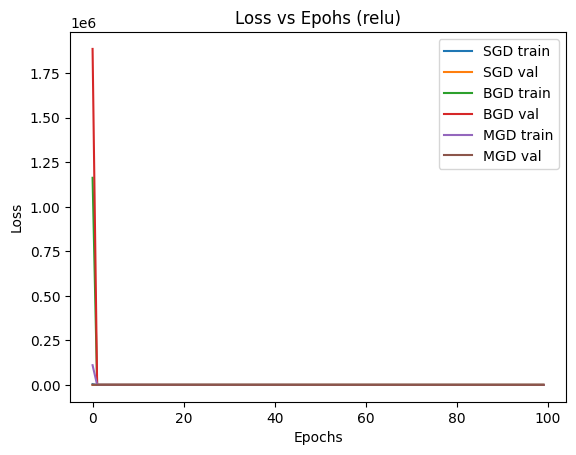

In [38]:
plt.plot(range(num_epochs), SGD_train_loss, label='SGD train')
plt.plot(range(num_epochs), SGD_val_loss, label='SGD val')
plt.plot(range(num_epochs), BGD_train_loss, label='BGD train')
plt.plot(range(num_epochs), BGD_val_loss, label='BGD val')
plt.plot(range(num_epochs), MGD_train_loss, label='MGD train')
plt.plot(range(num_epochs), MGD_val_loss, label='MGD val')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss vs Epohs (relu)')
plt.legend()
plt.show()

In [39]:
lr = 0.001
num_epochs = 100
hidden_layers = [32, 16, 10]
batch_size = 50
input_size = 13
output_size = 1

model3 = MLP_regression()

activation = [model3.sigmoid, model3.sigmoid, model3.sigmoid, model3.linear]
der_activation = [model3.der_sigmoid, model3.der_sigmoid, model3.der_sigmoid]

model3.set_lr(lr)
model3.set_hidden(hidden_layers)
model3.set_activation(activation)
model3.set_der_activation(der_activation)

model3.set_optimiser(model3.stochastic_gradient_descent)
SGD_train_loss, SGD_val_loss = model3.fit(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size)

model3.set_optimiser(model3.gradient_descent)
BGD_train_loss, BGD_val_loss = model3.fit(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size)

model3.set_optimiser(model3.minibatch_gradient_descent)
MGD_train_loss, MGD_val_loss = model3.fit(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size)


----------SGD--------------
----------------------
Epoch 10/100
Training MSE loss 83.01174429584356, Validation MSE Loss 95.9908049918554
Training RMSE loss 9.111078108316466, Validation accuracy 9.797489729101807
Training Rsquared loss -0.025303974726934797, Validation Rsquared loss -0.0003298664427977549
----------------------
Epoch 20/100
Training MSE loss 83.00768425245505, Validation MSE Loss 95.98702566658939
Training RMSE loss 9.11085529752586, Validation accuracy 9.797296855081477
Training Rsquared loss -0.02525609763541392, Validation Rsquared loss -0.00029048171278223123
----------------------
Epoch 30/100
Training MSE loss 83.0048575051621, Validation MSE Loss 95.98435120369072
Training RMSE loss 9.110700165473677, Validation accuracy 9.797160364293866
Training Rsquared loss -0.025222719604794497, Validation Rsquared loss -0.0002626108650018999
----------------------
Epoch 40/100
Training MSE loss 83.00277950010563, Validation MSE Loss 95.98235867098967
Training RMSE loss 9.

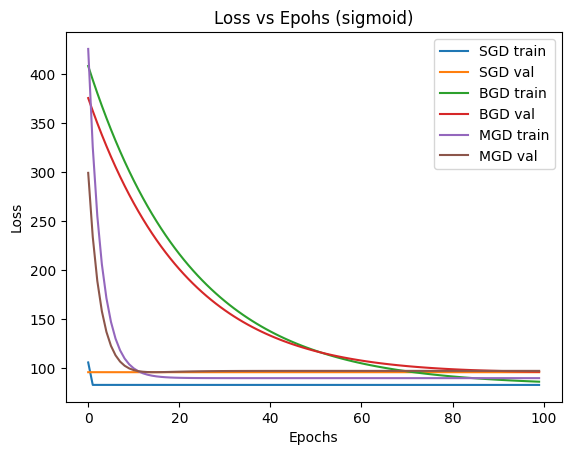

In [40]:
plt.plot(range(num_epochs), SGD_train_loss, label='SGD train')
plt.plot(range(num_epochs), SGD_val_loss, label='SGD val')
plt.plot(range(num_epochs), BGD_train_loss, label='BGD train')
plt.plot(range(num_epochs), BGD_val_loss, label='BGD val')
plt.plot(range(num_epochs), MGD_train_loss, label='MGD train')
plt.plot(range(num_epochs), MGD_val_loss, label='MGD val')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss vs Epohs (sigmoid)')
plt.legend()
plt.show()

In [41]:
lr = 0.001
num_epochs = 100
hidden_layers = [32, 16, 10]
batch_size = 50
input_size = 13
output_size = 1

model3 = MLP_regression()

activation = [model3.tanh, model3.tanh, model3.tanh, model3.linear]
der_activation = [model3.der_tanh, model3.der_tanh, model3.der_tanh]

model3.set_lr(lr)
model3.set_hidden(hidden_layers)
model3.set_activation(activation)
model3.set_der_activation(der_activation)

model3.set_optimiser(model3.stochastic_gradient_descent)
SGD_train_loss, SGD_val_loss = model3.fit(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size)

model3.set_optimiser(model3.gradient_descent)
BGD_train_loss, BGD_val_loss = model3.fit(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size)

model3.set_optimiser(model3.minibatch_gradient_descent)
MGD_train_loss, MGD_val_loss = model3.fit(X_train, Y_train, X_val, Y_val, num_epochs, input_size, output_size, batch_size)


----------SGD--------------
----------------------
Epoch 10/100
Training MSE loss 58.048491209386256, Validation MSE Loss 71.48573990372245
Training RMSE loss 7.618956044589459, Validation accuracy 8.454924003426788
Training Rsquared loss 0.28141836371567597, Validation Rsquared loss 0.2550398899506817
----------------------
Epoch 20/100
Training MSE loss 57.49173276230021, Validation MSE Loss 71.34678699211013
Training RMSE loss 7.582330298945055, Validation accuracy 8.446702729000833
Training Rsquared loss 0.2877180387334375, Validation Rsquared loss 0.25648793226605526
----------------------
Epoch 30/100
Training MSE loss 57.12815881103079, Validation MSE Loss 71.07499538567417
Training RMSE loss 7.558317194391274, Validation accuracy 8.430598756059629
Training Rsquared loss 0.2918194003753318, Validation Rsquared loss 0.25932030002658635
----------------------
Epoch 40/100
Training MSE loss 57.012032415476675, Validation MSE Loss 71.00573007637809
Training RMSE loss 7.5506312594031

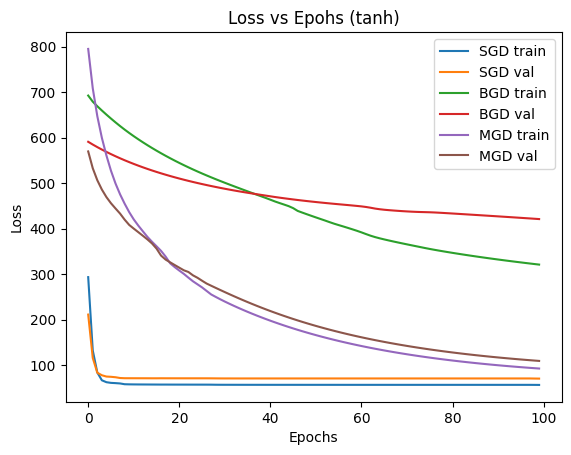

In [42]:
plt.plot(range(num_epochs), SGD_train_loss, label='SGD train')
plt.plot(range(num_epochs), SGD_val_loss, label='SGD val')
plt.plot(range(num_epochs), BGD_train_loss, label='BGD train')
plt.plot(range(num_epochs), BGD_val_loss, label='BGD val')
plt.plot(range(num_epochs), MGD_train_loss, label='MGD train')
plt.plot(range(num_epochs), MGD_val_loss, label='MGD val')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss vs Epohs (tanh)')
plt.legend()
plt.show()

Now let us perform the above on the test data.

In [46]:
Y_pred_test, _ = model3.forward_prop(X_test)
loss_test = model3.loss(Y_pred_test, Y_test)

print(f'TEST MSE LOSS {loss_test}')
print(f'TEST RMSE LOSS {np.sqrt(loss_test)}')
print(f'TEST RSQUARED LOSS {r2_score(Y_test, np.squeeze(Y_pred_test))}')

TEST MSE LOSS 109.91974736919566
TEST RMSE LOSS 10.484261889575043
TEST RSQUARED LOSS -0.5273055595939222
